<a href="https://colab.research.google.com/github/ErrorInever/GAN_MNIST/blob/mm/GAN_MNIST.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install tensorboardx

     |████████████████████████████████| 194kB 9.1MB/s 
     |████████████████████████████████| 1.3MB 50.5MB/s 
  Found existing installation: protobuf 3.7.1
    Uninstalling protobuf-3.7.1:
      Successfully uninstalled protobuf-3.7.1


In [0]:
import torch
import torch.nn
import os
import numpy as np
import errno
import torchvision.utils as vutils
from tensorboardX import SummaryWriter
from IPython import display
from matplotlib import pyplot as plt

from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

In [0]:
class Logger:

    def __init__(self, model_name, data_name):
        self.model_name = model_name
        self.data_name = data_name

        self.comment = '{}_{}'.format(model_name, data_name)
        self.data_subdir = '{}/{}'.format(model_name, data_name)

        # TensorBoard
        self.writer = SummaryWriter(comment=self.comment)

    def log(self, d_error, g_error, epoch, n_batch, num_batches):

        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()

        step = Logger._step(epoch, n_batch, num_batches)
        self.writer.add_scalar(
            '{}/D_error'.format(self.comment), d_error, step)
        self.writer.add_scalar(
            '{}/G_error'.format(self.comment), g_error, step)

    def log_images(self, images, num_images, epoch, n_batch, num_batches, format='NCHW', normalize=True):
        '''
        input images are expected in format (NCHW)
        '''
        if type(images) == np.ndarray:
            images = torch.from_numpy(images)
        
        if format=='NHWC':
            images = images.transpose(1,3)
        

        step = Logger._step(epoch, n_batch, num_batches)
        img_name = '{}/images{}'.format(self.comment, '')

        # Make horizontal grid from image tensor
        horizontal_grid = vutils.make_grid(
            images, normalize=normalize, scale_each=True)
        # Make vertical grid from image tensor
        nrows = int(np.sqrt(num_images))
        grid = vutils.make_grid(
            images, nrow=nrows, normalize=True, scale_each=True)

        # Add horizontal images to tensorboard
        self.writer.add_image(img_name, horizontal_grid, step)

        # Save plots
        self.save_torch_images(horizontal_grid, grid, epoch, n_batch)

    def save_torch_images(self, horizontal_grid, grid, epoch, n_batch, plot_horizontal=True):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)

        # Plot and save horizontal
        fig = plt.figure(figsize=(16, 16))
        plt.imshow(np.moveaxis(horizontal_grid.numpy(), 0, -1))
        plt.axis('off')
        if plot_horizontal:
            display.display(plt.gcf())
        self._save_images(fig, epoch, n_batch, 'hori')
        plt.close()

        # Save squared
        fig = plt.figure()
        plt.imshow(np.moveaxis(grid.numpy(), 0, -1))
        plt.axis('off')
        self._save_images(fig, epoch, n_batch)
        plt.close()

    def _save_images(self, fig, epoch, n_batch, comment=''):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        fig.savefig('{}/{}_epoch_{}_batch_{}.png'.format(out_dir,
                                                         comment, epoch, n_batch))

    def display_status(self, epoch, num_epochs, n_batch, num_batches, d_error, g_error, d_pred_real, d_pred_fake):
        
        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()
        if isinstance(d_pred_real, torch.autograd.Variable):
            d_pred_real = d_pred_real.data
        if isinstance(d_pred_fake, torch.autograd.Variable):
            d_pred_fake = d_pred_fake.data
        
        
        print('Epoch: [{}/{}], Batch Num: [{}/{}]'.format(
            epoch,num_epochs, n_batch, num_batches)
             )
        print('Discriminator Loss: {:.4f}, Generator Loss: {:.4f}'.format(d_error, g_error))
        print('D(x): {:.4f}, D(G(z)): {:.4f}'.format(d_pred_real.mean(), d_pred_fake.mean()))

    def save_models(self, generator, discriminator, epoch):
        out_dir = './data/models/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        torch.save(generator.state_dict(),
                   '{}/G_epoch_{}'.format(out_dir, epoch))
        torch.save(discriminator.state_dict(),
                   '{}/D_epoch_{}'.format(out_dir, epoch))

    def close(self):
        self.writer.close()

    # Private Functionality

    @staticmethod
    def _step(epoch, n_batch, num_batches):
        return epoch * num_batches + n_batch

    @staticmethod
    def _make_dir(directory):
        try:
            os.makedirs(directory)
        except OSError as e:
            if e.errno != errno.EEXIST:
                raise

In [0]:
def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5,), (.5,))
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

0it [00:00, ?it/s]

9920512it [00:01, 7584671.28it/s]                             


Extracting ./dataset/MNIST/raw/train-images-idx3-ubyte.gz to ./dataset/MNIST/raw


  0%|          | 0/28881 [00:00<?, ?it/s]

32768it [00:00, 129486.78it/s]           
  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./dataset/MNIST/raw/train-labels-idx1-ubyte.gz to ./dataset/MNIST/raw


1654784it [00:03, 516329.67it/s]                             
0it [00:00, ?it/s]

Extracting ./dataset/MNIST/raw/t10k-images-idx3-ubyte.gz to ./dataset/MNIST/raw


8192it [00:00, 48506.66it/s]            


Extracting ./dataset/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./dataset/MNIST/raw
Processing...
Done!


In [0]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
discriminator = DiscriminatorNet()

In [0]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [0]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
generator = GeneratorNet()

In [0]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

In [0]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

loss = nn.BCELoss()

In [0]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [0]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [0]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

In [0]:
# test static noise for visualization for each period
num_test_samples = 16
test_noise = noise(num_test_samples)

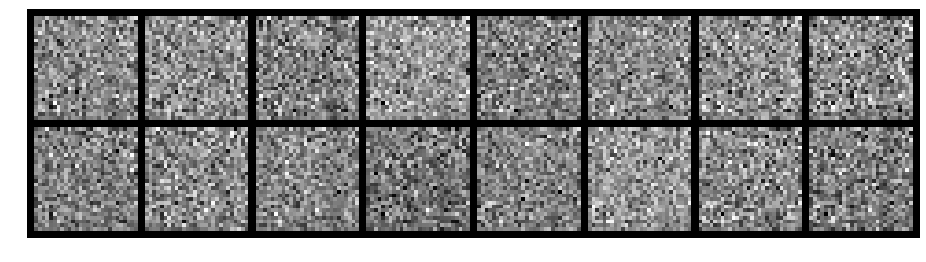

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3590, Generator Loss: 0.6990
D(x): 0.5119, D(G(z)): 0.4979


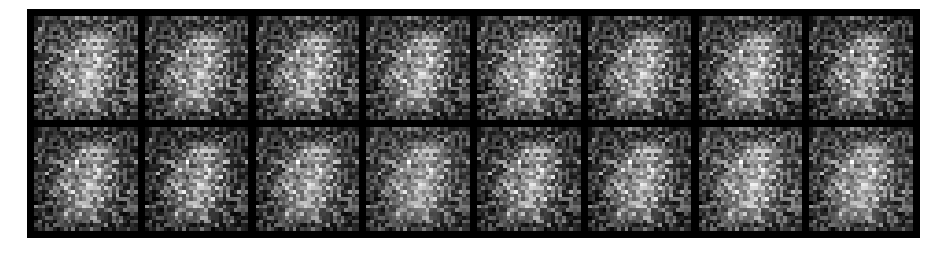

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 2.0521, Generator Loss: 0.6080
D(x): 0.4491, D(G(z)): 0.5754


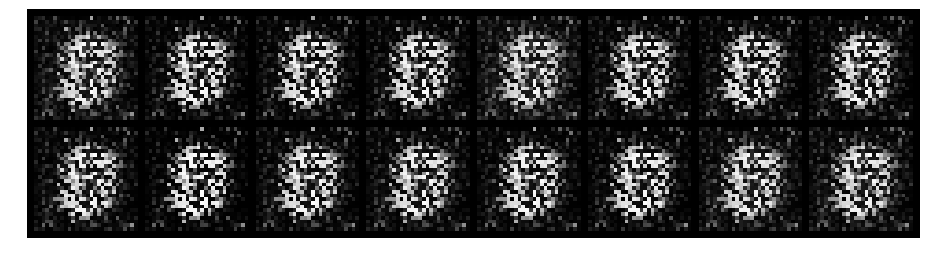

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.5011, Generator Loss: 3.0503
D(x): 0.8023, D(G(z)): 0.1834


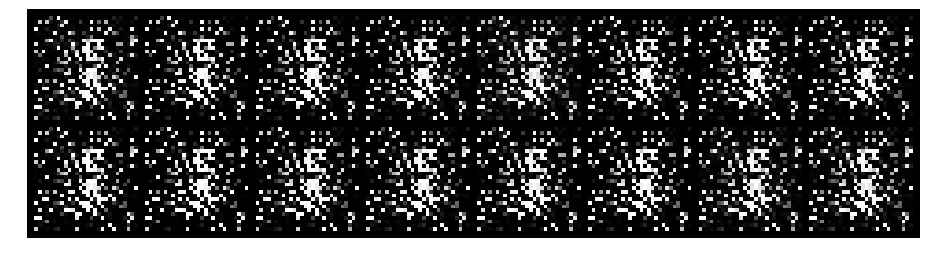

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.0428, Generator Loss: 7.3336
D(x): 0.9926, D(G(z)): 0.0328


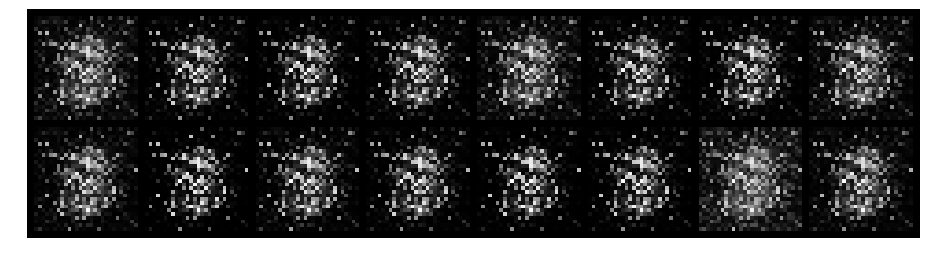

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 1.1602, Generator Loss: 2.1355
D(x): 0.6078, D(G(z)): 0.3694


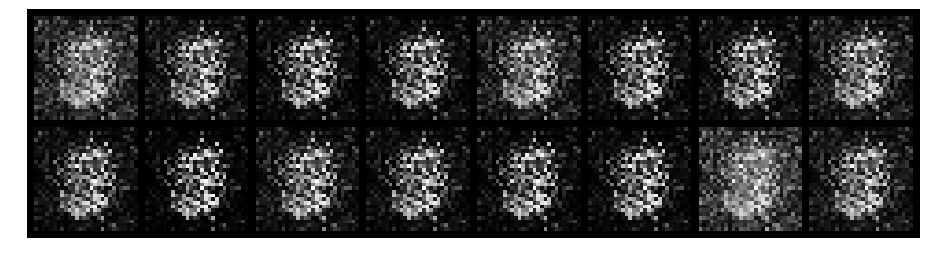

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.2608, Generator Loss: 7.4114
D(x): 0.8479, D(G(z)): 0.0348


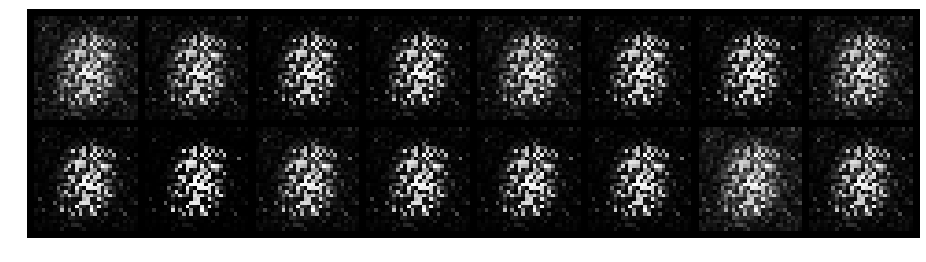

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.4656, Generator Loss: 2.3932
D(x): 0.8362, D(G(z)): 0.2084


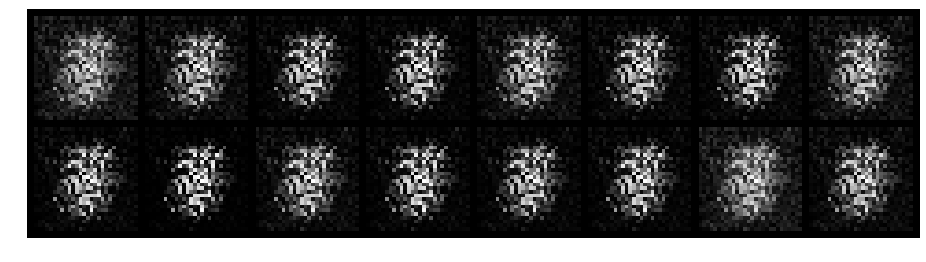

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.8247, Generator Loss: 2.0658
D(x): 0.5976, D(G(z)): 0.2291


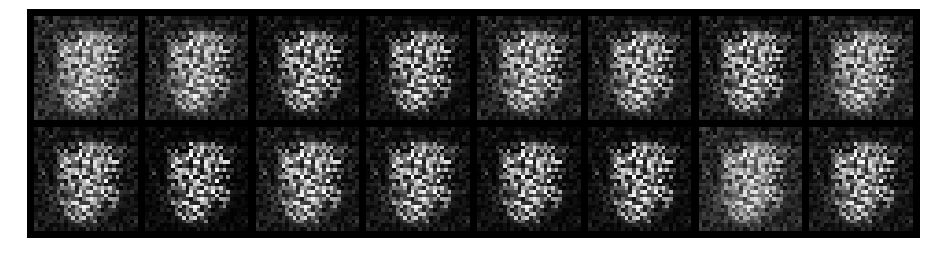

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.4346, Generator Loss: 3.4448
D(x): 0.8466, D(G(z)): 0.1808


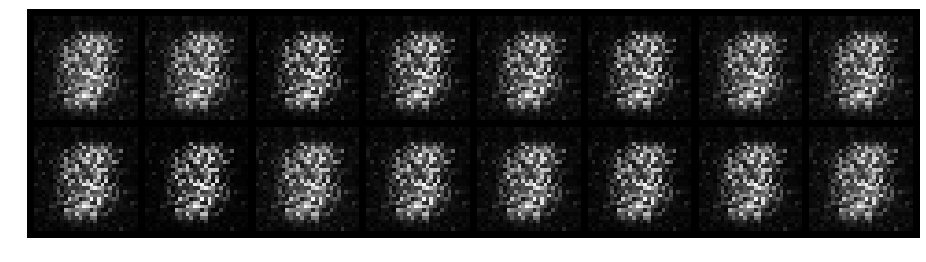

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.6537, Generator Loss: 2.1195
D(x): 0.7497, D(G(z)): 0.2570


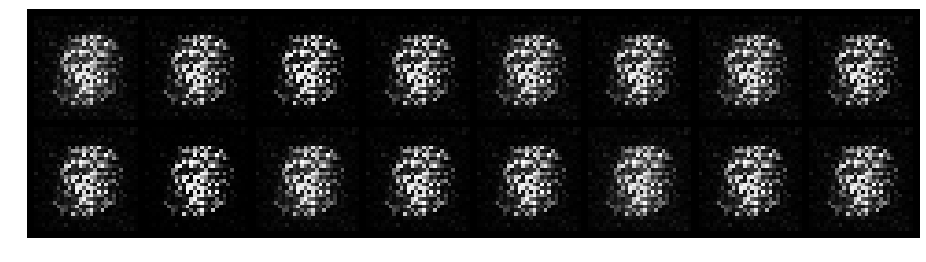

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.5135, Generator Loss: 4.7245
D(x): 0.8000, D(G(z)): 0.1581


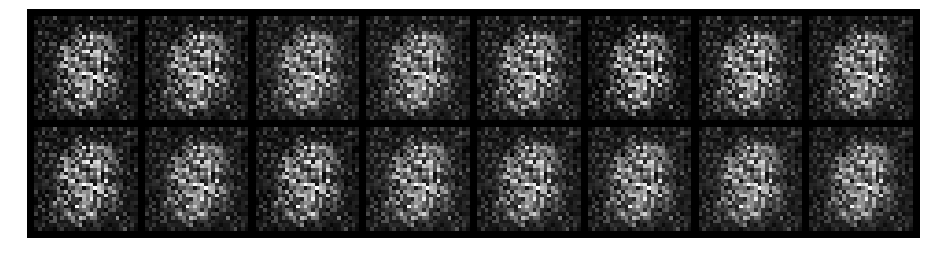

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.3523, Generator Loss: 3.4651
D(x): 0.8654, D(G(z)): 0.1494


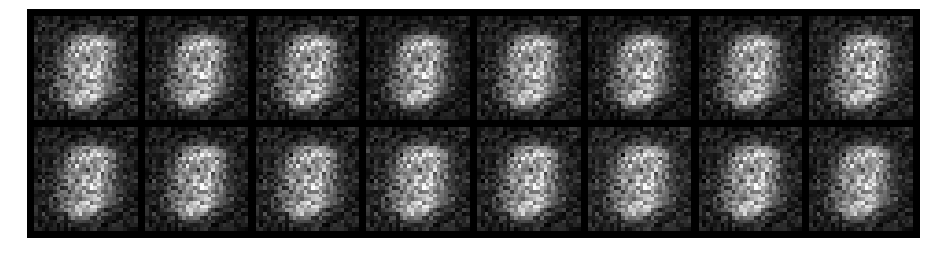

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.6662, Generator Loss: 1.8504
D(x): 0.8383, D(G(z)): 0.3038


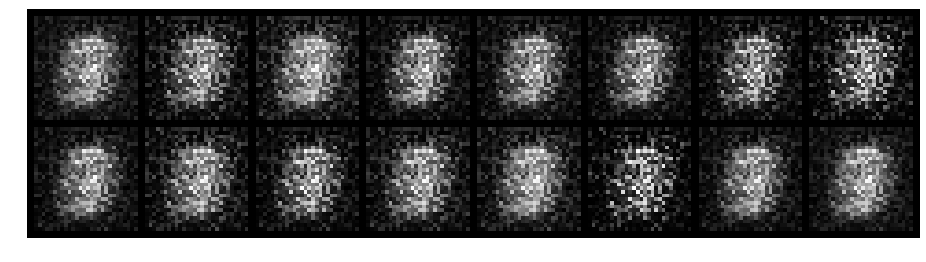

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 1.3438, Generator Loss: 1.2329
D(x): 0.5954, D(G(z)): 0.4324


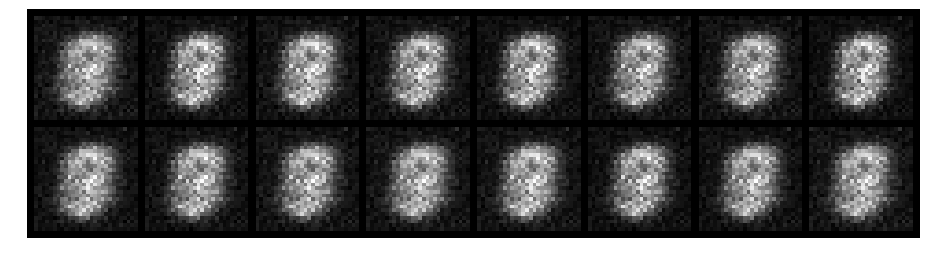

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.6617, Generator Loss: 1.6837
D(x): 0.7982, D(G(z)): 0.3095


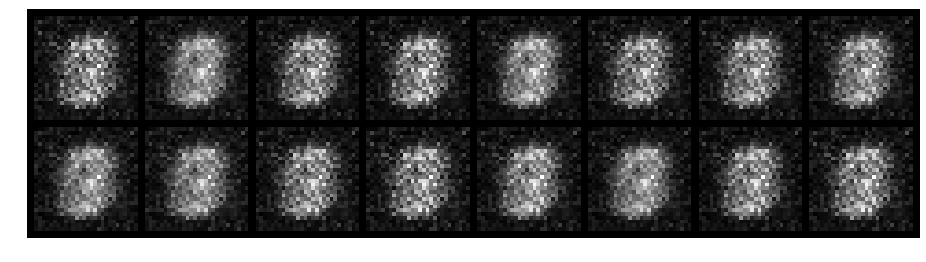

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.7875, Generator Loss: 1.7340
D(x): 0.7642, D(G(z)): 0.2969


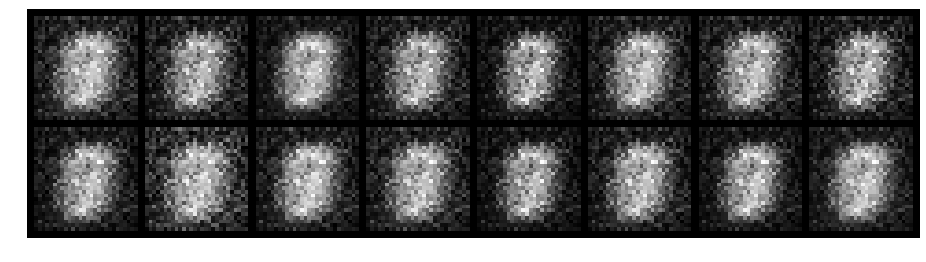

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.7360, Generator Loss: 2.5478
D(x): 0.7563, D(G(z)): 0.2386


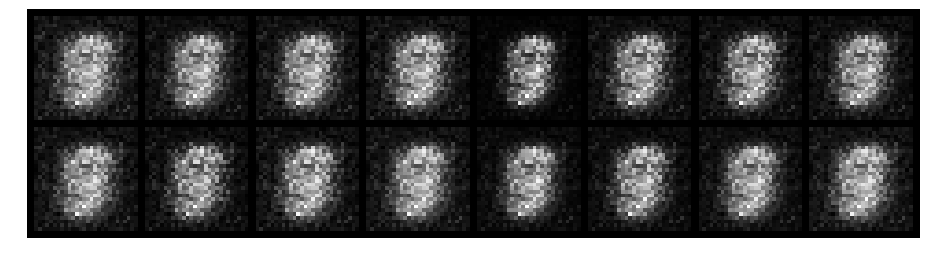

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.5775, Generator Loss: 2.2701
D(x): 0.8038, D(G(z)): 0.1969


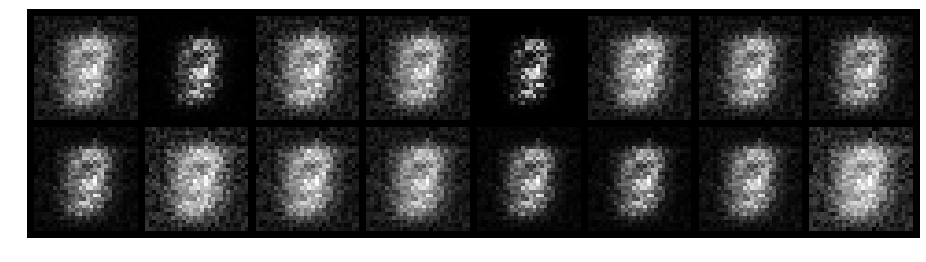

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.8531, Generator Loss: 1.4969
D(x): 0.7653, D(G(z)): 0.2896


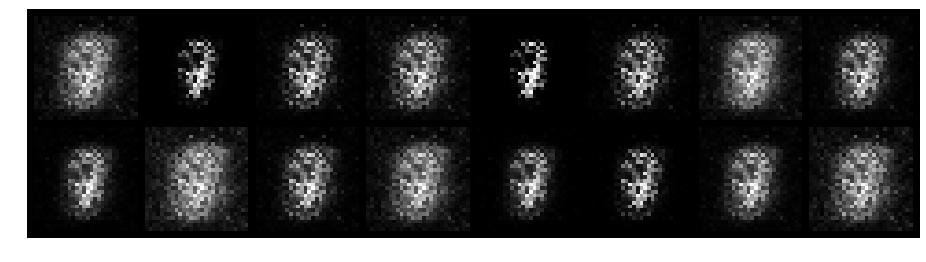

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.8068, Generator Loss: 4.1460
D(x): 0.7986, D(G(z)): 0.2030


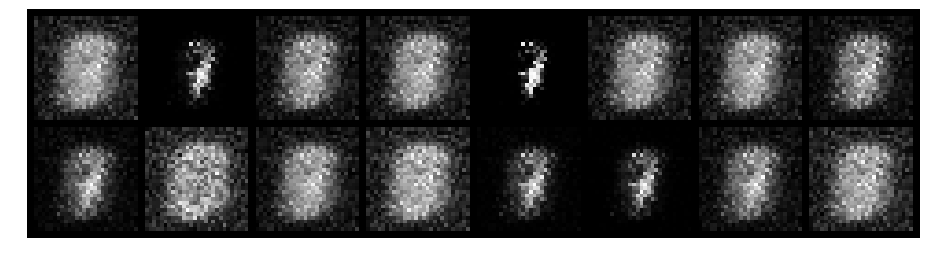

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.7376, Generator Loss: 2.3360
D(x): 0.7852, D(G(z)): 0.2492


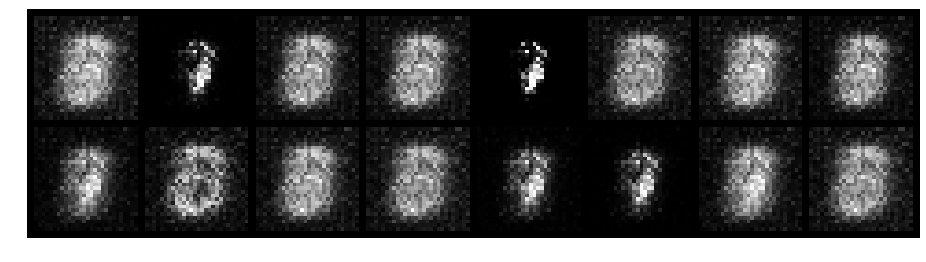

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.5185, Generator Loss: 3.6968
D(x): 0.7996, D(G(z)): 0.1049


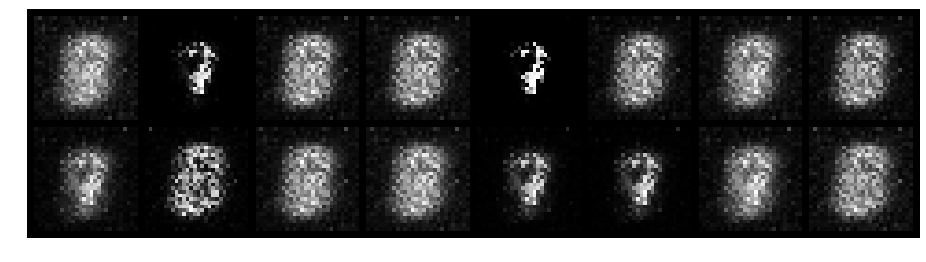

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.6164, Generator Loss: 3.1688
D(x): 0.7814, D(G(z)): 0.1459


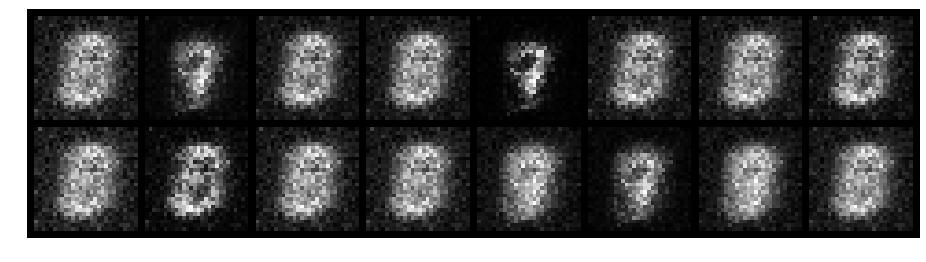

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.9697, Generator Loss: 2.2790
D(x): 0.7522, D(G(z)): 0.2660


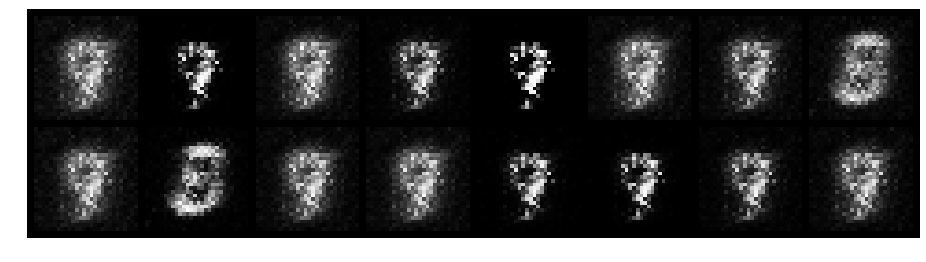

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.6140, Generator Loss: 2.5255
D(x): 0.8824, D(G(z)): 0.2405


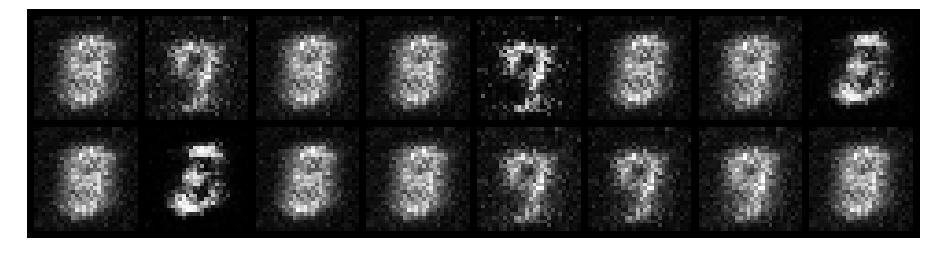

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.5001, Generator Loss: 2.7931
D(x): 0.8496, D(G(z)): 0.1189


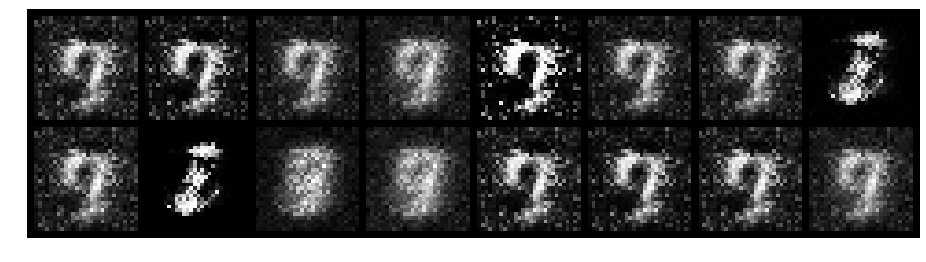

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.5351, Generator Loss: 2.4911
D(x): 0.8524, D(G(z)): 0.1628


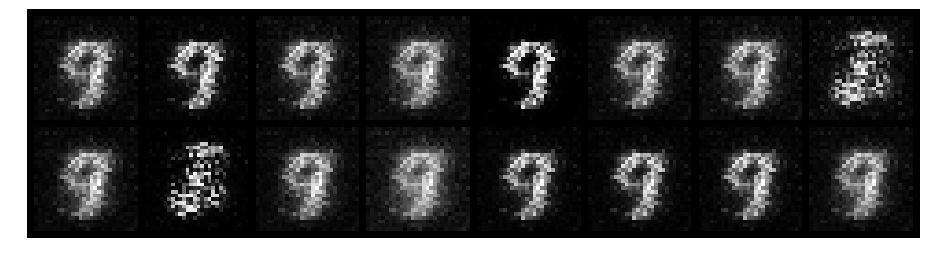

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.7652, Generator Loss: 2.9386
D(x): 0.7854, D(G(z)): 0.1656


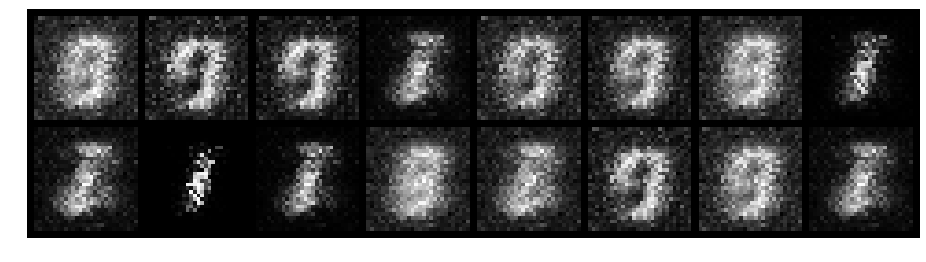

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.3642, Generator Loss: 3.8660
D(x): 0.9297, D(G(z)): 0.1698


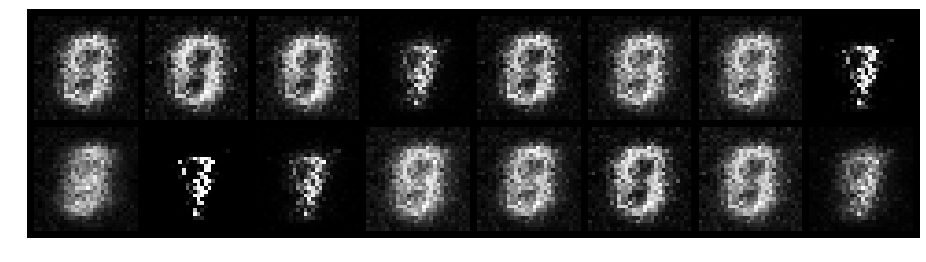

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.8678, Generator Loss: 2.1769
D(x): 0.7798, D(G(z)): 0.2000


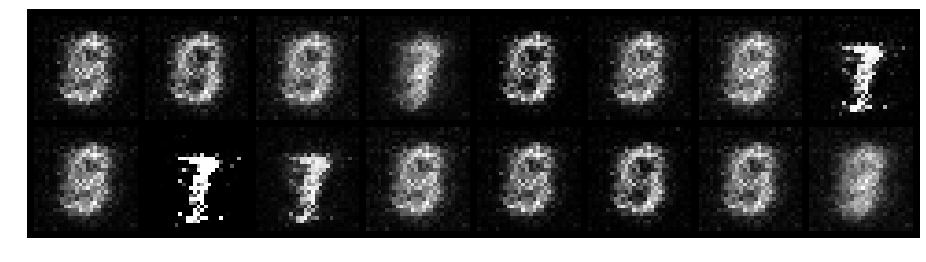

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.5551, Generator Loss: 2.5360
D(x): 0.8260, D(G(z)): 0.1644


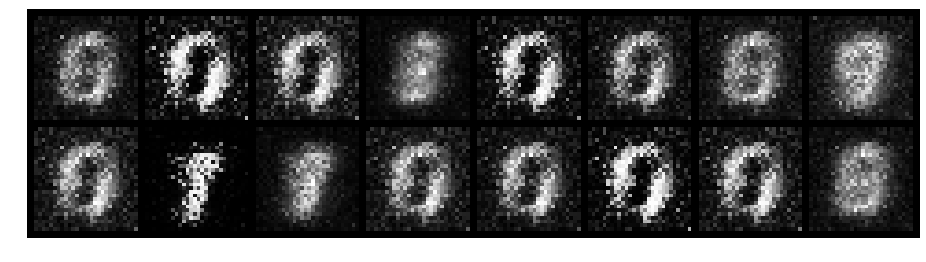

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.7687, Generator Loss: 2.1288
D(x): 0.8785, D(G(z)): 0.3098


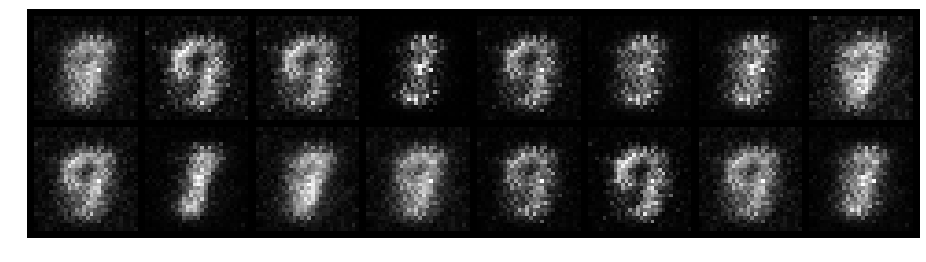

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3670, Generator Loss: 3.2683
D(x): 0.9337, D(G(z)): 0.1552


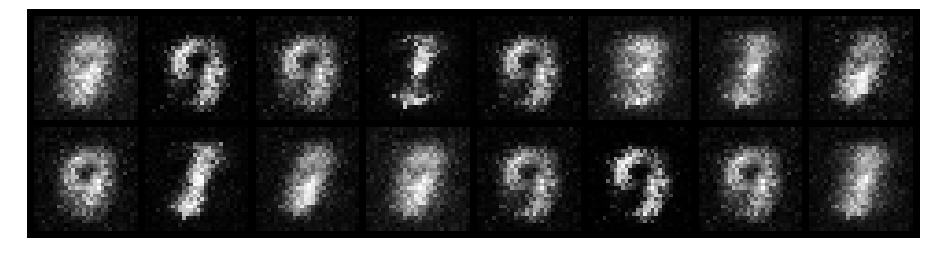

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.5719, Generator Loss: 3.1245
D(x): 0.8559, D(G(z)): 0.1832


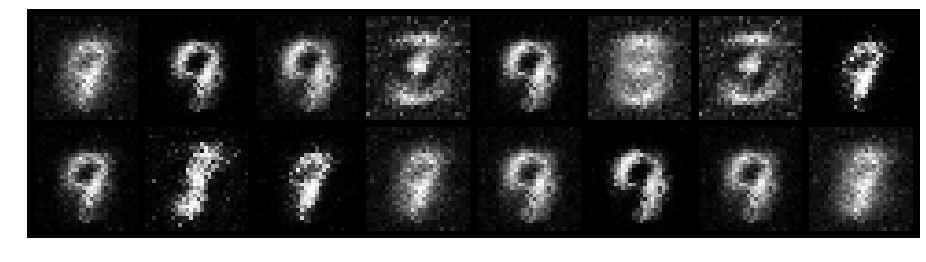

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.6624, Generator Loss: 1.5269
D(x): 0.8010, D(G(z)): 0.2063


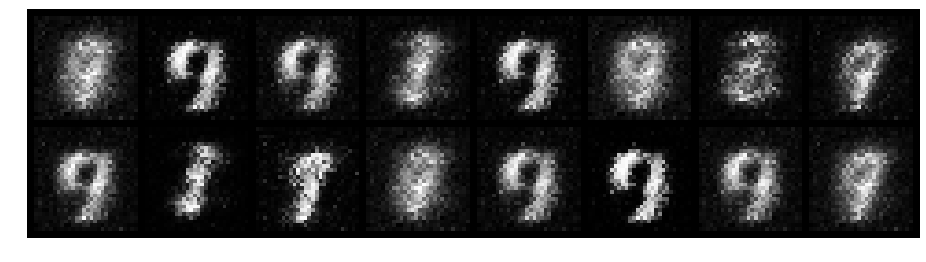

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.2868, Generator Loss: 2.6441
D(x): 0.8997, D(G(z)): 0.1082


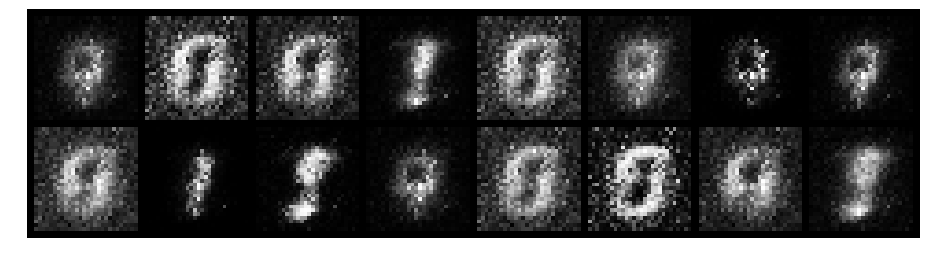

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.7832, Generator Loss: 2.3505
D(x): 0.8523, D(G(z)): 0.2307


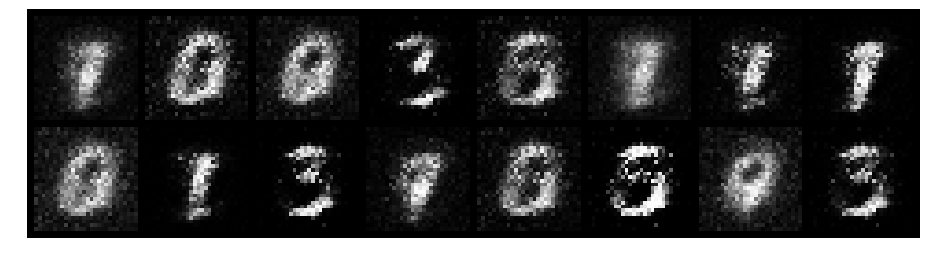

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.2155, Generator Loss: 3.8559
D(x): 0.9356, D(G(z)): 0.0999


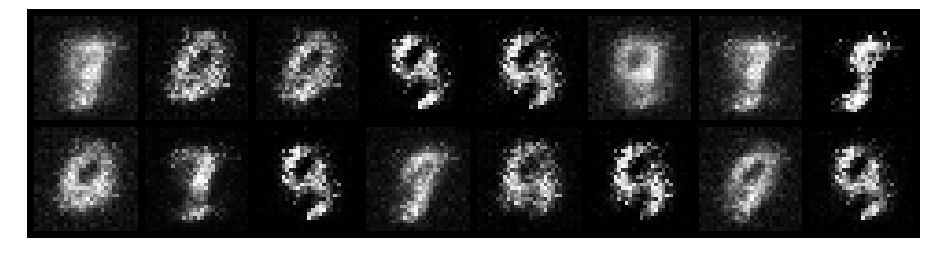

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 1.1760, Generator Loss: 2.1048
D(x): 0.6393, D(G(z)): 0.1880


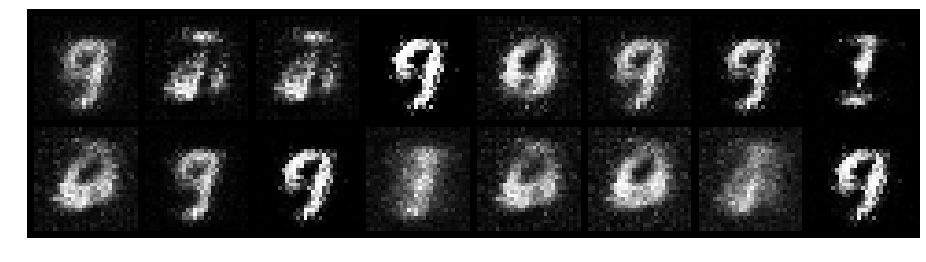

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.9360, Generator Loss: 1.8261
D(x): 0.8168, D(G(z)): 0.3359


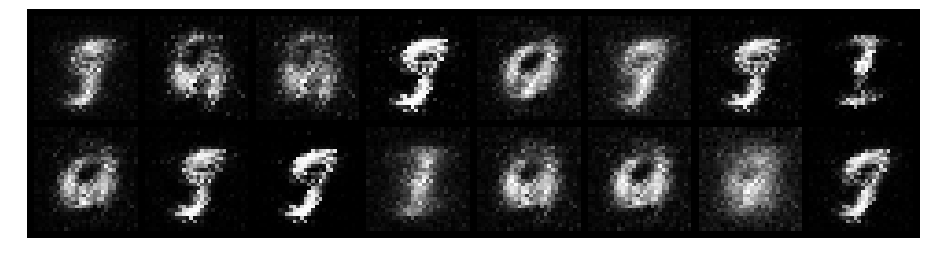

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.6151, Generator Loss: 2.1216
D(x): 0.8529, D(G(z)): 0.1888


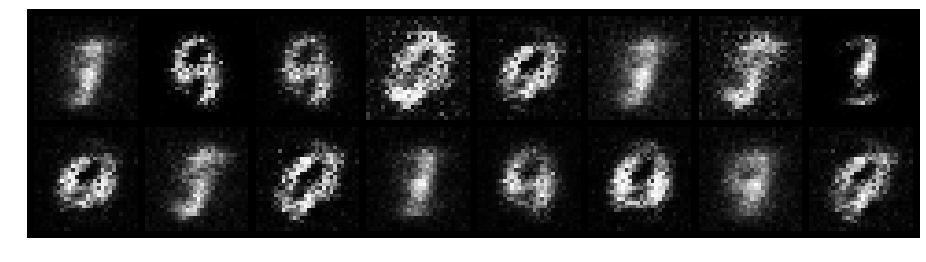

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.5095, Generator Loss: 3.1900
D(x): 0.8675, D(G(z)): 0.1525


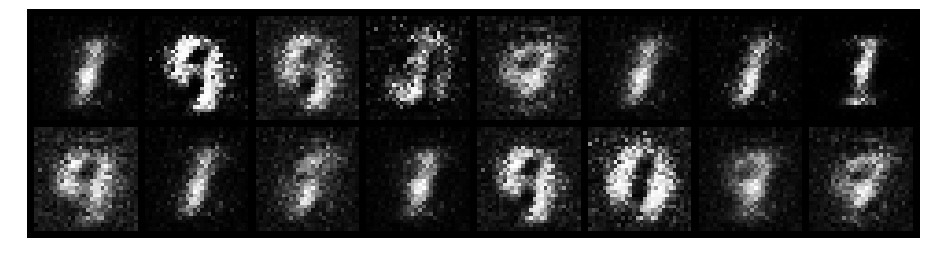

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.4079, Generator Loss: 2.7169
D(x): 0.8793, D(G(z)): 0.1597


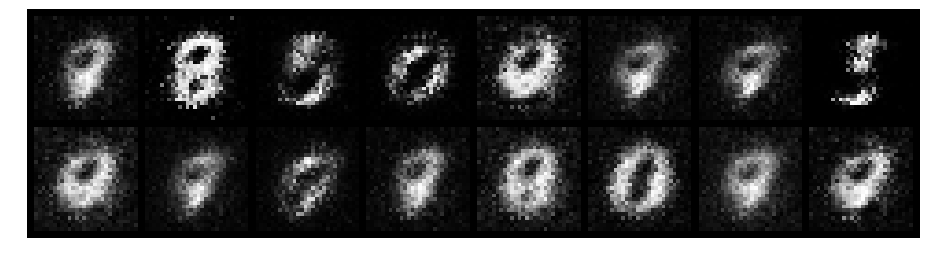

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.5149, Generator Loss: 1.9515
D(x): 0.8406, D(G(z)): 0.2101


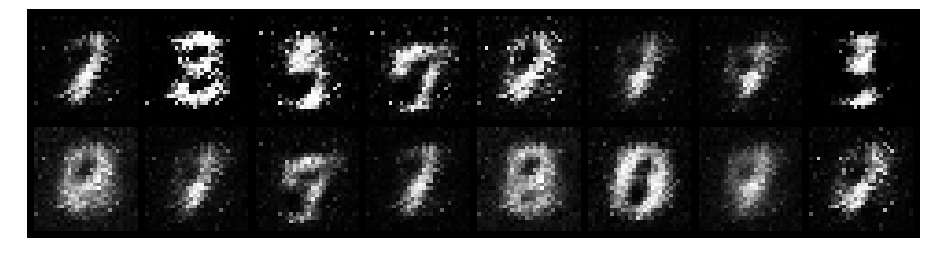

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.6169, Generator Loss: 2.2763
D(x): 0.8564, D(G(z)): 0.2352


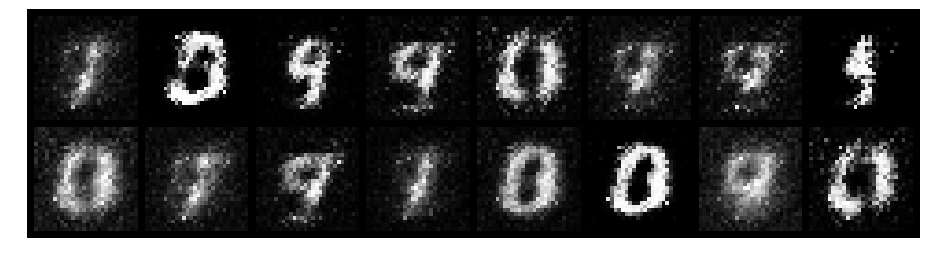

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.5650, Generator Loss: 2.6134
D(x): 0.8336, D(G(z)): 0.1448


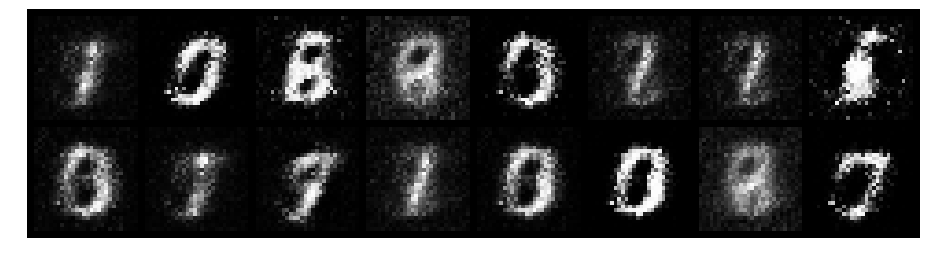

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.5303, Generator Loss: 2.5132
D(x): 0.8332, D(G(z)): 0.1258


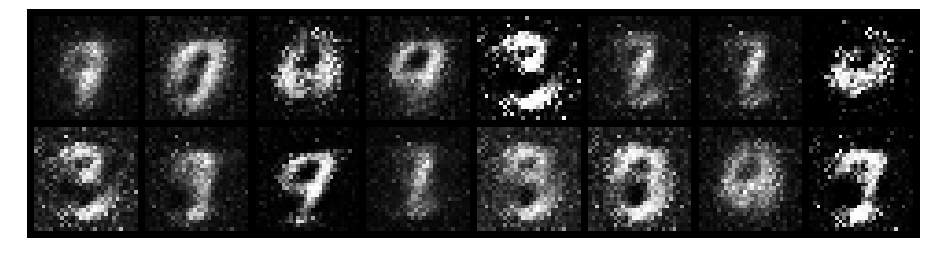

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.4235, Generator Loss: 3.1400
D(x): 0.8723, D(G(z)): 0.1385


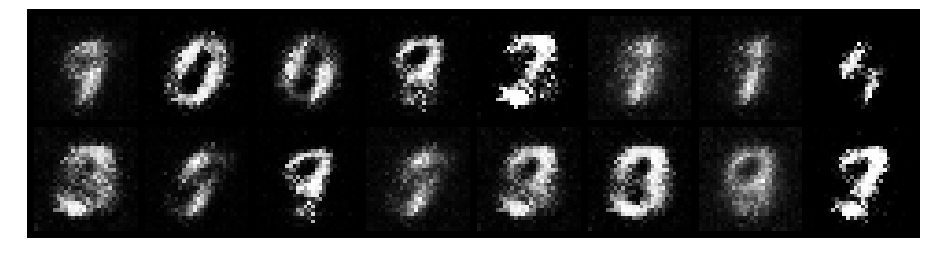

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.6053, Generator Loss: 1.7786
D(x): 0.8069, D(G(z)): 0.2187


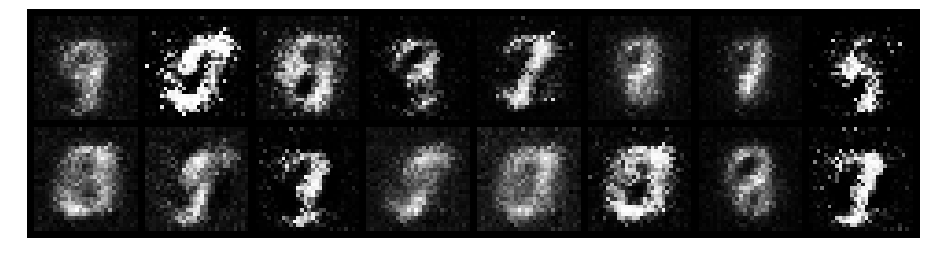

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.7625, Generator Loss: 1.8633
D(x): 0.7906, D(G(z)): 0.2256


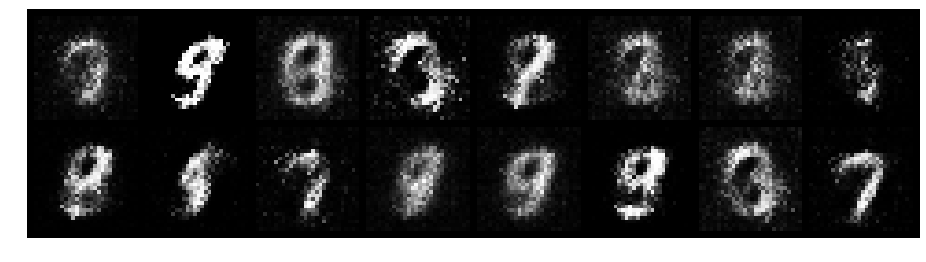

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.7724, Generator Loss: 2.5780
D(x): 0.7246, D(G(z)): 0.1606


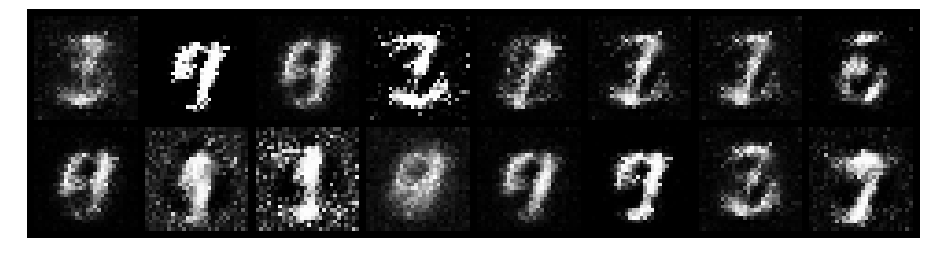

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.5555, Generator Loss: 2.0659
D(x): 0.8468, D(G(z)): 0.2056


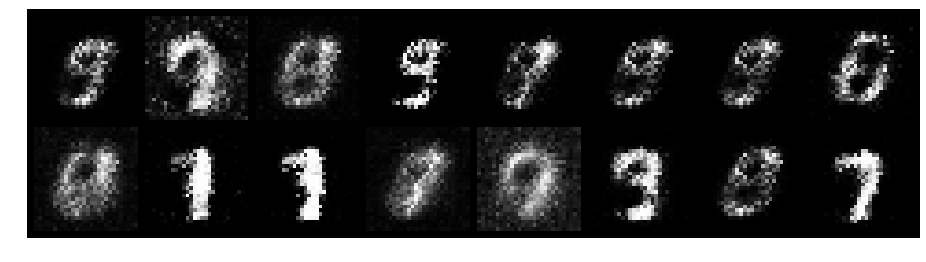

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.5016, Generator Loss: 2.1919
D(x): 0.8323, D(G(z)): 0.1636


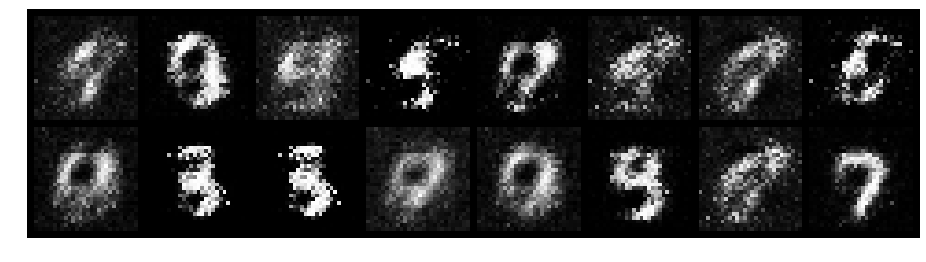

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.6496, Generator Loss: 2.2042
D(x): 0.7860, D(G(z)): 0.2037


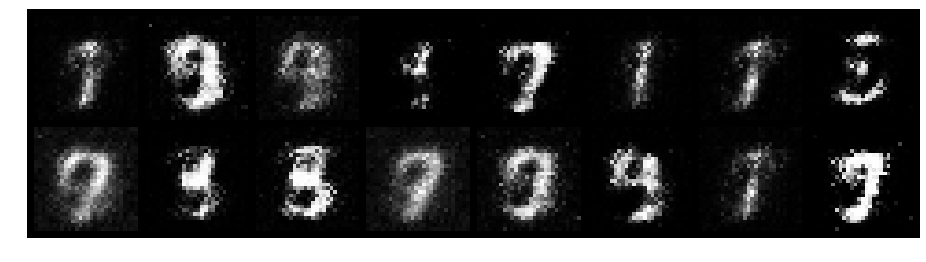

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7183, Generator Loss: 2.1380
D(x): 0.7484, D(G(z)): 0.2230


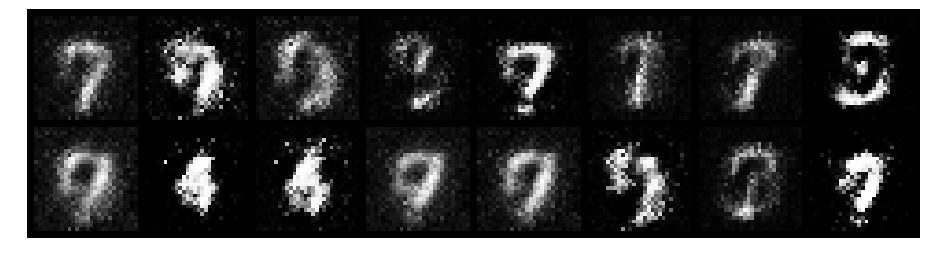

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.5043, Generator Loss: 2.4513
D(x): 0.8061, D(G(z)): 0.1244


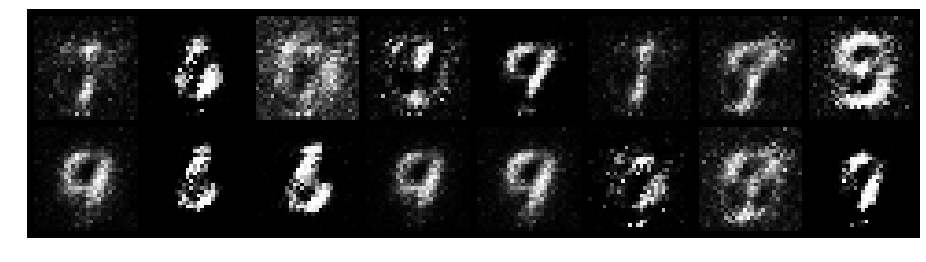

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.4581, Generator Loss: 2.2376
D(x): 0.8886, D(G(z)): 0.2003


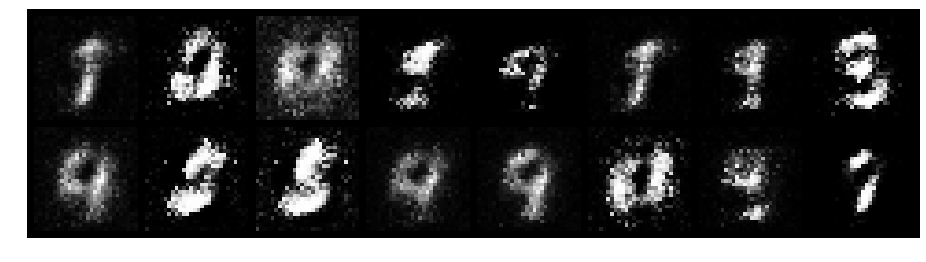

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.6242, Generator Loss: 2.3491
D(x): 0.7817, D(G(z)): 0.1914


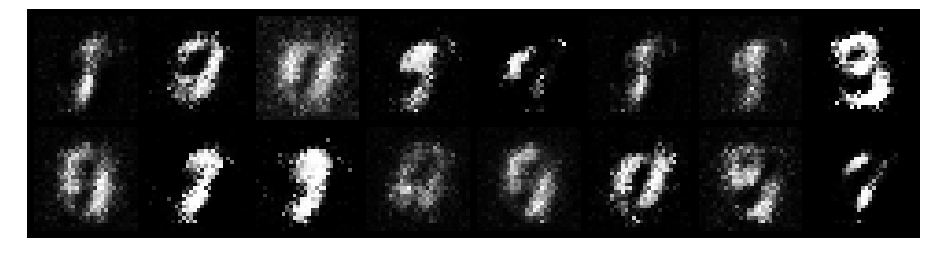

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.6117, Generator Loss: 2.3909
D(x): 0.7974, D(G(z)): 0.1292


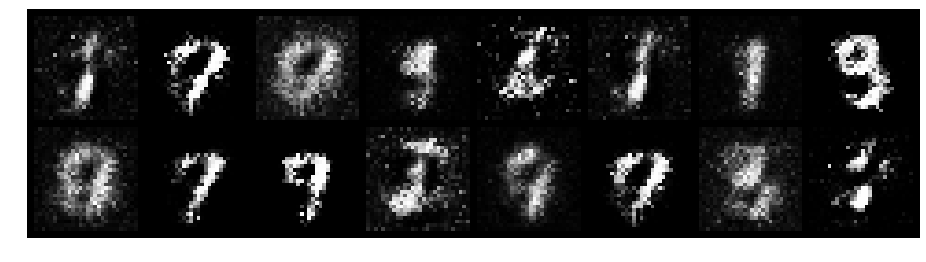

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.4123, Generator Loss: 3.1846
D(x): 0.8408, D(G(z)): 0.1176


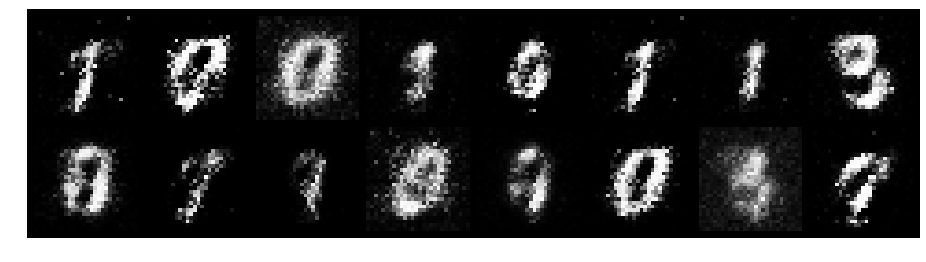

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.3745, Generator Loss: 3.1653
D(x): 0.9374, D(G(z)): 0.1892


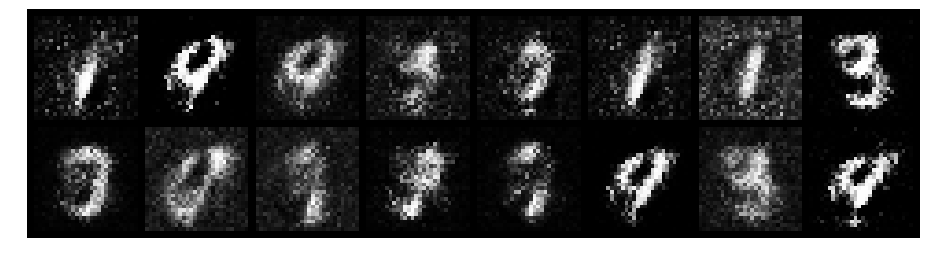

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.5421, Generator Loss: 3.2441
D(x): 0.8531, D(G(z)): 0.1754


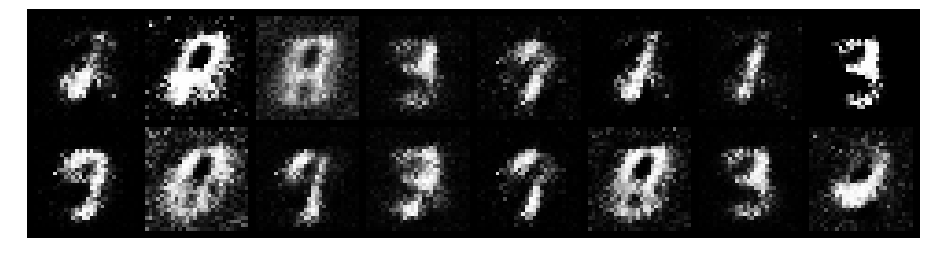

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.4402, Generator Loss: 2.8708
D(x): 0.8664, D(G(z)): 0.1447


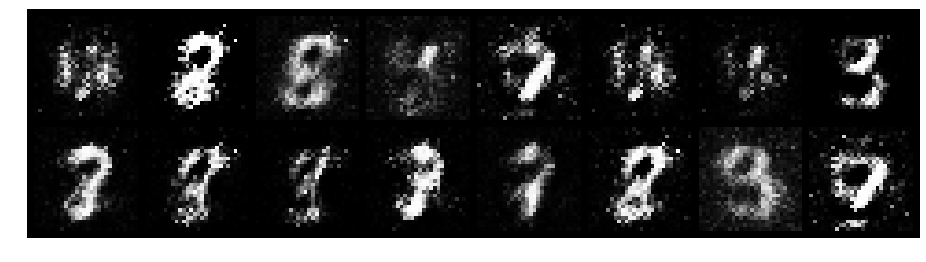

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.7867, Generator Loss: 1.9139
D(x): 0.8111, D(G(z)): 0.3052


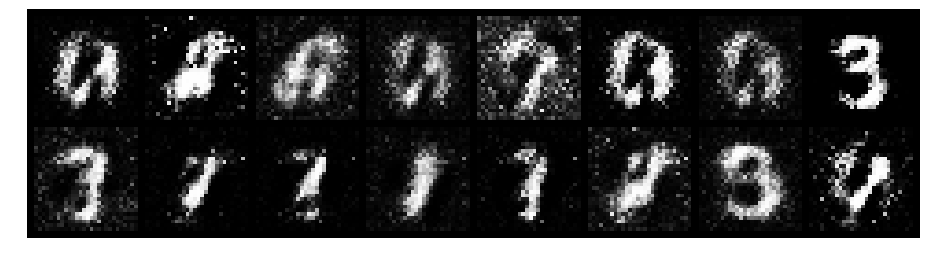

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.6363, Generator Loss: 2.0002
D(x): 0.8328, D(G(z)): 0.2419


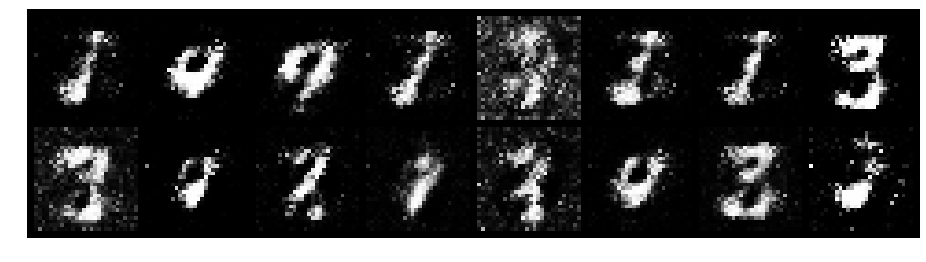

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.4847, Generator Loss: 2.5448
D(x): 0.7971, D(G(z)): 0.1137


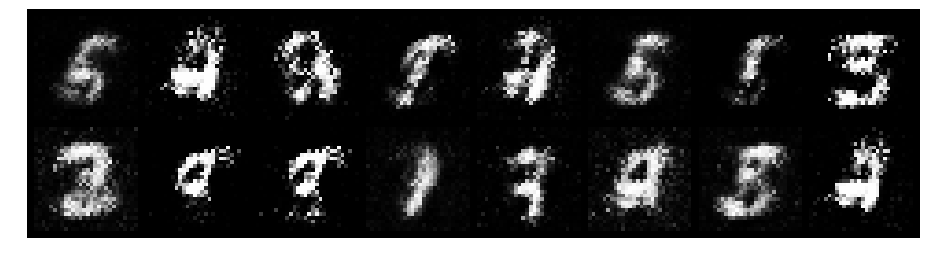

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.4692, Generator Loss: 2.4820
D(x): 0.8655, D(G(z)): 0.1767


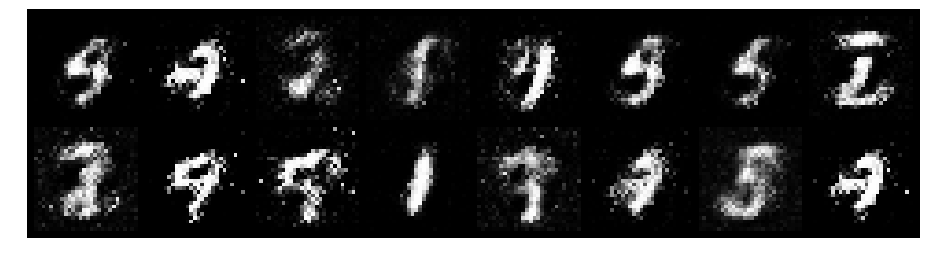

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.7150, Generator Loss: 2.1405
D(x): 0.7957, D(G(z)): 0.2472


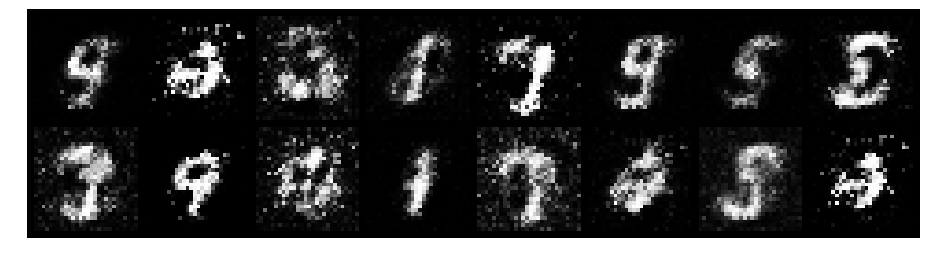

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.7661, Generator Loss: 2.1687
D(x): 0.7656, D(G(z)): 0.2409


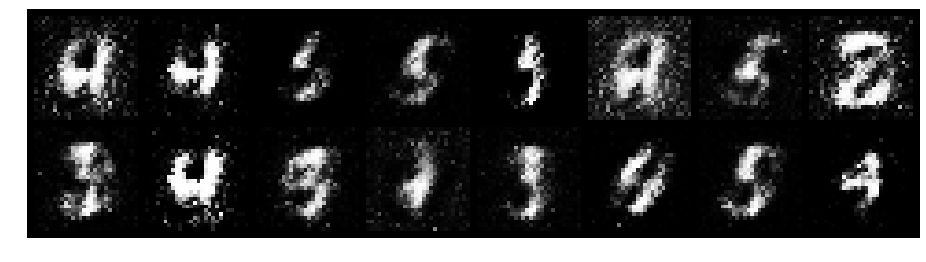

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.9879, Generator Loss: 2.4283
D(x): 0.6486, D(G(z)): 0.1835


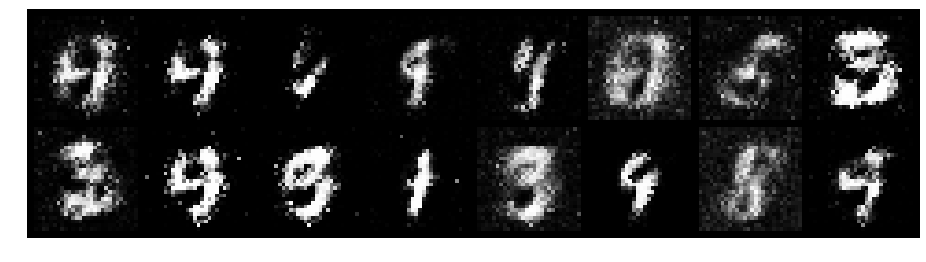

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.8658, Generator Loss: 2.0682
D(x): 0.8274, D(G(z)): 0.3495


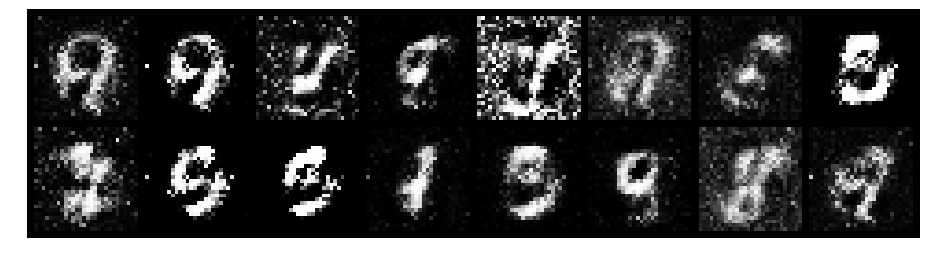

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.4968, Generator Loss: 3.1363
D(x): 0.8768, D(G(z)): 0.1954


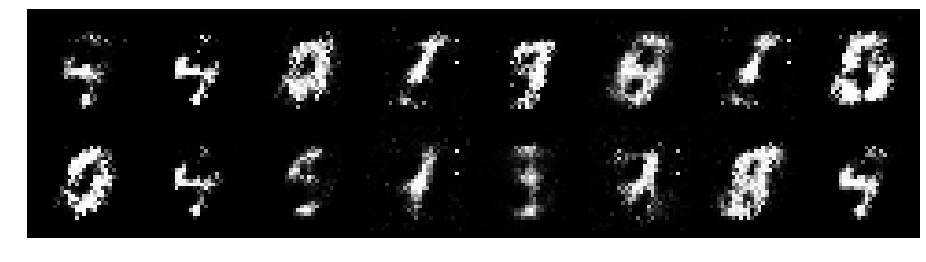

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.8090, Generator Loss: 1.6326
D(x): 0.7150, D(G(z)): 0.2633


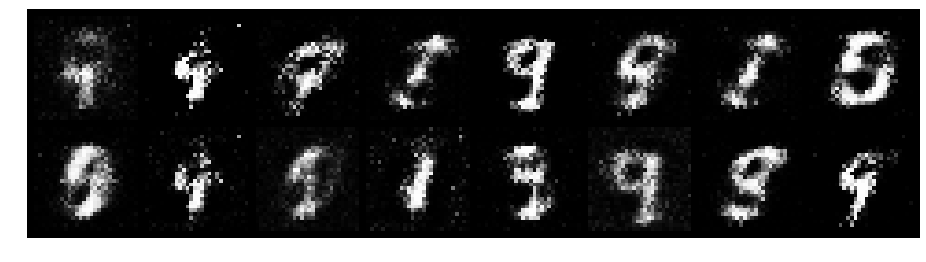

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.5319, Generator Loss: 2.4807
D(x): 0.8223, D(G(z)): 0.1591


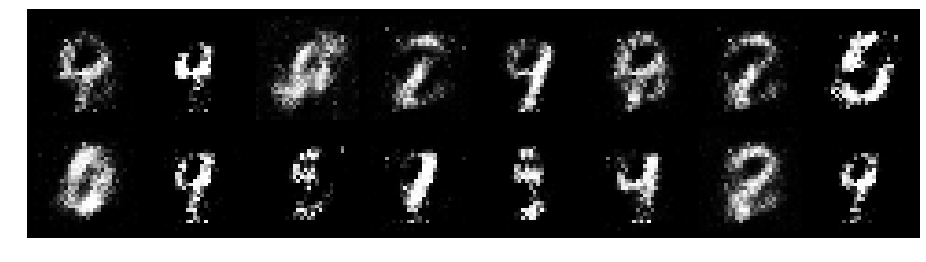

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.6138, Generator Loss: 2.4017
D(x): 0.8023, D(G(z)): 0.1761


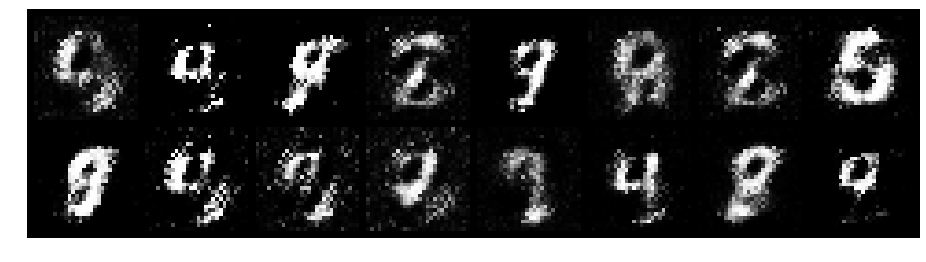

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.6895, Generator Loss: 2.4873
D(x): 0.8169, D(G(z)): 0.2262


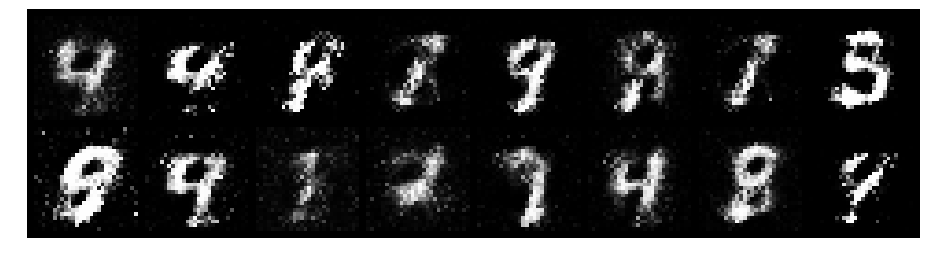

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.9107, Generator Loss: 1.9087
D(x): 0.7187, D(G(z)): 0.2465


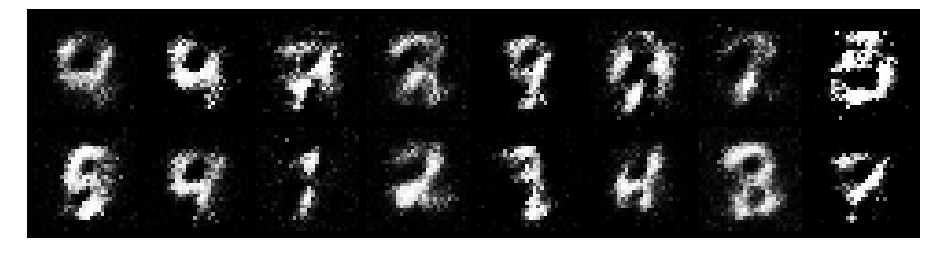

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.7257, Generator Loss: 2.1587
D(x): 0.7728, D(G(z)): 0.2475


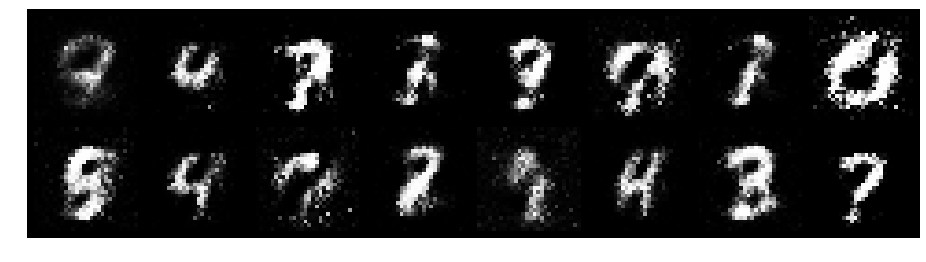

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.7330, Generator Loss: 2.2324
D(x): 0.8176, D(G(z)): 0.2754


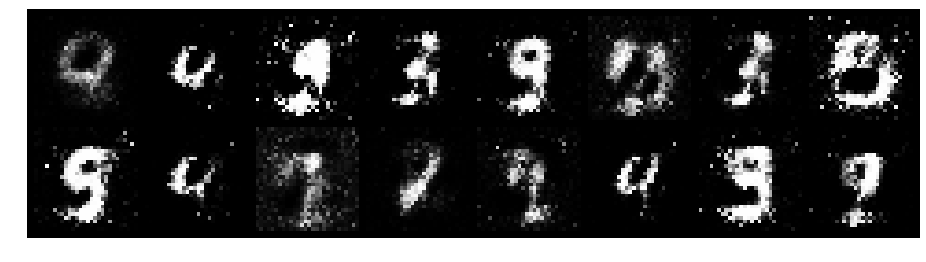

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.5623, Generator Loss: 2.6719
D(x): 0.8031, D(G(z)): 0.1790


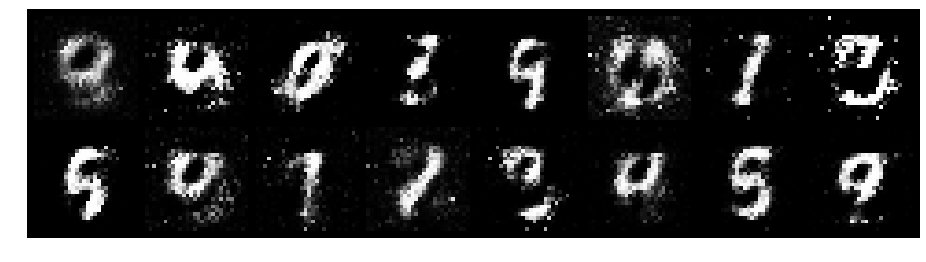

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.7218, Generator Loss: 1.7651
D(x): 0.7680, D(G(z)): 0.2372


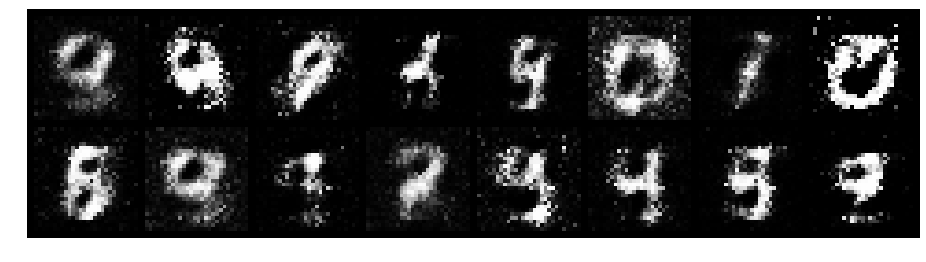

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.6829, Generator Loss: 2.8989
D(x): 0.8256, D(G(z)): 0.2273


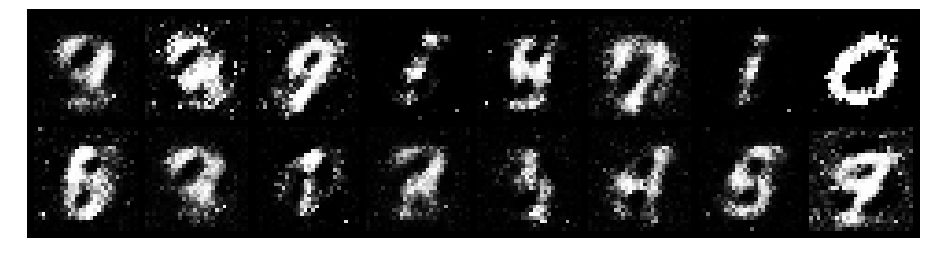

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.6016, Generator Loss: 1.9954
D(x): 0.8731, D(G(z)): 0.2427


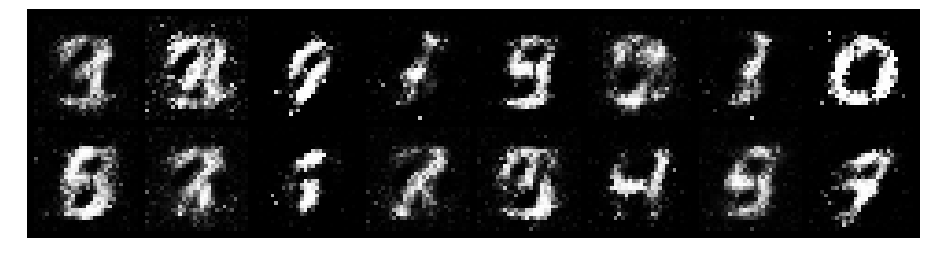

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.6492, Generator Loss: 1.8517
D(x): 0.8008, D(G(z)): 0.2439


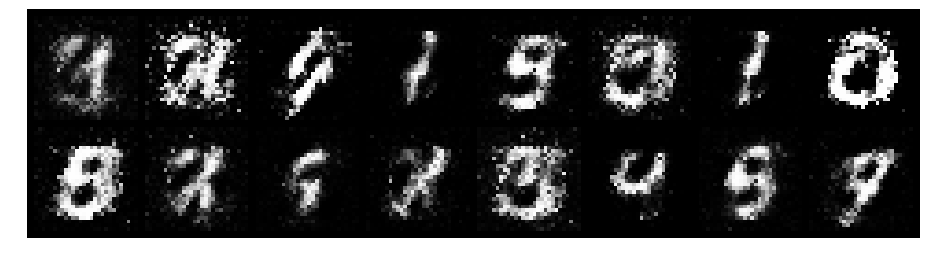

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.7878, Generator Loss: 2.0246
D(x): 0.7647, D(G(z)): 0.2384


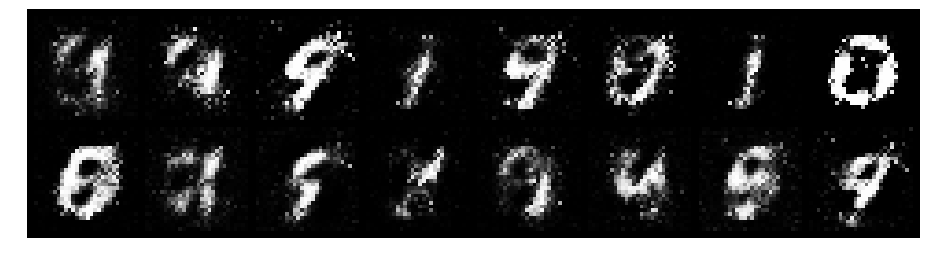

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 1.0806, Generator Loss: 1.8094
D(x): 0.6087, D(G(z)): 0.2661


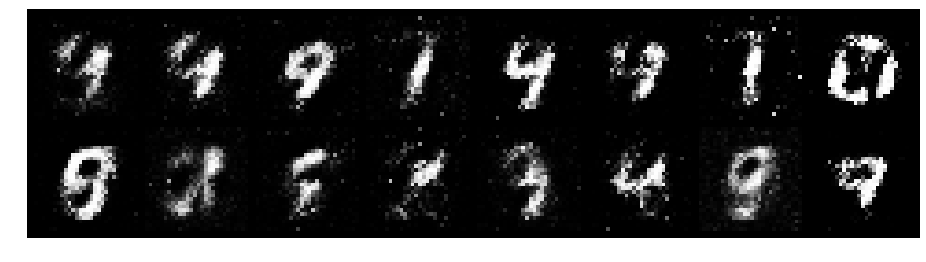

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.5056, Generator Loss: 2.3507
D(x): 0.8683, D(G(z)): 0.2278


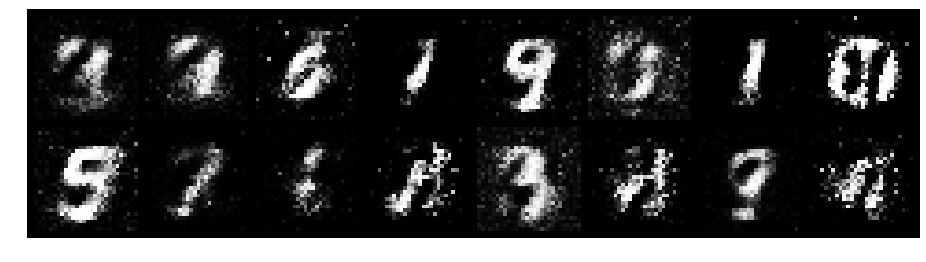

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.6523, Generator Loss: 2.4218
D(x): 0.8135, D(G(z)): 0.1945


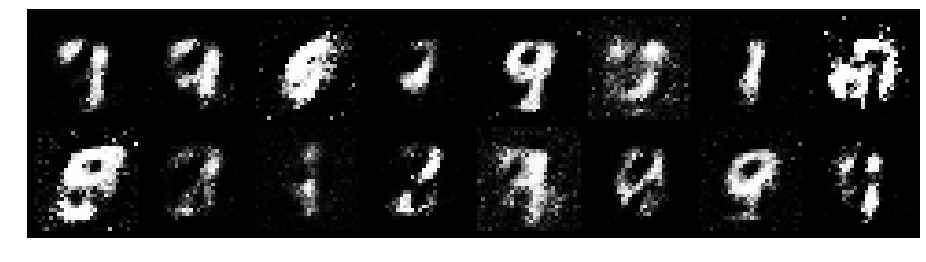

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.8279, Generator Loss: 2.2583
D(x): 0.7889, D(G(z)): 0.2756


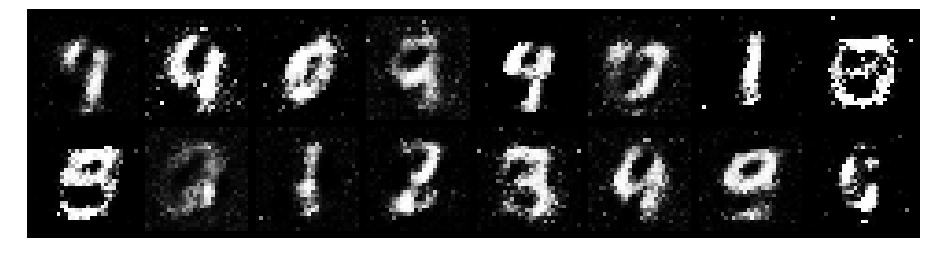

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.9853, Generator Loss: 1.6807
D(x): 0.7426, D(G(z)): 0.3581


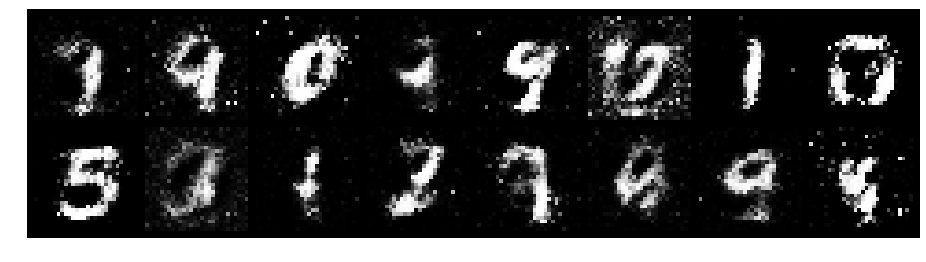

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 1.1795, Generator Loss: 2.3870
D(x): 0.6987, D(G(z)): 0.2924


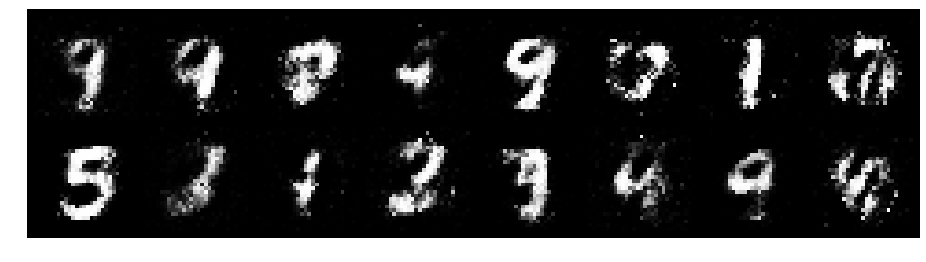

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.5785, Generator Loss: 2.9762
D(x): 0.7528, D(G(z)): 0.1194


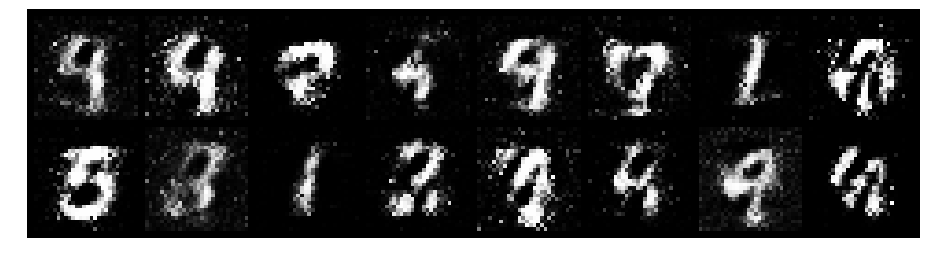

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.8690, Generator Loss: 1.6479
D(x): 0.8037, D(G(z)): 0.3363


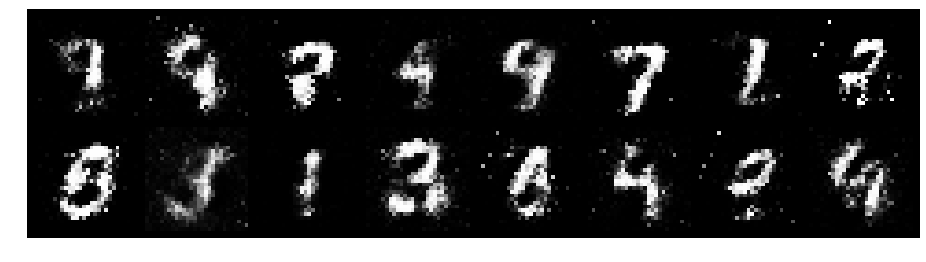

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.7750, Generator Loss: 1.5135
D(x): 0.8449, D(G(z)): 0.3644


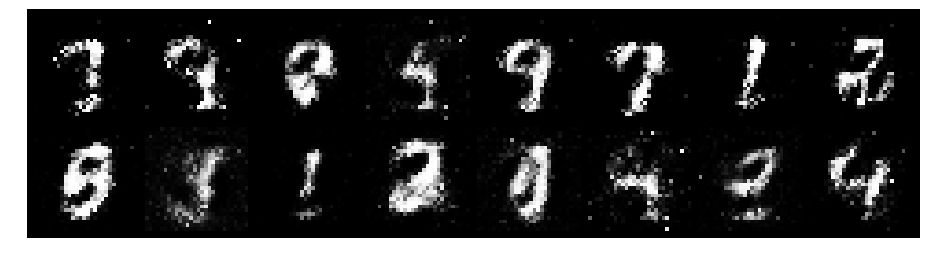

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.8425, Generator Loss: 1.7105
D(x): 0.8141, D(G(z)): 0.3525


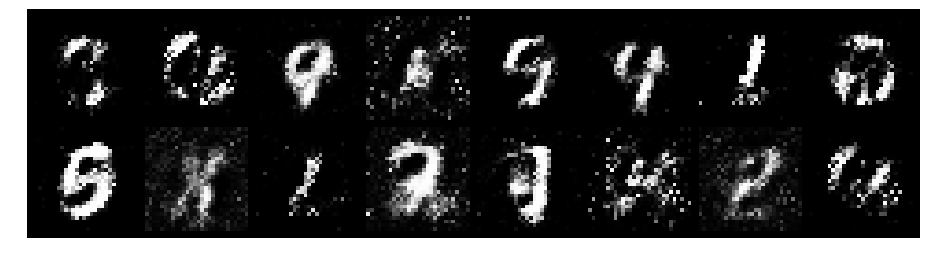

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.8109, Generator Loss: 1.3945
D(x): 0.7110, D(G(z)): 0.2753


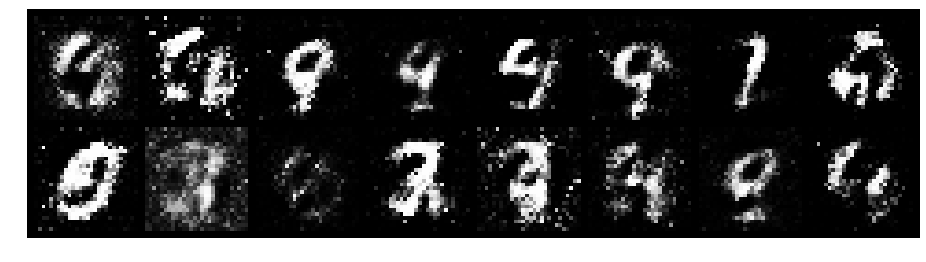

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 1.0506, Generator Loss: 1.5535
D(x): 0.6293, D(G(z)): 0.3126


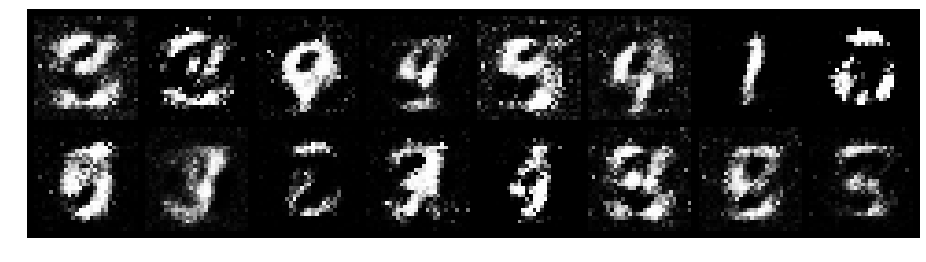

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 1.1999, Generator Loss: 1.9449
D(x): 0.5919, D(G(z)): 0.2489


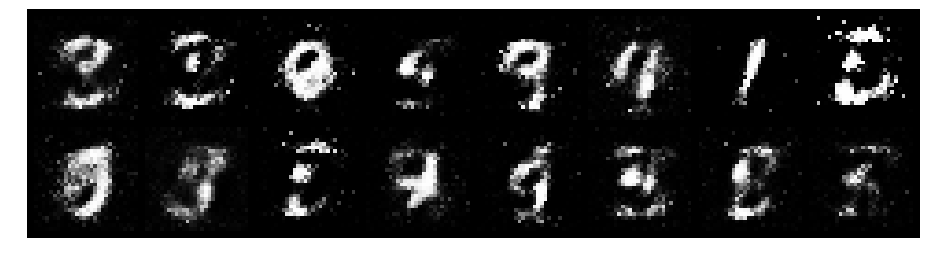

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.6847, Generator Loss: 1.7161
D(x): 0.7441, D(G(z)): 0.2114


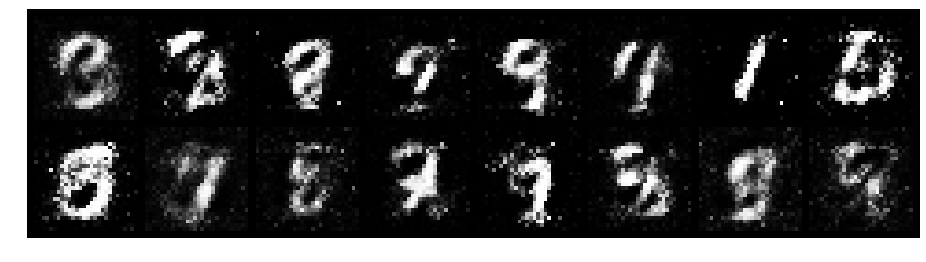

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.8126, Generator Loss: 1.9579
D(x): 0.6752, D(G(z)): 0.2081


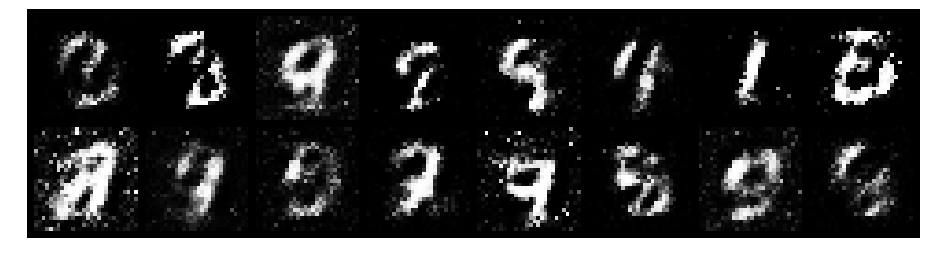

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.7234, Generator Loss: 1.7416
D(x): 0.7544, D(G(z)): 0.2160


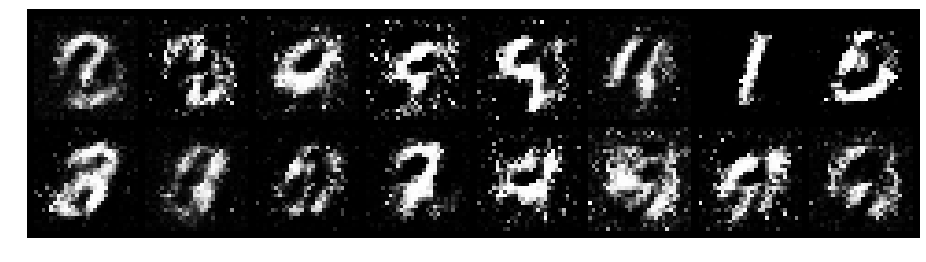

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.9026, Generator Loss: 1.8220
D(x): 0.7340, D(G(z)): 0.3126


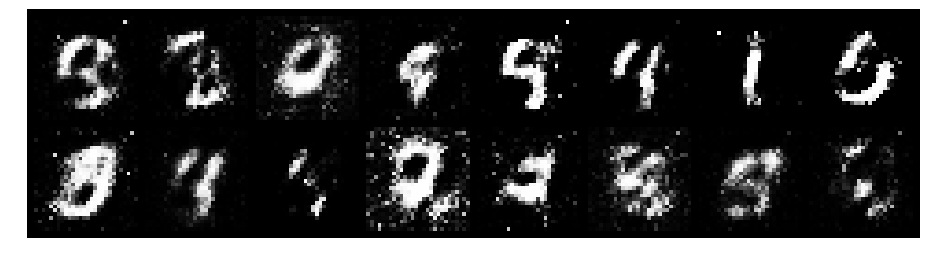

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.9348, Generator Loss: 1.6712
D(x): 0.7862, D(G(z)): 0.3588


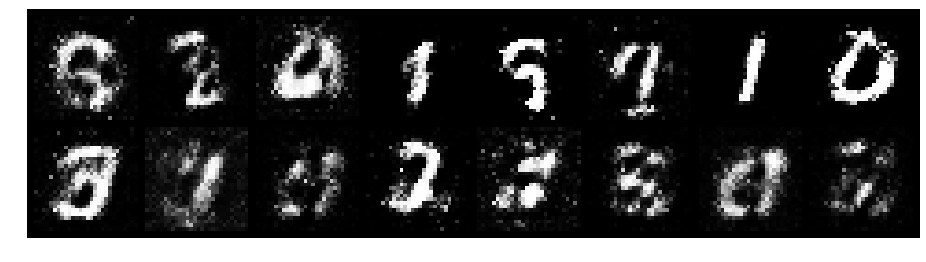

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.9228, Generator Loss: 2.4243
D(x): 0.6947, D(G(z)): 0.2349


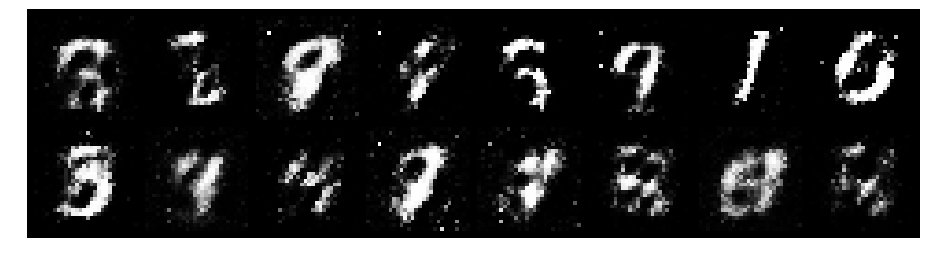

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.7946, Generator Loss: 1.7862
D(x): 0.7545, D(G(z)): 0.2651


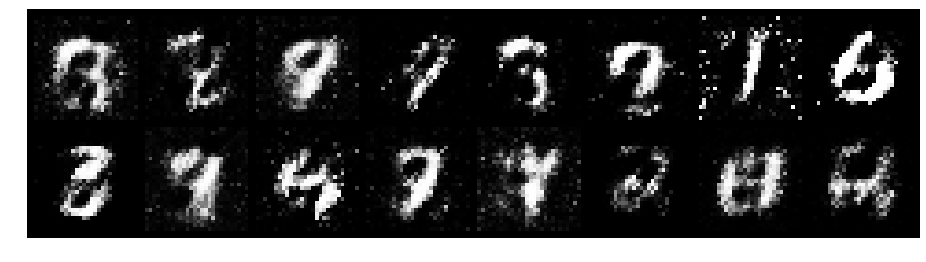

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.8715, Generator Loss: 2.1575
D(x): 0.7744, D(G(z)): 0.3196


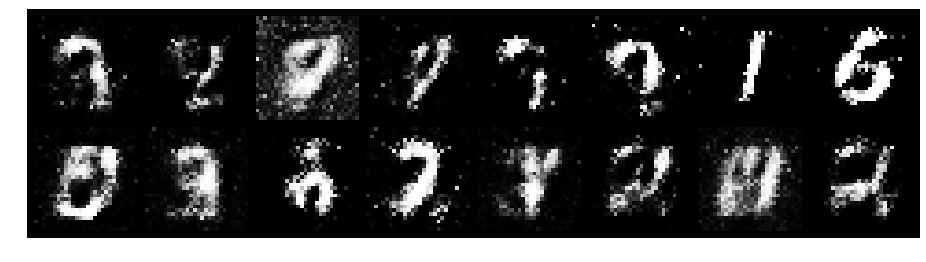

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.7311, Generator Loss: 1.6335
D(x): 0.7159, D(G(z)): 0.1806


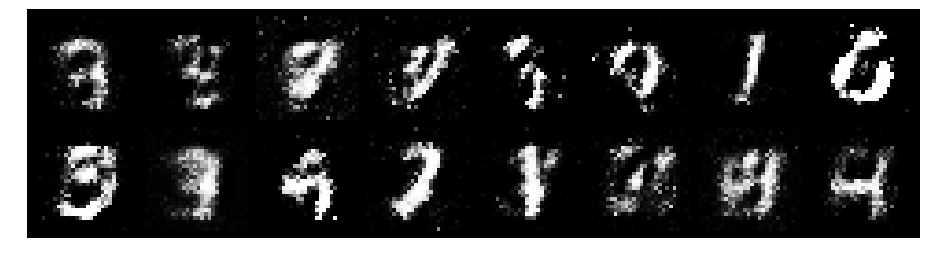

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.5364, Generator Loss: 2.6398
D(x): 0.8511, D(G(z)): 0.2119


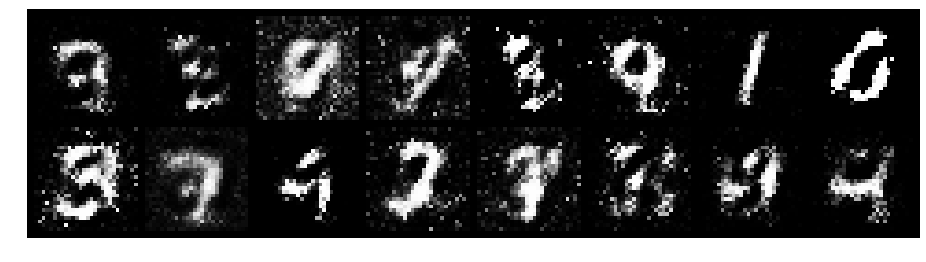

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.9248, Generator Loss: 1.1831
D(x): 0.7380, D(G(z)): 0.3736


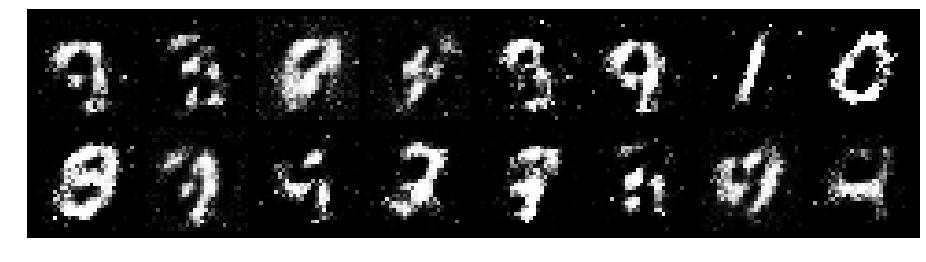

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.8861, Generator Loss: 1.4690
D(x): 0.7206, D(G(z)): 0.3294


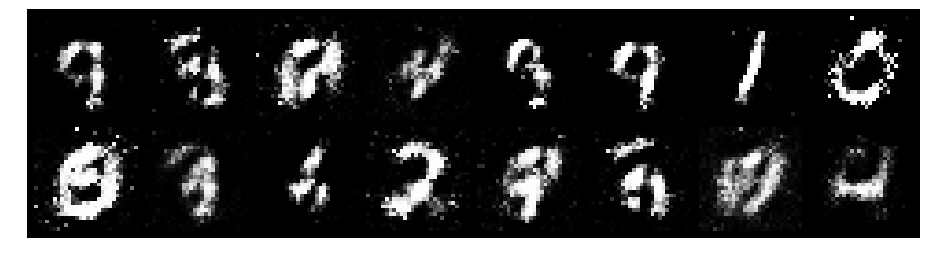

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.6842, Generator Loss: 1.9880
D(x): 0.7947, D(G(z)): 0.2368


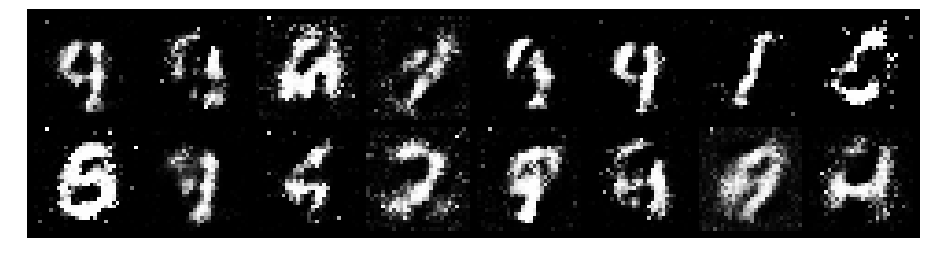

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.6835, Generator Loss: 2.0653
D(x): 0.7433, D(G(z)): 0.2019


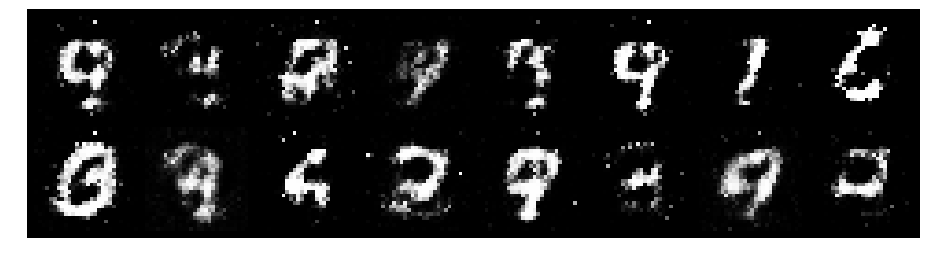

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.7694, Generator Loss: 1.8807
D(x): 0.7837, D(G(z)): 0.2988


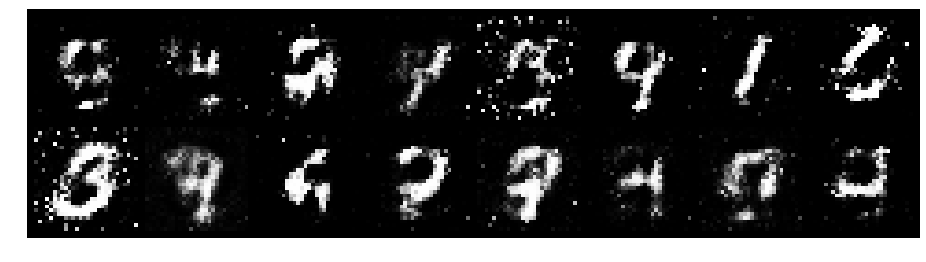

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.7187, Generator Loss: 2.0221
D(x): 0.7130, D(G(z)): 0.2123


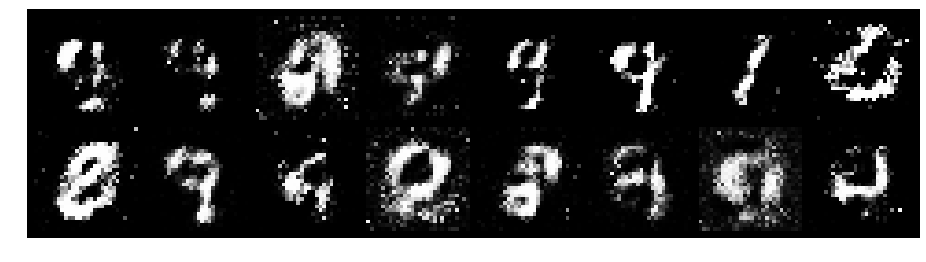

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.7261, Generator Loss: 1.5111
D(x): 0.7319, D(G(z)): 0.2430


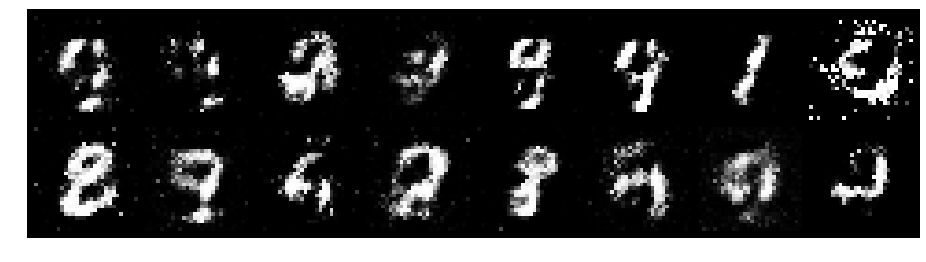

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.8525, Generator Loss: 1.4339
D(x): 0.7521, D(G(z)): 0.3110


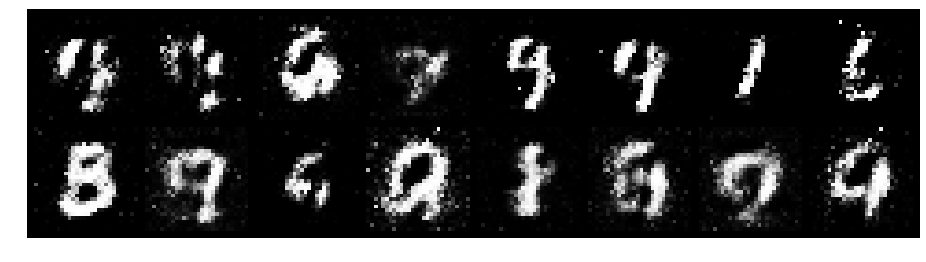

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 1.0648, Generator Loss: 1.7914
D(x): 0.6943, D(G(z)): 0.3187


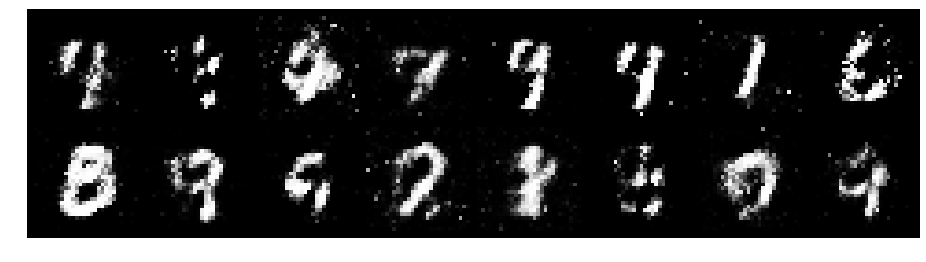

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.9102, Generator Loss: 1.3716
D(x): 0.7298, D(G(z)): 0.2979


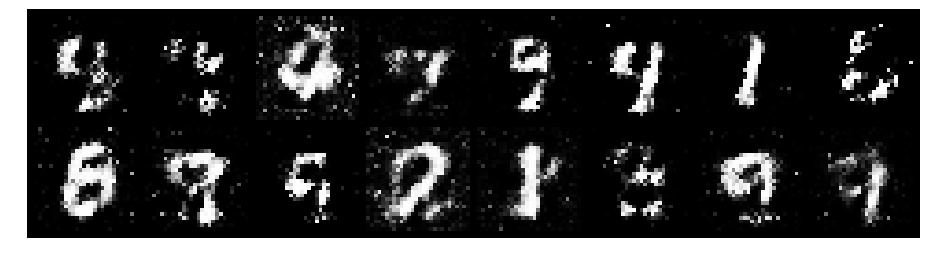

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.5459, Generator Loss: 1.7092
D(x): 0.8321, D(G(z)): 0.2369


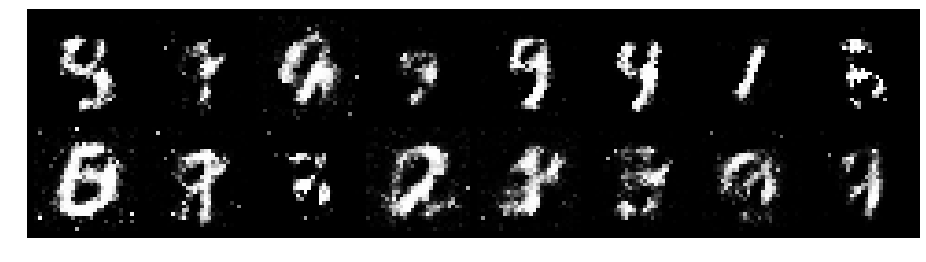

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.6717, Generator Loss: 2.1305
D(x): 0.7513, D(G(z)): 0.2016


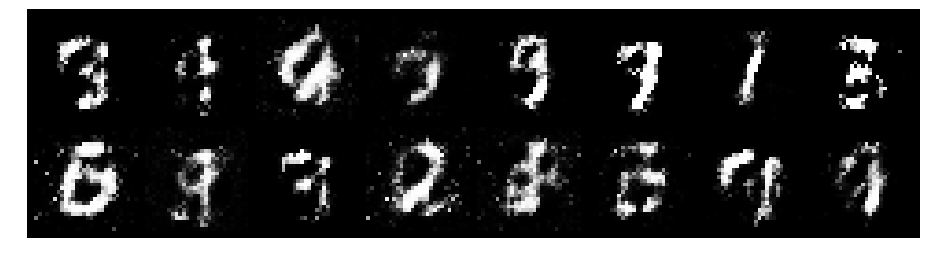

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.7868, Generator Loss: 1.8208
D(x): 0.7153, D(G(z)): 0.2511


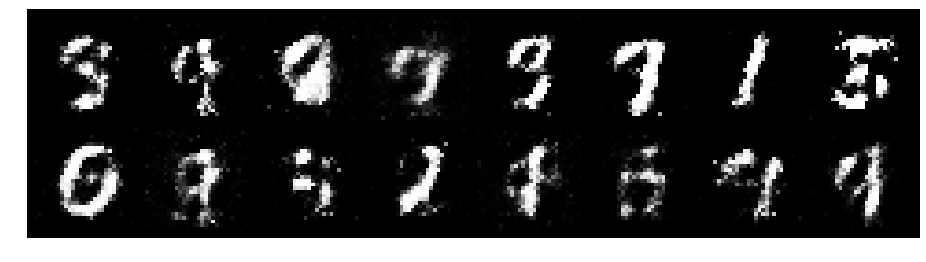

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 1.1690, Generator Loss: 1.4067
D(x): 0.5880, D(G(z)): 0.2799


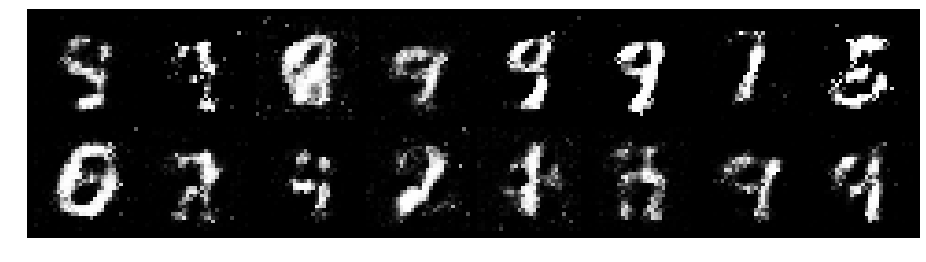

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.9257, Generator Loss: 2.0319
D(x): 0.7959, D(G(z)): 0.3273


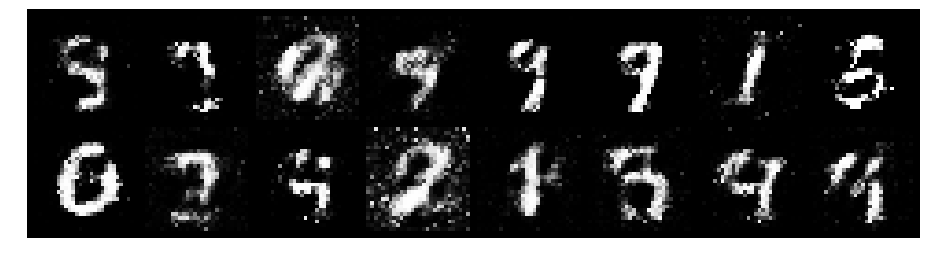

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.8917, Generator Loss: 1.7488
D(x): 0.7046, D(G(z)): 0.3057


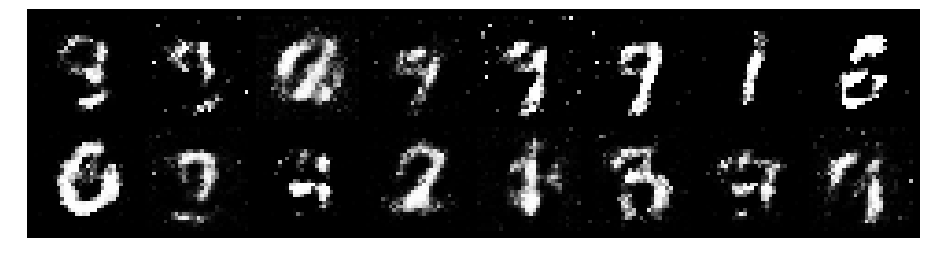

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.9930, Generator Loss: 1.8013
D(x): 0.6212, D(G(z)): 0.2367


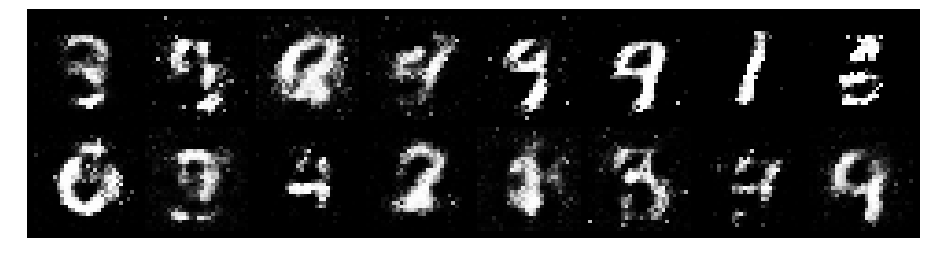

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.6558, Generator Loss: 1.5374
D(x): 0.8388, D(G(z)): 0.2923


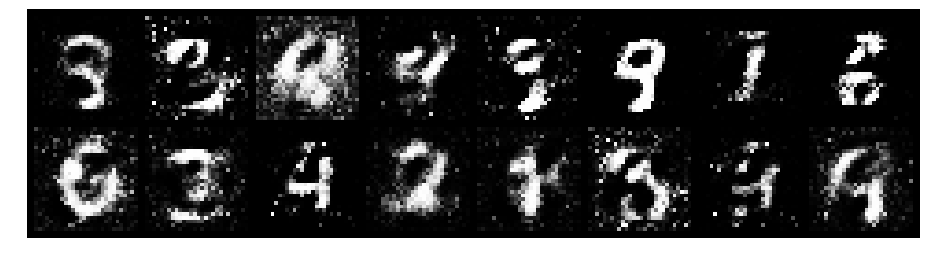

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.9233, Generator Loss: 1.2231
D(x): 0.6826, D(G(z)): 0.3165


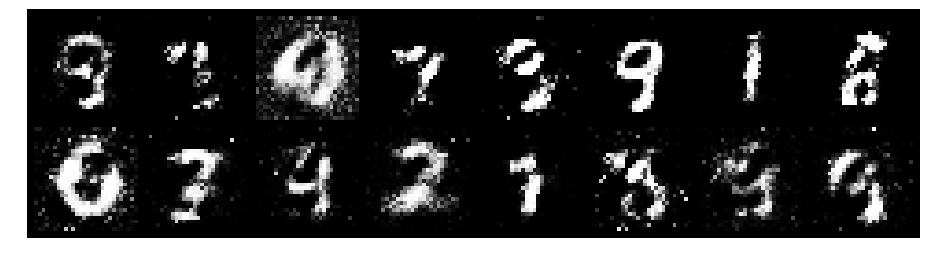

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 1.0623, Generator Loss: 1.2286
D(x): 0.6176, D(G(z)): 0.3381


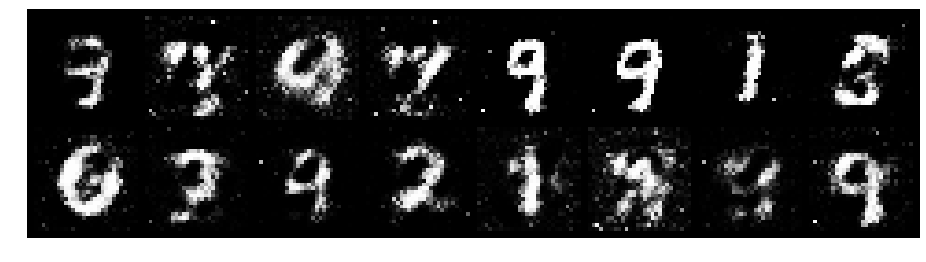

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.9036, Generator Loss: 1.3683
D(x): 0.7002, D(G(z)): 0.3288


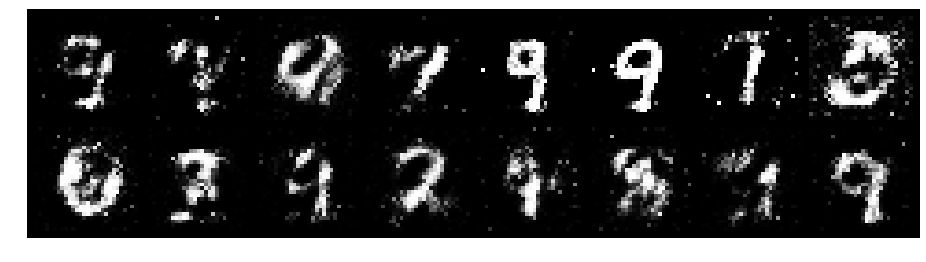

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8116, Generator Loss: 2.1840
D(x): 0.7485, D(G(z)): 0.2751


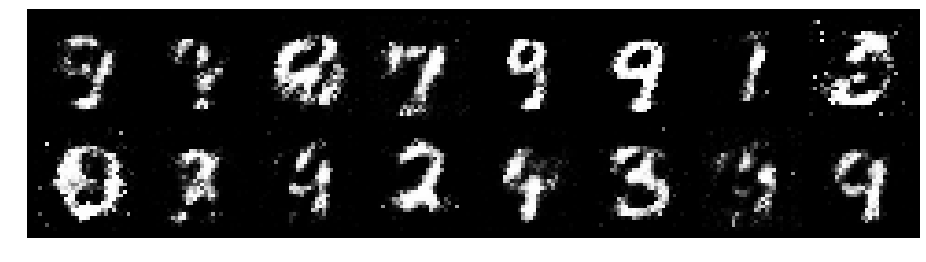

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.6425, Generator Loss: 2.2188
D(x): 0.7960, D(G(z)): 0.2100


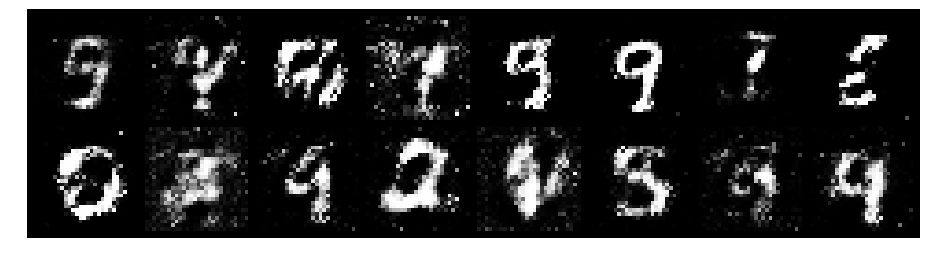

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.9169, Generator Loss: 1.7774
D(x): 0.6885, D(G(z)): 0.2679


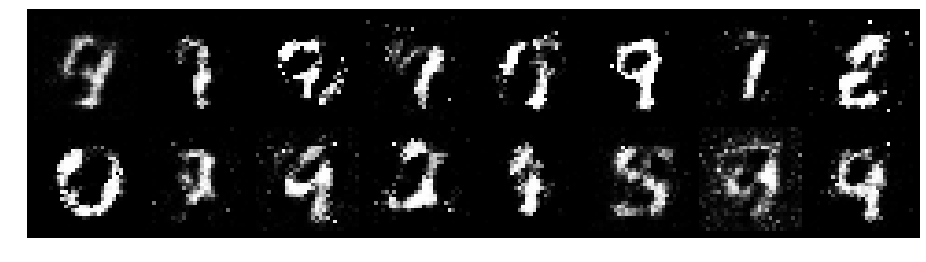

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 1.0381, Generator Loss: 1.3186
D(x): 0.6663, D(G(z)): 0.3700


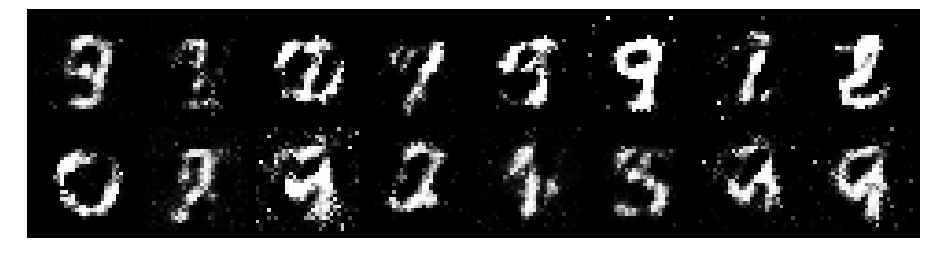

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.8922, Generator Loss: 1.1862
D(x): 0.7364, D(G(z)): 0.3461


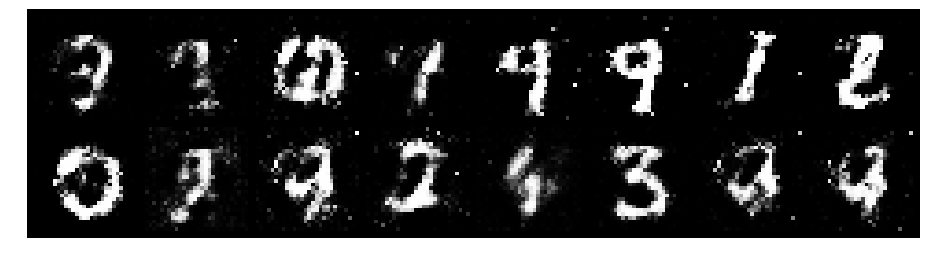

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.8538, Generator Loss: 1.5143
D(x): 0.7444, D(G(z)): 0.3052


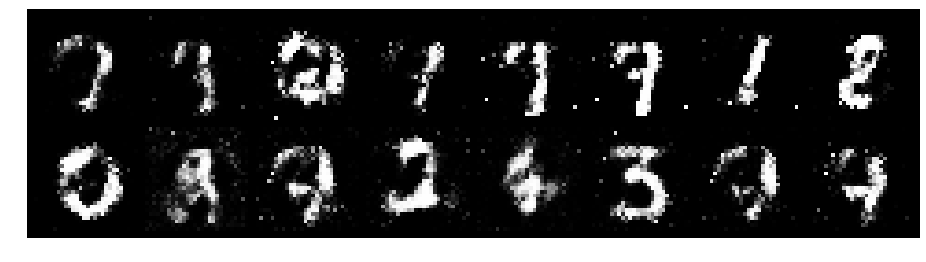

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 1.0390, Generator Loss: 1.5419
D(x): 0.5748, D(G(z)): 0.2609


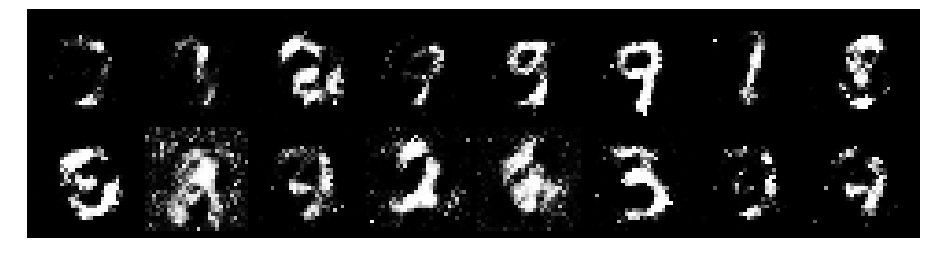

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.8993, Generator Loss: 2.0147
D(x): 0.6621, D(G(z)): 0.2620


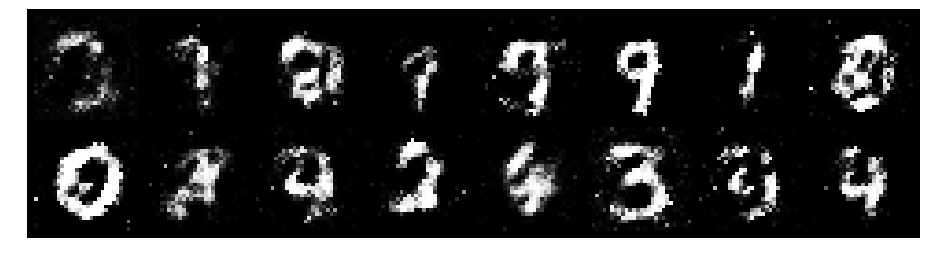

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.9227, Generator Loss: 1.3130
D(x): 0.7009, D(G(z)): 0.3464


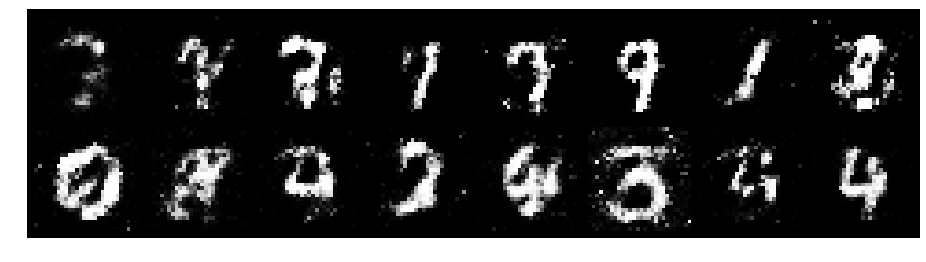

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8821, Generator Loss: 1.4194
D(x): 0.7069, D(G(z)): 0.3251


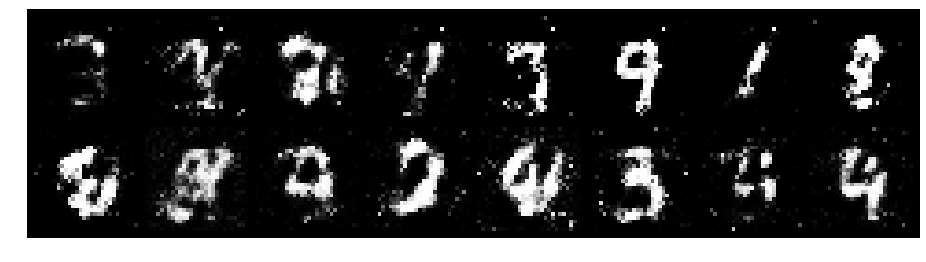

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.9115, Generator Loss: 1.6092
D(x): 0.7052, D(G(z)): 0.3483


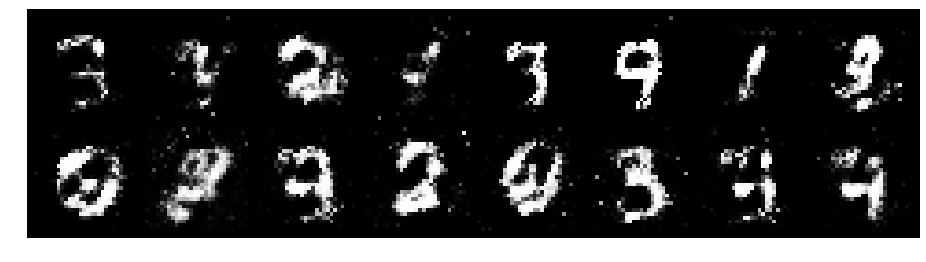

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.8168, Generator Loss: 1.6222
D(x): 0.7010, D(G(z)): 0.2701


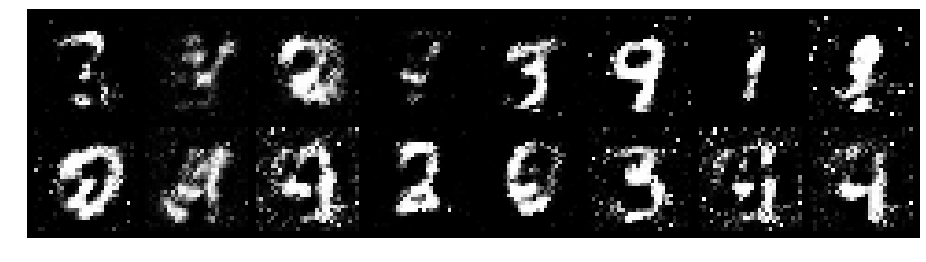

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9061, Generator Loss: 1.1870
D(x): 0.7121, D(G(z)): 0.3614


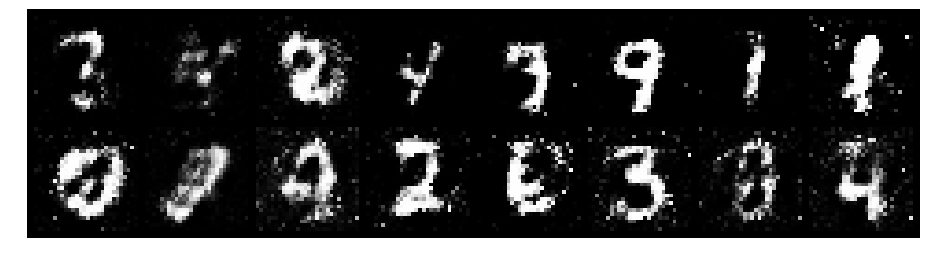

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.0109, Generator Loss: 1.6249
D(x): 0.6904, D(G(z)): 0.3403


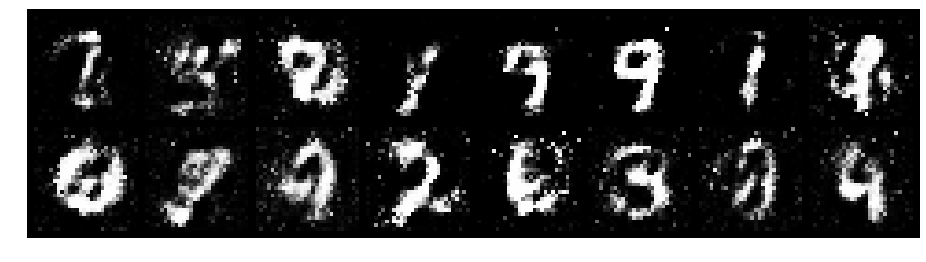

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 1.2604, Generator Loss: 1.2827
D(x): 0.5612, D(G(z)): 0.3288


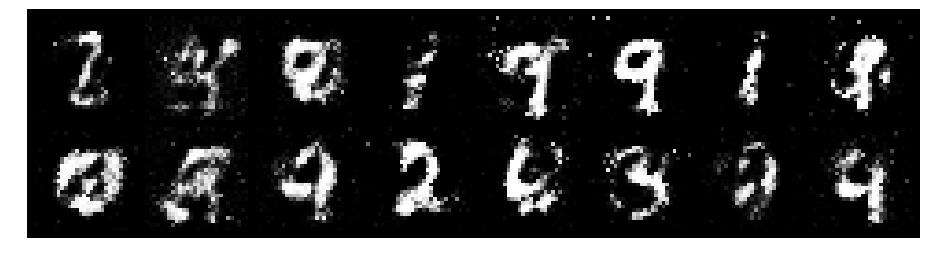

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 1.0366, Generator Loss: 1.1787
D(x): 0.7034, D(G(z)): 0.3913


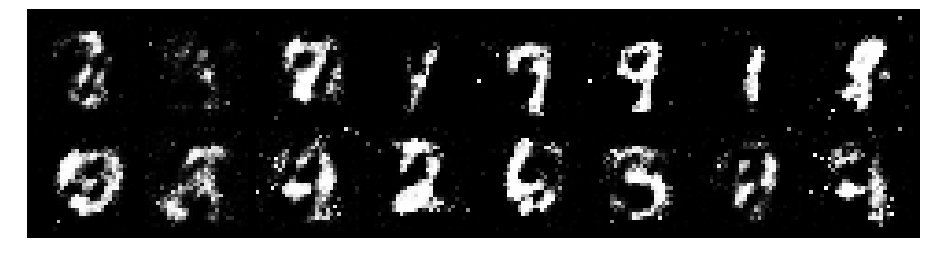

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 1.1078, Generator Loss: 1.1994
D(x): 0.5844, D(G(z)): 0.3308


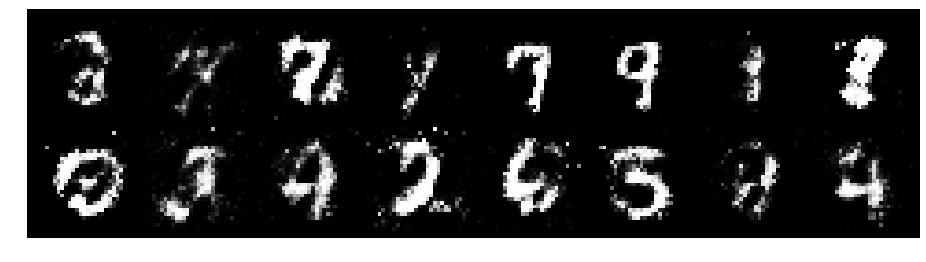

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 1.1937, Generator Loss: 1.3498
D(x): 0.5875, D(G(z)): 0.3318


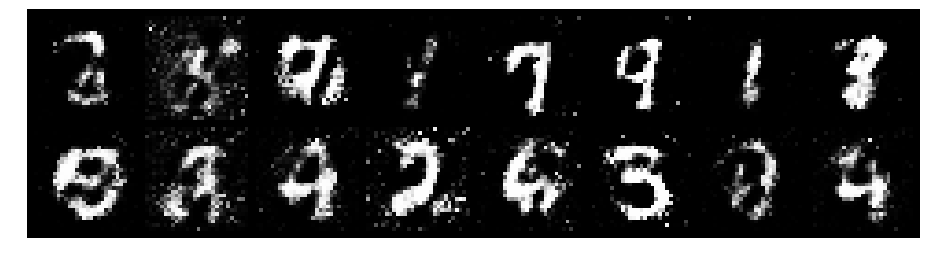

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 1.2270, Generator Loss: 1.4811
D(x): 0.6091, D(G(z)): 0.3776


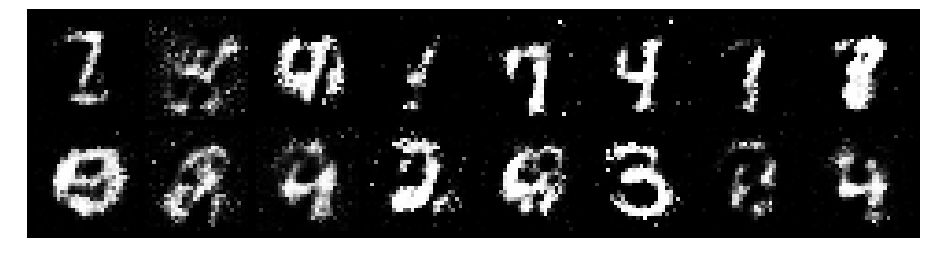

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 1.0325, Generator Loss: 1.3399
D(x): 0.6878, D(G(z)): 0.3698


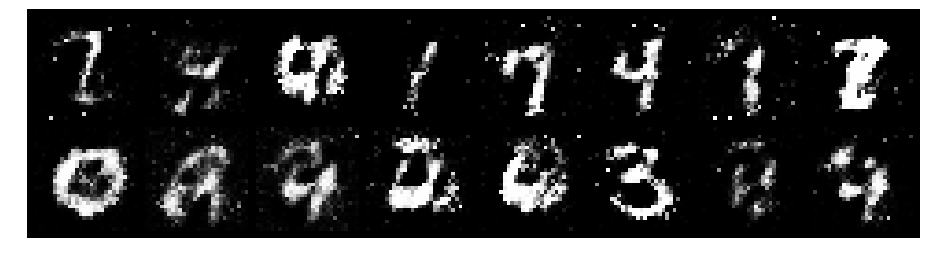

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.9695, Generator Loss: 1.8055
D(x): 0.7349, D(G(z)): 0.3121


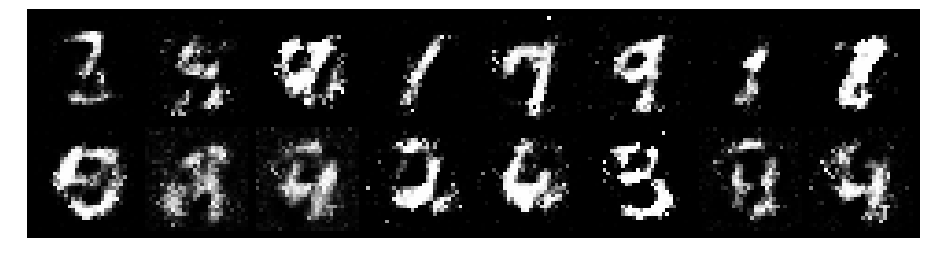

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.6685, Generator Loss: 2.2004
D(x): 0.7657, D(G(z)): 0.2218


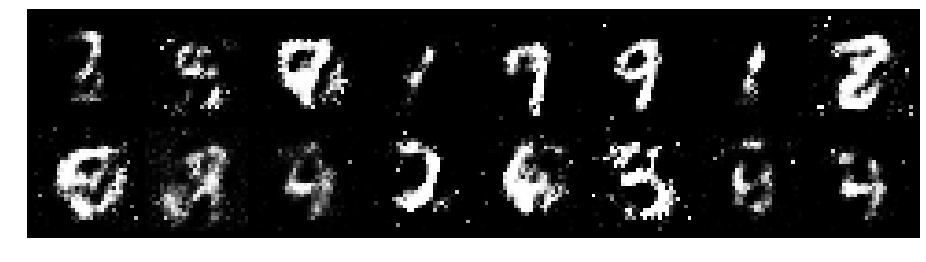

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.7824, Generator Loss: 1.3357
D(x): 0.7520, D(G(z)): 0.2904


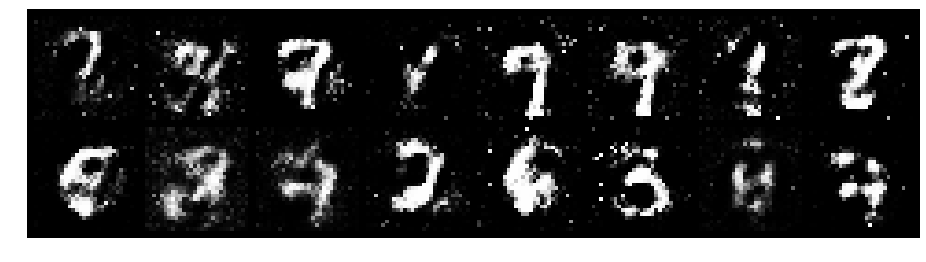

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 1.0941, Generator Loss: 1.4339
D(x): 0.6217, D(G(z)): 0.3009


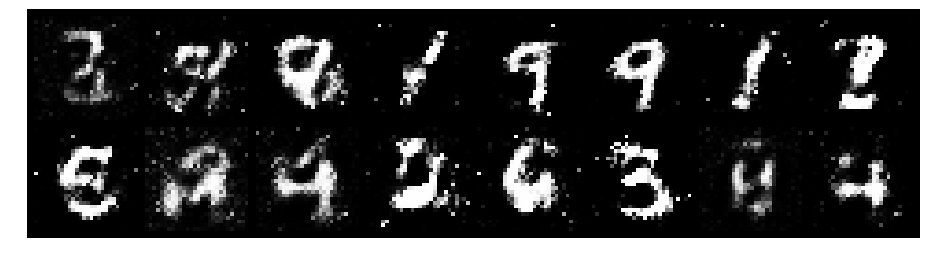

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.9136, Generator Loss: 1.5156
D(x): 0.7117, D(G(z)): 0.3353


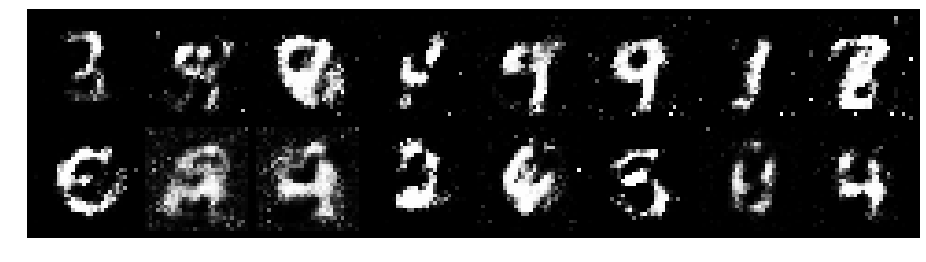

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.8991, Generator Loss: 1.7638
D(x): 0.6142, D(G(z)): 0.2169


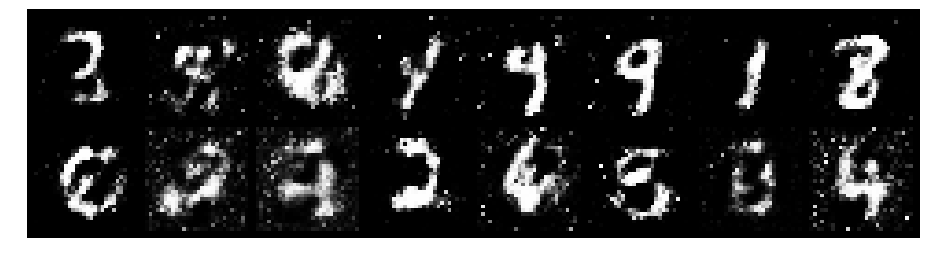

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0742, Generator Loss: 1.1165
D(x): 0.7365, D(G(z)): 0.4433


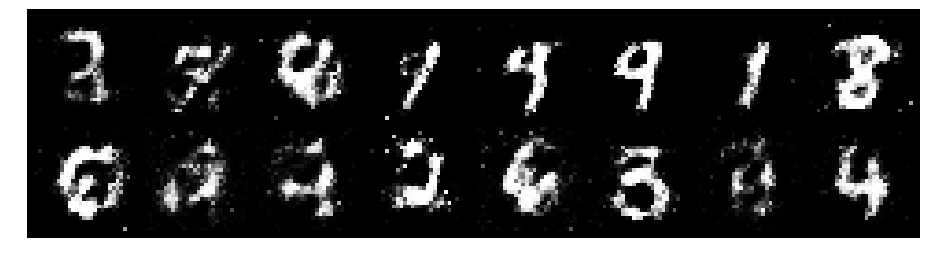

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.0846, Generator Loss: 1.0718
D(x): 0.7059, D(G(z)): 0.4103


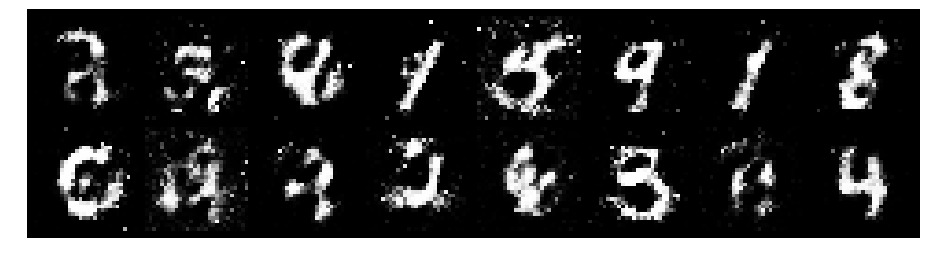

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.1919, Generator Loss: 1.1362
D(x): 0.6340, D(G(z)): 0.3993


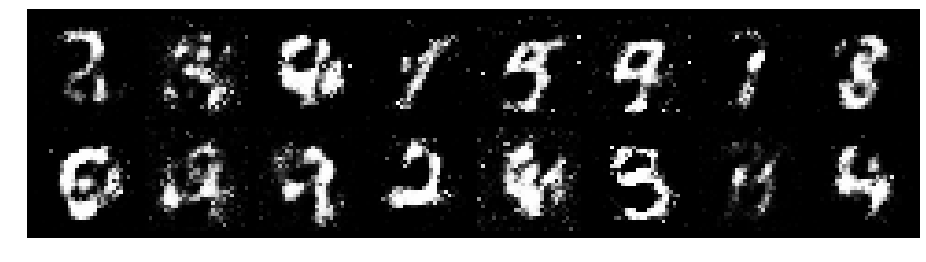

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.9222, Generator Loss: 1.4899
D(x): 0.6643, D(G(z)): 0.3164


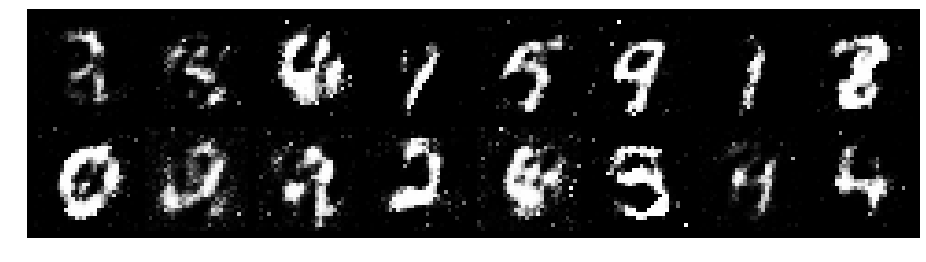

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.9765, Generator Loss: 1.5905
D(x): 0.6604, D(G(z)): 0.2836


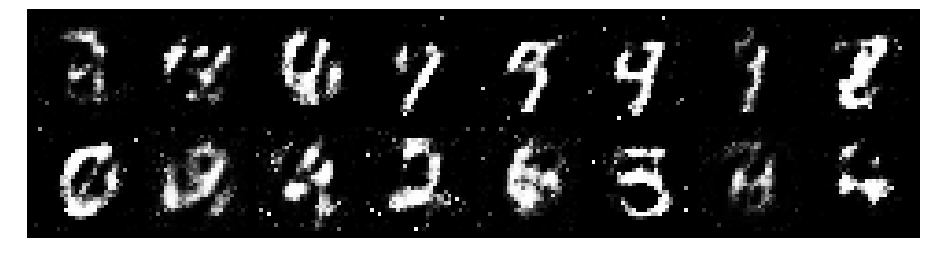

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.9007, Generator Loss: 1.6790
D(x): 0.7600, D(G(z)): 0.3496


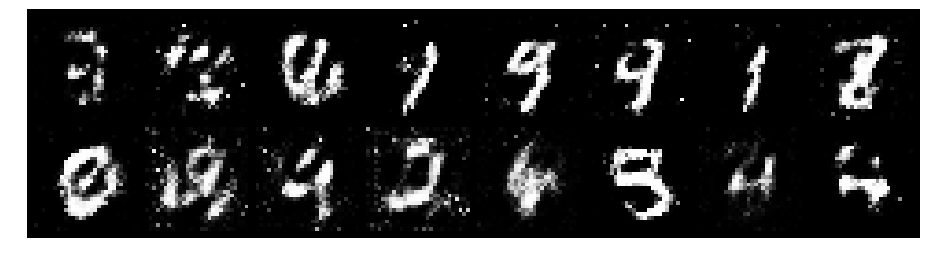

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.8796, Generator Loss: 1.7239
D(x): 0.6602, D(G(z)): 0.2900


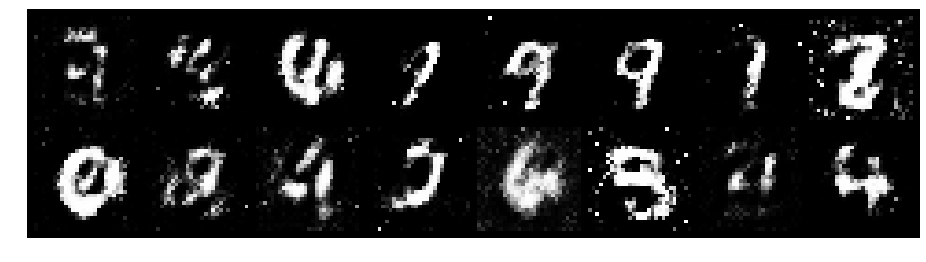

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 1.0463, Generator Loss: 1.1047
D(x): 0.6696, D(G(z)): 0.3190


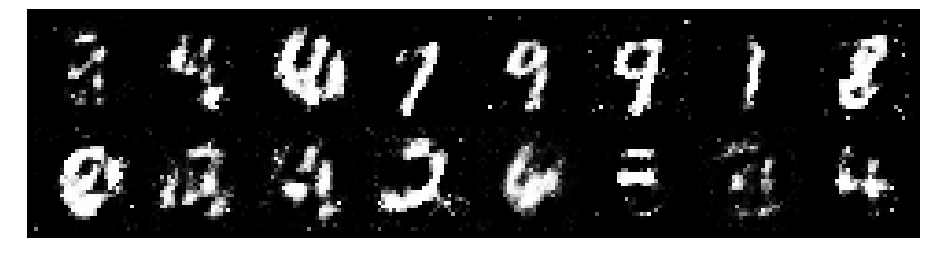

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.8816, Generator Loss: 1.8159
D(x): 0.6582, D(G(z)): 0.2094


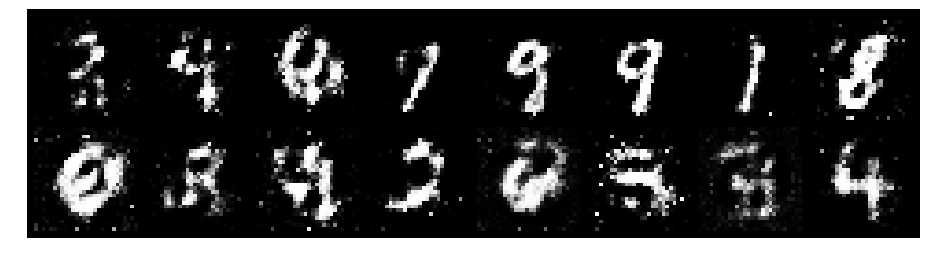

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.9096, Generator Loss: 1.7380
D(x): 0.7398, D(G(z)): 0.3376


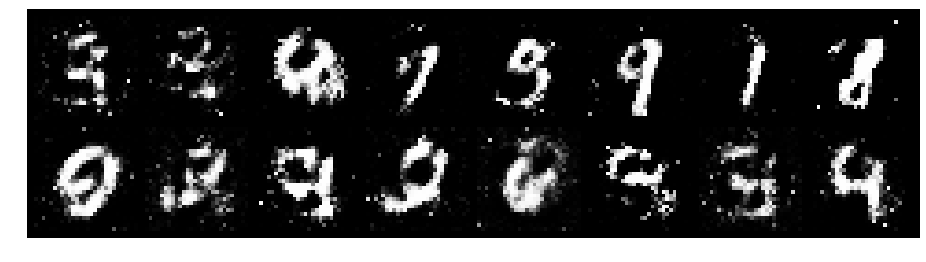

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.9623, Generator Loss: 1.0830
D(x): 0.7306, D(G(z)): 0.3744


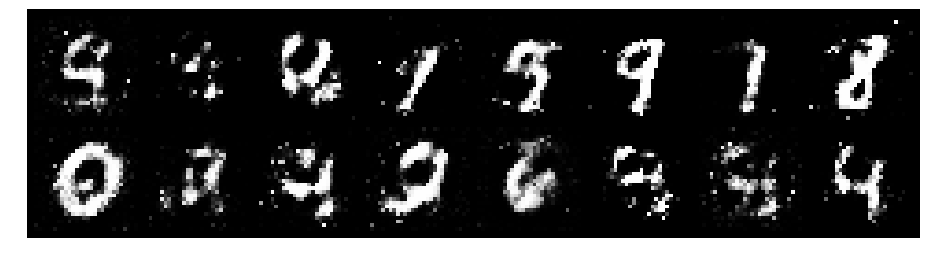

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.7986, Generator Loss: 1.6998
D(x): 0.7082, D(G(z)): 0.2549


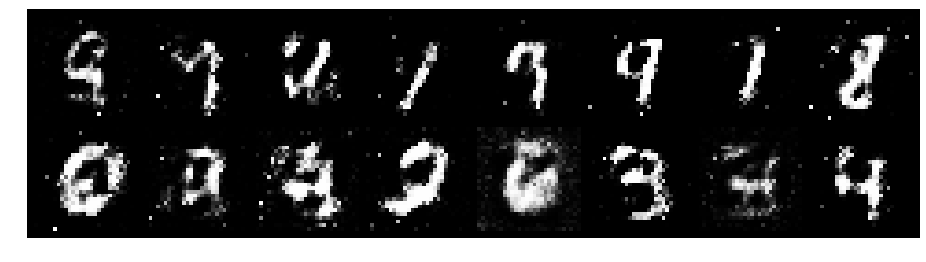

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 0.8534, Generator Loss: 1.7238
D(x): 0.7633, D(G(z)): 0.3245


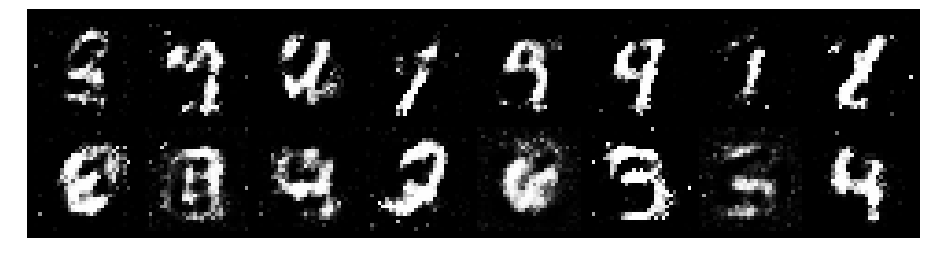

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.9289, Generator Loss: 1.8372
D(x): 0.6456, D(G(z)): 0.2303


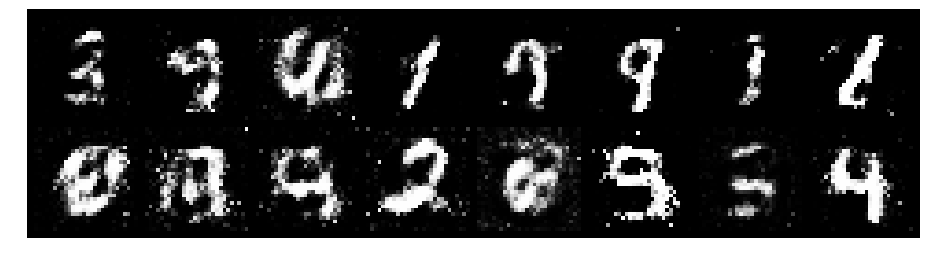

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 0.9521, Generator Loss: 1.5255
D(x): 0.7458, D(G(z)): 0.3634


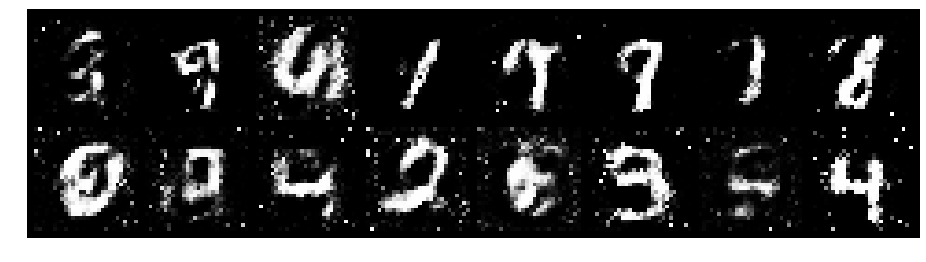

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.1961, Generator Loss: 1.5683
D(x): 0.6044, D(G(z)): 0.3103


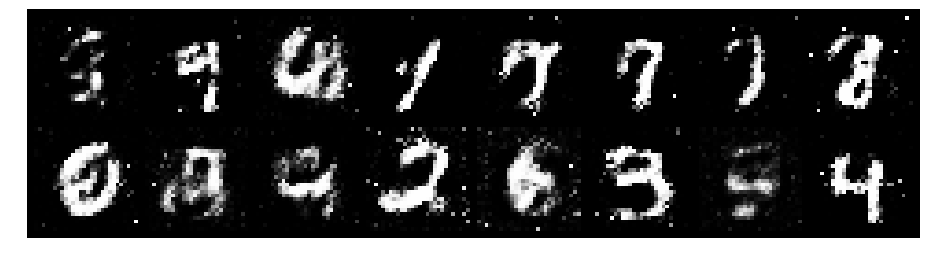

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 1.1001, Generator Loss: 1.2442
D(x): 0.6241, D(G(z)): 0.3504


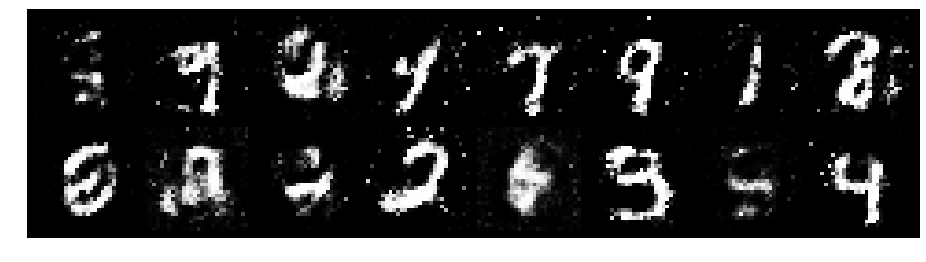

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.9319, Generator Loss: 1.6200
D(x): 0.6234, D(G(z)): 0.2413


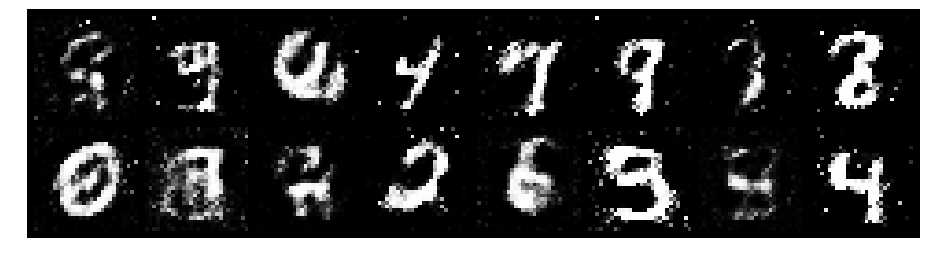

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9378, Generator Loss: 1.4895
D(x): 0.6723, D(G(z)): 0.3011


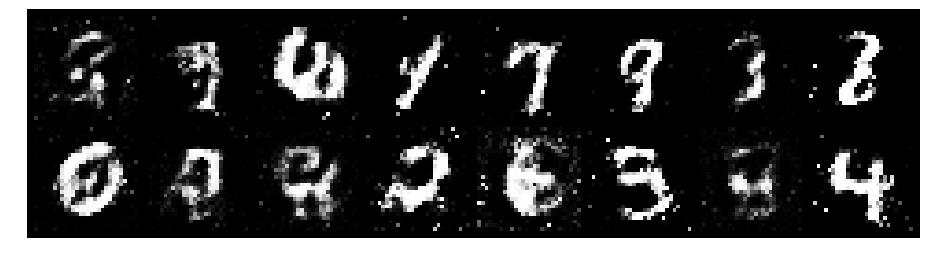

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.0617, Generator Loss: 1.2533
D(x): 0.6740, D(G(z)): 0.3556


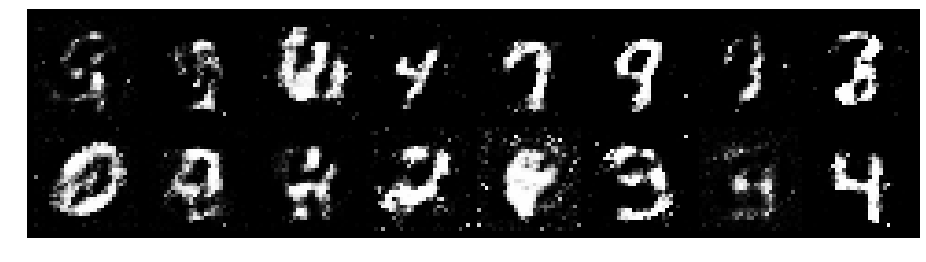

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.9423, Generator Loss: 1.3093
D(x): 0.6947, D(G(z)): 0.2752


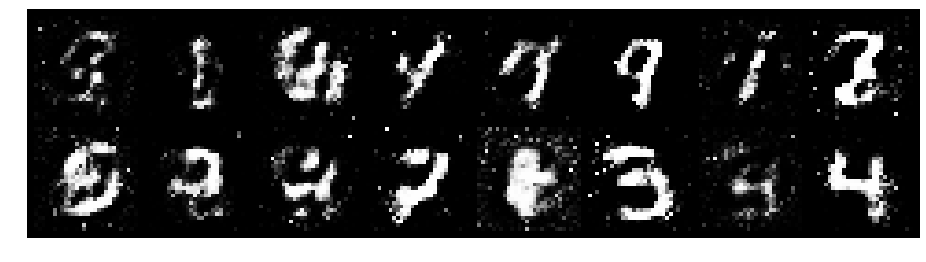

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.9743, Generator Loss: 1.2662
D(x): 0.6724, D(G(z)): 0.3369


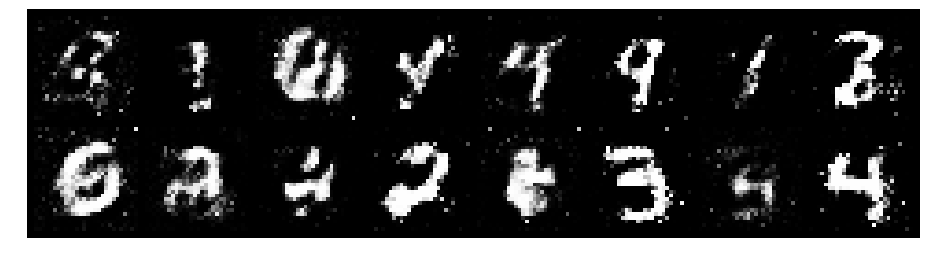

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.8883, Generator Loss: 1.7721
D(x): 0.6249, D(G(z)): 0.2231


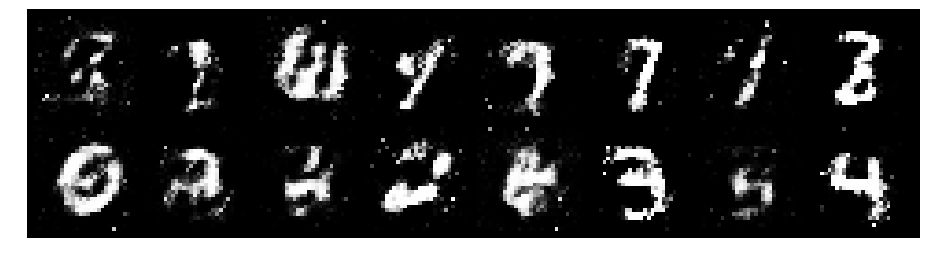

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.8112, Generator Loss: 2.0652
D(x): 0.7259, D(G(z)): 0.2812


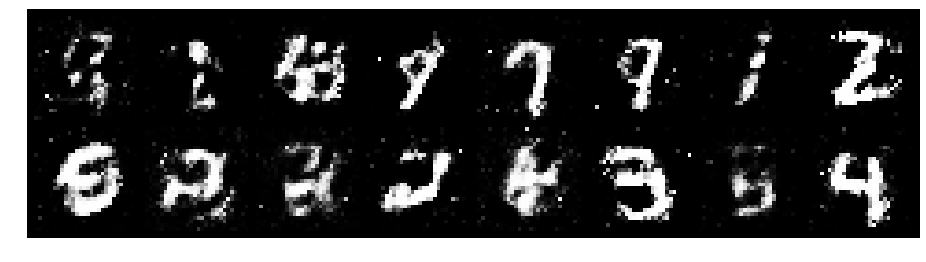

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.8229, Generator Loss: 1.8365
D(x): 0.6860, D(G(z)): 0.2494


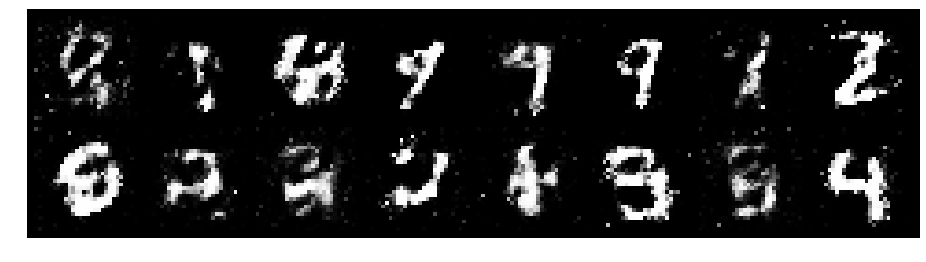

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.8433, Generator Loss: 1.3905
D(x): 0.7149, D(G(z)): 0.3052


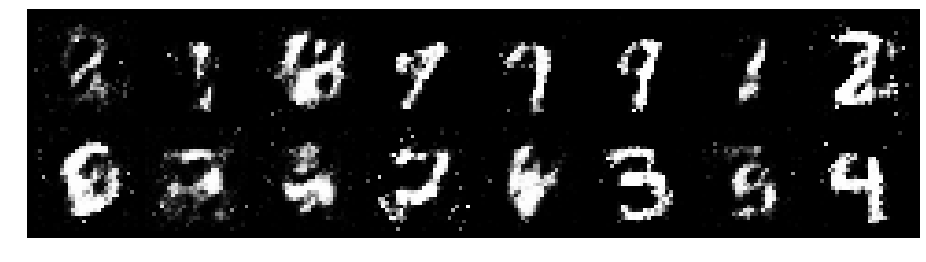

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.8709, Generator Loss: 1.6123
D(x): 0.7285, D(G(z)): 0.3316


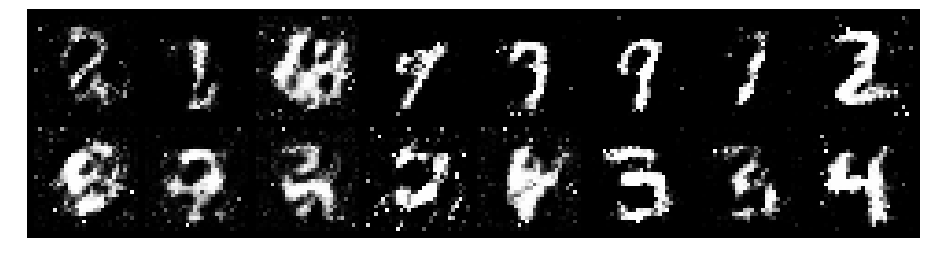

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.8598, Generator Loss: 1.8050
D(x): 0.6814, D(G(z)): 0.2953


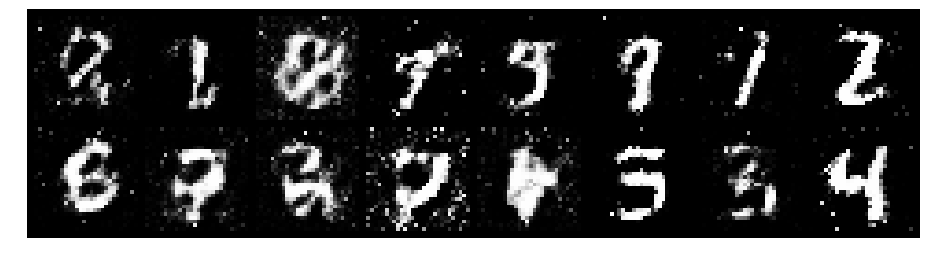

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.0080, Generator Loss: 1.3229
D(x): 0.6414, D(G(z)): 0.3429


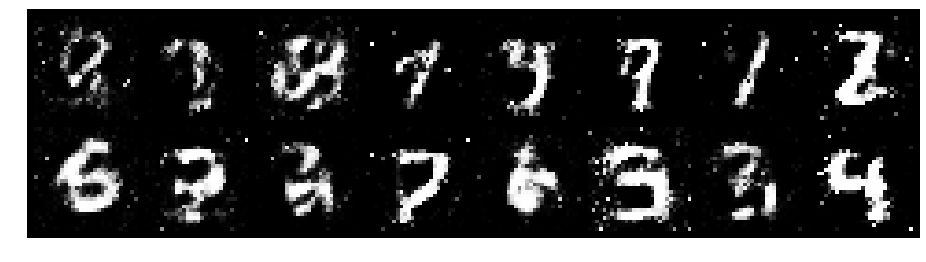

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.0445, Generator Loss: 1.5575
D(x): 0.6756, D(G(z)): 0.3817


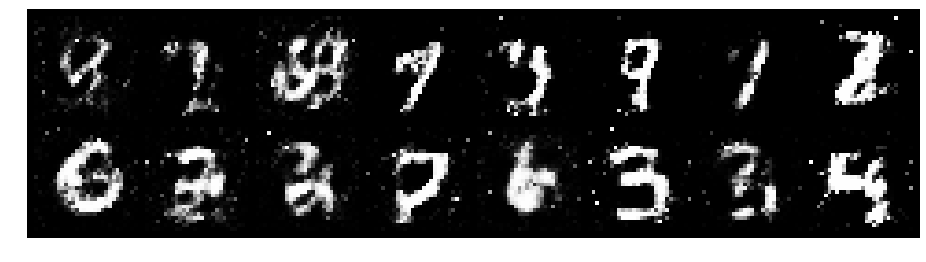

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.9457, Generator Loss: 1.2913
D(x): 0.6894, D(G(z)): 0.3322


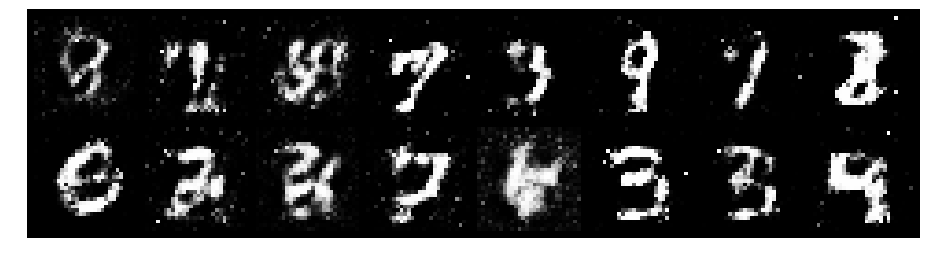

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.8946, Generator Loss: 1.4740
D(x): 0.7420, D(G(z)): 0.3493


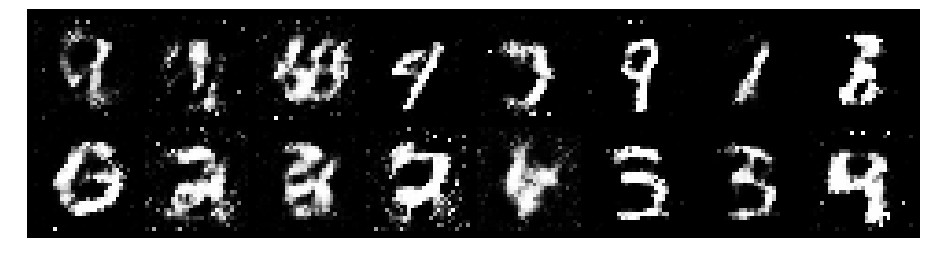

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9897, Generator Loss: 1.3847
D(x): 0.6819, D(G(z)): 0.3342


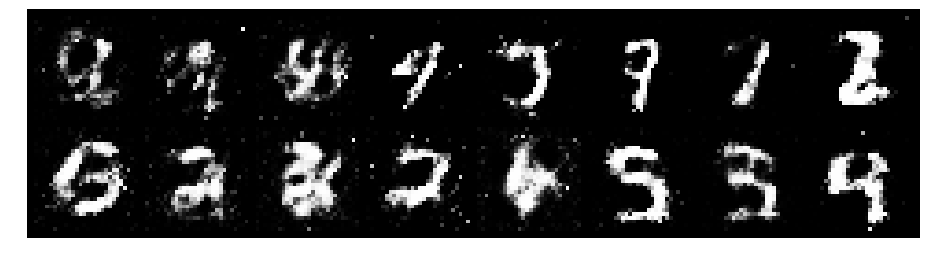

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.2075, Generator Loss: 1.1979
D(x): 0.6578, D(G(z)): 0.4119


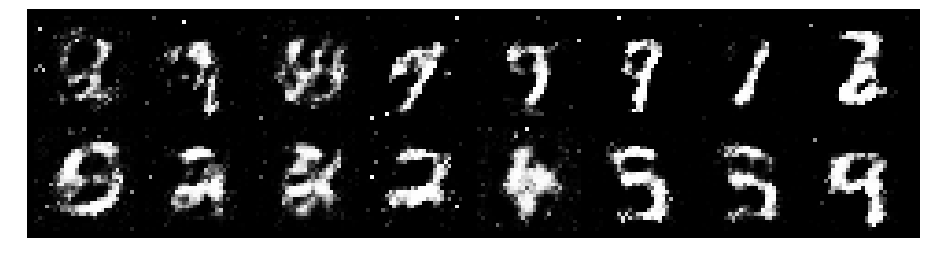

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 0.9414, Generator Loss: 1.3064
D(x): 0.7498, D(G(z)): 0.3640


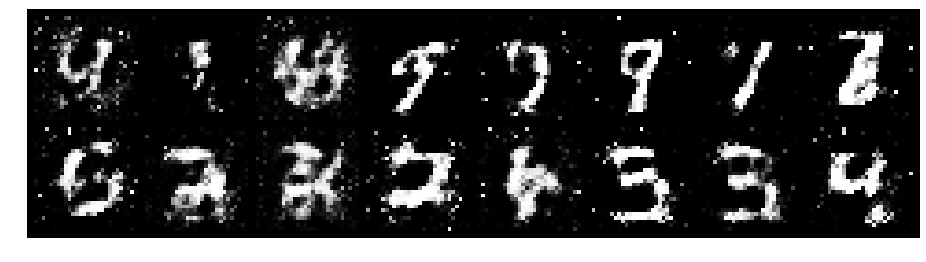

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.8161, Generator Loss: 1.6635
D(x): 0.7145, D(G(z)): 0.2883


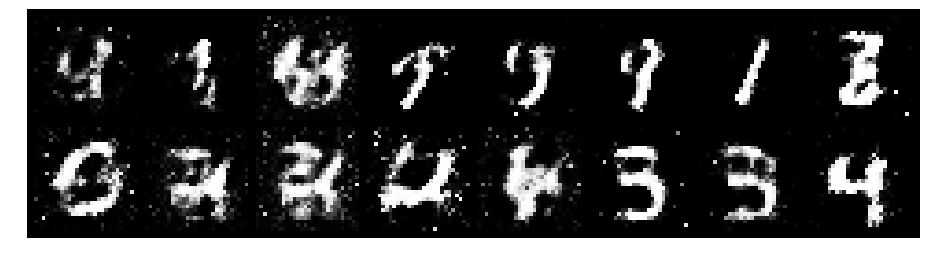

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.8911, Generator Loss: 1.4247
D(x): 0.6668, D(G(z)): 0.2691


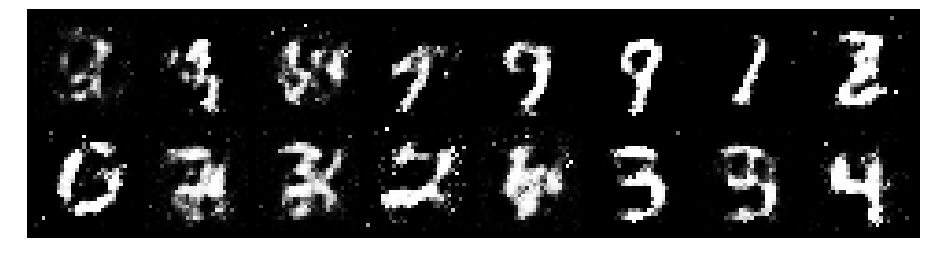

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.1875, Generator Loss: 1.2565
D(x): 0.5885, D(G(z)): 0.3625


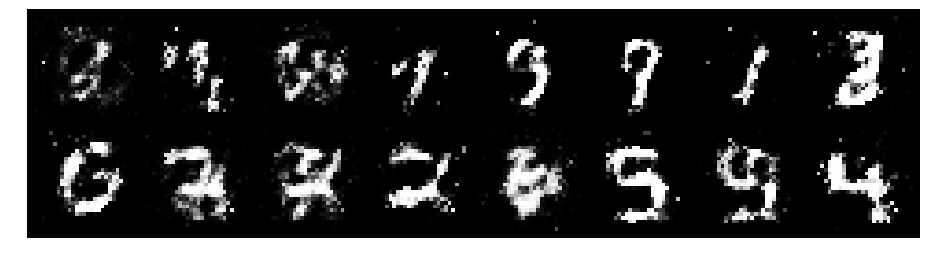

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.9689, Generator Loss: 1.4964
D(x): 0.6864, D(G(z)): 0.3628


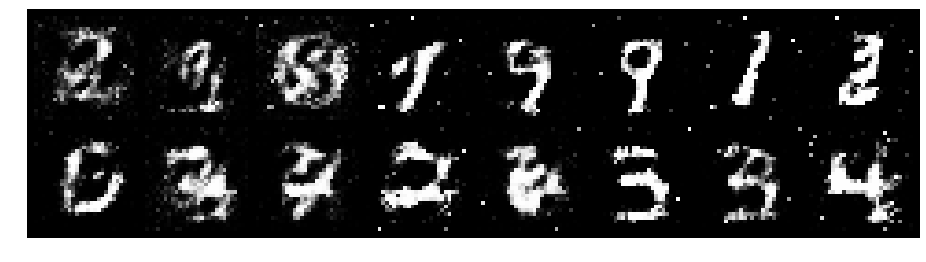

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.7538, Generator Loss: 1.4449
D(x): 0.7301, D(G(z)): 0.2762


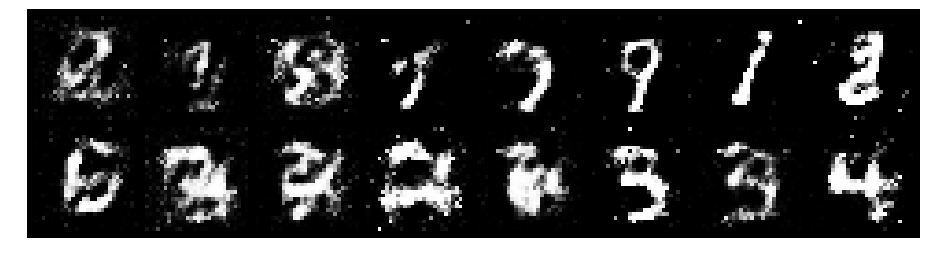

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.8756, Generator Loss: 1.7880
D(x): 0.6945, D(G(z)): 0.2760


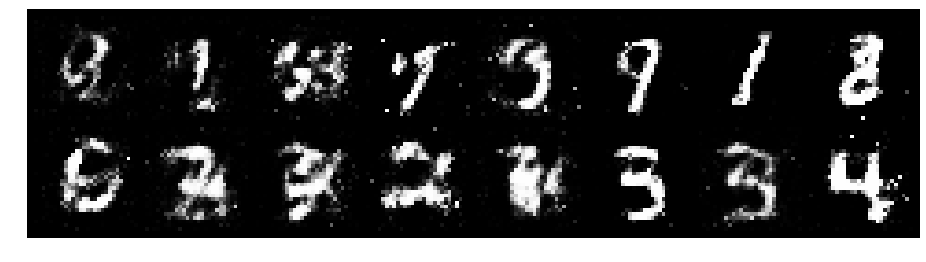

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0054, Generator Loss: 1.4514
D(x): 0.6428, D(G(z)): 0.3044


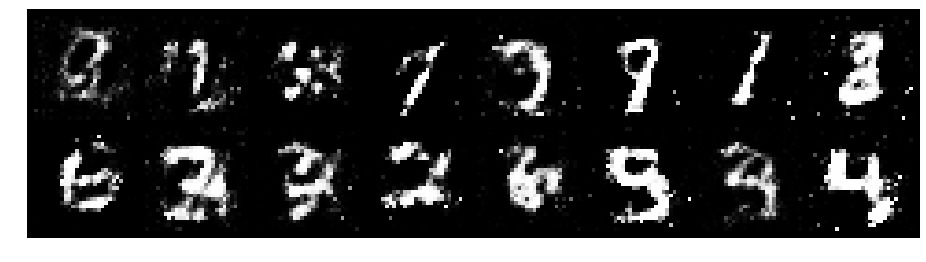

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.8814, Generator Loss: 1.4804
D(x): 0.7067, D(G(z)): 0.2987


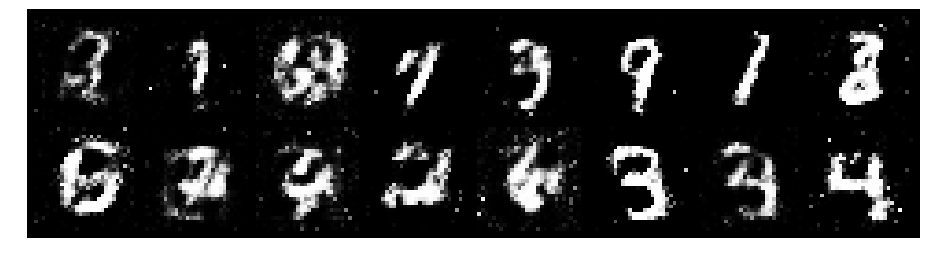

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.0631, Generator Loss: 1.2351
D(x): 0.7265, D(G(z)): 0.4012


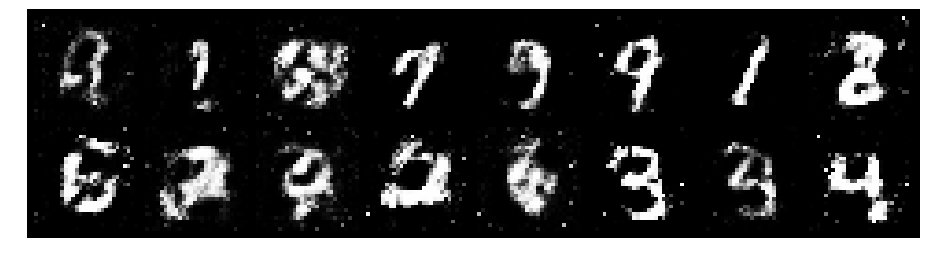

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.9932, Generator Loss: 1.2587
D(x): 0.7335, D(G(z)): 0.3906


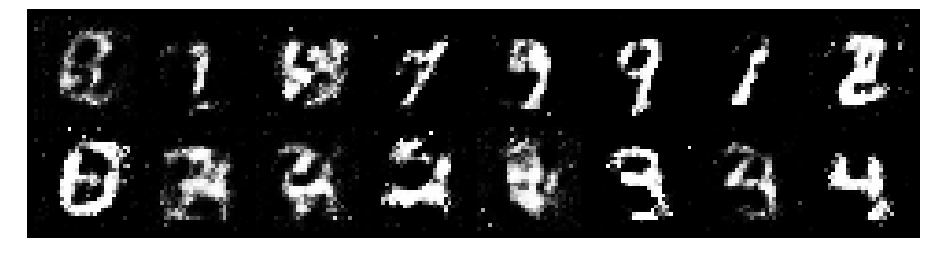

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.3460, Generator Loss: 1.1568
D(x): 0.5685, D(G(z)): 0.3563


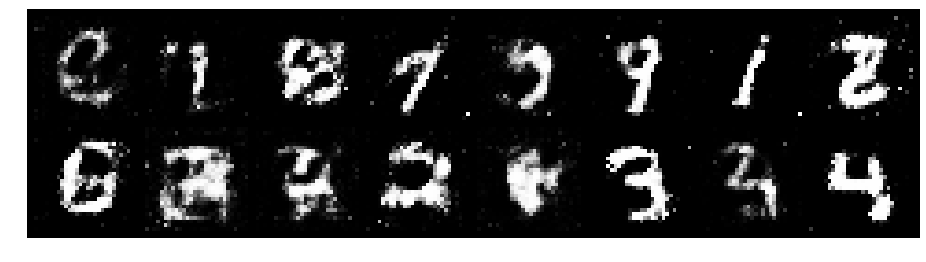

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.1776, Generator Loss: 1.2941
D(x): 0.7028, D(G(z)): 0.4471


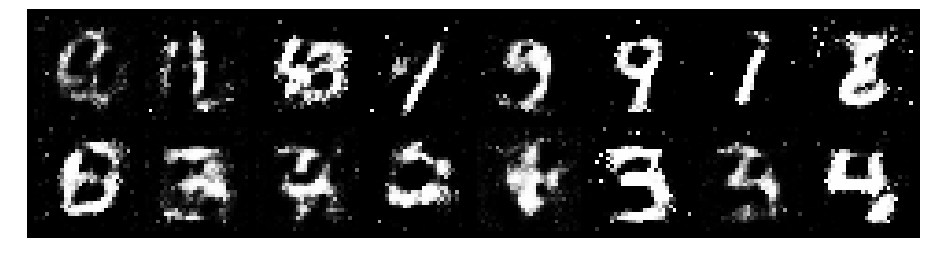

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0466, Generator Loss: 1.2231
D(x): 0.7067, D(G(z)): 0.3899


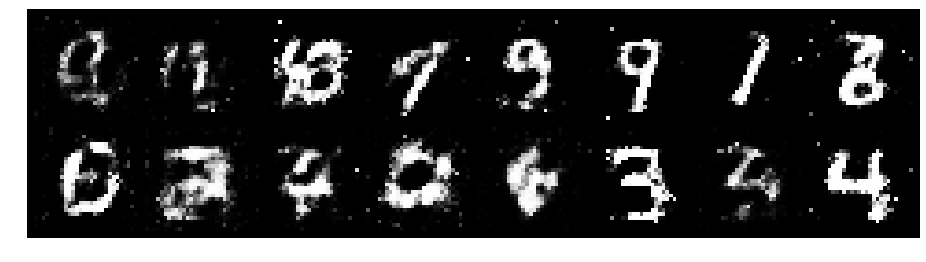

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 0.8088, Generator Loss: 1.5755
D(x): 0.7421, D(G(z)): 0.3176


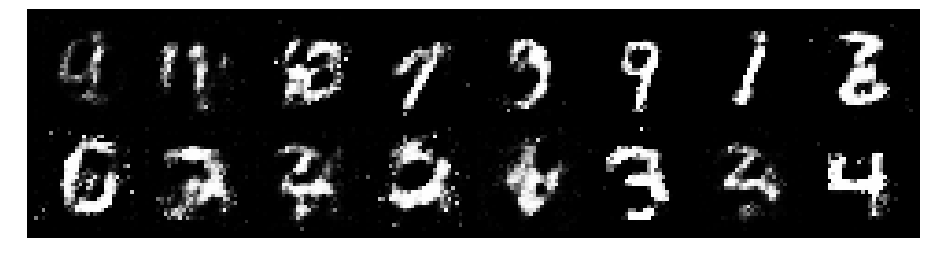

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 0.9522, Generator Loss: 2.1110
D(x): 0.6344, D(G(z)): 0.2473


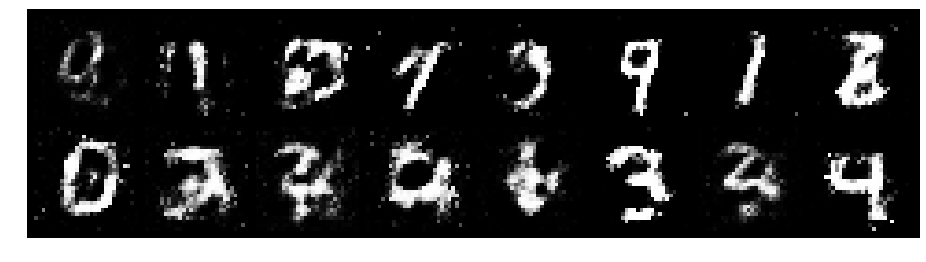

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.0529, Generator Loss: 1.2591
D(x): 0.5902, D(G(z)): 0.2900


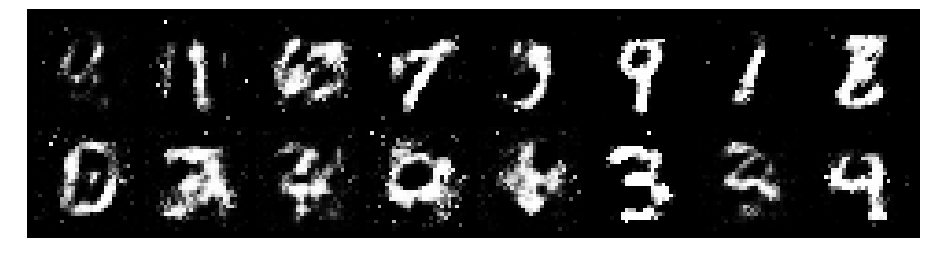

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.1663, Generator Loss: 1.4483
D(x): 0.5922, D(G(z)): 0.3407


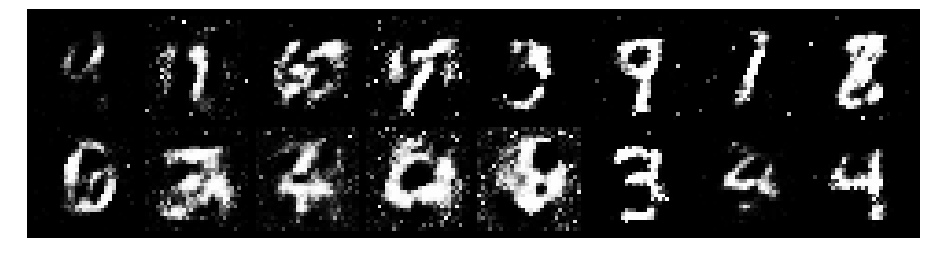

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 0.9768, Generator Loss: 1.2655
D(x): 0.7022, D(G(z)): 0.3933


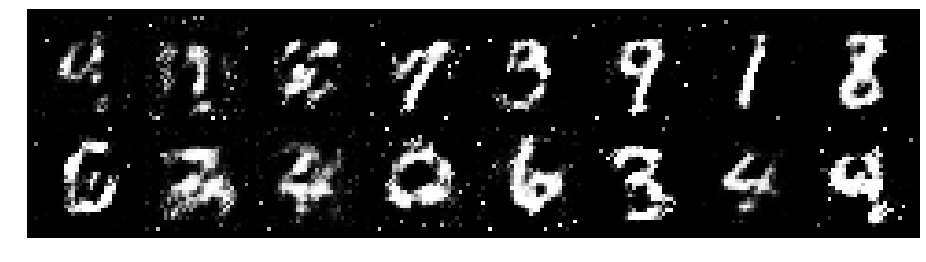

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0374, Generator Loss: 1.1555
D(x): 0.6880, D(G(z)): 0.4050


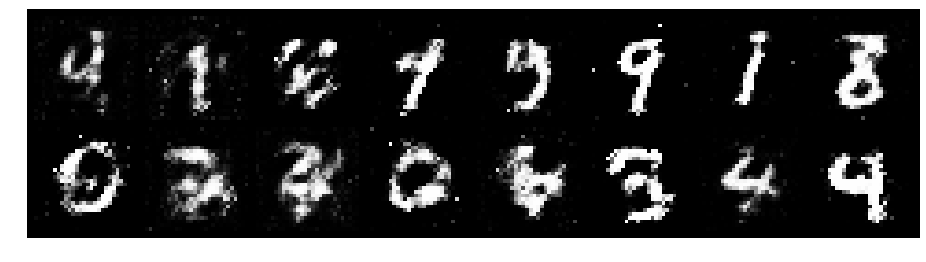

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.1725, Generator Loss: 1.2167
D(x): 0.6133, D(G(z)): 0.3735


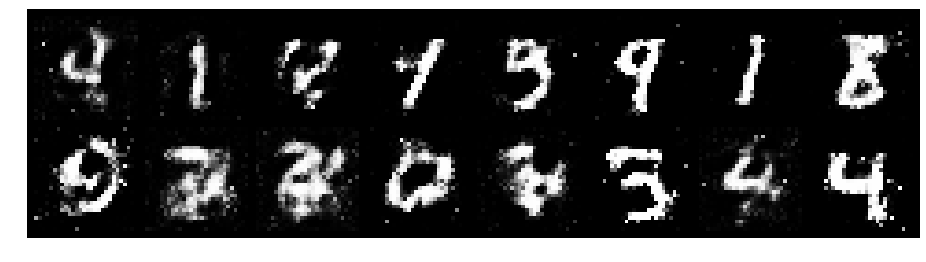

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 0.9115, Generator Loss: 1.6309
D(x): 0.6742, D(G(z)): 0.2920


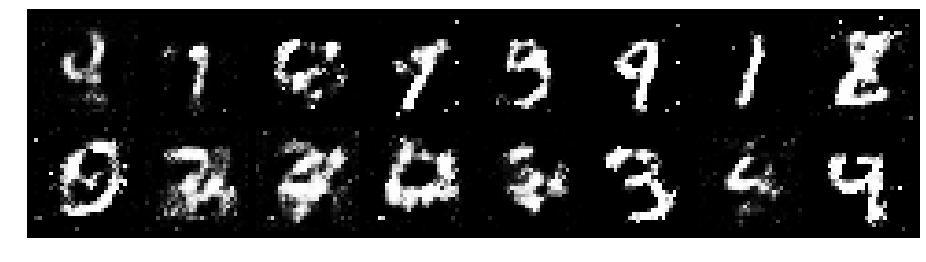

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.9546, Generator Loss: 1.4464
D(x): 0.6409, D(G(z)): 0.2990


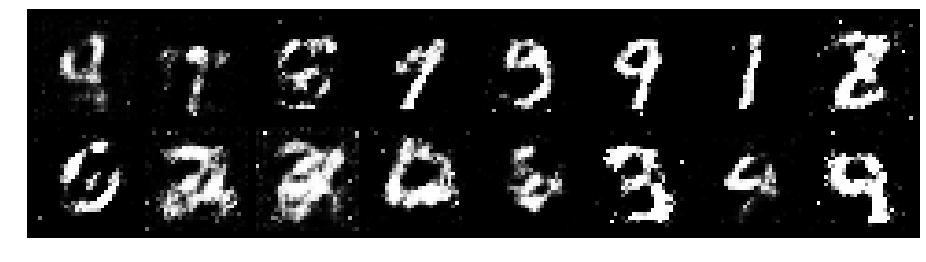

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.0366, Generator Loss: 1.2340
D(x): 0.6838, D(G(z)): 0.3604


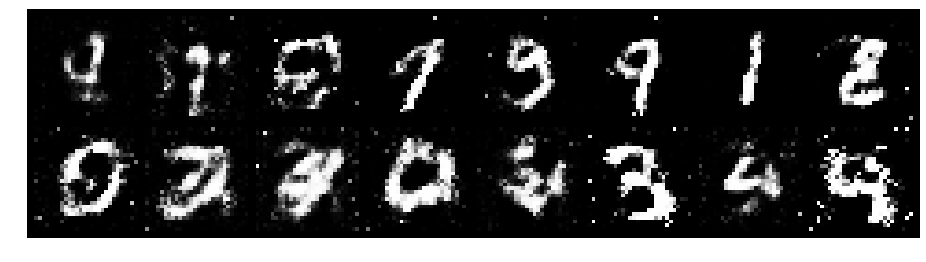

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.1103, Generator Loss: 1.4349
D(x): 0.7217, D(G(z)): 0.4227


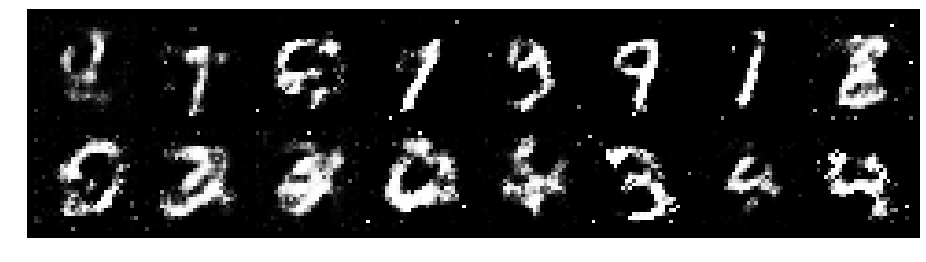

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.1624, Generator Loss: 1.5054
D(x): 0.5785, D(G(z)): 0.3012


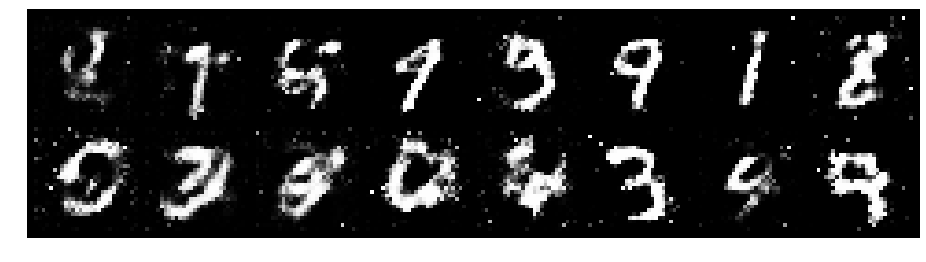

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0374, Generator Loss: 1.4802
D(x): 0.6776, D(G(z)): 0.3577


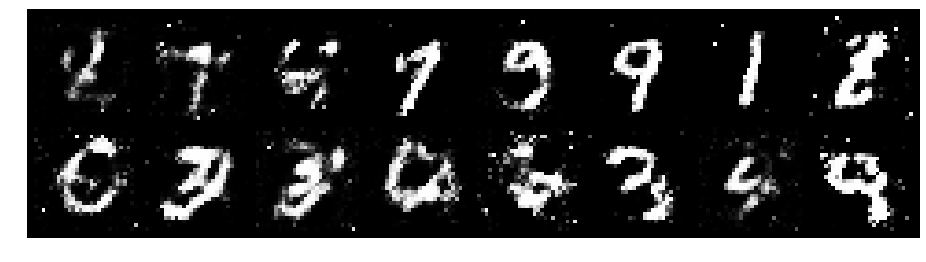

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.0131, Generator Loss: 1.3427
D(x): 0.6370, D(G(z)): 0.3282


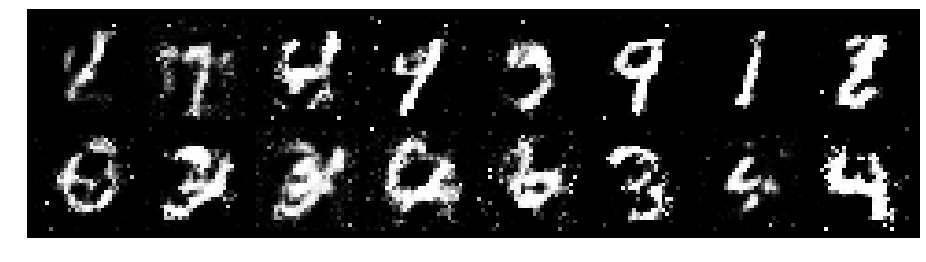

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.0675, Generator Loss: 1.5069
D(x): 0.6745, D(G(z)): 0.3702


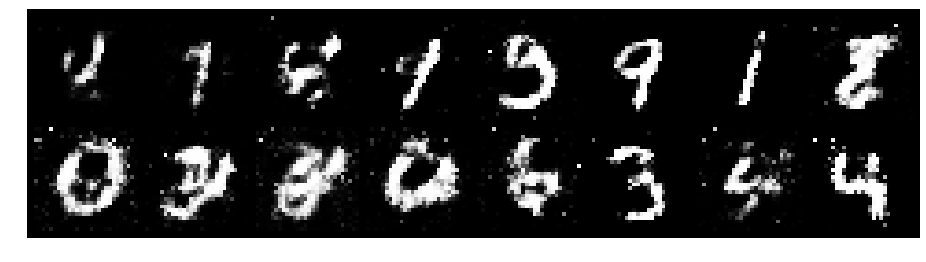

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.1487, Generator Loss: 1.4301
D(x): 0.6348, D(G(z)): 0.3608


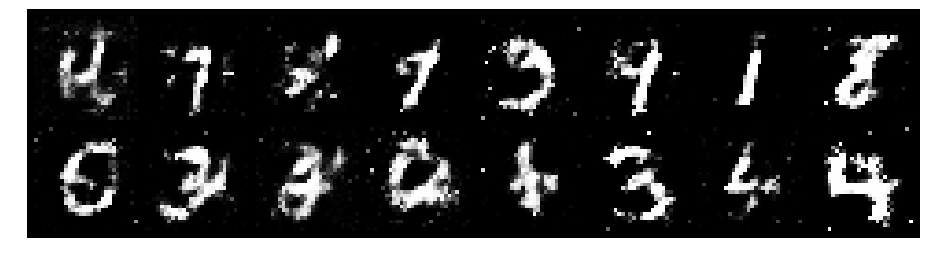

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.1695, Generator Loss: 1.2197
D(x): 0.6655, D(G(z)): 0.4292


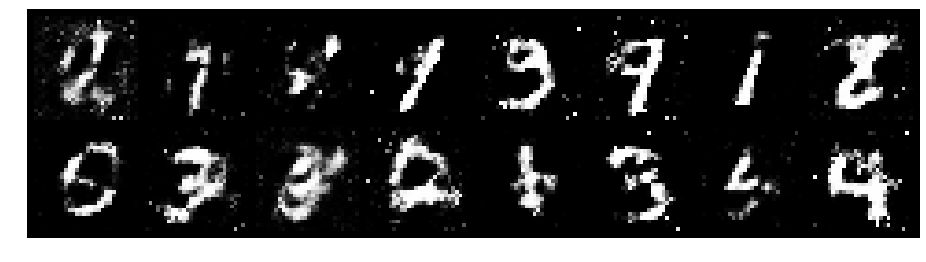

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.0392, Generator Loss: 1.1148
D(x): 0.6681, D(G(z)): 0.3737


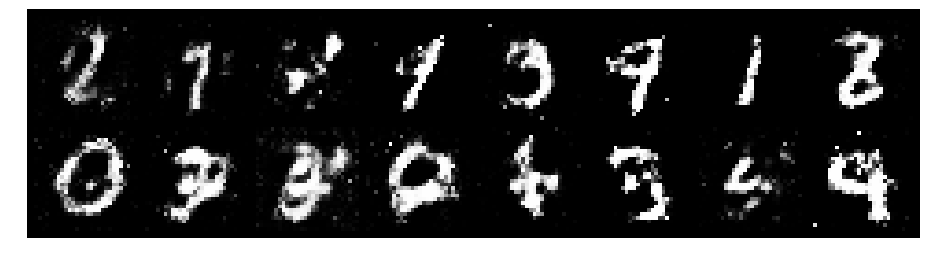

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.1654, Generator Loss: 1.1370
D(x): 0.6351, D(G(z)): 0.3912


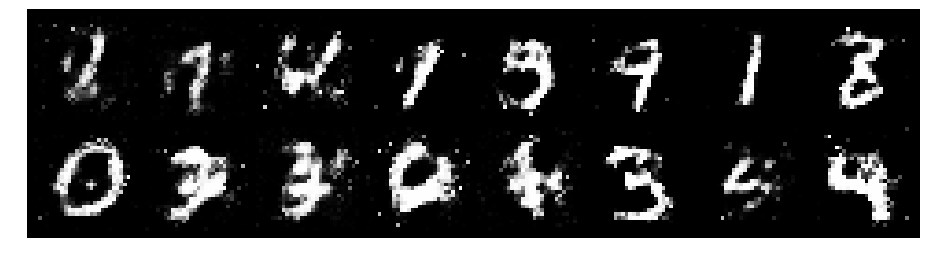

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.1452, Generator Loss: 0.9451
D(x): 0.6499, D(G(z)): 0.4152


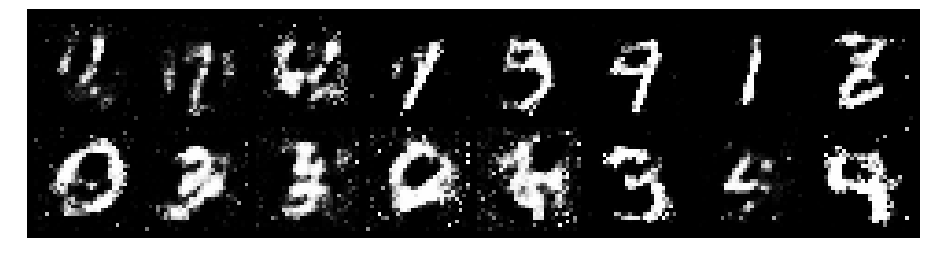

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.1255, Generator Loss: 1.0163
D(x): 0.6680, D(G(z)): 0.4311


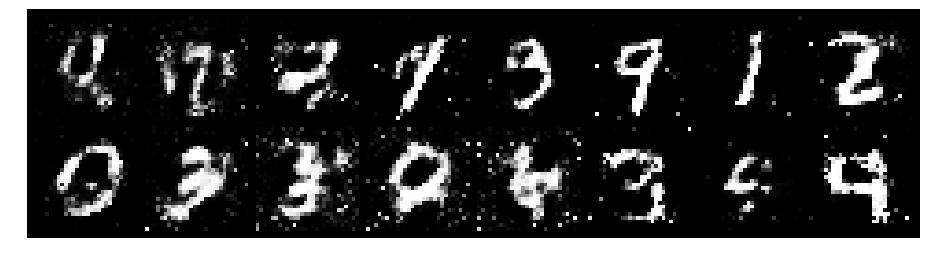

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0604, Generator Loss: 1.3478
D(x): 0.7001, D(G(z)): 0.4047


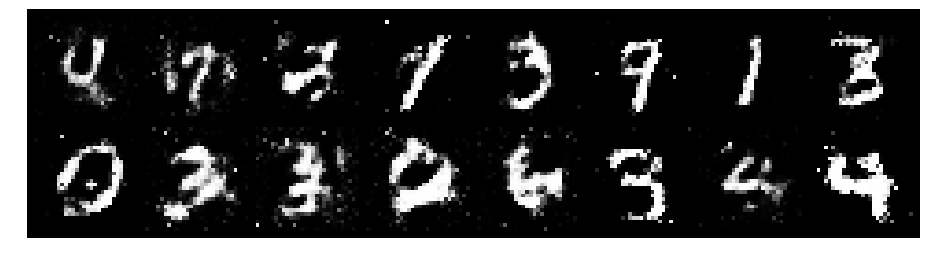

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.2131, Generator Loss: 1.1073
D(x): 0.5908, D(G(z)): 0.3985


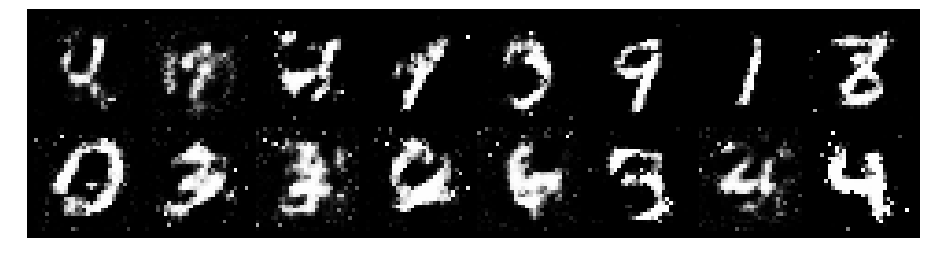

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.0825, Generator Loss: 1.3994
D(x): 0.6686, D(G(z)): 0.3913


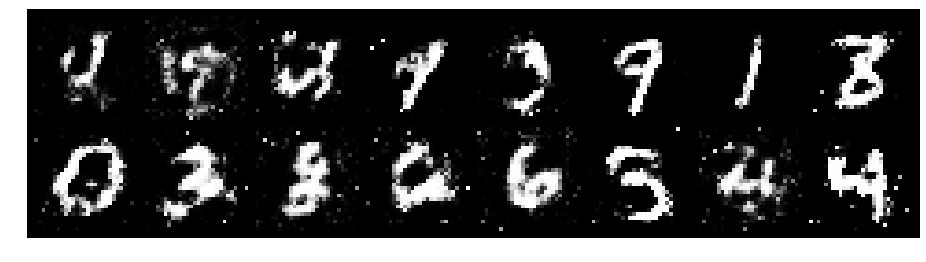

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1059, Generator Loss: 1.2321
D(x): 0.6520, D(G(z)): 0.3953


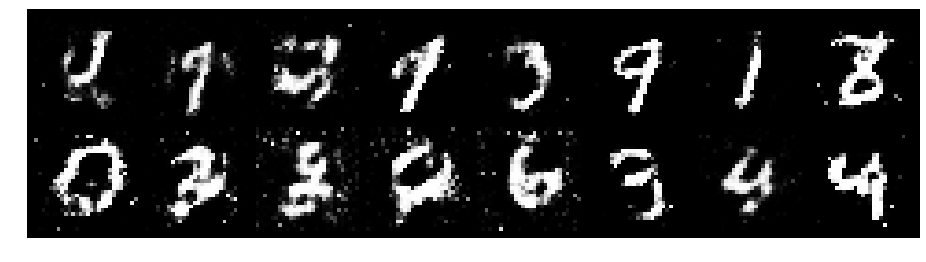

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 0.8389, Generator Loss: 1.2772
D(x): 0.7123, D(G(z)): 0.2880


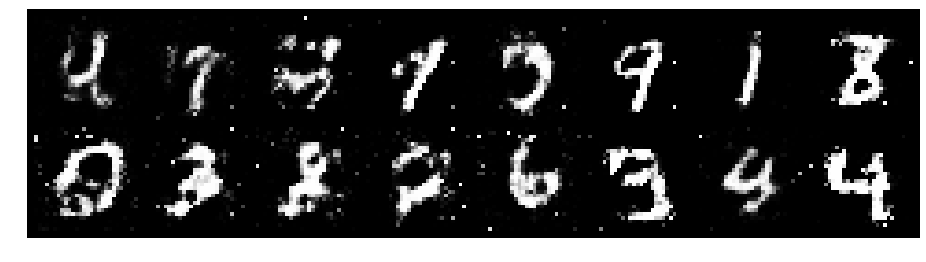

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1163, Generator Loss: 1.3319
D(x): 0.6756, D(G(z)): 0.4117


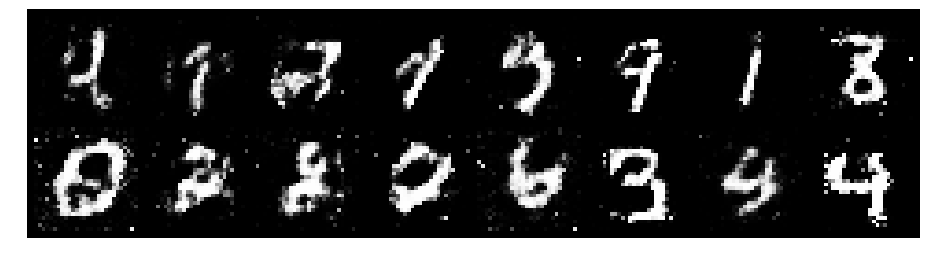

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.0514, Generator Loss: 1.1193
D(x): 0.6430, D(G(z)): 0.3624


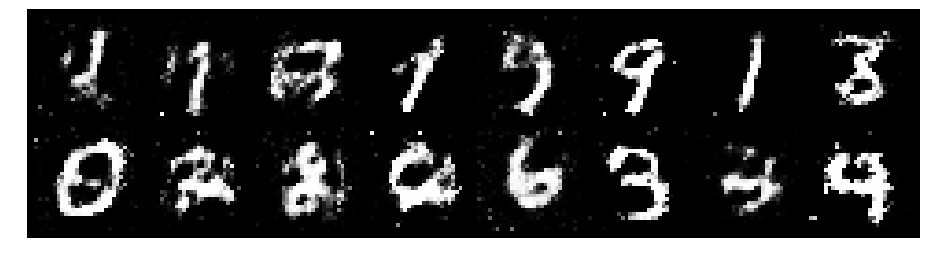

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.2357, Generator Loss: 1.0296
D(x): 0.6513, D(G(z)): 0.4499


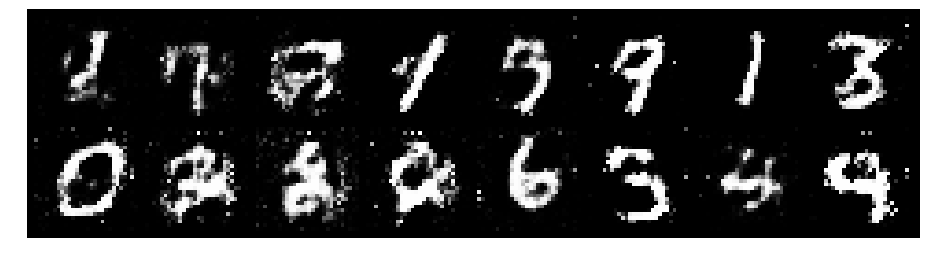

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.2470, Generator Loss: 1.0263
D(x): 0.6901, D(G(z)): 0.4654


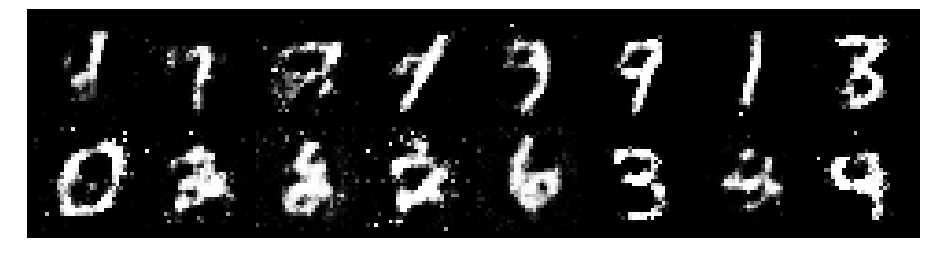

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.3259, Generator Loss: 1.1453
D(x): 0.5395, D(G(z)): 0.3884


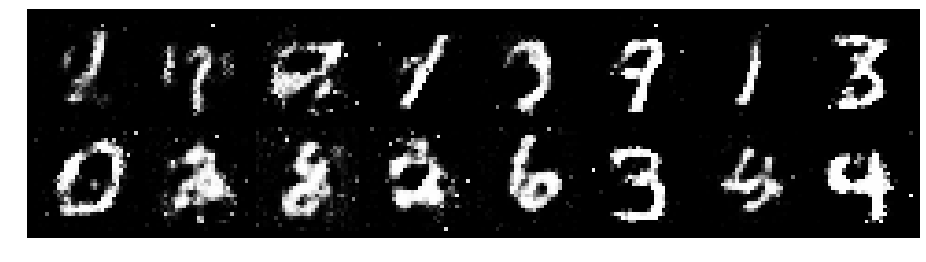

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.3348, Generator Loss: 1.1683
D(x): 0.6027, D(G(z)): 0.4440


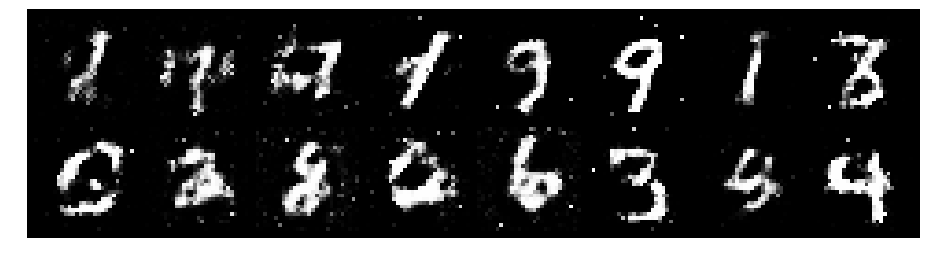

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.0727, Generator Loss: 1.5992
D(x): 0.6228, D(G(z)): 0.3340


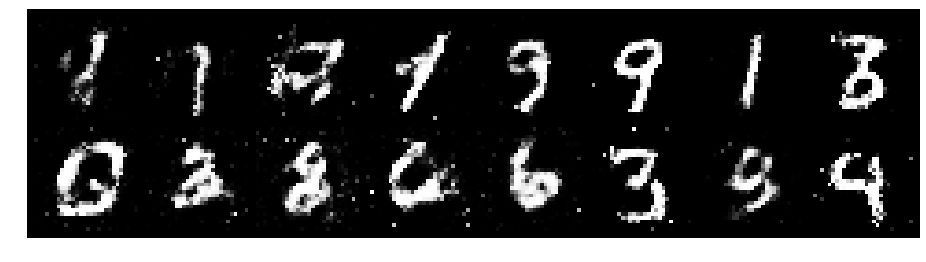

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.2217, Generator Loss: 1.2628
D(x): 0.6254, D(G(z)): 0.3984


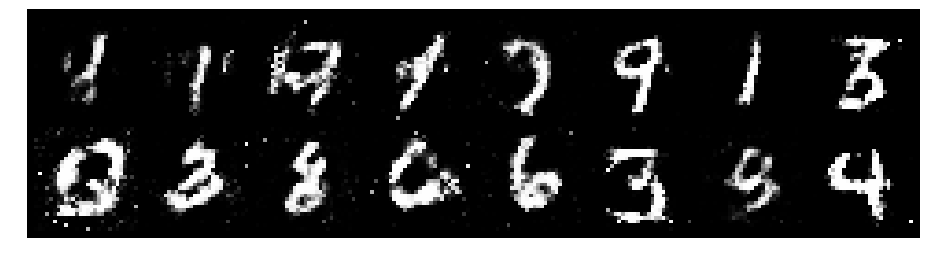

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.2232, Generator Loss: 1.0090
D(x): 0.6211, D(G(z)): 0.4392


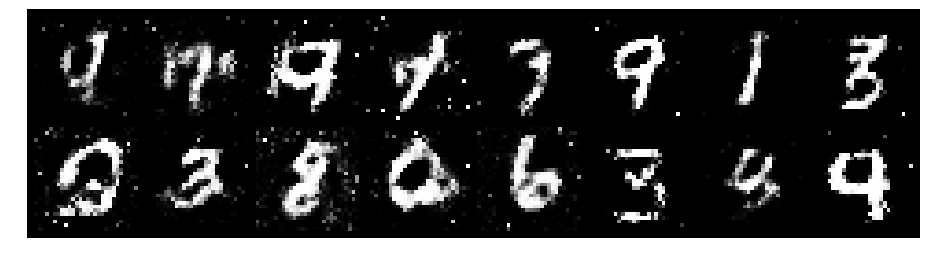

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 0.9322, Generator Loss: 1.7204
D(x): 0.6756, D(G(z)): 0.2952


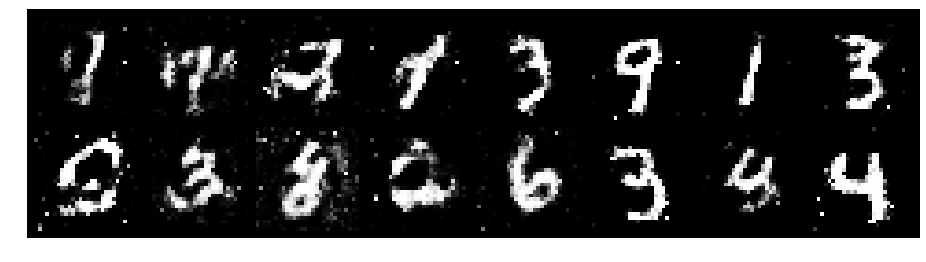

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.1566, Generator Loss: 1.3515
D(x): 0.5511, D(G(z)): 0.3301


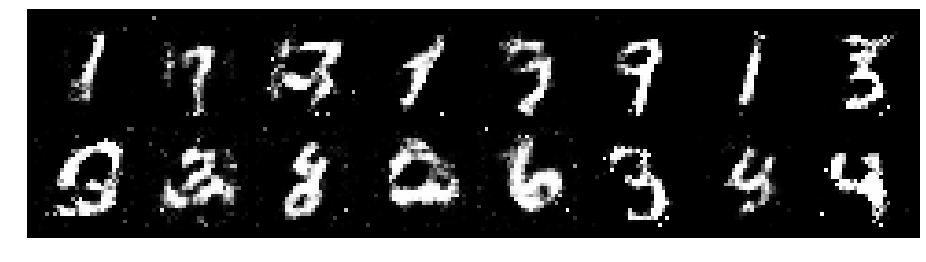

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1705, Generator Loss: 0.9989
D(x): 0.5913, D(G(z)): 0.3895


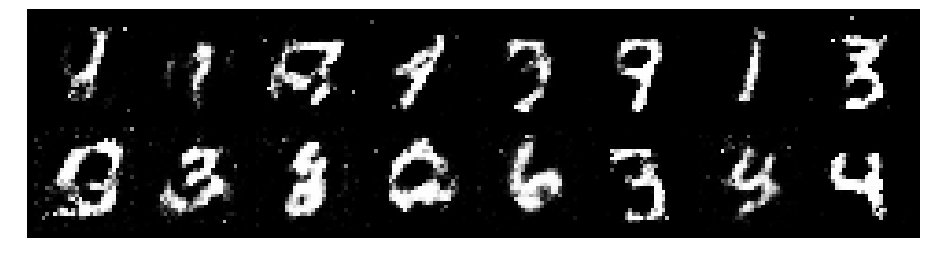

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0927, Generator Loss: 1.3108
D(x): 0.6568, D(G(z)): 0.3772


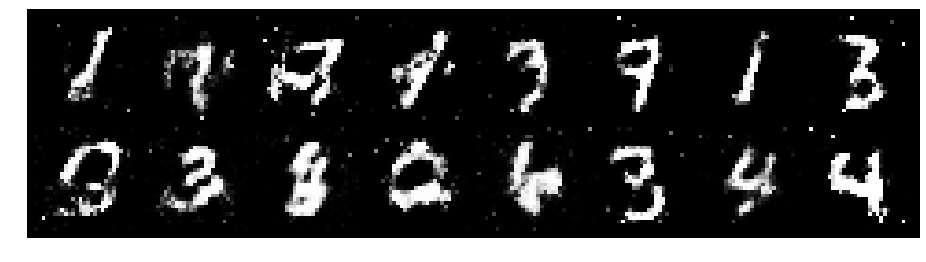

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.2106, Generator Loss: 1.0893
D(x): 0.6120, D(G(z)): 0.4351


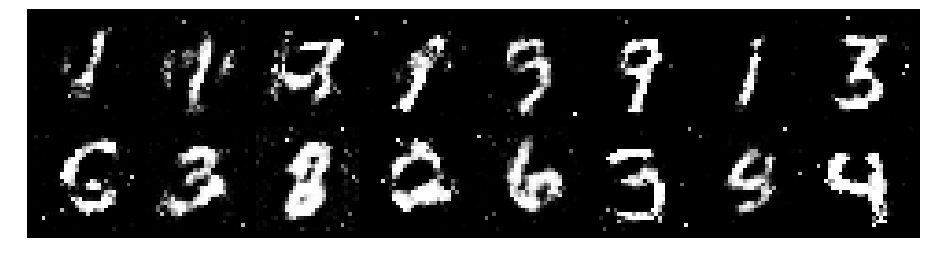

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.3065, Generator Loss: 1.0854
D(x): 0.5659, D(G(z)): 0.4217


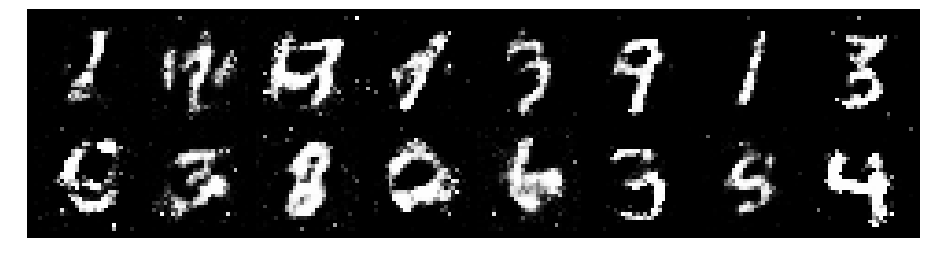

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.1654, Generator Loss: 1.1127
D(x): 0.5836, D(G(z)): 0.3912


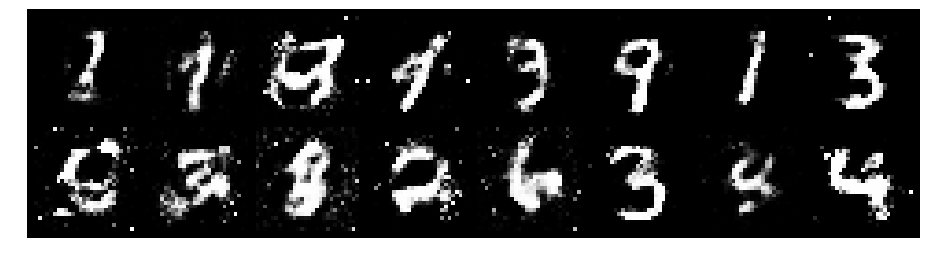

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 0.9275, Generator Loss: 1.2215
D(x): 0.7011, D(G(z)): 0.3574


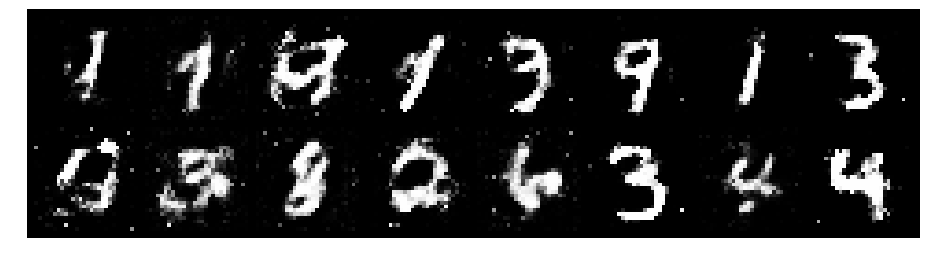

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.2220, Generator Loss: 1.3664
D(x): 0.6295, D(G(z)): 0.3967


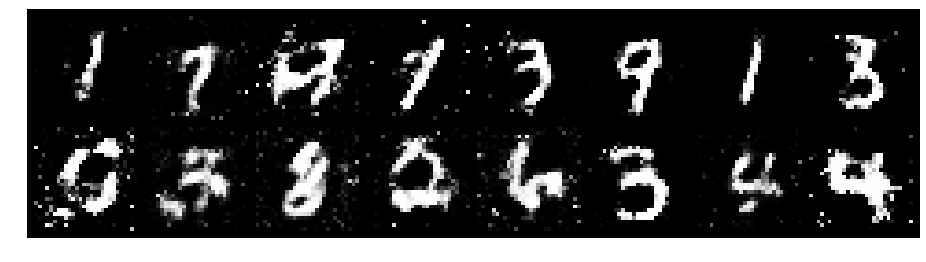

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.0564, Generator Loss: 1.5605
D(x): 0.6768, D(G(z)): 0.3455


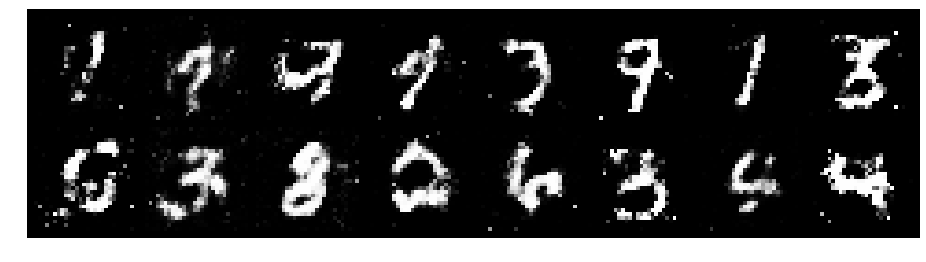

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1683, Generator Loss: 1.2472
D(x): 0.5873, D(G(z)): 0.3637


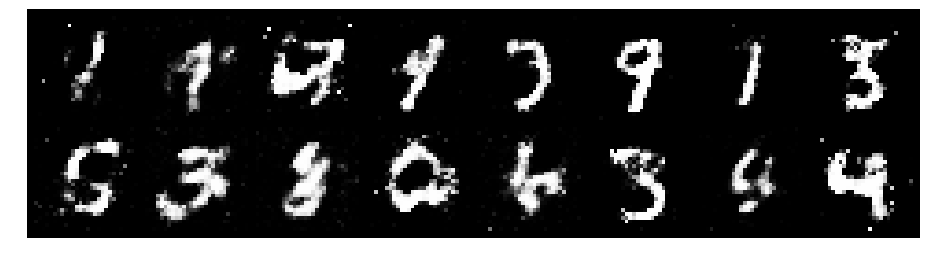

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.2216, Generator Loss: 1.2701
D(x): 0.5515, D(G(z)): 0.3356


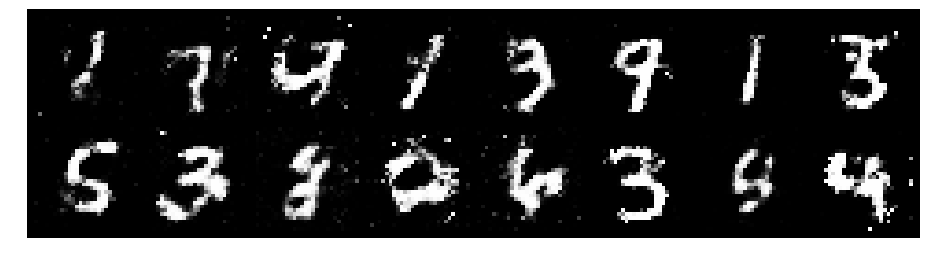

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.0619, Generator Loss: 1.0469
D(x): 0.6280, D(G(z)): 0.3640


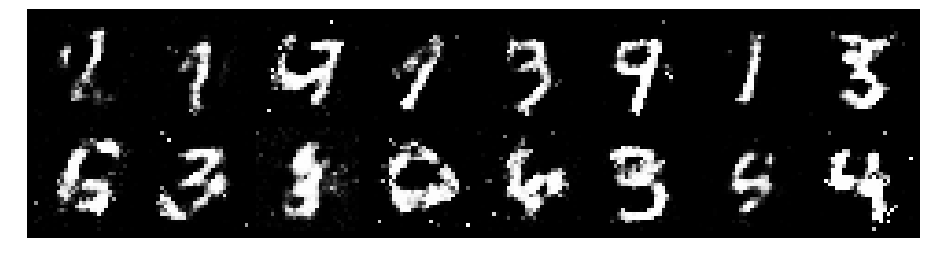

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.2624, Generator Loss: 0.8230
D(x): 0.6482, D(G(z)): 0.4875


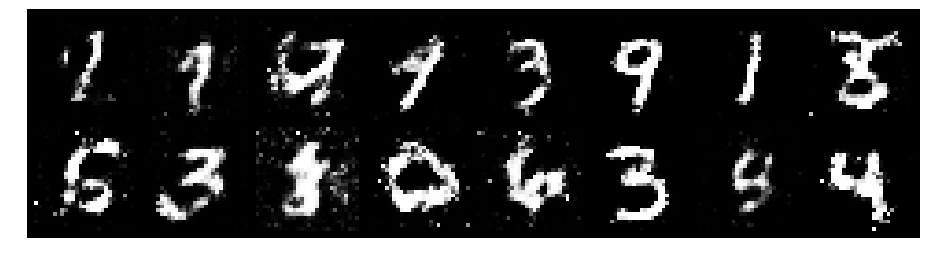

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.2074, Generator Loss: 1.1041
D(x): 0.5905, D(G(z)): 0.4008


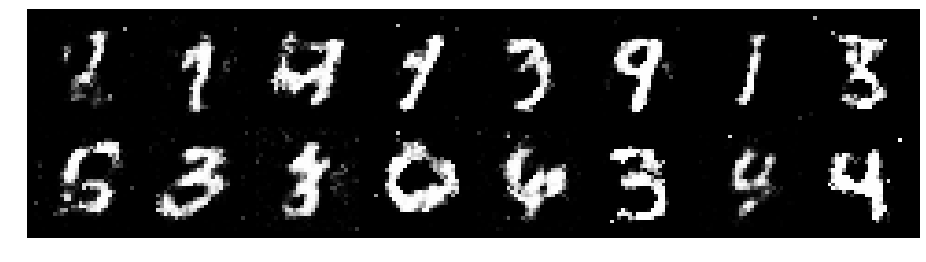

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1198, Generator Loss: 1.1611
D(x): 0.6093, D(G(z)): 0.3847


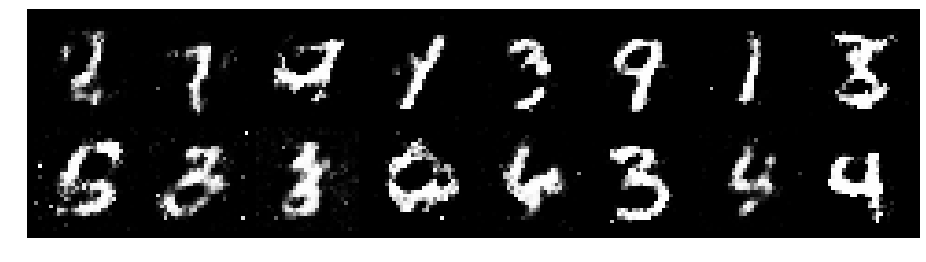

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.0863, Generator Loss: 1.2059
D(x): 0.6179, D(G(z)): 0.3857


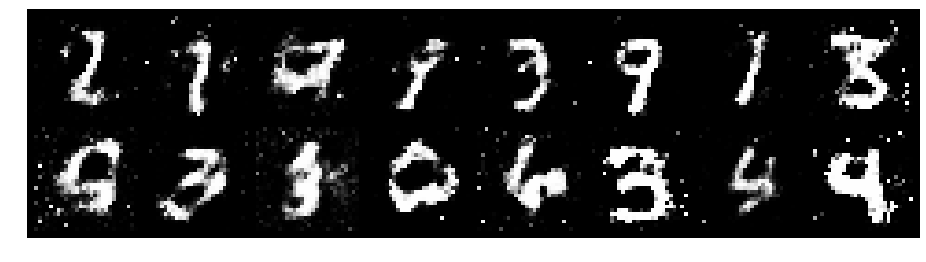

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1584, Generator Loss: 1.3241
D(x): 0.6303, D(G(z)): 0.3968


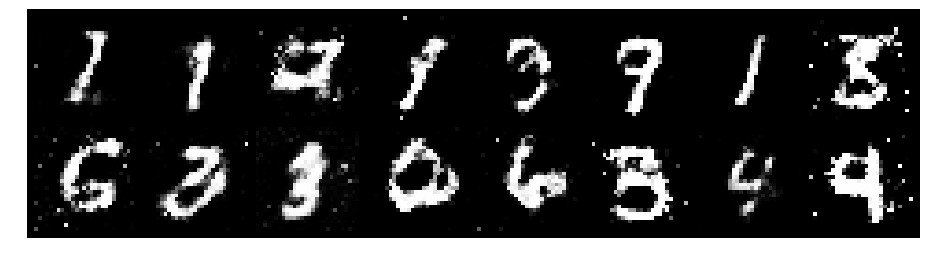

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0775, Generator Loss: 1.1734
D(x): 0.6264, D(G(z)): 0.3706


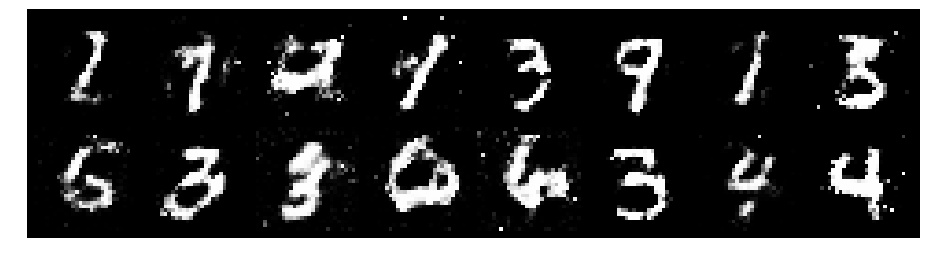

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.1008, Generator Loss: 1.3137
D(x): 0.6138, D(G(z)): 0.3224


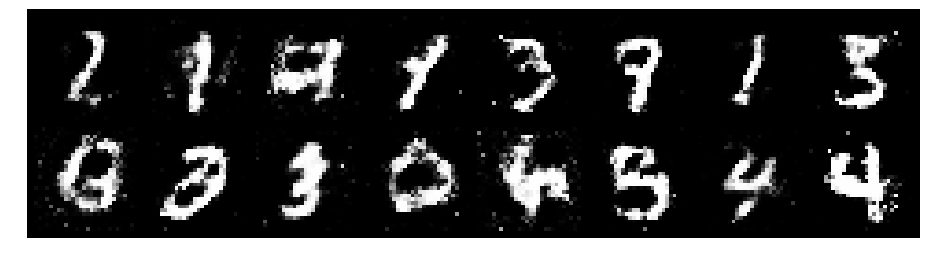

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.0635, Generator Loss: 1.2023
D(x): 0.6649, D(G(z)): 0.3798


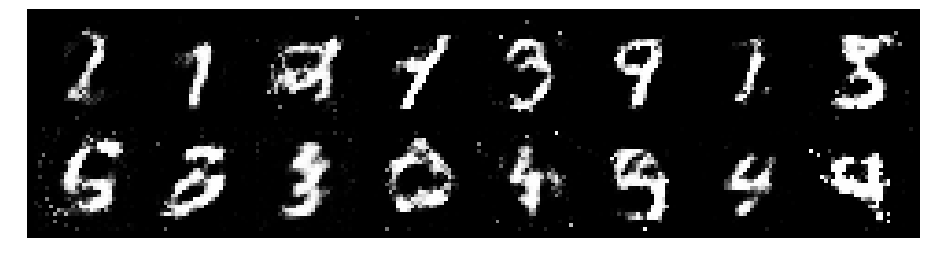

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.0061, Generator Loss: 1.3896
D(x): 0.7167, D(G(z)): 0.3933


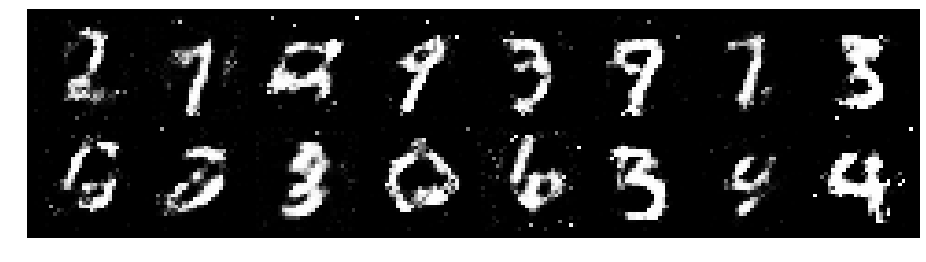

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.0031, Generator Loss: 1.1407
D(x): 0.6800, D(G(z)): 0.3742


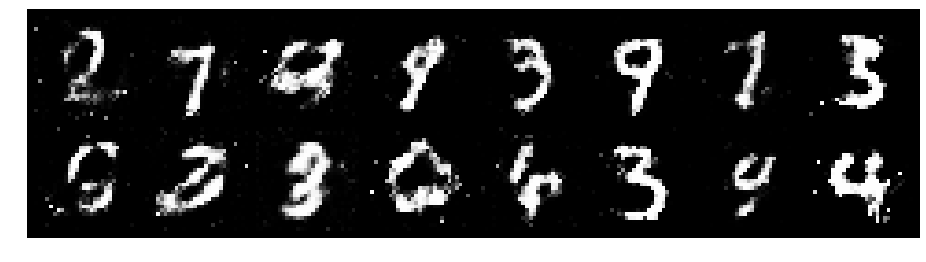

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 0.8972, Generator Loss: 1.6553
D(x): 0.6400, D(G(z)): 0.2650


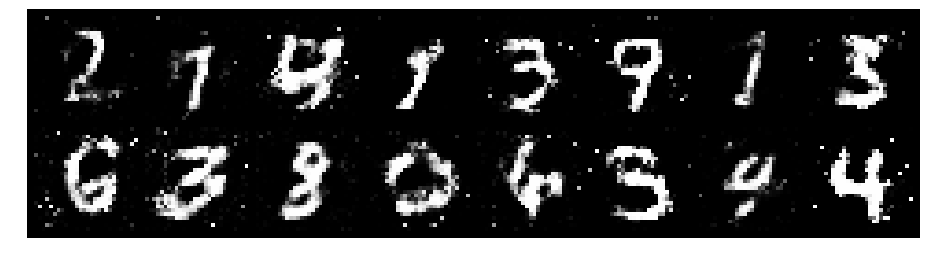

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 0.8721, Generator Loss: 1.5867
D(x): 0.7249, D(G(z)): 0.3235


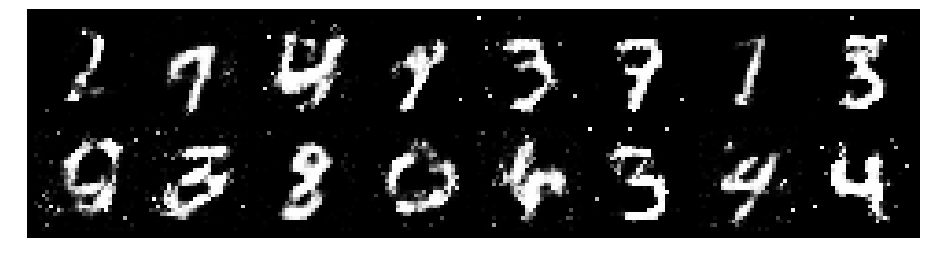

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.0045, Generator Loss: 1.0283
D(x): 0.6097, D(G(z)): 0.3495


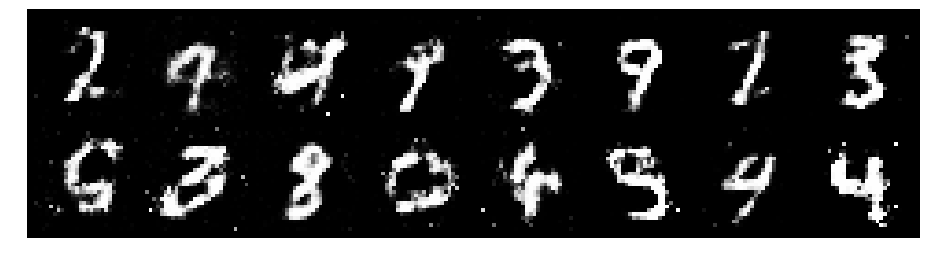

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.2054, Generator Loss: 1.1244
D(x): 0.6019, D(G(z)): 0.3803


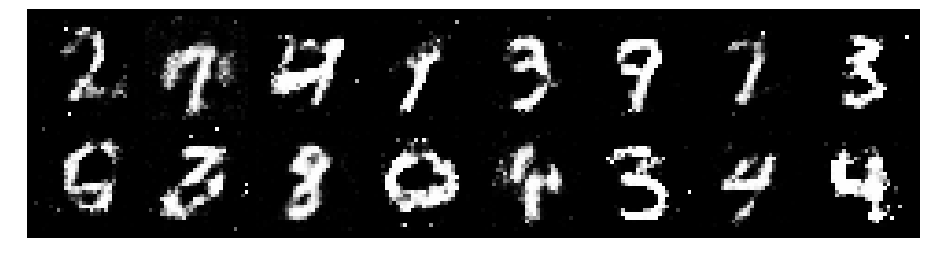

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.1860, Generator Loss: 1.0489
D(x): 0.5958, D(G(z)): 0.3885


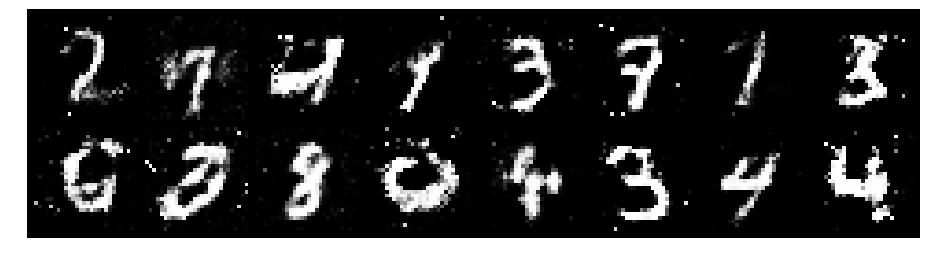

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.1785, Generator Loss: 1.1827
D(x): 0.6107, D(G(z)): 0.3938


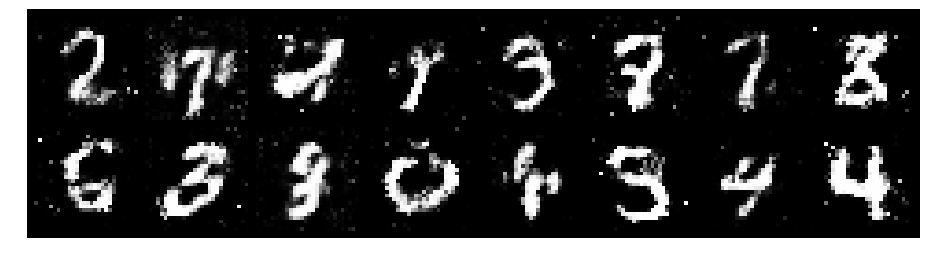

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.1180, Generator Loss: 1.0386
D(x): 0.5968, D(G(z)): 0.3742


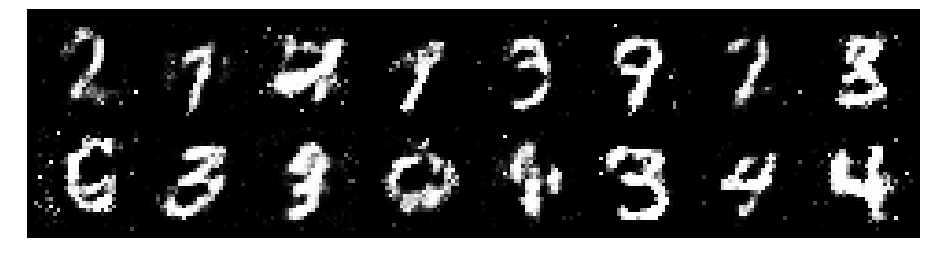

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 0.9961, Generator Loss: 1.2722
D(x): 0.6675, D(G(z)): 0.3832


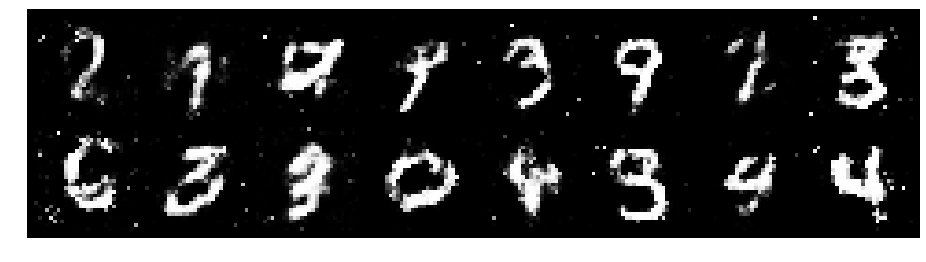

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.0760, Generator Loss: 0.9327
D(x): 0.6252, D(G(z)): 0.3775


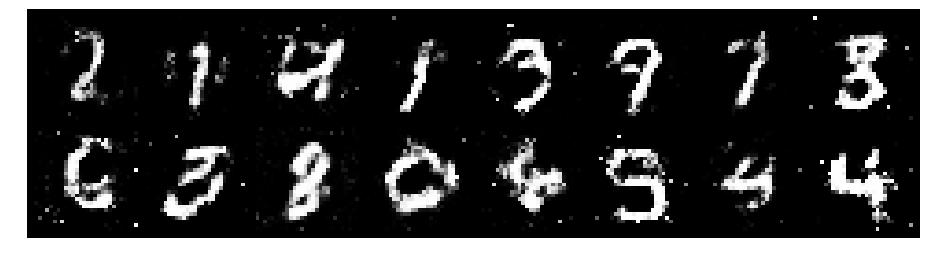

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.1776, Generator Loss: 1.0840
D(x): 0.5708, D(G(z)): 0.3485


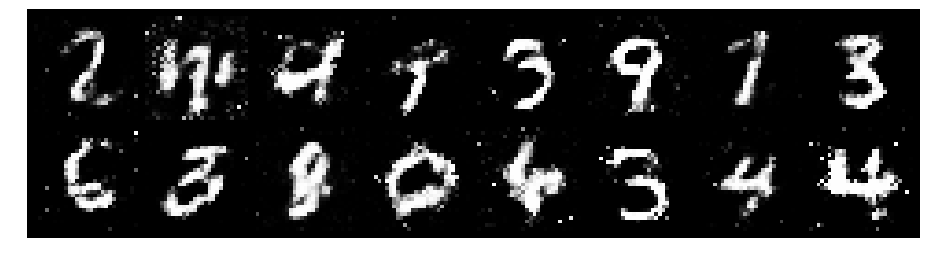

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1085, Generator Loss: 1.1194
D(x): 0.6328, D(G(z)): 0.4080


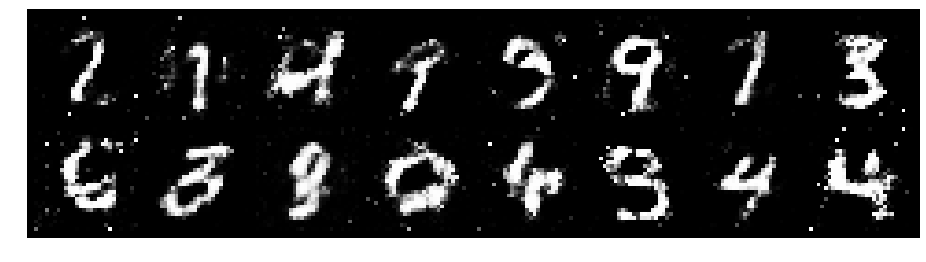

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1198, Generator Loss: 1.2491
D(x): 0.6199, D(G(z)): 0.3795


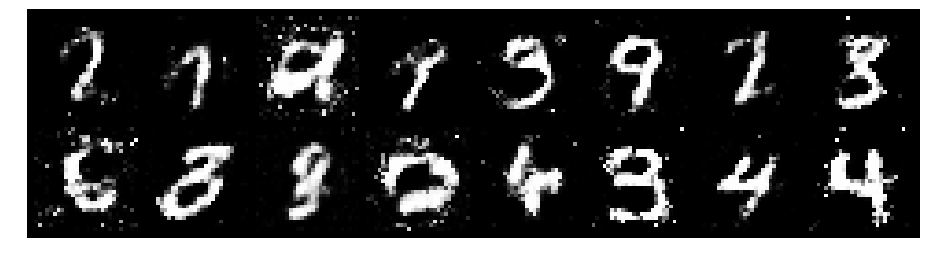

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.2585, Generator Loss: 1.0099
D(x): 0.6034, D(G(z)): 0.4258


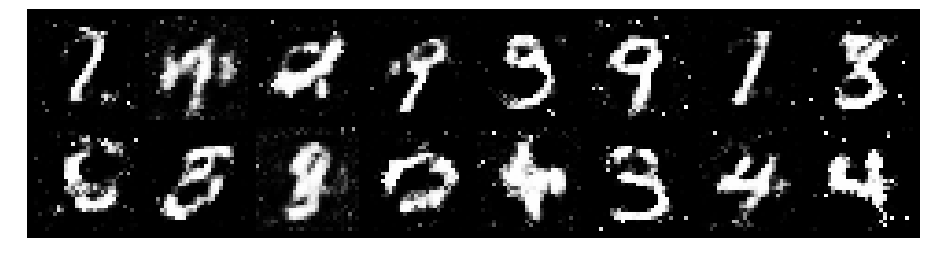

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.2661, Generator Loss: 0.7932
D(x): 0.6257, D(G(z)): 0.4960


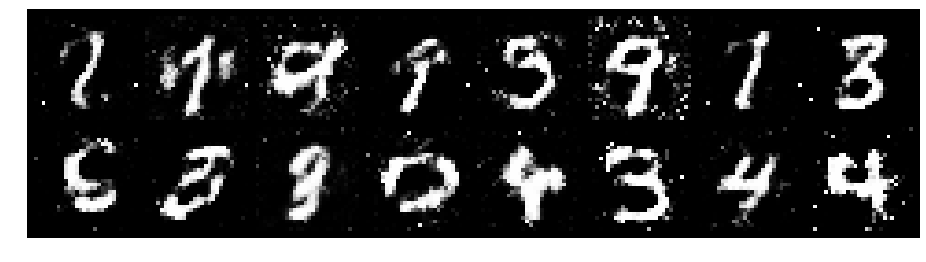

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.1568, Generator Loss: 1.0677
D(x): 0.6488, D(G(z)): 0.4259


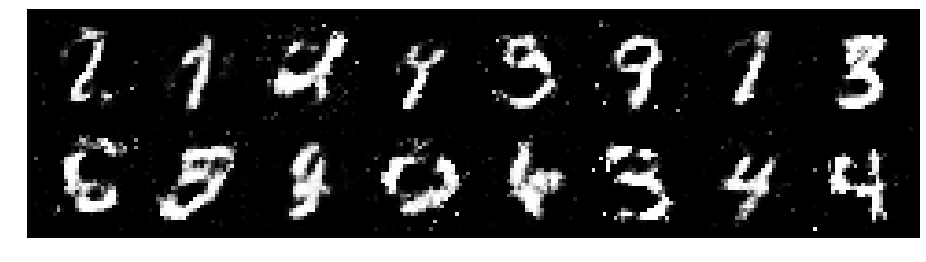

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1842, Generator Loss: 1.0214
D(x): 0.5771, D(G(z)): 0.4037


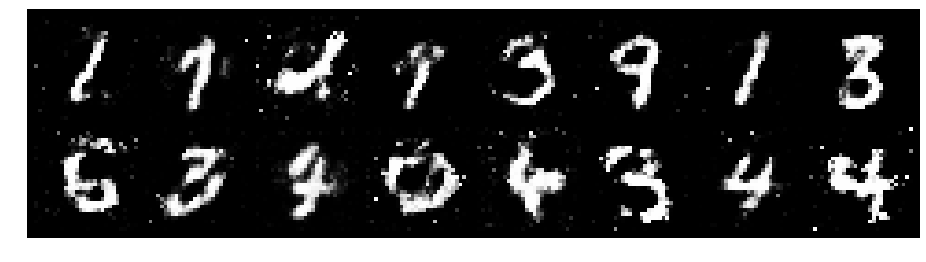

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0042, Generator Loss: 1.0515
D(x): 0.6633, D(G(z)): 0.3737


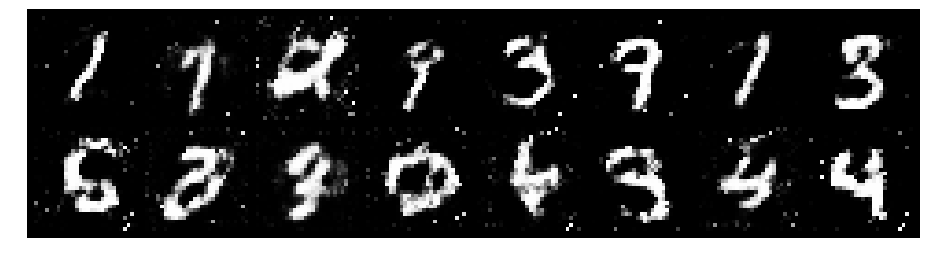

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 0.9573, Generator Loss: 1.0743
D(x): 0.6040, D(G(z)): 0.2960


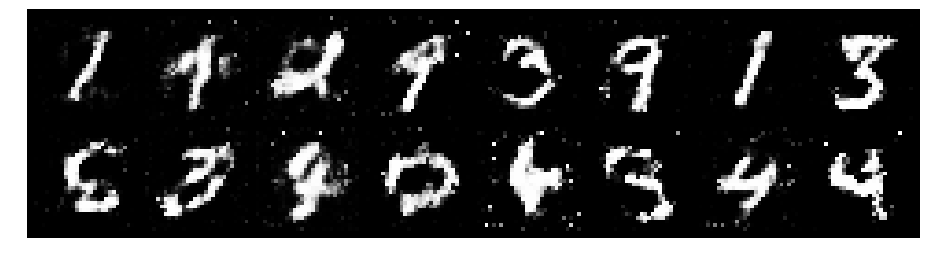

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 0.9882, Generator Loss: 1.0393
D(x): 0.6277, D(G(z)): 0.3531


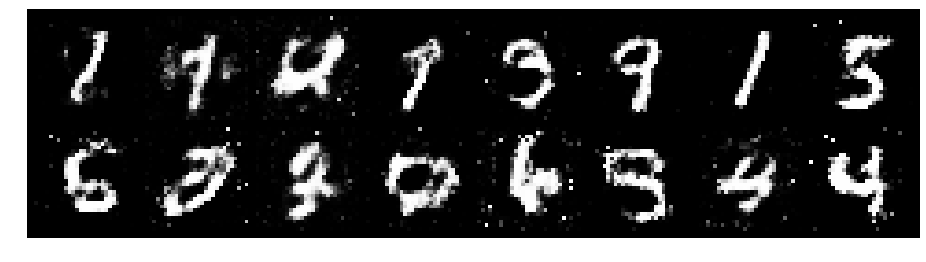

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.0879, Generator Loss: 1.1361
D(x): 0.6190, D(G(z)): 0.3785


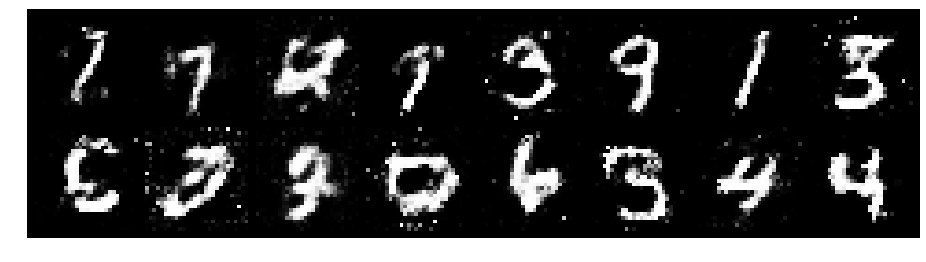

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1199, Generator Loss: 1.2223
D(x): 0.5867, D(G(z)): 0.3585


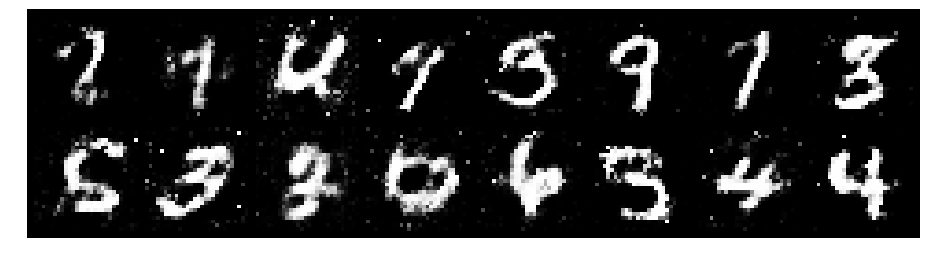

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1201, Generator Loss: 1.2181
D(x): 0.6125, D(G(z)): 0.3793


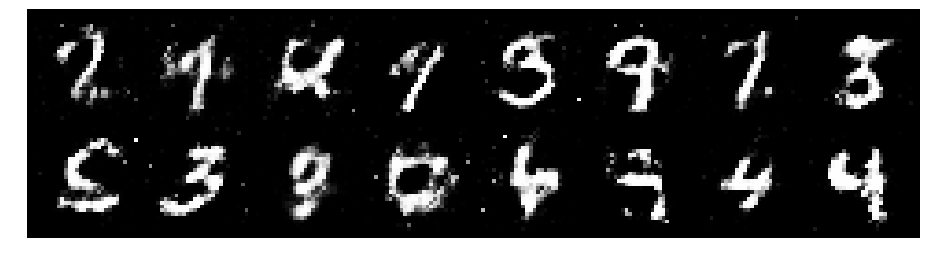

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.1570, Generator Loss: 1.1705
D(x): 0.5868, D(G(z)): 0.3545


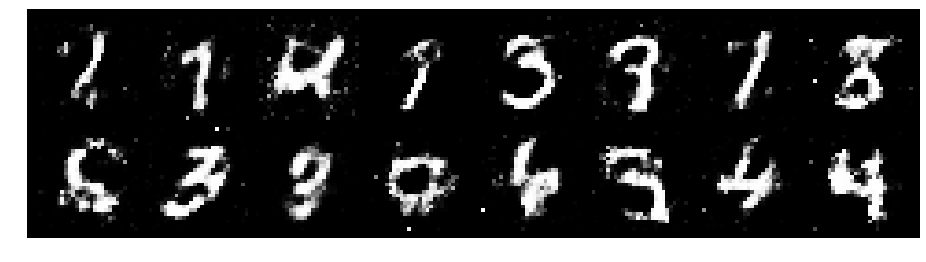

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1019, Generator Loss: 1.1713
D(x): 0.5993, D(G(z)): 0.3839


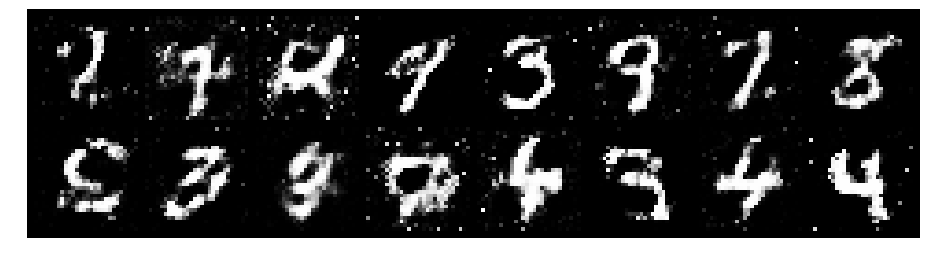

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1306, Generator Loss: 1.0011
D(x): 0.5905, D(G(z)): 0.4105


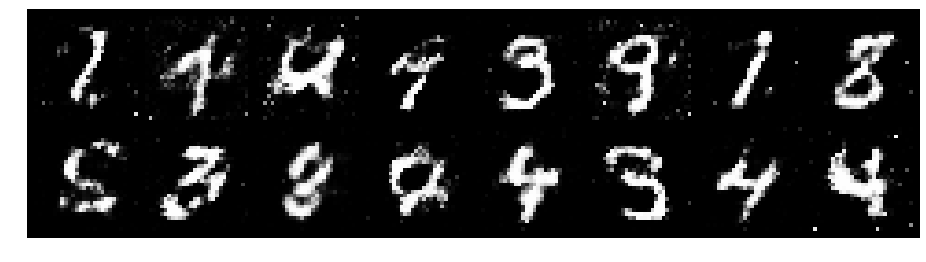

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1783, Generator Loss: 1.1306
D(x): 0.6109, D(G(z)): 0.4116


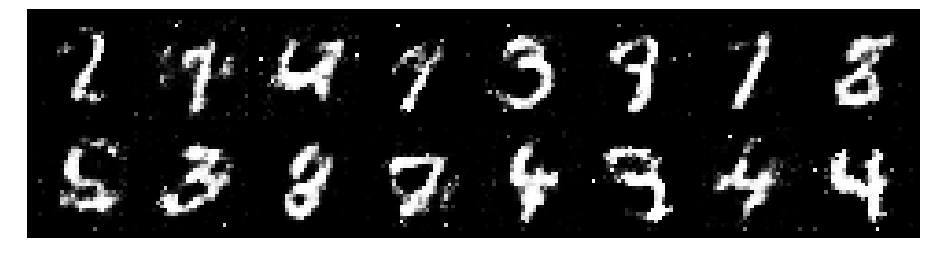

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1535, Generator Loss: 1.0466
D(x): 0.5864, D(G(z)): 0.4005


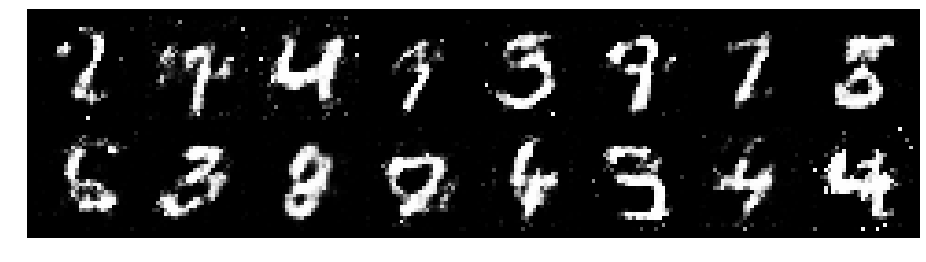

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1337, Generator Loss: 0.9019
D(x): 0.6122, D(G(z)): 0.4184


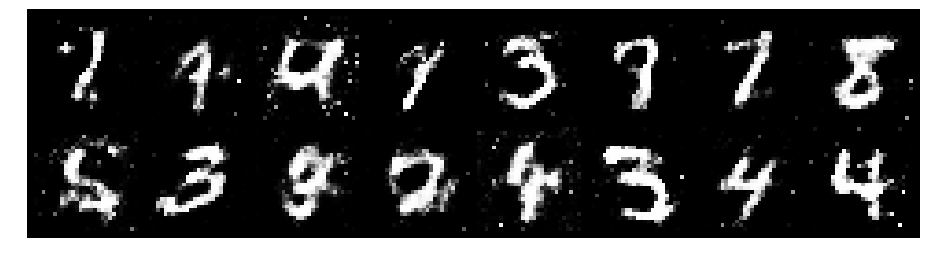

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.1947, Generator Loss: 0.9869
D(x): 0.5582, D(G(z)): 0.4100


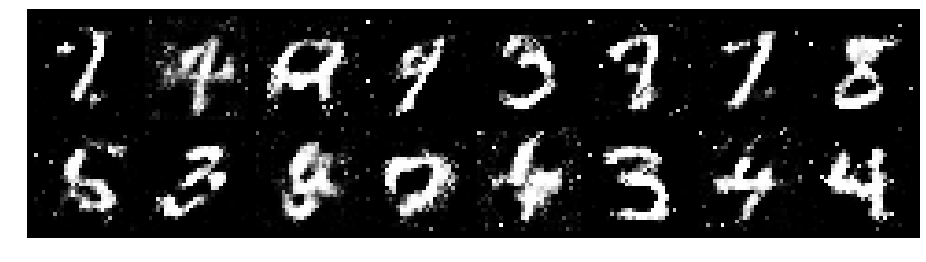

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.0967, Generator Loss: 1.0370
D(x): 0.6239, D(G(z)): 0.4068


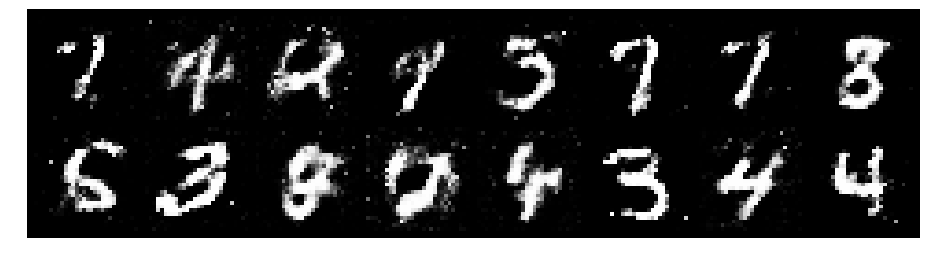

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.0912, Generator Loss: 0.9866
D(x): 0.6578, D(G(z)): 0.4286


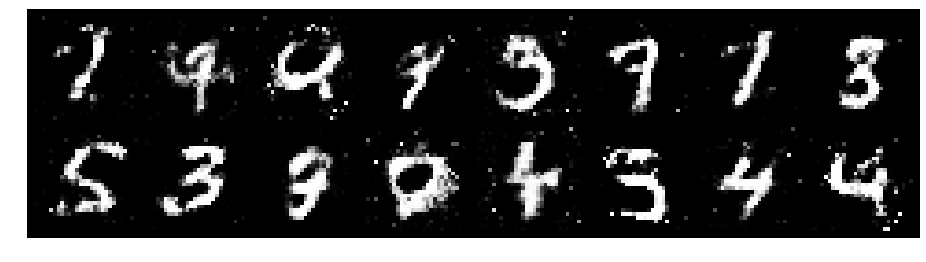

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.2662, Generator Loss: 1.2285
D(x): 0.6176, D(G(z)): 0.4146


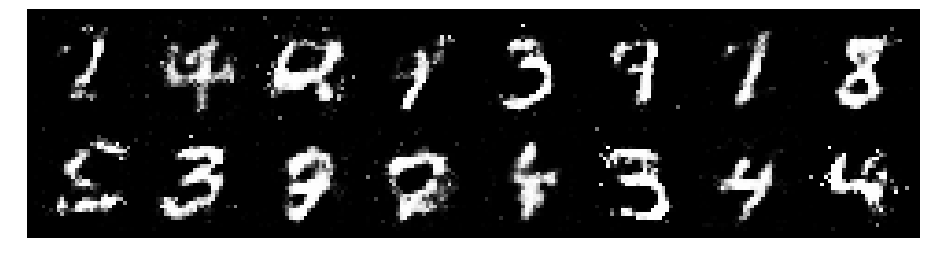

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1476, Generator Loss: 1.2676
D(x): 0.5881, D(G(z)): 0.3661


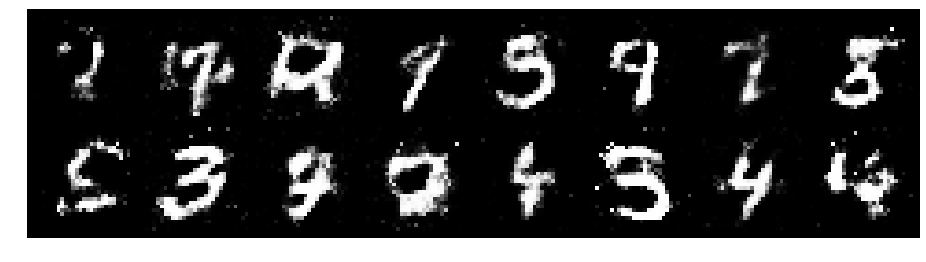

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1688, Generator Loss: 0.9748
D(x): 0.6185, D(G(z)): 0.4306


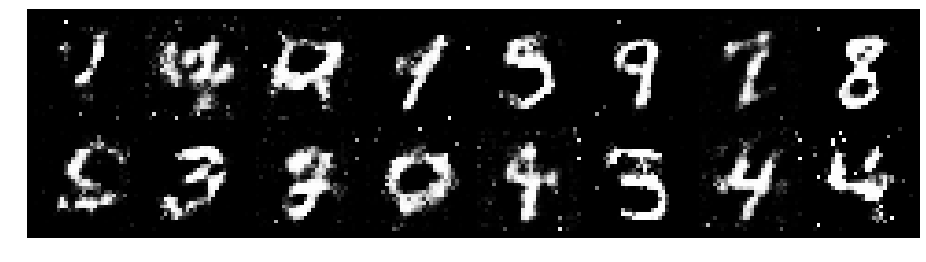

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.1802, Generator Loss: 0.9847
D(x): 0.5498, D(G(z)): 0.3747


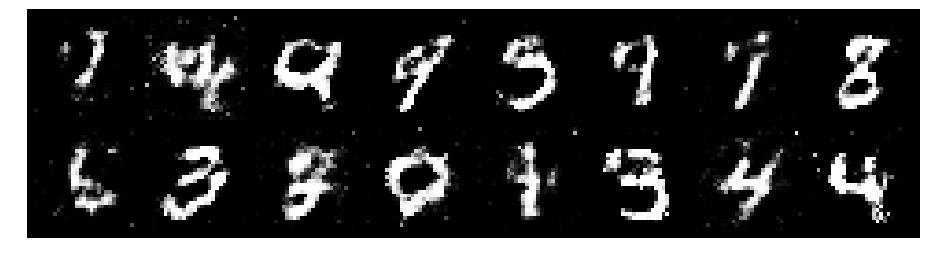

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.2530, Generator Loss: 1.0306
D(x): 0.5966, D(G(z)): 0.4188


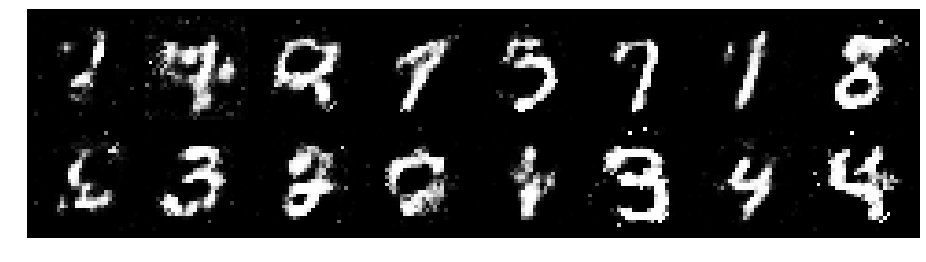

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.2024, Generator Loss: 1.0750
D(x): 0.6784, D(G(z)): 0.4782


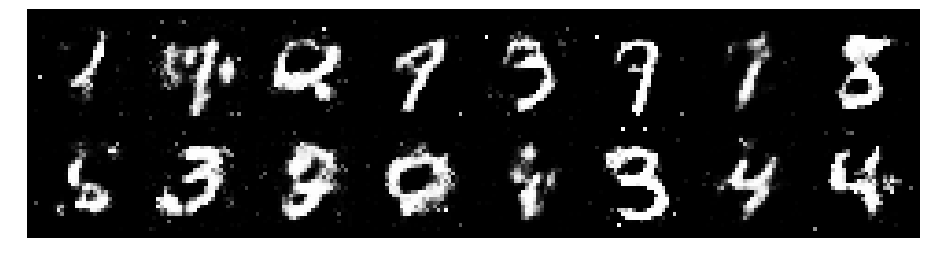

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.3017, Generator Loss: 1.2229
D(x): 0.5853, D(G(z)): 0.4158


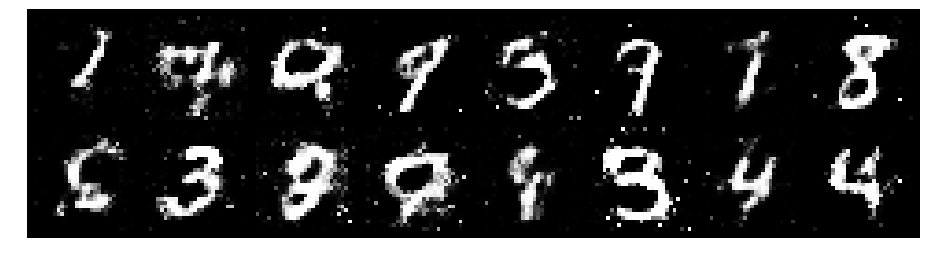

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.0747, Generator Loss: 1.2812
D(x): 0.6422, D(G(z)): 0.3627


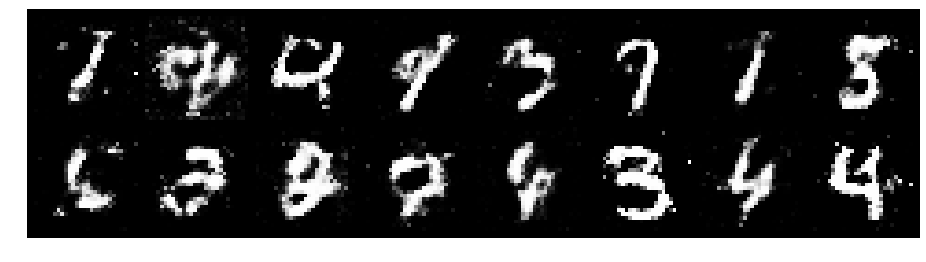

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1666, Generator Loss: 0.9241
D(x): 0.6750, D(G(z)): 0.4382


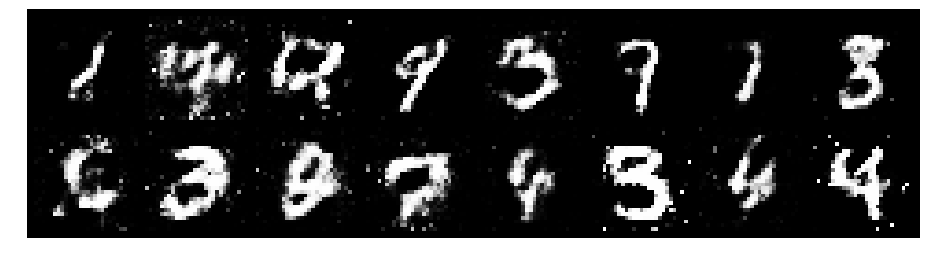

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.0772, Generator Loss: 1.2658
D(x): 0.6286, D(G(z)): 0.3783


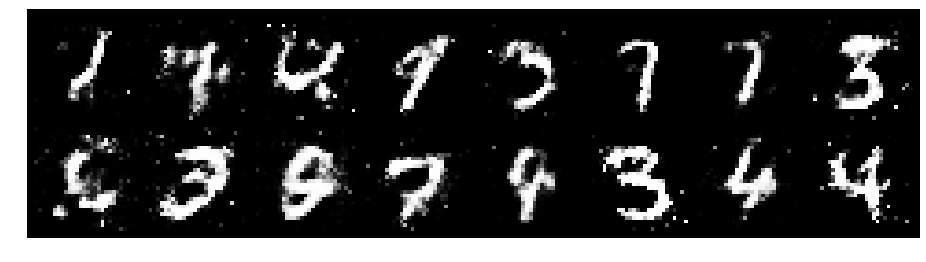

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.0755, Generator Loss: 1.3092
D(x): 0.6763, D(G(z)): 0.4246


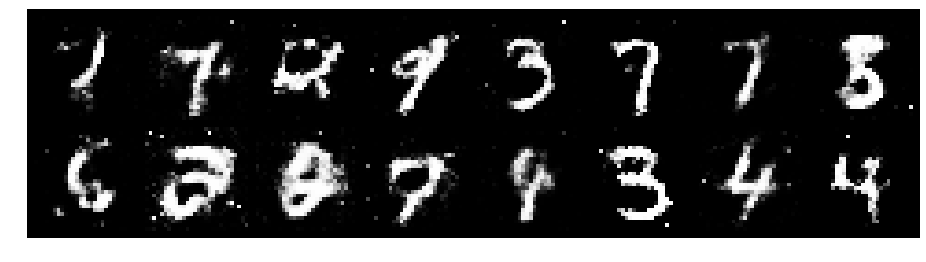

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.1855, Generator Loss: 1.3169
D(x): 0.5868, D(G(z)): 0.3782


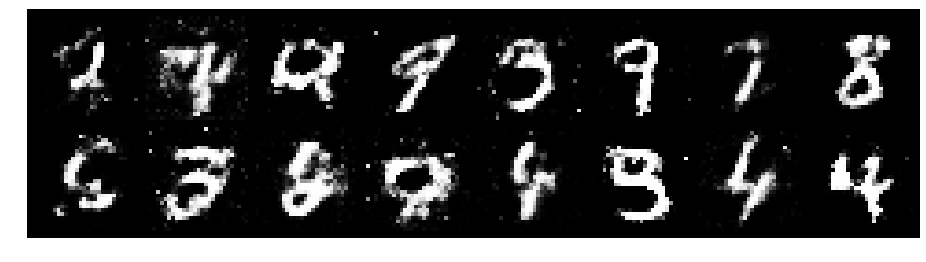

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.2634, Generator Loss: 1.0019
D(x): 0.5987, D(G(z)): 0.4470


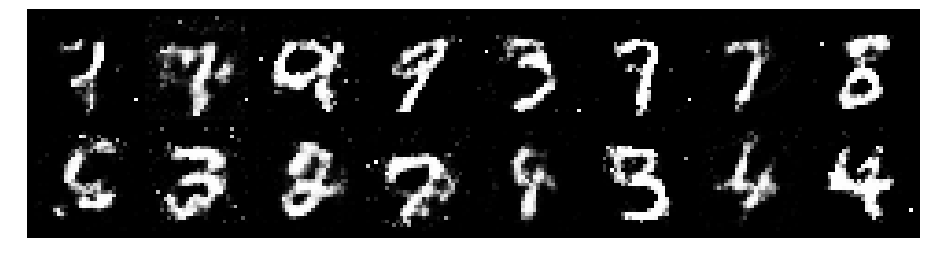

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.1150, Generator Loss: 1.0905
D(x): 0.6859, D(G(z)): 0.4233


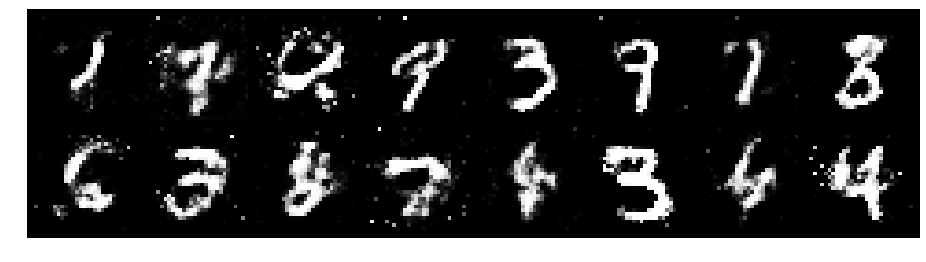

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.2169, Generator Loss: 1.2852
D(x): 0.6318, D(G(z)): 0.4252


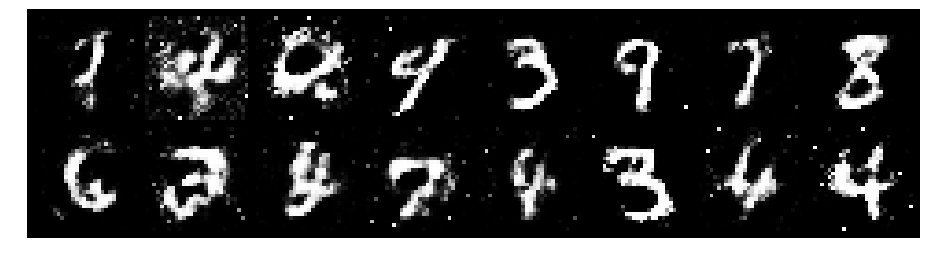

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.0594, Generator Loss: 1.2683
D(x): 0.6446, D(G(z)): 0.3688


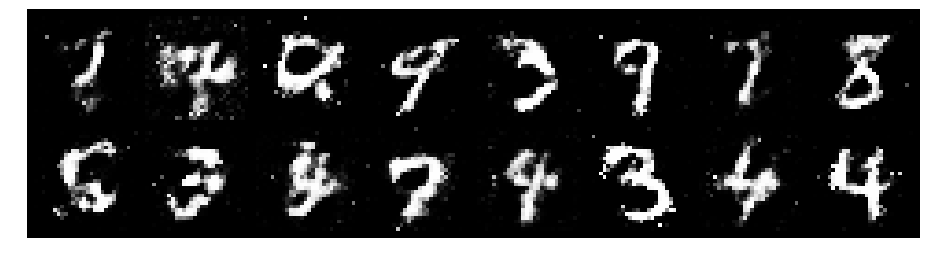

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.0498, Generator Loss: 1.0469
D(x): 0.6781, D(G(z)): 0.4046


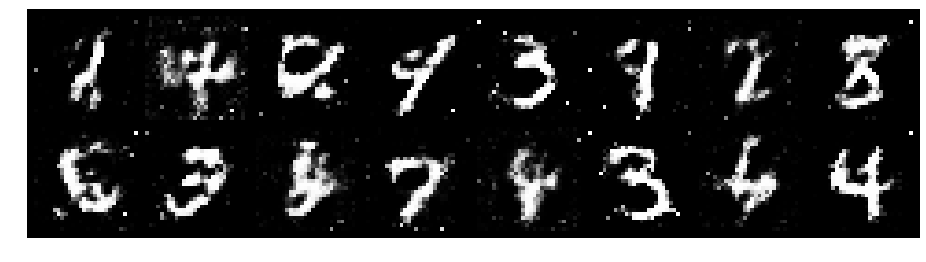

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.0914, Generator Loss: 1.1515
D(x): 0.6446, D(G(z)): 0.3998


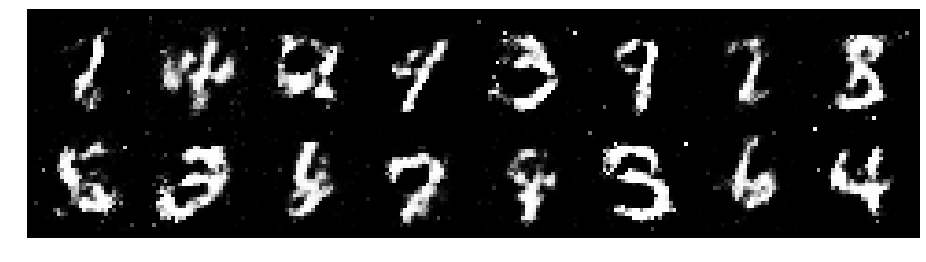

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.0522, Generator Loss: 0.9661
D(x): 0.6392, D(G(z)): 0.3994


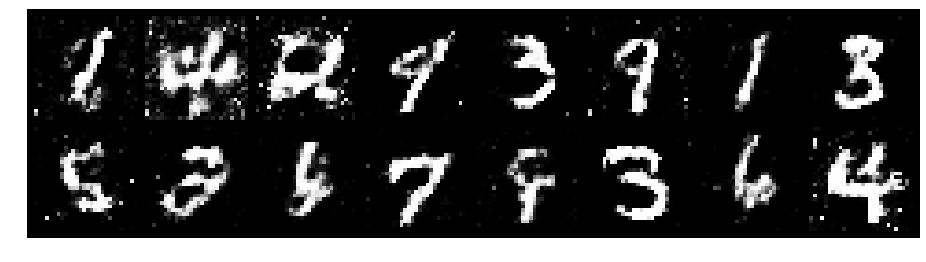

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1608, Generator Loss: 0.9281
D(x): 0.6011, D(G(z)): 0.4237


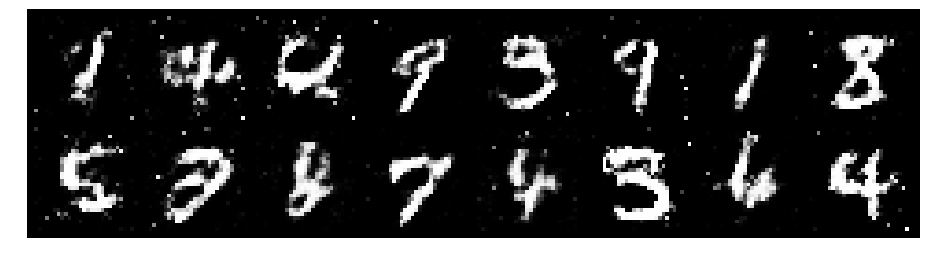

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.3226, Generator Loss: 1.0221
D(x): 0.5751, D(G(z)): 0.4540


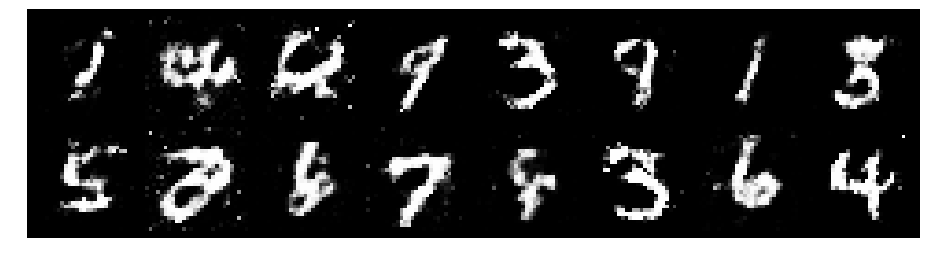

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.0218, Generator Loss: 1.1899
D(x): 0.6263, D(G(z)): 0.3393


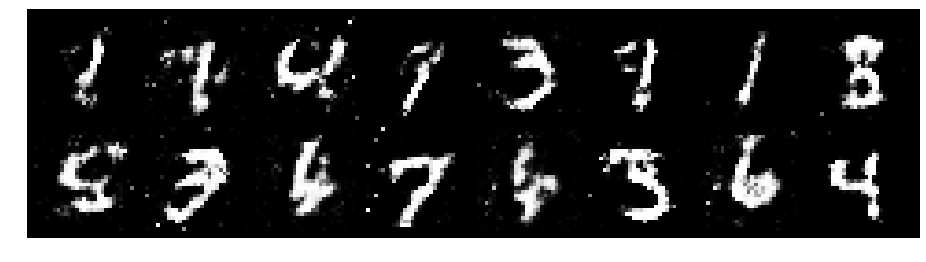

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1346, Generator Loss: 0.9612
D(x): 0.6306, D(G(z)): 0.4256


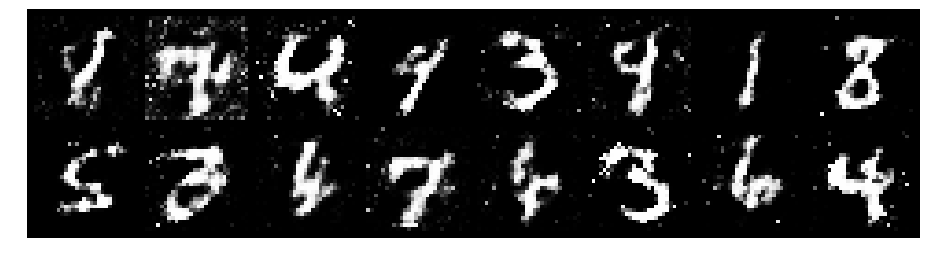

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1620, Generator Loss: 0.9157
D(x): 0.5606, D(G(z)): 0.3881


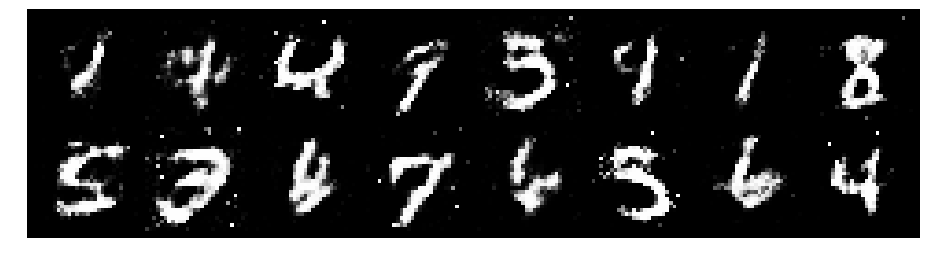

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2670, Generator Loss: 0.8768
D(x): 0.5750, D(G(z)): 0.4559


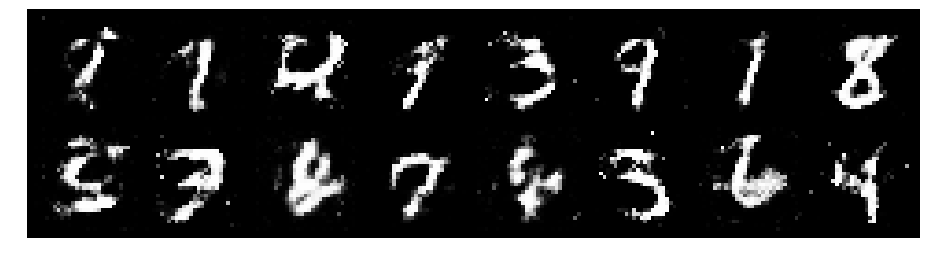

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.2114, Generator Loss: 0.8321
D(x): 0.6202, D(G(z)): 0.4597


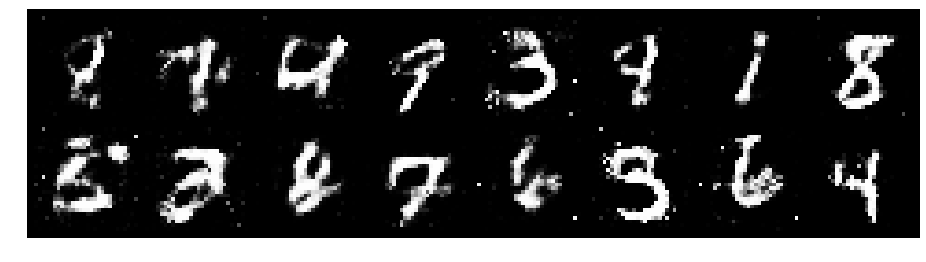

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.3424, Generator Loss: 0.9167
D(x): 0.5824, D(G(z)): 0.4648


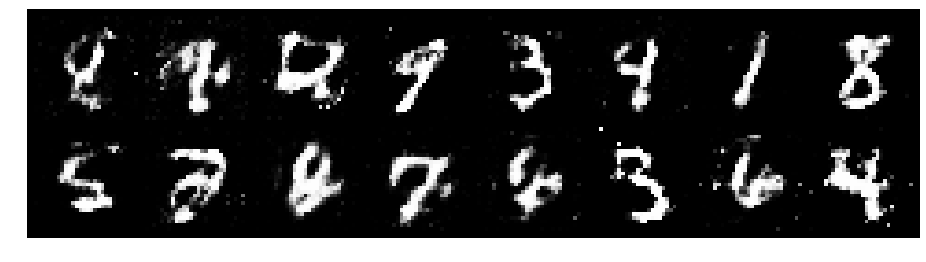

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2924, Generator Loss: 0.8727
D(x): 0.5671, D(G(z)): 0.4393


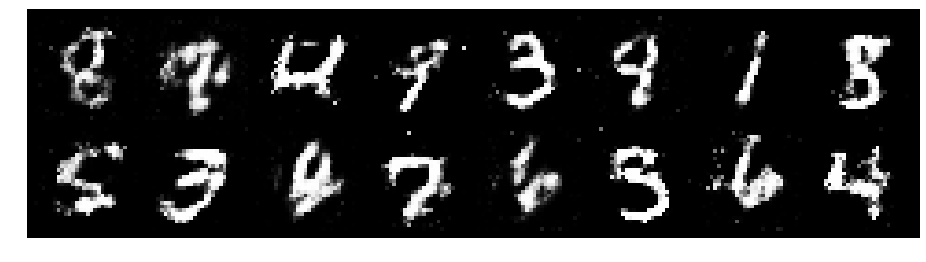

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1919, Generator Loss: 1.2020
D(x): 0.5764, D(G(z)): 0.3937


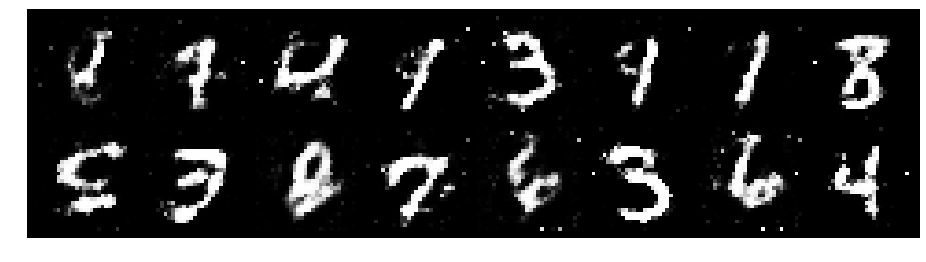

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.3042, Generator Loss: 0.9559
D(x): 0.5985, D(G(z)): 0.4405


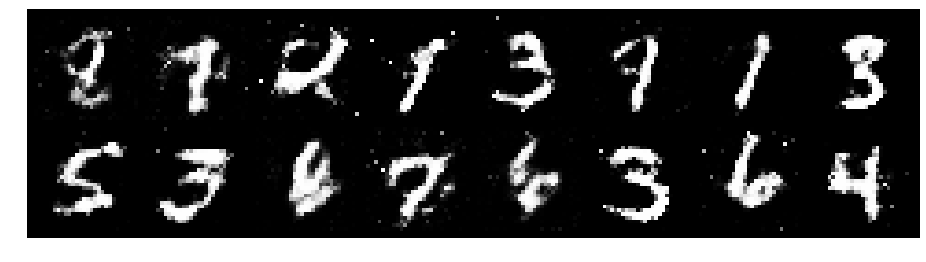

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.2490, Generator Loss: 1.0547
D(x): 0.5365, D(G(z)): 0.3468


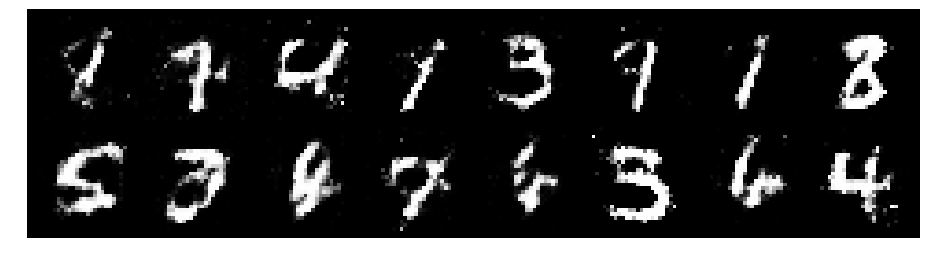

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.0501, Generator Loss: 1.2367
D(x): 0.6026, D(G(z)): 0.3535


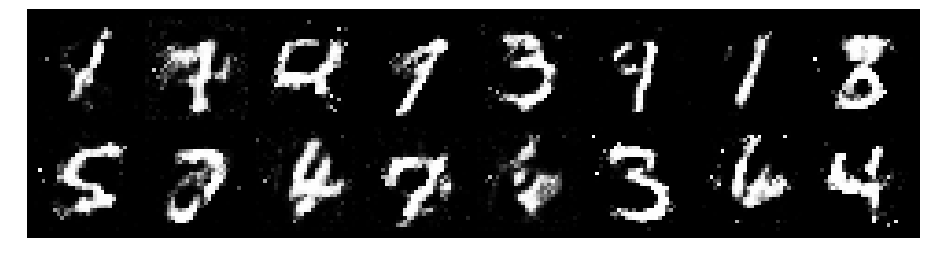

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1395, Generator Loss: 1.1139
D(x): 0.6254, D(G(z)): 0.4056


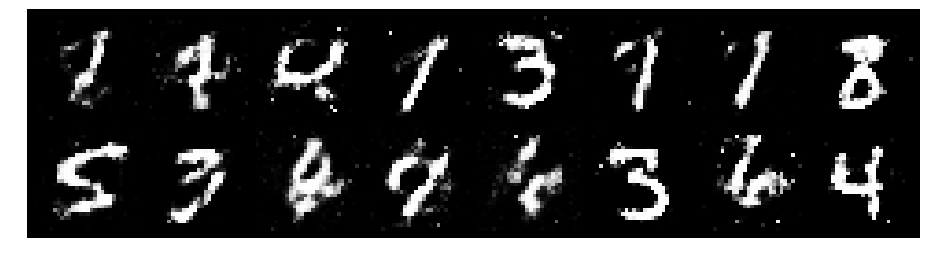

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.1345, Generator Loss: 0.9581
D(x): 0.5849, D(G(z)): 0.3877


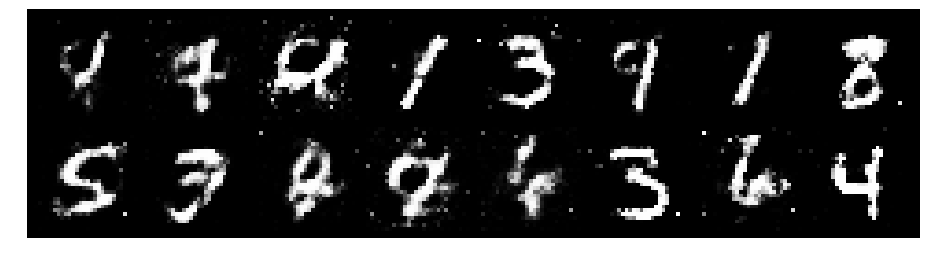

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.0466, Generator Loss: 1.1162
D(x): 0.6903, D(G(z)): 0.4180


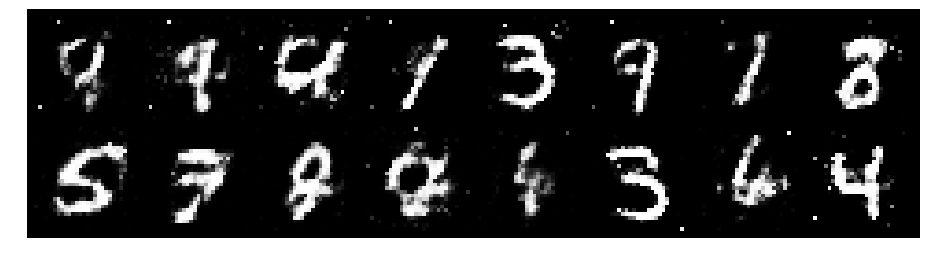

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.0203, Generator Loss: 1.1726
D(x): 0.6488, D(G(z)): 0.3770


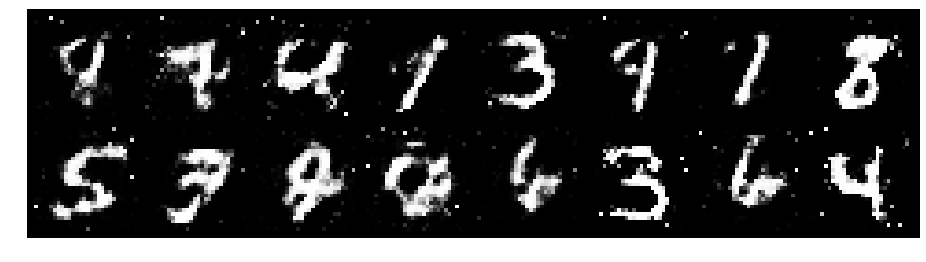

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2218, Generator Loss: 1.0051
D(x): 0.6503, D(G(z)): 0.4760


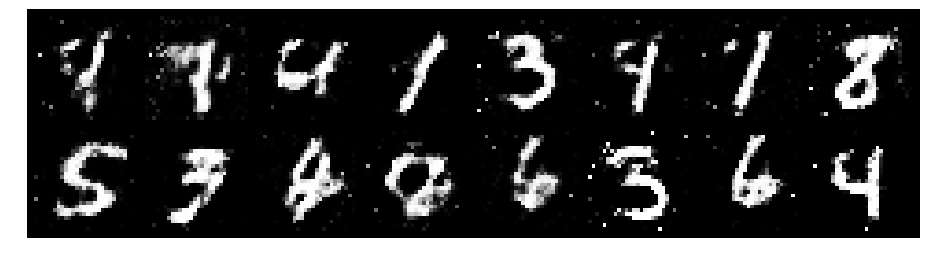

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.2049, Generator Loss: 0.8530
D(x): 0.6301, D(G(z)): 0.4643


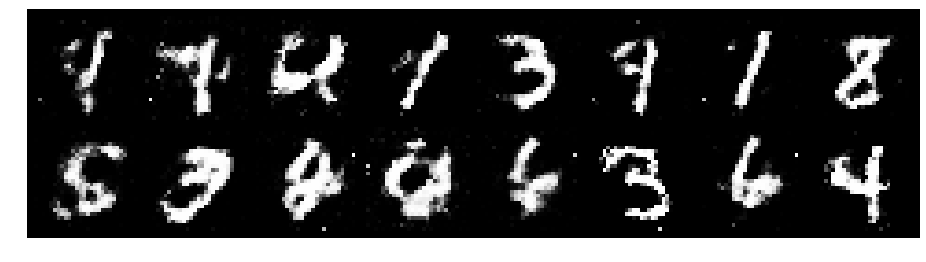

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.1733, Generator Loss: 0.9750
D(x): 0.5619, D(G(z)): 0.3917


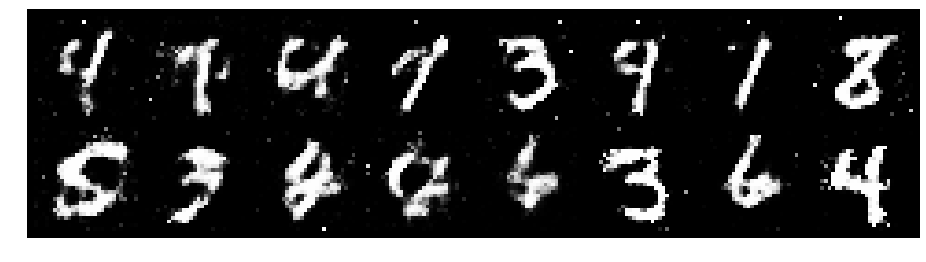

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.0727, Generator Loss: 0.9987
D(x): 0.6473, D(G(z)): 0.3800


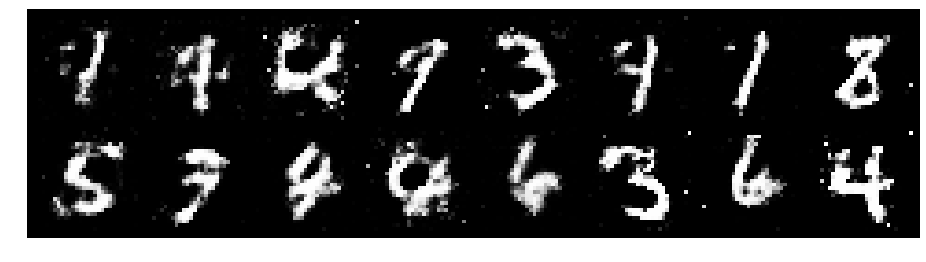

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2546, Generator Loss: 1.1554
D(x): 0.5749, D(G(z)): 0.4072


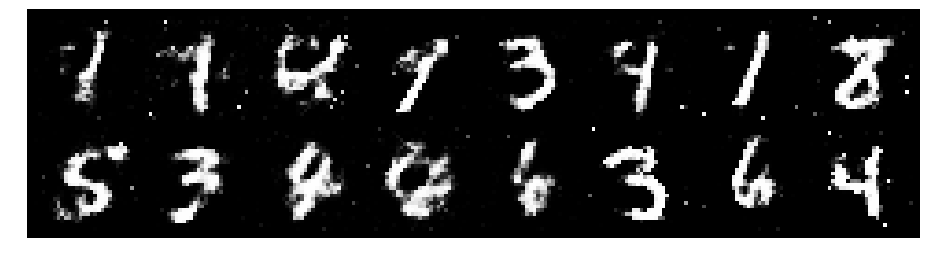

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.3041, Generator Loss: 0.8467
D(x): 0.5642, D(G(z)): 0.4395


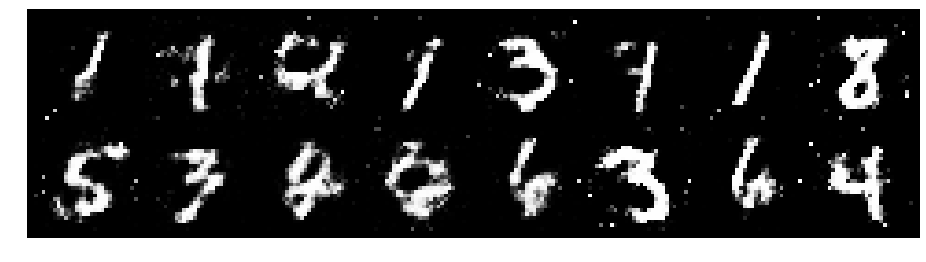

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.2761, Generator Loss: 0.9258
D(x): 0.6405, D(G(z)): 0.4945


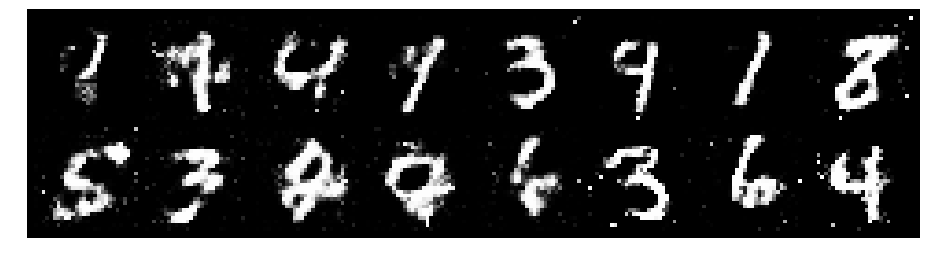

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.3023, Generator Loss: 1.1005
D(x): 0.5855, D(G(z)): 0.4310


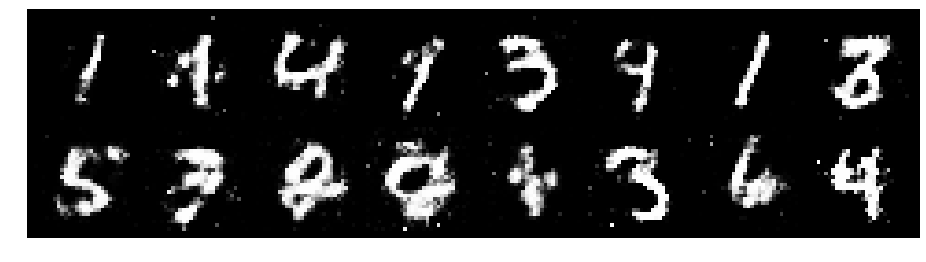

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.2302, Generator Loss: 0.8456
D(x): 0.6502, D(G(z)): 0.4592


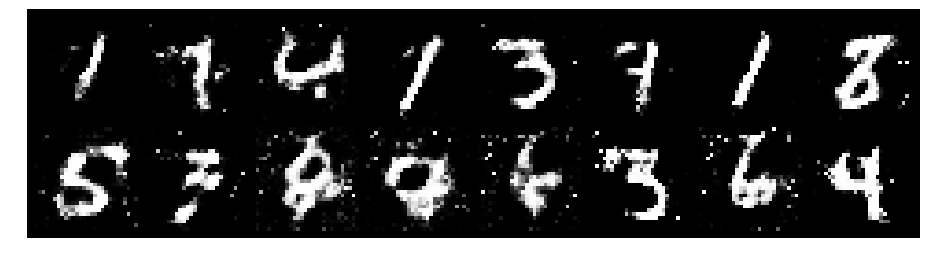

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.0839, Generator Loss: 1.4773
D(x): 0.5835, D(G(z)): 0.3343


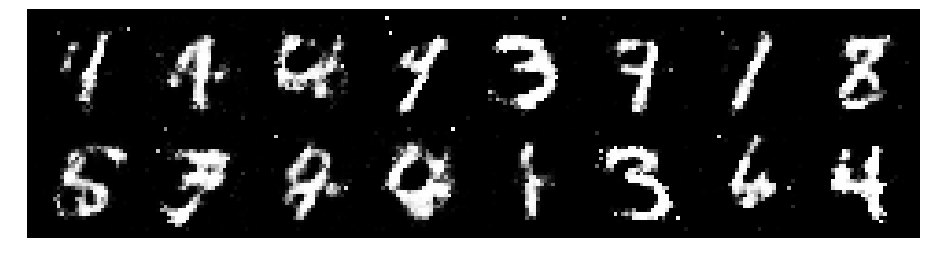

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1046, Generator Loss: 1.0934
D(x): 0.6805, D(G(z)): 0.4340


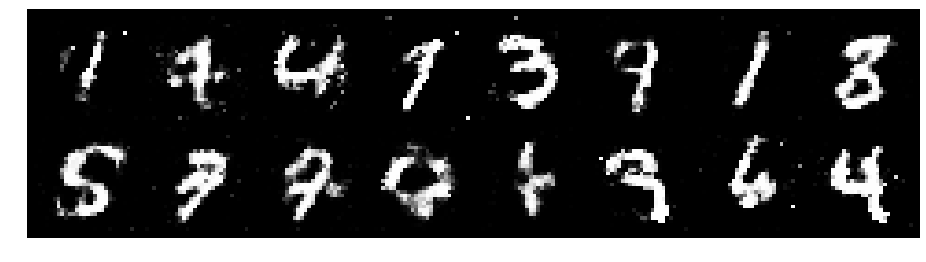

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1717, Generator Loss: 1.3763
D(x): 0.5641, D(G(z)): 0.3289


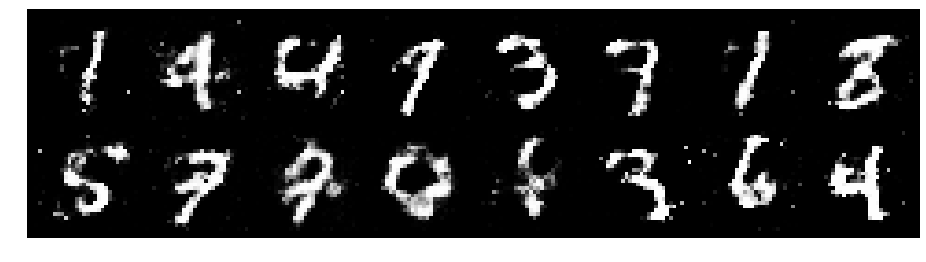

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.1060, Generator Loss: 1.2067
D(x): 0.6135, D(G(z)): 0.3839


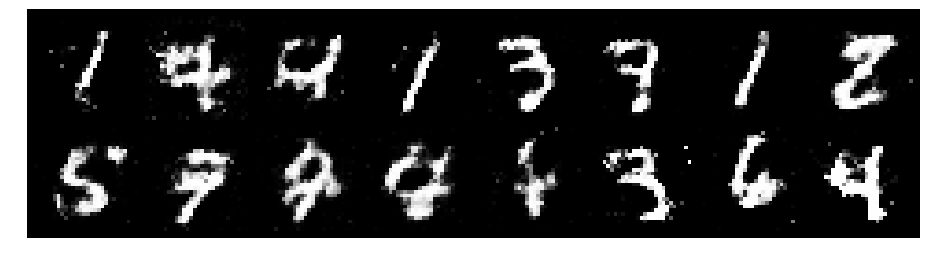

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.0638, Generator Loss: 1.0968
D(x): 0.6230, D(G(z)): 0.3571


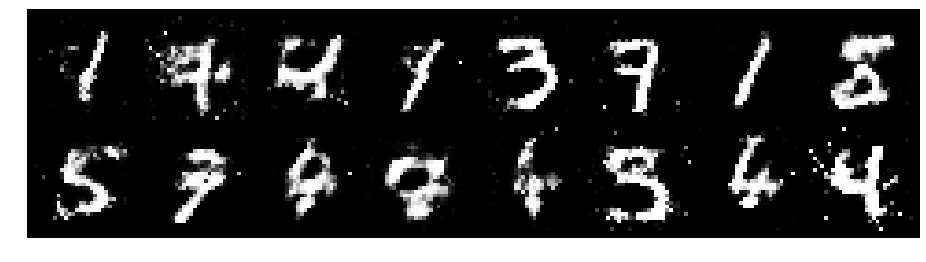

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.0993, Generator Loss: 1.0514
D(x): 0.6013, D(G(z)): 0.3859


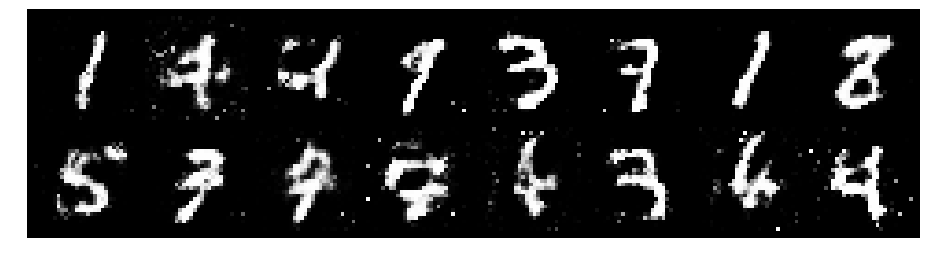

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.2236, Generator Loss: 1.0583
D(x): 0.5688, D(G(z)): 0.4117


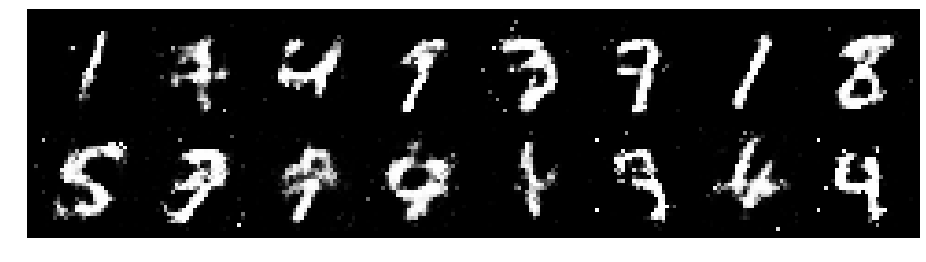

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.1292, Generator Loss: 1.1024
D(x): 0.6129, D(G(z)): 0.3913


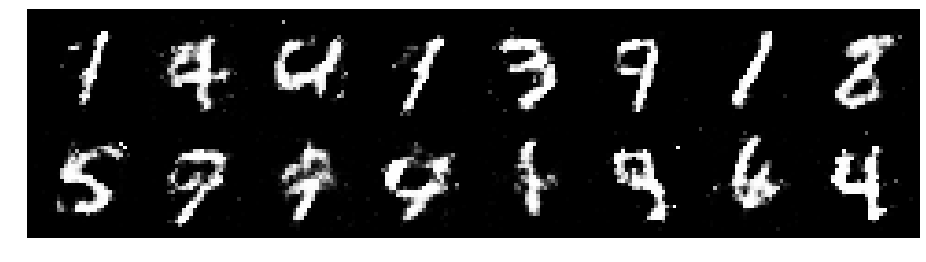

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.2222, Generator Loss: 0.9139
D(x): 0.6037, D(G(z)): 0.4412


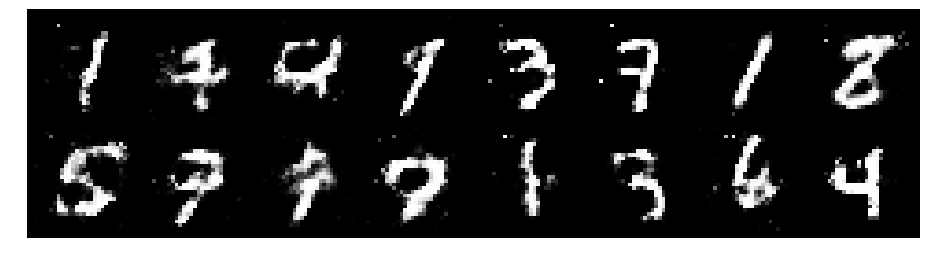

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.2518, Generator Loss: 1.0832
D(x): 0.5342, D(G(z)): 0.3785


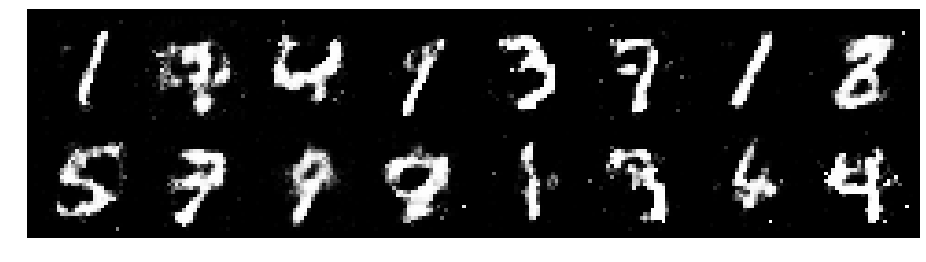

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.1821, Generator Loss: 0.9732
D(x): 0.5912, D(G(z)): 0.4214


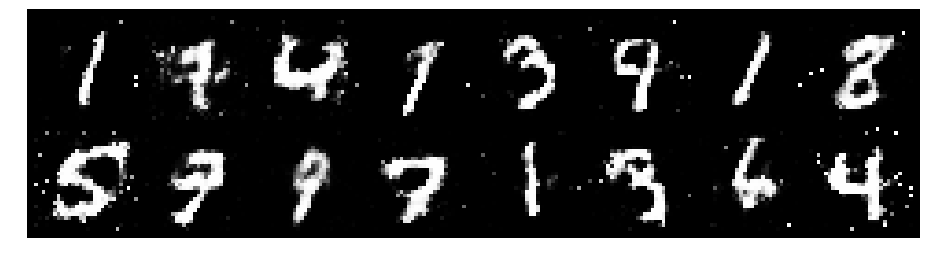

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.2464, Generator Loss: 1.1346
D(x): 0.6434, D(G(z)): 0.4455


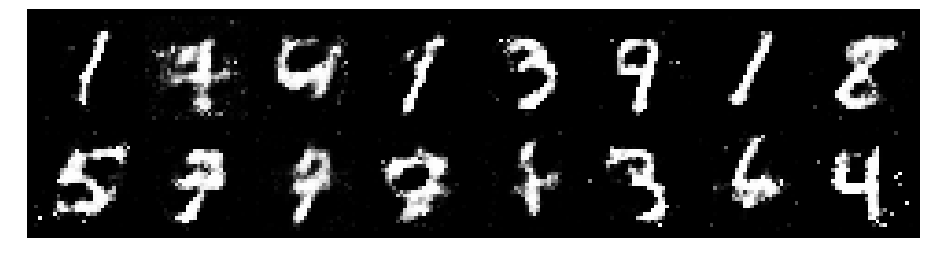

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.2285, Generator Loss: 0.9232
D(x): 0.5614, D(G(z)): 0.4089


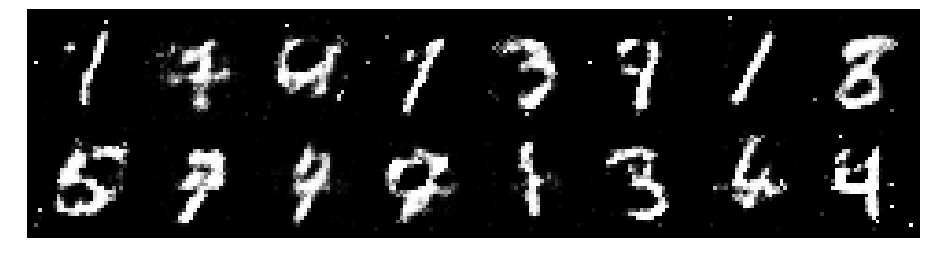

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.0786, Generator Loss: 1.1754
D(x): 0.5966, D(G(z)): 0.3497


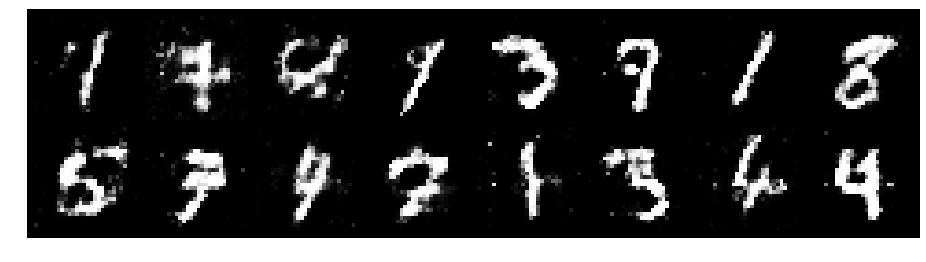

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.2665, Generator Loss: 1.0807
D(x): 0.5969, D(G(z)): 0.4449


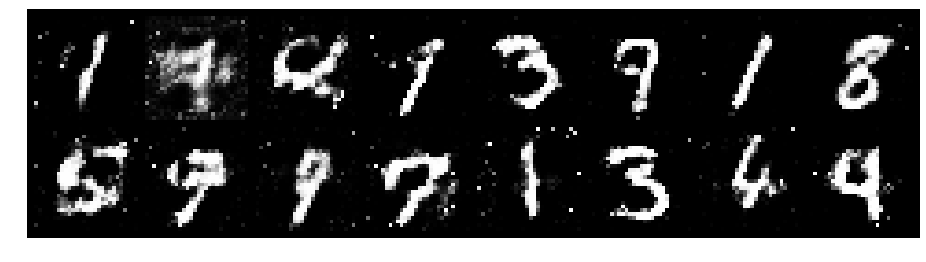

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.1907, Generator Loss: 0.9110
D(x): 0.6010, D(G(z)): 0.4317


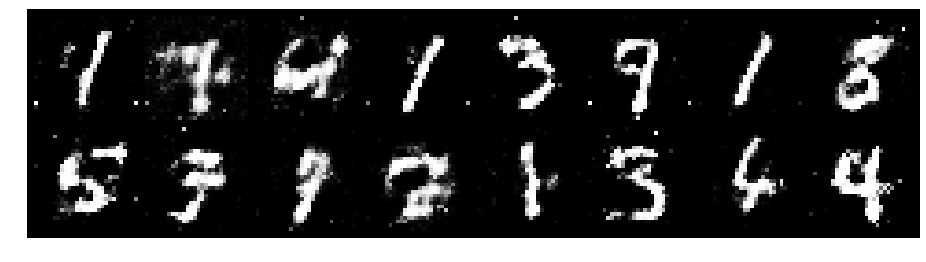

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2361, Generator Loss: 1.1228
D(x): 0.5299, D(G(z)): 0.3432


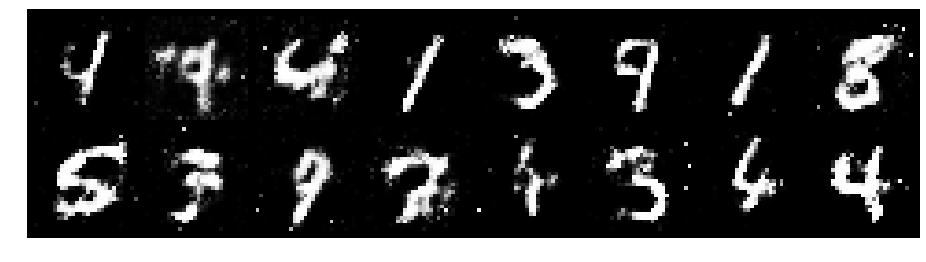

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.2000, Generator Loss: 1.0541
D(x): 0.6016, D(G(z)): 0.4101


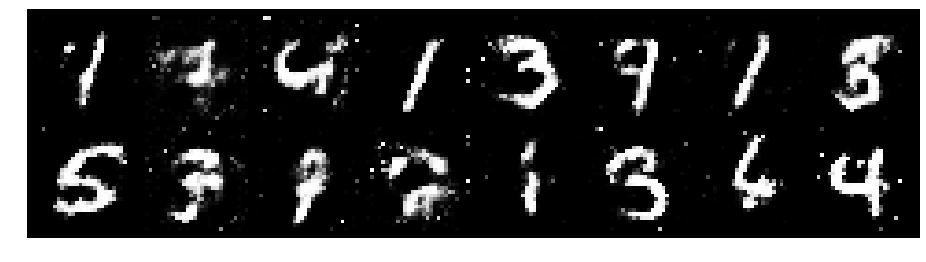

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.4014, Generator Loss: 0.9940
D(x): 0.5171, D(G(z)): 0.4226


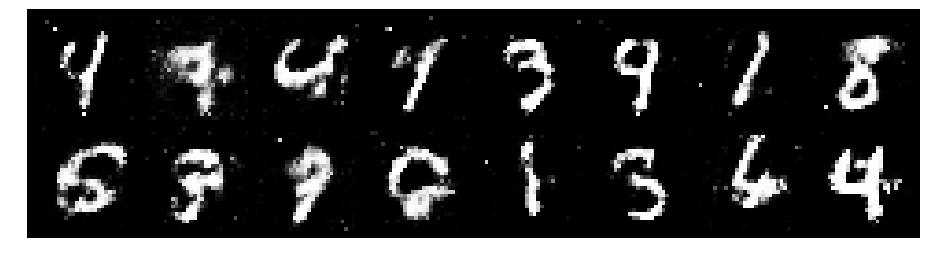

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.2742, Generator Loss: 0.9269
D(x): 0.5790, D(G(z)): 0.4372


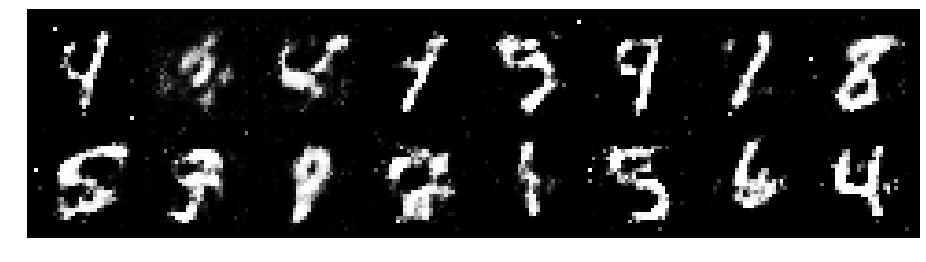

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2923, Generator Loss: 1.0448
D(x): 0.5606, D(G(z)): 0.4130


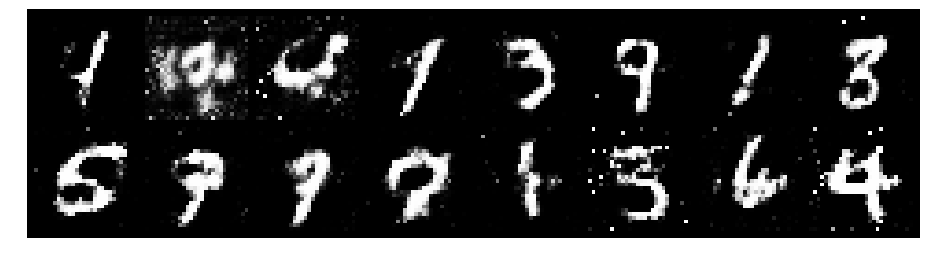

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2284, Generator Loss: 0.9391
D(x): 0.5911, D(G(z)): 0.4163


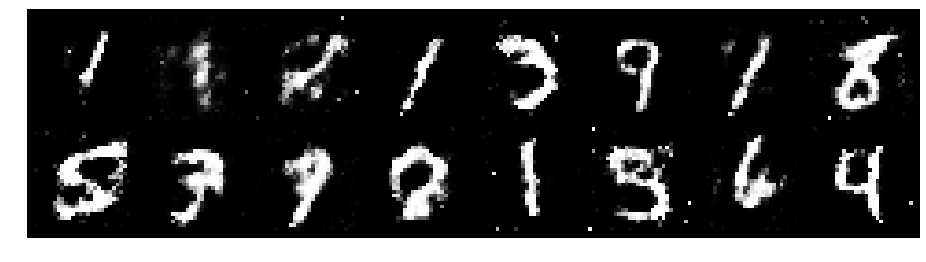

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1811, Generator Loss: 0.8320
D(x): 0.6072, D(G(z)): 0.4463


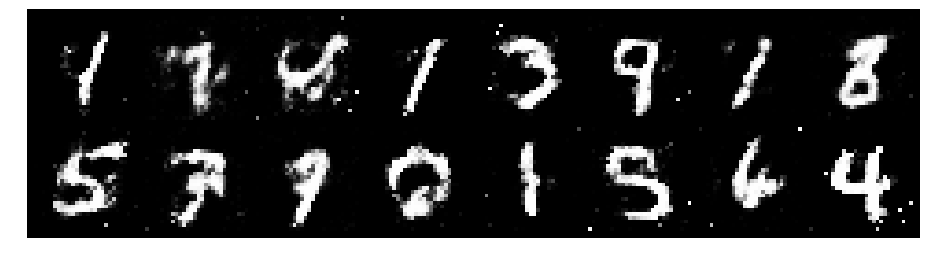

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.2310, Generator Loss: 0.9445
D(x): 0.5613, D(G(z)): 0.4070


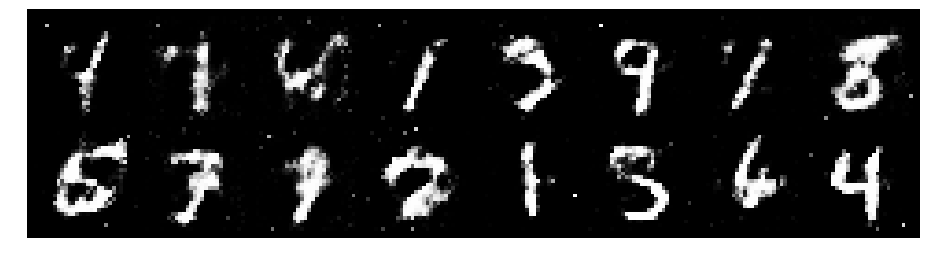

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.3691, Generator Loss: 1.0360
D(x): 0.5295, D(G(z)): 0.4138


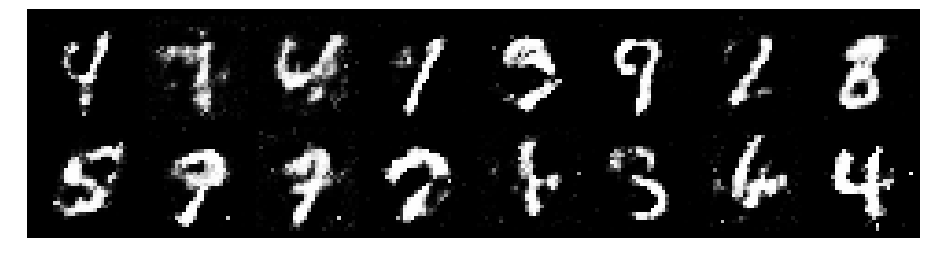

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.2353, Generator Loss: 1.3661
D(x): 0.5749, D(G(z)): 0.3592


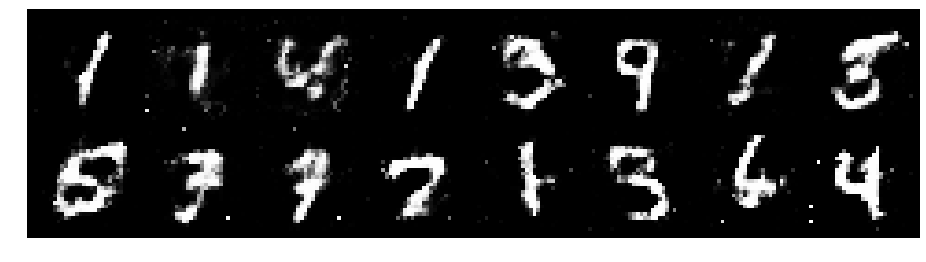

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1702, Generator Loss: 1.0254
D(x): 0.5753, D(G(z)): 0.3982


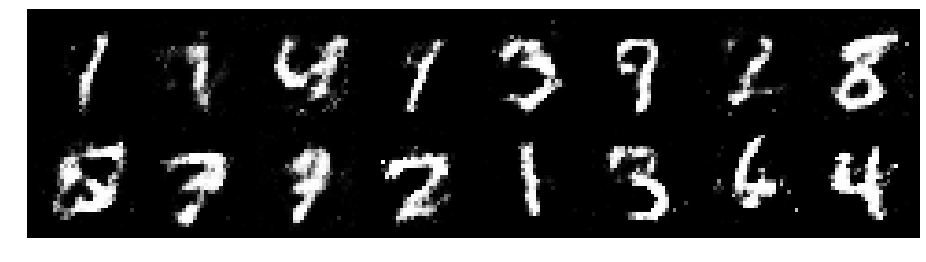

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.0442, Generator Loss: 1.1333
D(x): 0.6202, D(G(z)): 0.3679


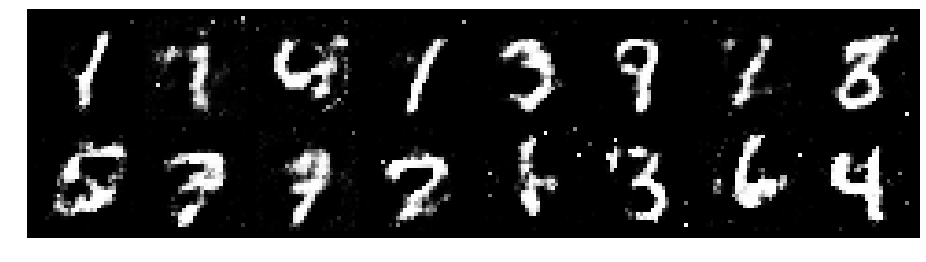

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.1870, Generator Loss: 1.1740
D(x): 0.5967, D(G(z)): 0.4041


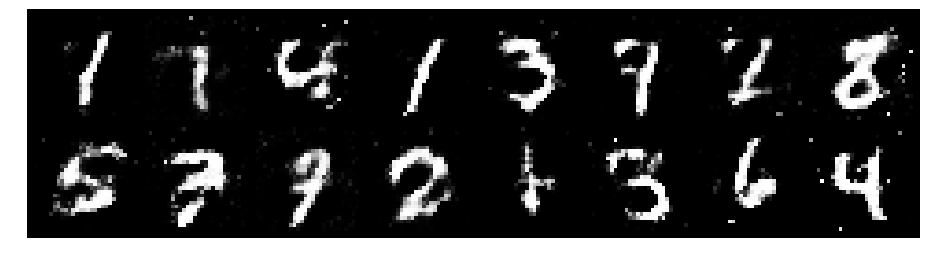

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.1702, Generator Loss: 1.1312
D(x): 0.6173, D(G(z)): 0.4164


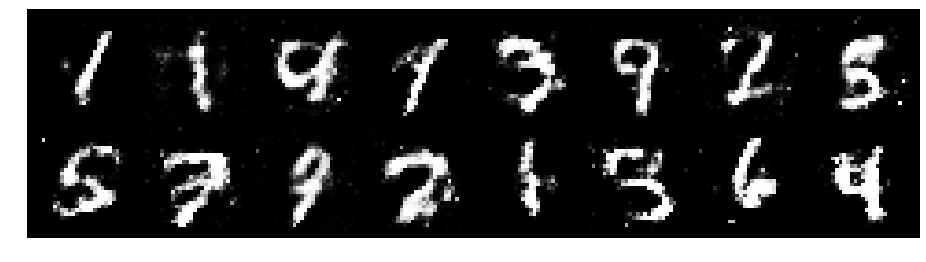

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.3210, Generator Loss: 0.9522
D(x): 0.5179, D(G(z)): 0.4144


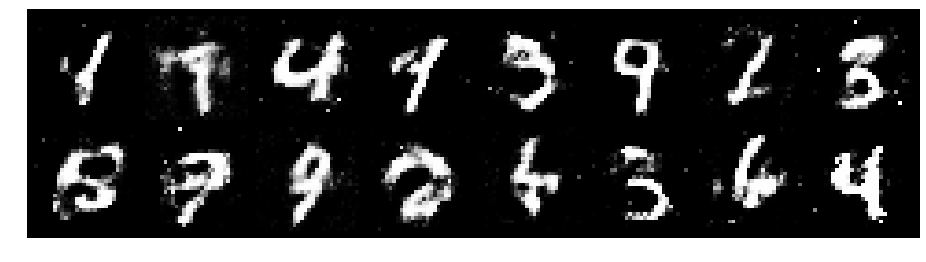

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.3221, Generator Loss: 1.2417
D(x): 0.5651, D(G(z)): 0.4122


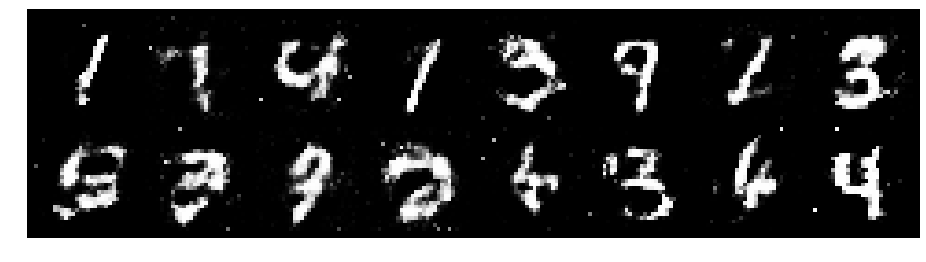

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.1908, Generator Loss: 1.1979
D(x): 0.5761, D(G(z)): 0.3565


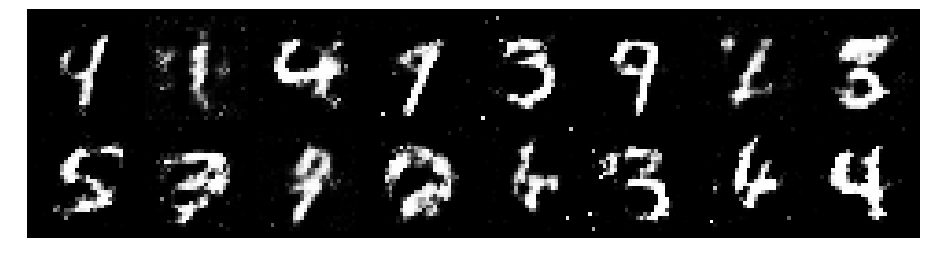

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.3624, Generator Loss: 0.9928
D(x): 0.5818, D(G(z)): 0.4902


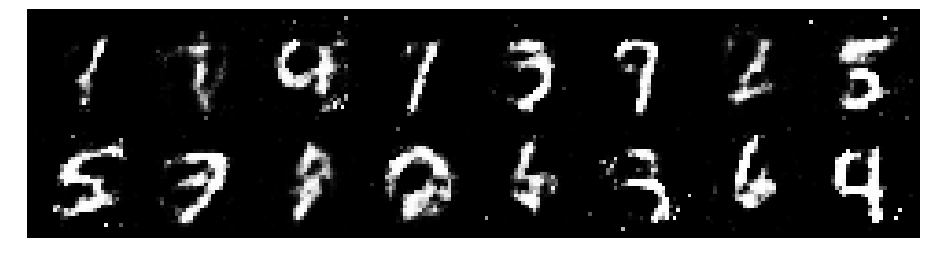

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.3577, Generator Loss: 0.8063
D(x): 0.6228, D(G(z)): 0.5146


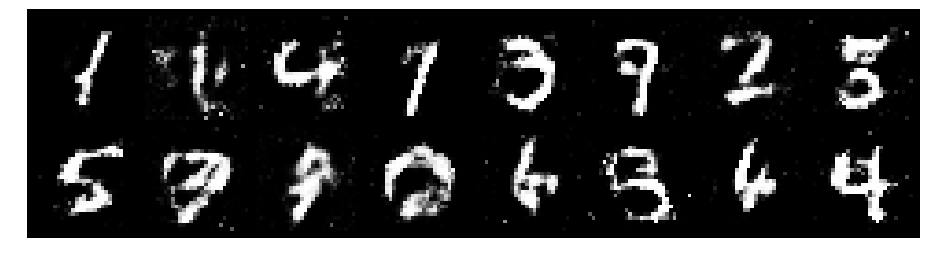

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1793, Generator Loss: 1.2544
D(x): 0.5464, D(G(z)): 0.3616


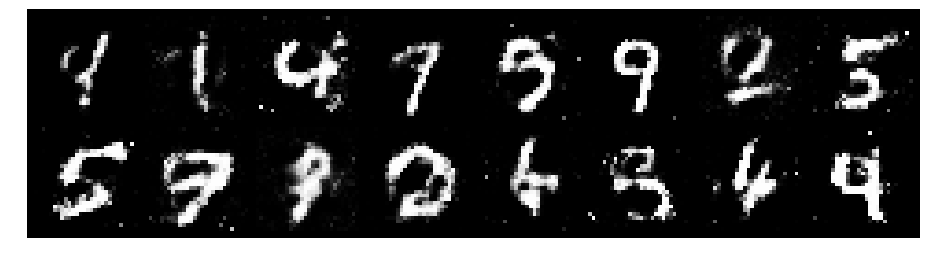

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1263, Generator Loss: 1.0804
D(x): 0.5980, D(G(z)): 0.3783


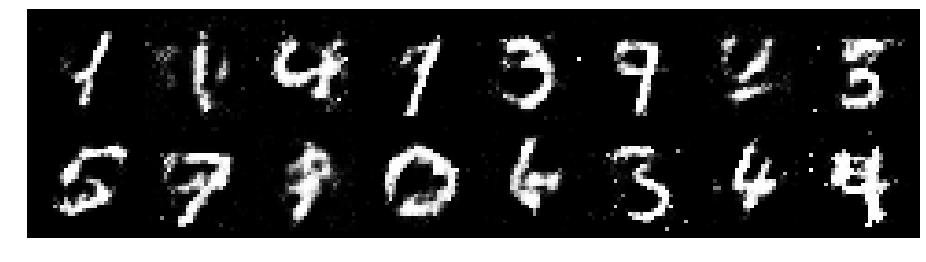

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.0632, Generator Loss: 1.0314
D(x): 0.5999, D(G(z)): 0.3644


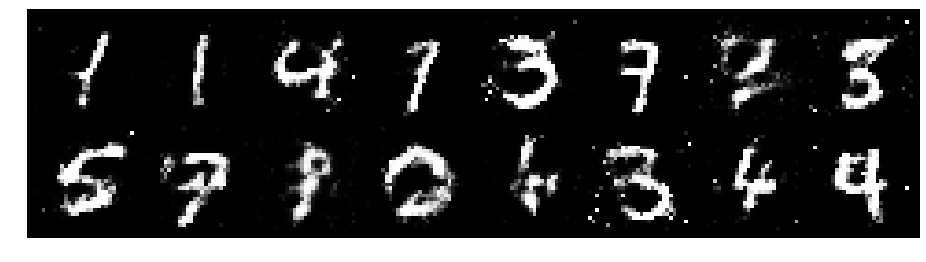

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.1695, Generator Loss: 1.0803
D(x): 0.6318, D(G(z)): 0.4234


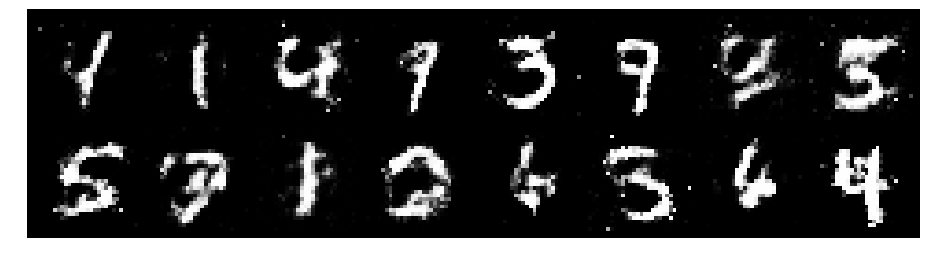

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.1386, Generator Loss: 1.0206
D(x): 0.5670, D(G(z)): 0.3673


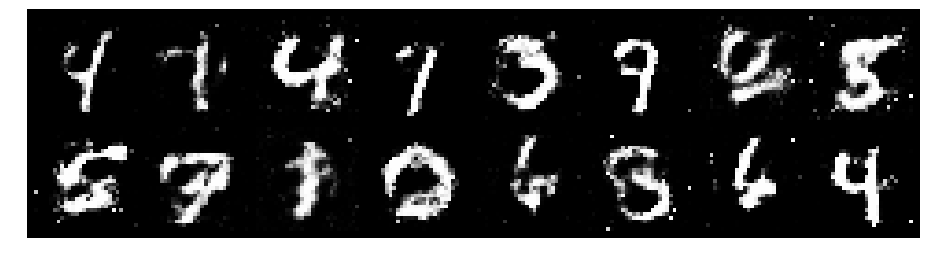

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2990, Generator Loss: 0.9344
D(x): 0.5373, D(G(z)): 0.4332


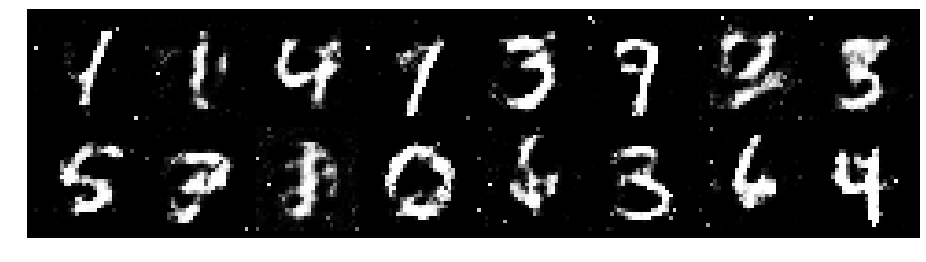

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.3235, Generator Loss: 1.1428
D(x): 0.5577, D(G(z)): 0.4141


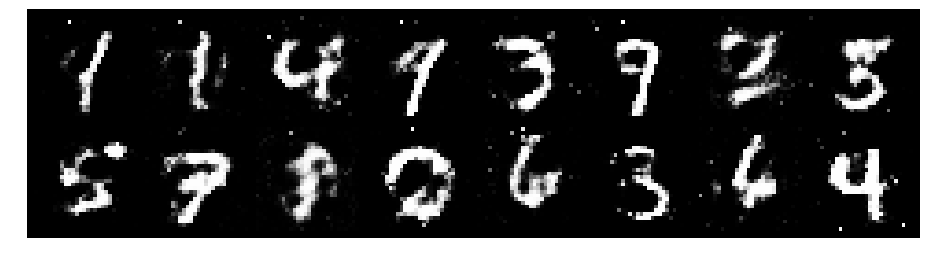

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.1534, Generator Loss: 0.9890
D(x): 0.6230, D(G(z)): 0.4222


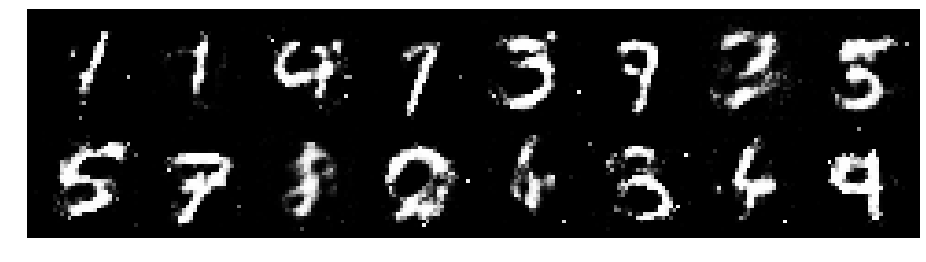

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2542, Generator Loss: 1.0875
D(x): 0.5973, D(G(z)): 0.4199


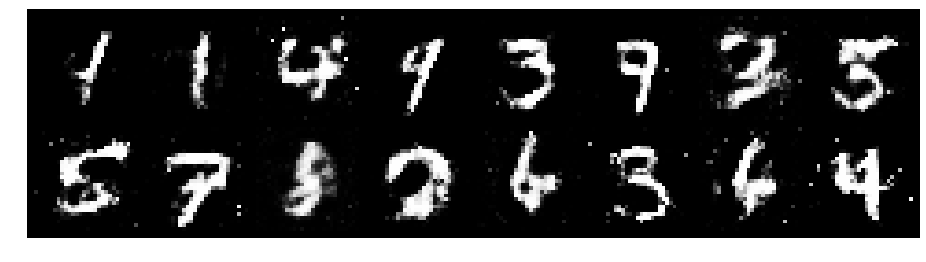

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1990, Generator Loss: 1.3010
D(x): 0.6218, D(G(z)): 0.4199


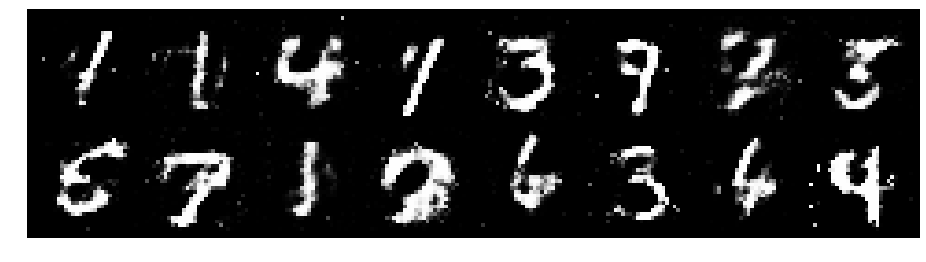

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1215, Generator Loss: 1.0823
D(x): 0.6357, D(G(z)): 0.4154


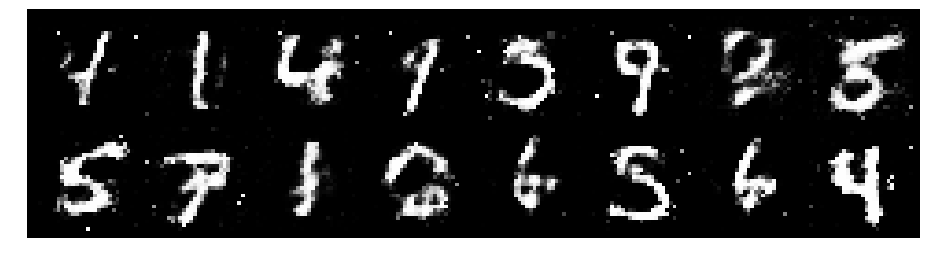

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.1860, Generator Loss: 0.9510
D(x): 0.5538, D(G(z)): 0.3797


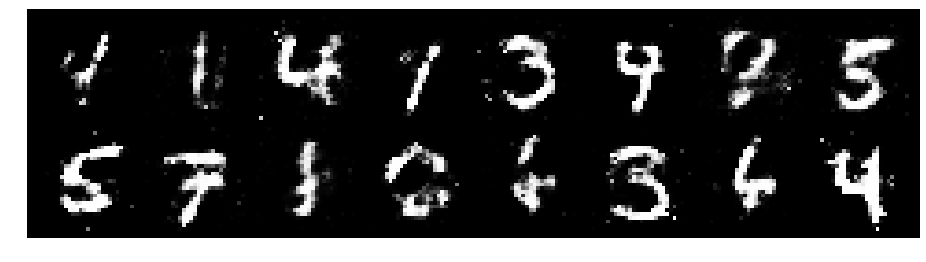

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2554, Generator Loss: 0.9804
D(x): 0.5110, D(G(z)): 0.4004


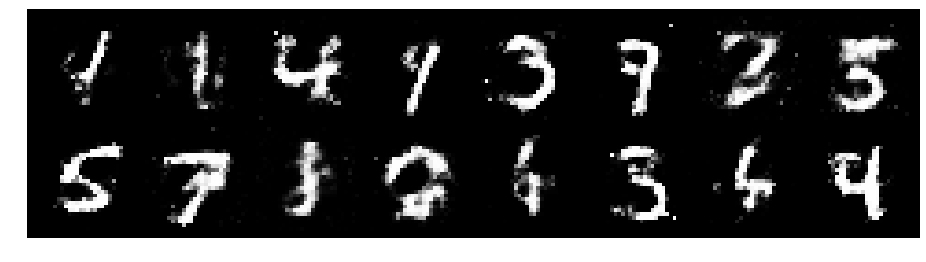

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.0791, Generator Loss: 1.0385
D(x): 0.6096, D(G(z)): 0.3977


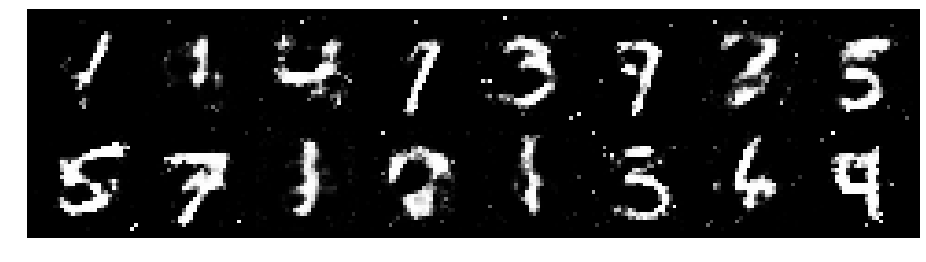

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1135, Generator Loss: 1.1434
D(x): 0.6252, D(G(z)): 0.4057


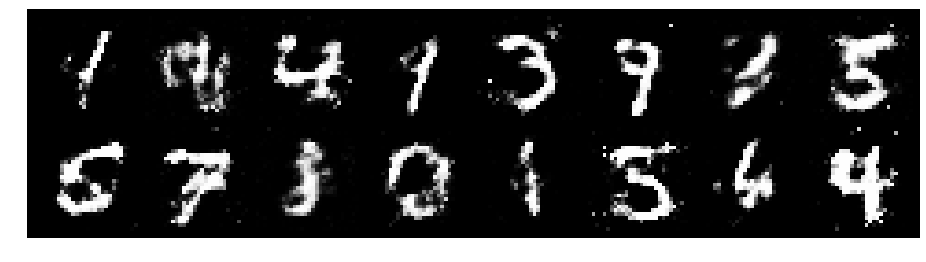

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.1637, Generator Loss: 0.8798
D(x): 0.6344, D(G(z)): 0.4543


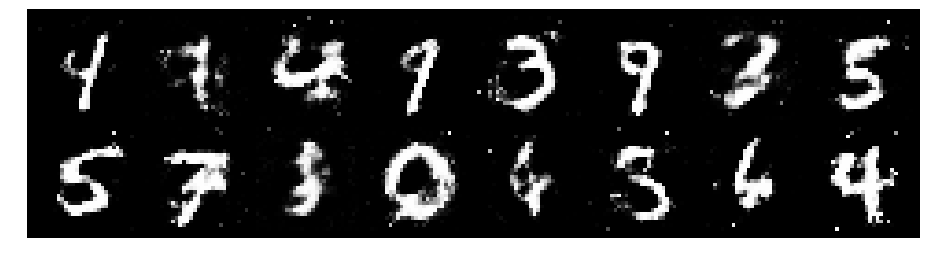

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2315, Generator Loss: 1.1955
D(x): 0.5740, D(G(z)): 0.3723


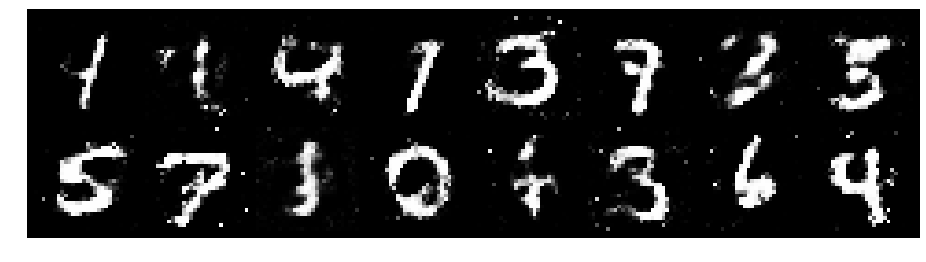

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.3144, Generator Loss: 0.8653
D(x): 0.5721, D(G(z)): 0.4538


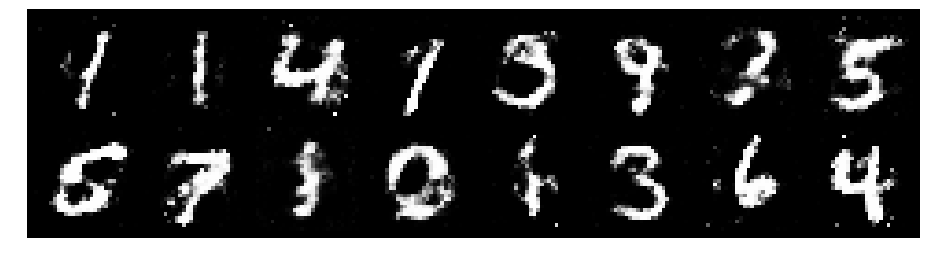

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.3317, Generator Loss: 0.9958
D(x): 0.5530, D(G(z)): 0.4263


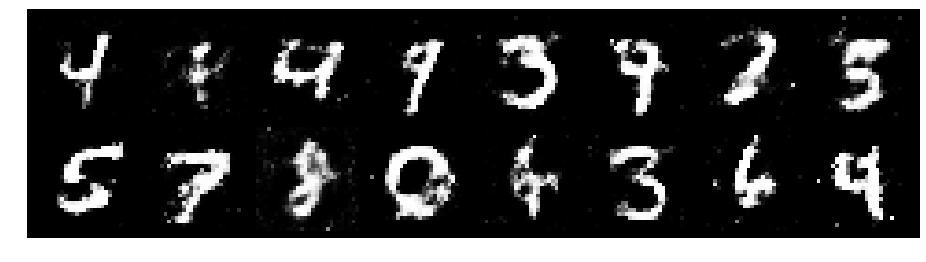

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.3520, Generator Loss: 0.9945
D(x): 0.5324, D(G(z)): 0.4266


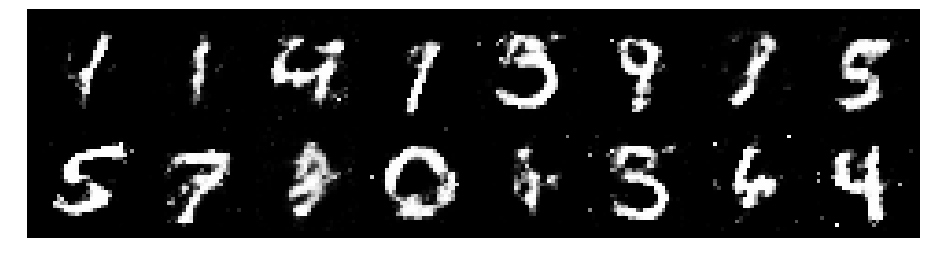

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.3236, Generator Loss: 0.9140
D(x): 0.5824, D(G(z)): 0.4723


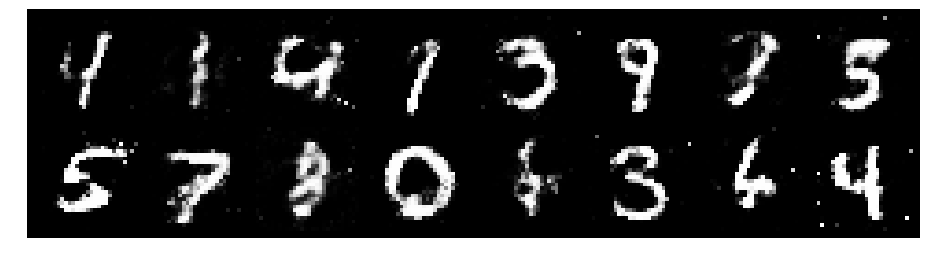

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.3283, Generator Loss: 0.9560
D(x): 0.5635, D(G(z)): 0.4114


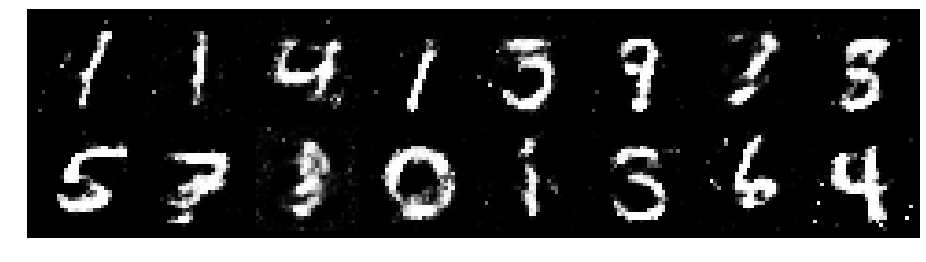

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.3051, Generator Loss: 1.2074
D(x): 0.5139, D(G(z)): 0.3444


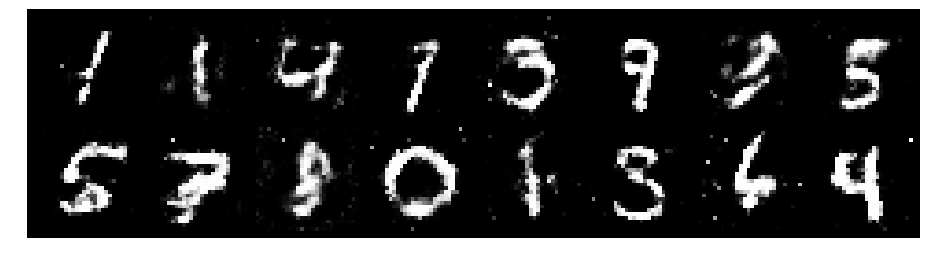

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.1901, Generator Loss: 1.0718
D(x): 0.6168, D(G(z)): 0.4296


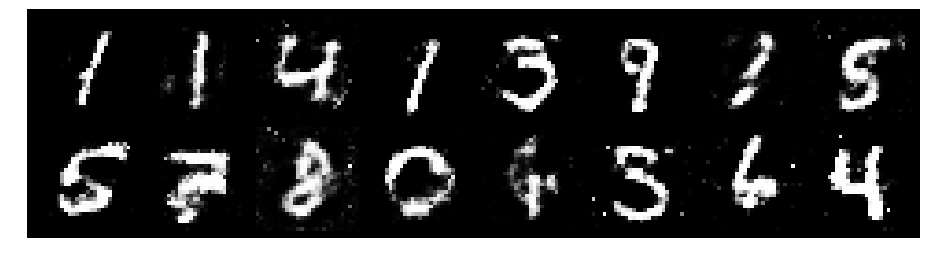

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.1366, Generator Loss: 1.0133
D(x): 0.5899, D(G(z)): 0.3899


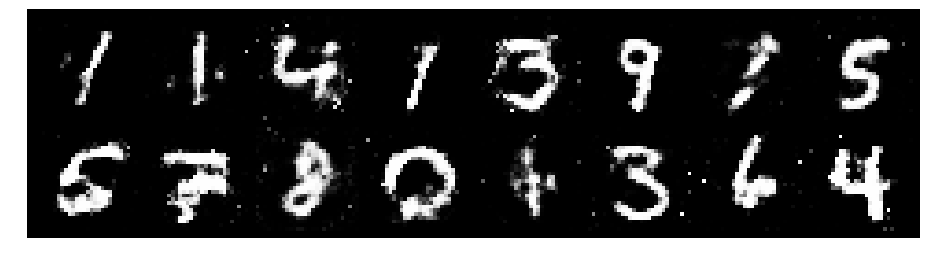

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2126, Generator Loss: 1.0440
D(x): 0.5462, D(G(z)): 0.3850


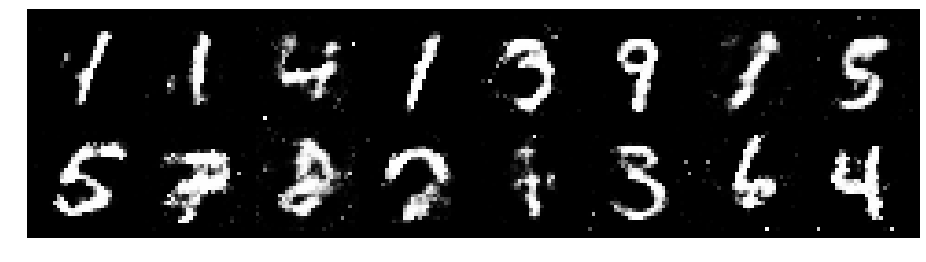

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1970, Generator Loss: 0.9406
D(x): 0.5663, D(G(z)): 0.4204


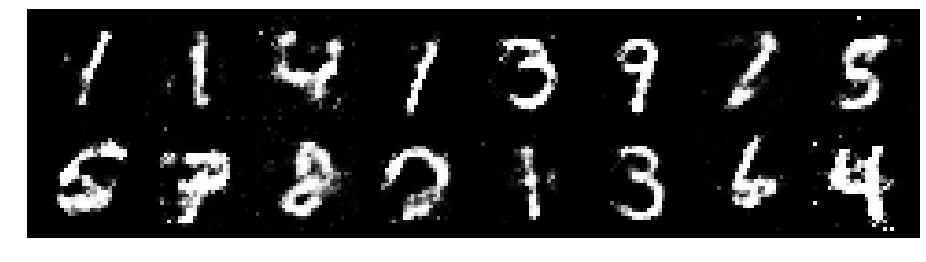

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.2380, Generator Loss: 0.9843
D(x): 0.6090, D(G(z)): 0.4622


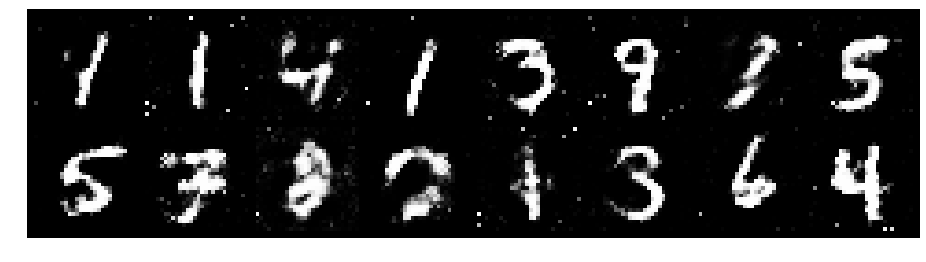

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2987, Generator Loss: 0.9186
D(x): 0.5563, D(G(z)): 0.4305


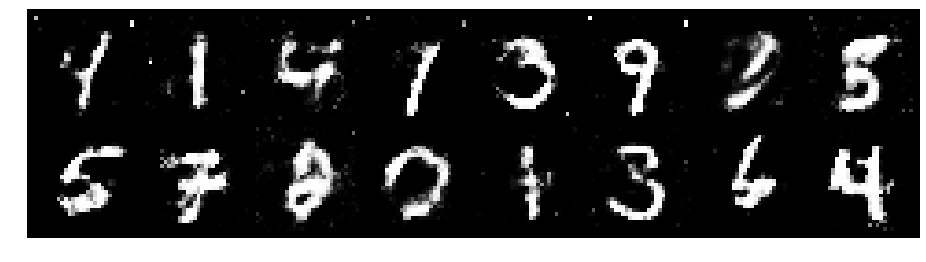

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2786, Generator Loss: 0.9586
D(x): 0.5599, D(G(z)): 0.4600


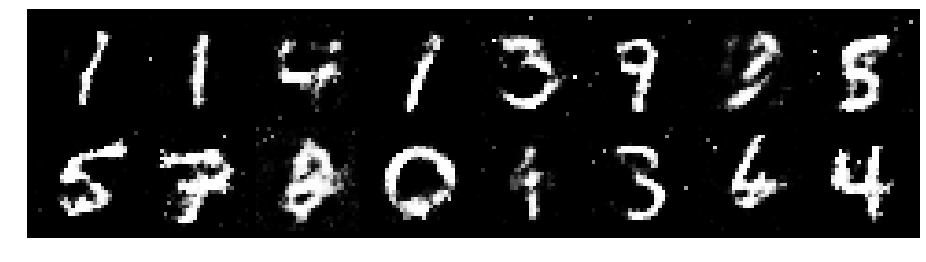

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2015, Generator Loss: 1.0559
D(x): 0.5325, D(G(z)): 0.3702


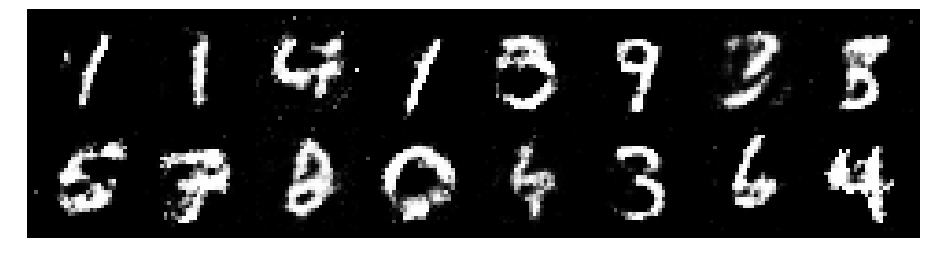

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.3198, Generator Loss: 0.8625
D(x): 0.4912, D(G(z)): 0.4042


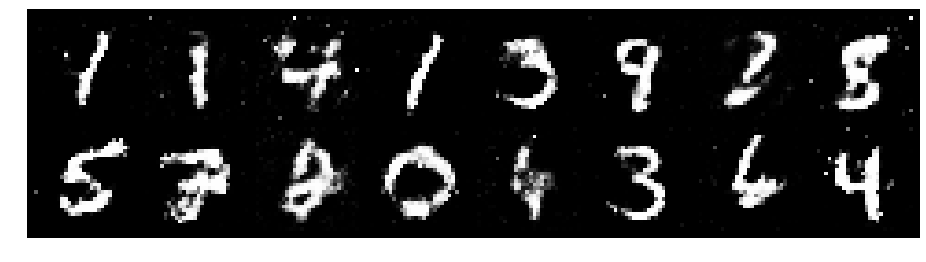

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2650, Generator Loss: 1.0438
D(x): 0.5332, D(G(z)): 0.3602


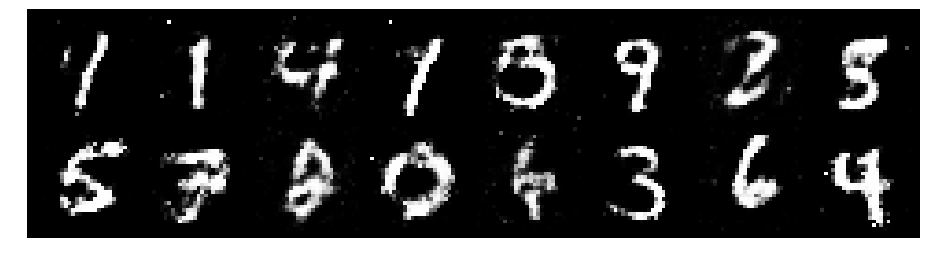

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1962, Generator Loss: 1.1164
D(x): 0.5977, D(G(z)): 0.3814


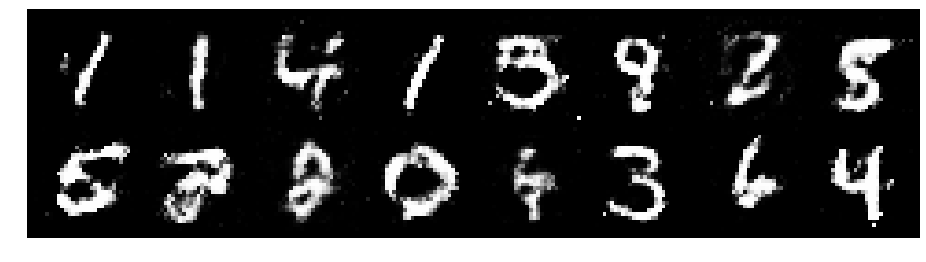

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.2132, Generator Loss: 1.1324
D(x): 0.5659, D(G(z)): 0.4069


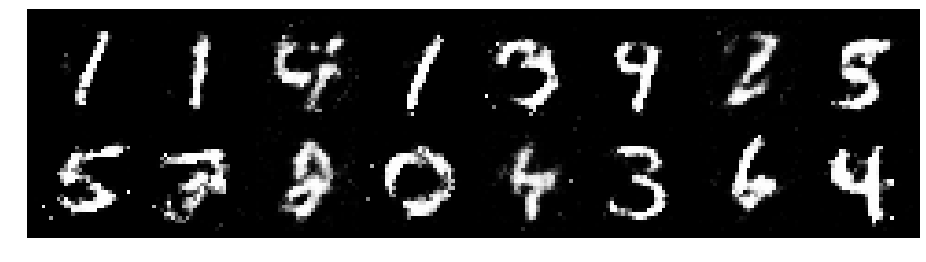

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1507, Generator Loss: 1.0610
D(x): 0.5854, D(G(z)): 0.3828


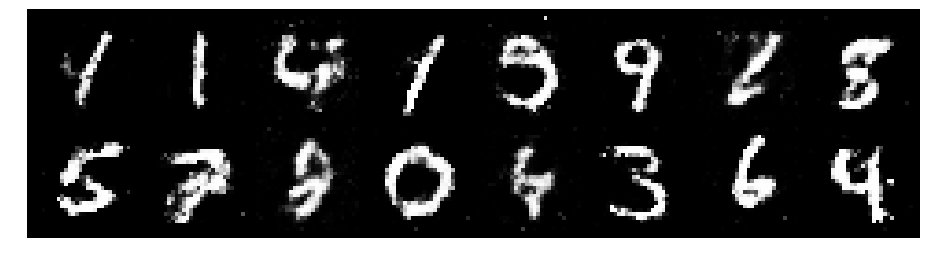

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.3141, Generator Loss: 0.8845
D(x): 0.5892, D(G(z)): 0.4883


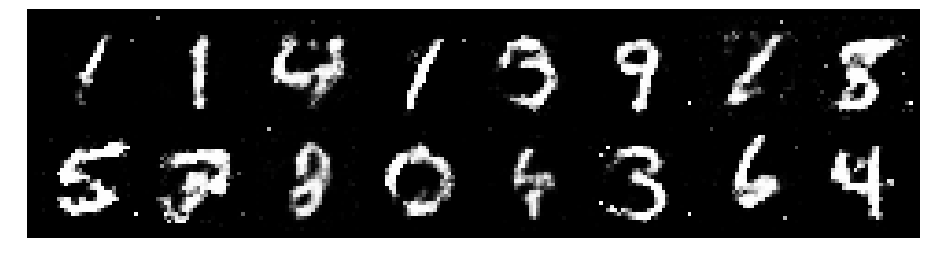

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.4294, Generator Loss: 0.9741
D(x): 0.4829, D(G(z)): 0.4259


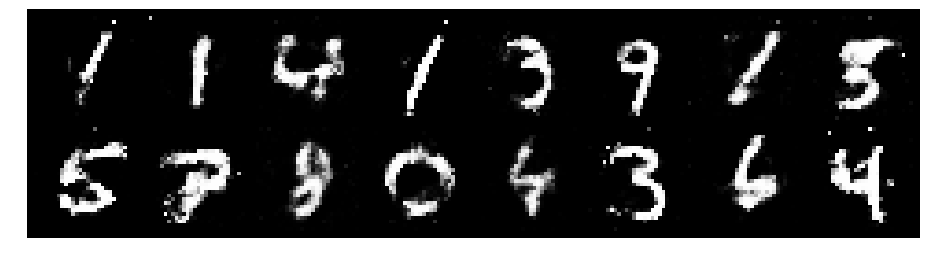

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2500, Generator Loss: 0.8766
D(x): 0.6185, D(G(z)): 0.4631


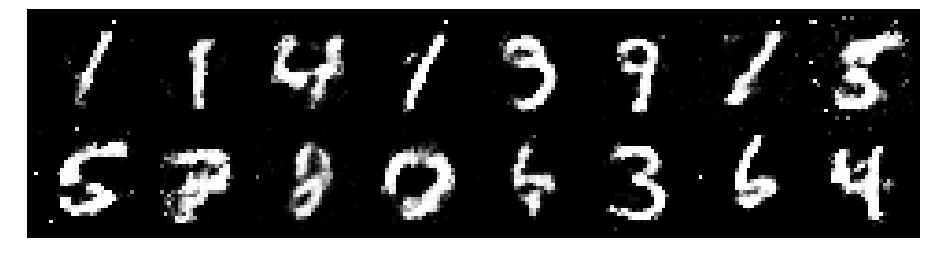

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.1283, Generator Loss: 1.0083
D(x): 0.6119, D(G(z)): 0.4175


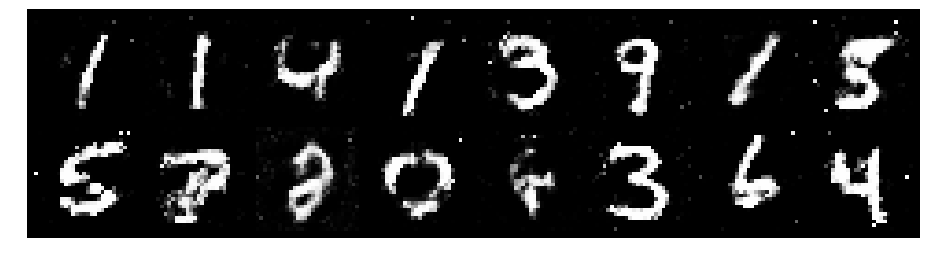

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2831, Generator Loss: 0.8843
D(x): 0.5797, D(G(z)): 0.4567


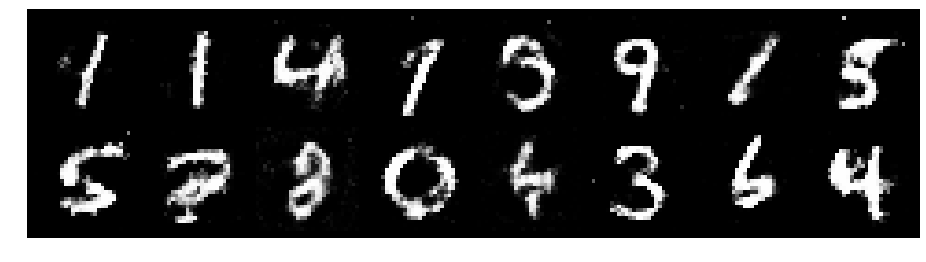

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2021, Generator Loss: 0.9064
D(x): 0.6148, D(G(z)): 0.4625


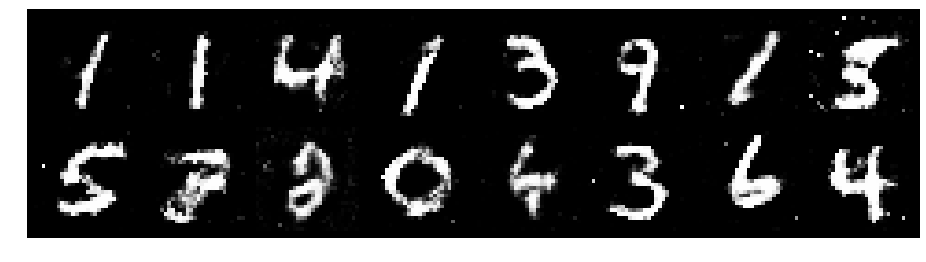

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.2722, Generator Loss: 1.0125
D(x): 0.5838, D(G(z)): 0.4450


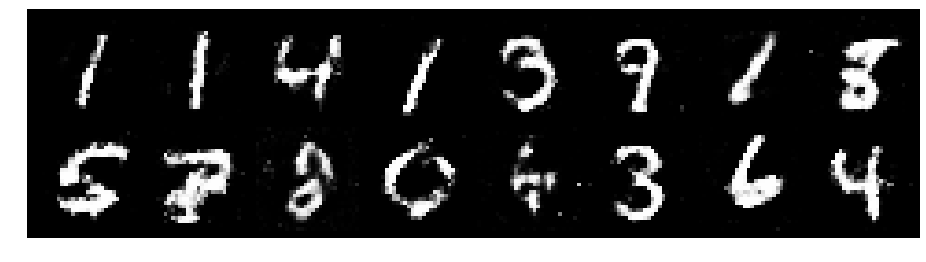

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.2260, Generator Loss: 1.0013
D(x): 0.5899, D(G(z)): 0.4155


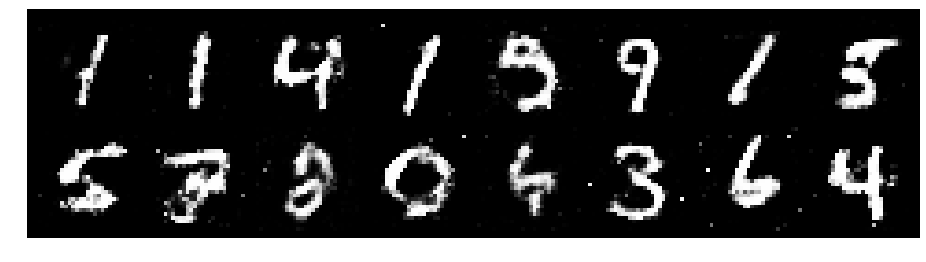

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.1035, Generator Loss: 1.1702
D(x): 0.5625, D(G(z)): 0.3289


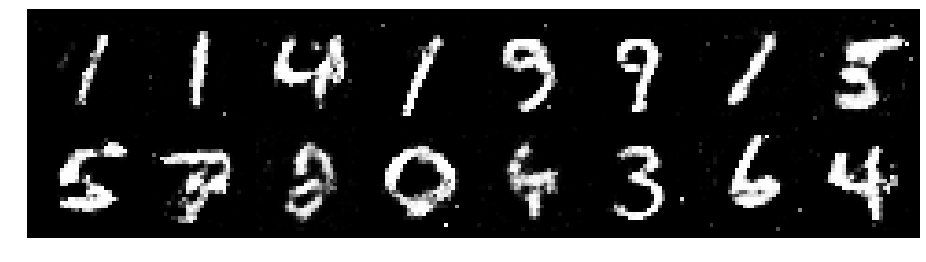

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1616, Generator Loss: 0.9311
D(x): 0.6272, D(G(z)): 0.4223


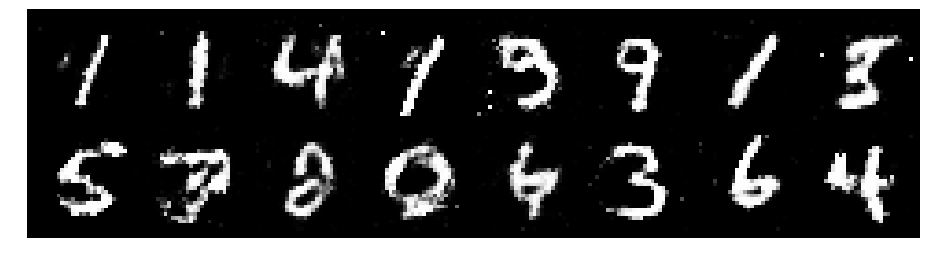

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.0529, Generator Loss: 0.9734
D(x): 0.6246, D(G(z)): 0.3704


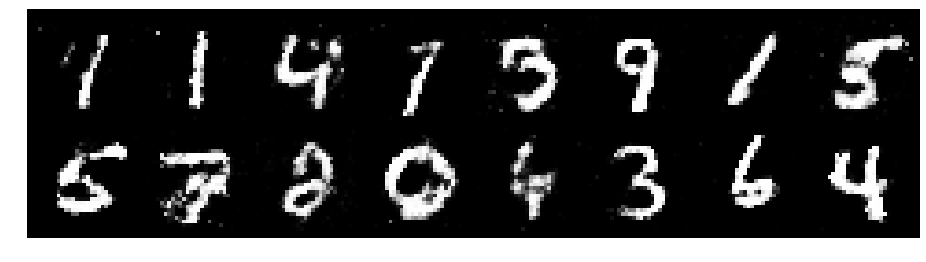

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.1024, Generator Loss: 1.1369
D(x): 0.6166, D(G(z)): 0.3995


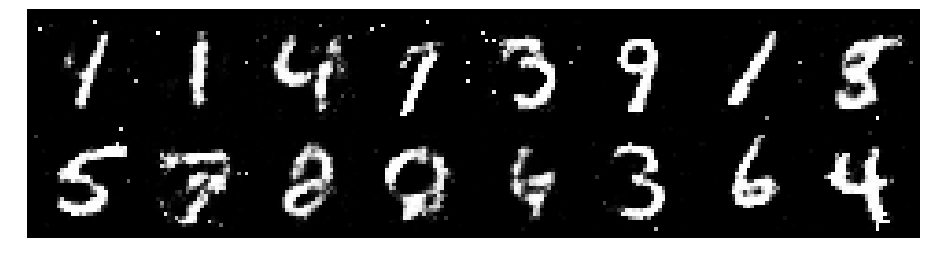

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.2941, Generator Loss: 0.8840
D(x): 0.5408, D(G(z)): 0.4458


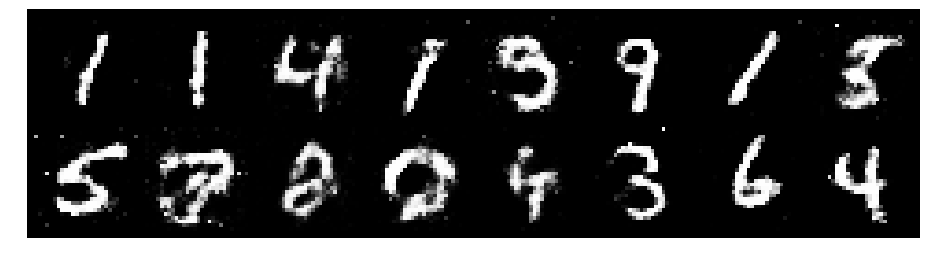

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2816, Generator Loss: 1.0479
D(x): 0.5673, D(G(z)): 0.4367


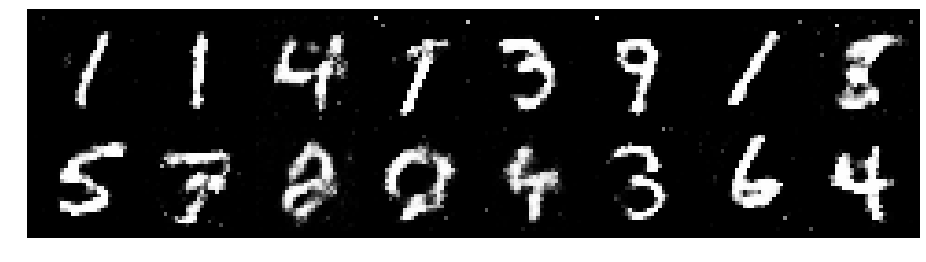

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1985, Generator Loss: 1.0322
D(x): 0.5466, D(G(z)): 0.3569


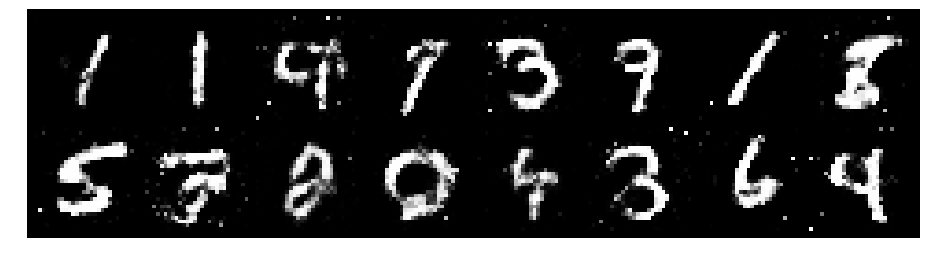

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.2293, Generator Loss: 1.1369
D(x): 0.5541, D(G(z)): 0.3871


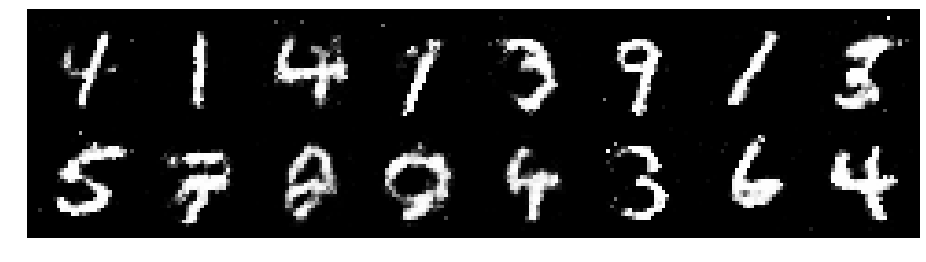

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.1460, Generator Loss: 0.9485
D(x): 0.6393, D(G(z)): 0.4322


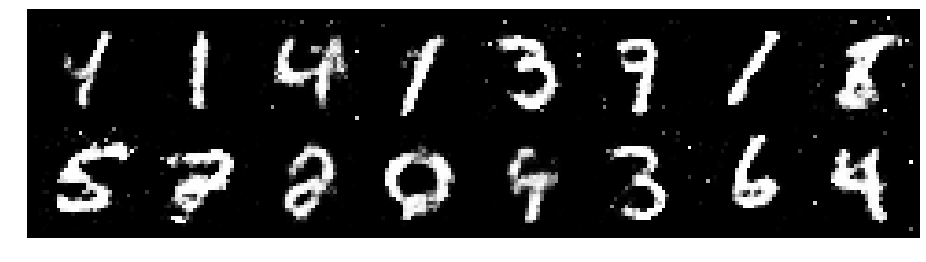

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.1073, Generator Loss: 1.1178
D(x): 0.5417, D(G(z)): 0.3310


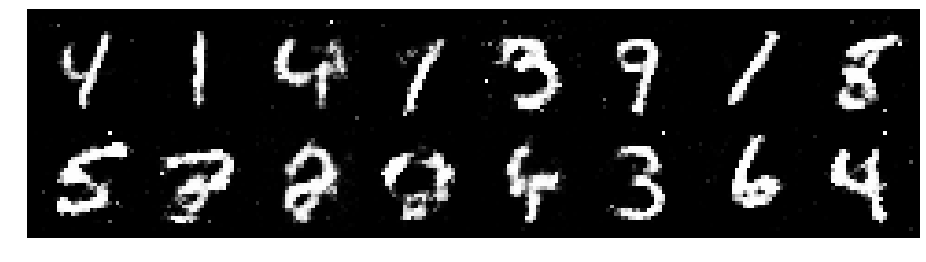

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.1157, Generator Loss: 1.1194
D(x): 0.6089, D(G(z)): 0.3905


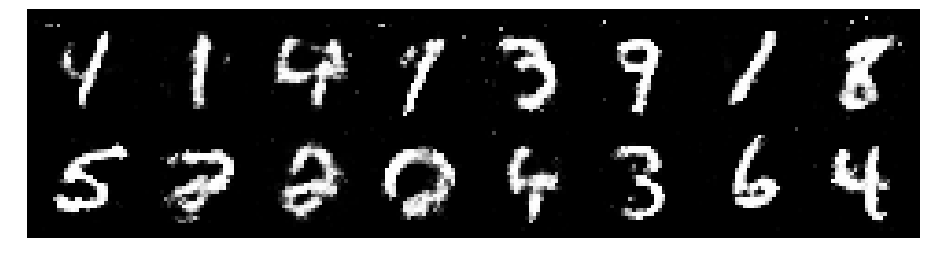

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.3073, Generator Loss: 0.9324
D(x): 0.5728, D(G(z)): 0.4576


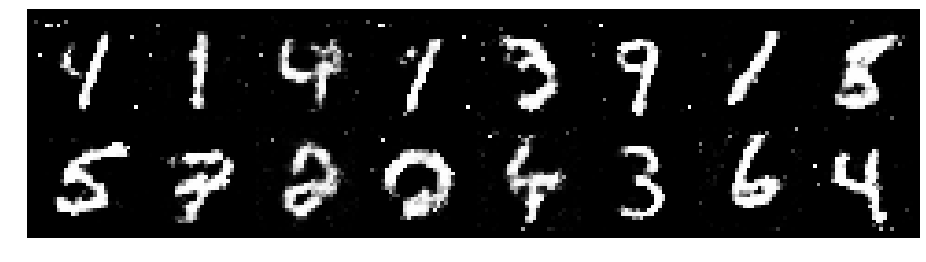

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.1402, Generator Loss: 0.8345
D(x): 0.6091, D(G(z)): 0.4241


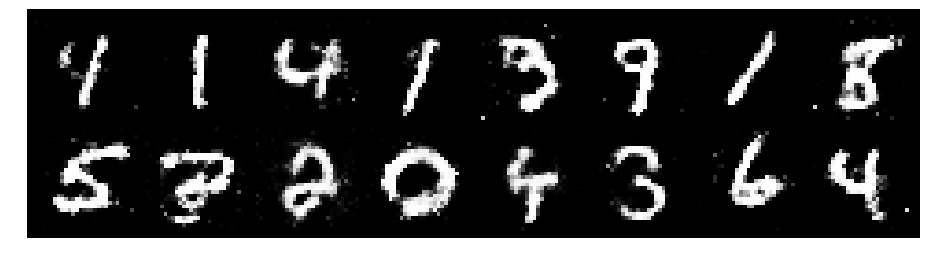

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.2600, Generator Loss: 0.9705
D(x): 0.5860, D(G(z)): 0.4438


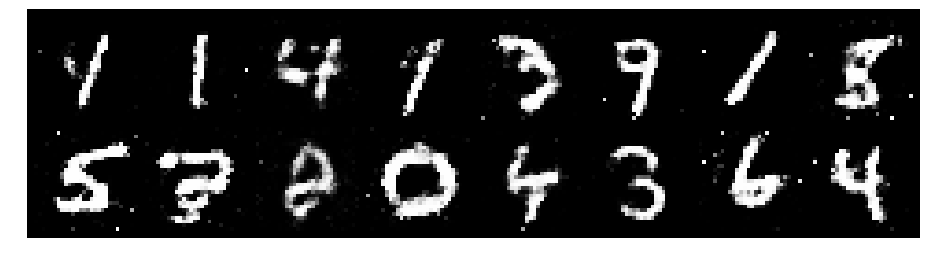

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.2805, Generator Loss: 0.9804
D(x): 0.5633, D(G(z)): 0.4273


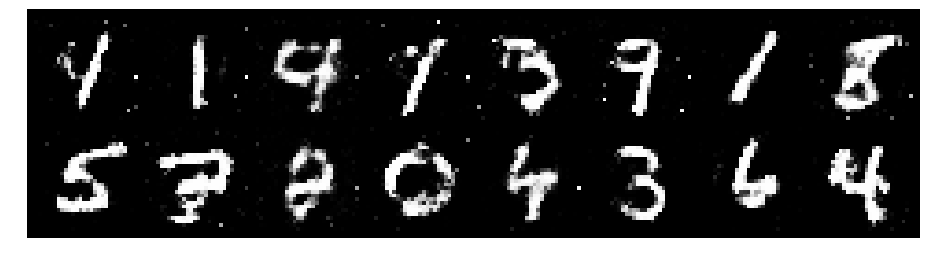

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2461, Generator Loss: 0.9714
D(x): 0.5796, D(G(z)): 0.4320


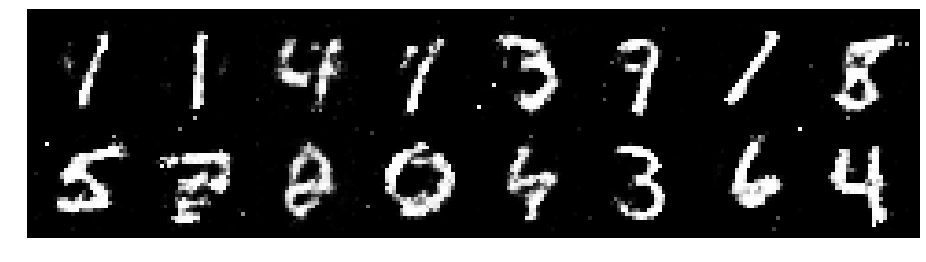

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.2026, Generator Loss: 0.9026
D(x): 0.5817, D(G(z)): 0.4121


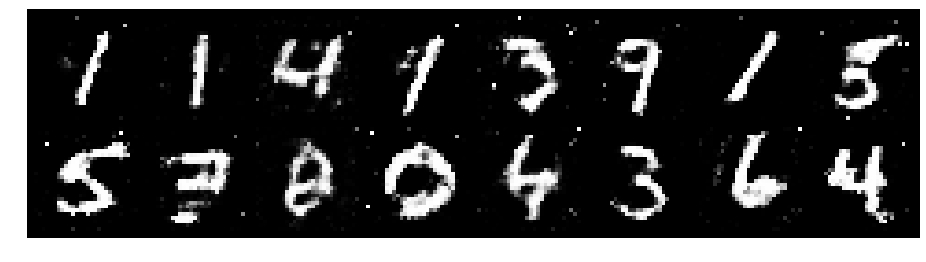

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.4442, Generator Loss: 0.9811
D(x): 0.4956, D(G(z)): 0.4151


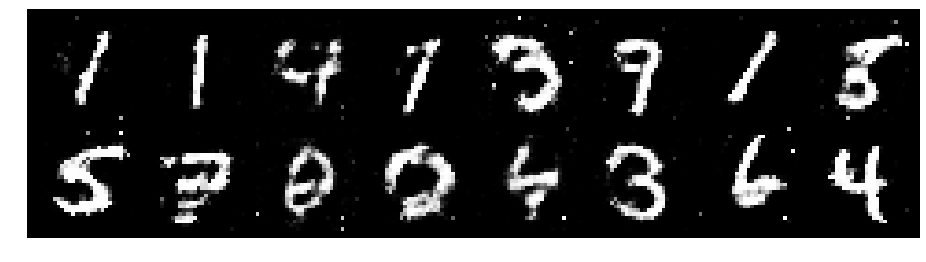

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2419, Generator Loss: 0.8818
D(x): 0.5614, D(G(z)): 0.3991


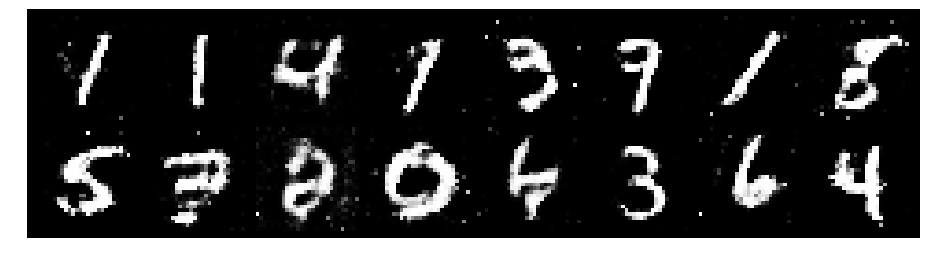

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.0650, Generator Loss: 1.0200
D(x): 0.6428, D(G(z)): 0.4061


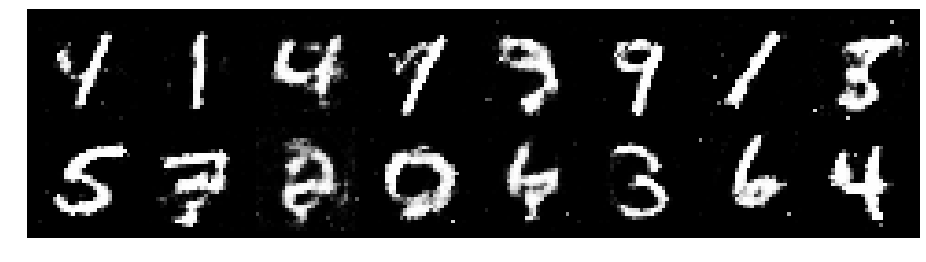

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.1412, Generator Loss: 1.0164
D(x): 0.6057, D(G(z)): 0.3996


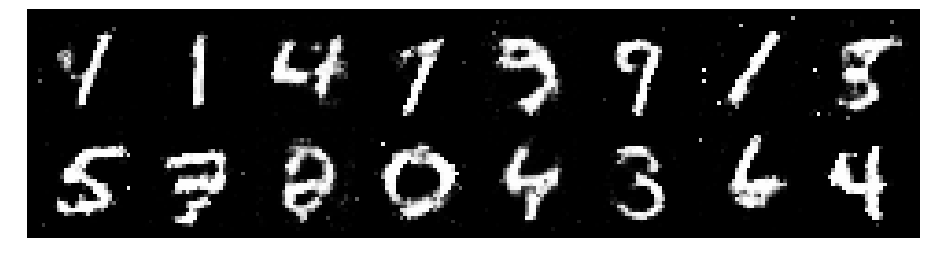

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.2535, Generator Loss: 1.0571
D(x): 0.5731, D(G(z)): 0.4098


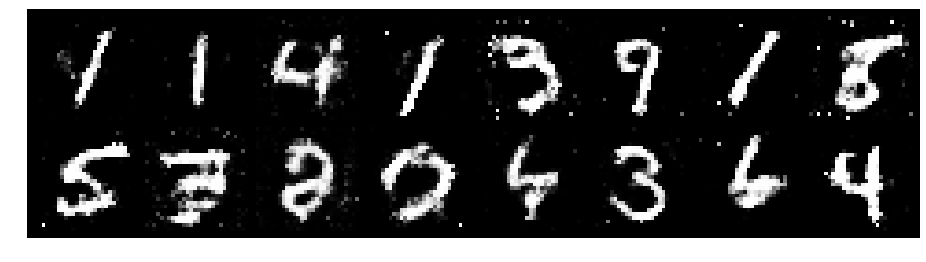

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.3299, Generator Loss: 0.9199
D(x): 0.5241, D(G(z)): 0.4324


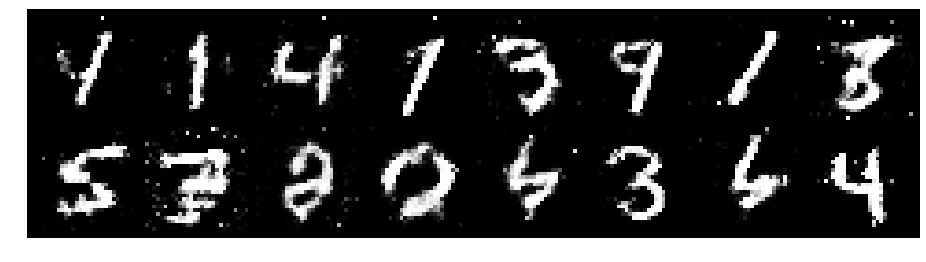

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2080, Generator Loss: 1.0015
D(x): 0.5725, D(G(z)): 0.4240


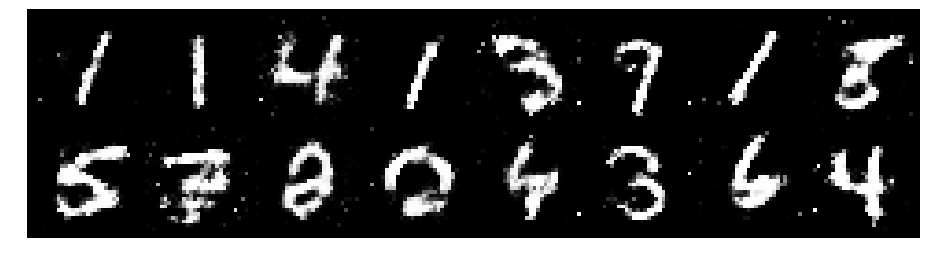

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2537, Generator Loss: 0.9425
D(x): 0.5542, D(G(z)): 0.4344


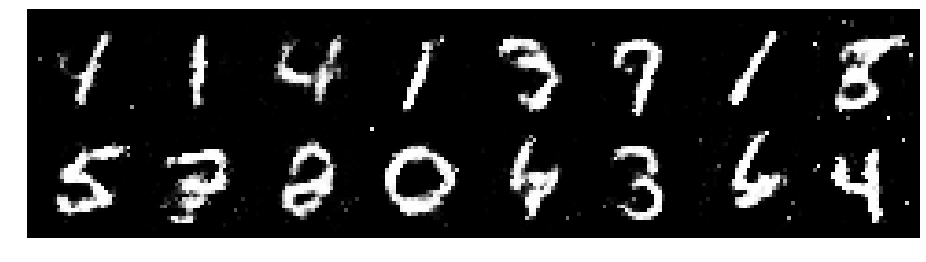

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2352, Generator Loss: 0.9354
D(x): 0.5794, D(G(z)): 0.4371


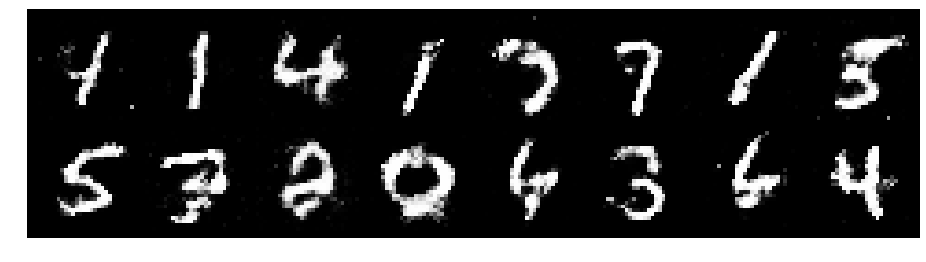

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.3125, Generator Loss: 0.8861
D(x): 0.5569, D(G(z)): 0.4625


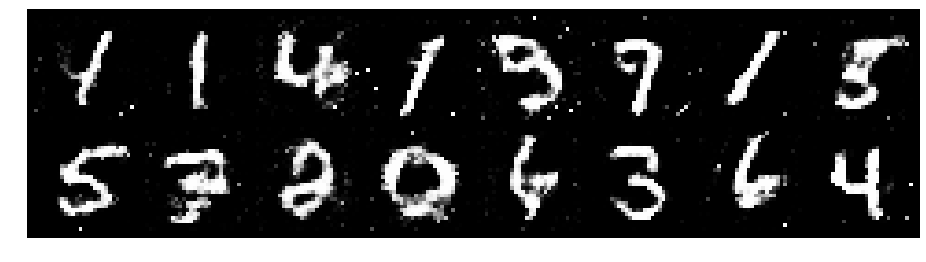

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.1090, Generator Loss: 1.0267
D(x): 0.5975, D(G(z)): 0.3881


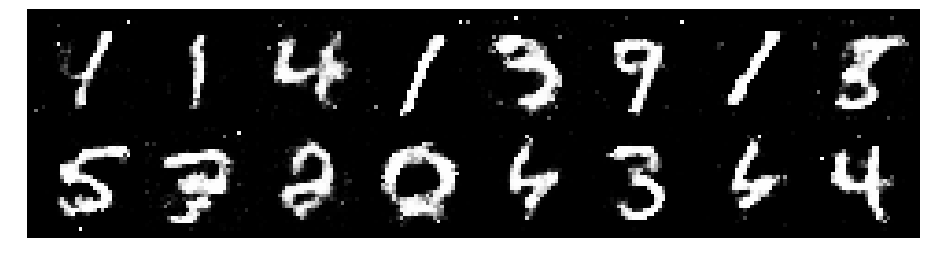

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2224, Generator Loss: 1.0791
D(x): 0.6469, D(G(z)): 0.4666


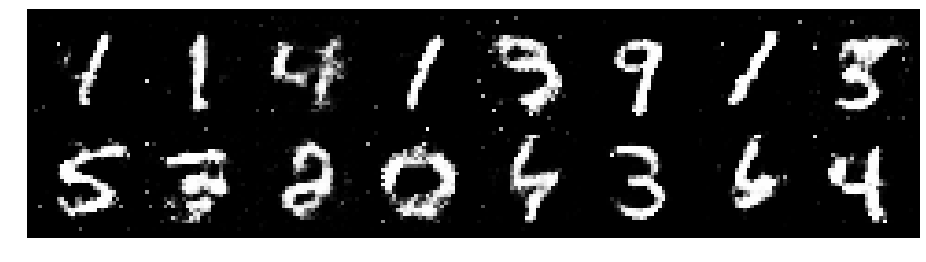

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.2229, Generator Loss: 0.9655
D(x): 0.6350, D(G(z)): 0.4608


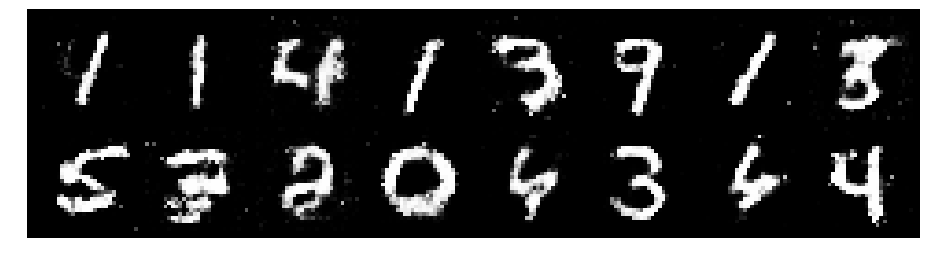

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2314, Generator Loss: 1.0593
D(x): 0.5689, D(G(z)): 0.4108


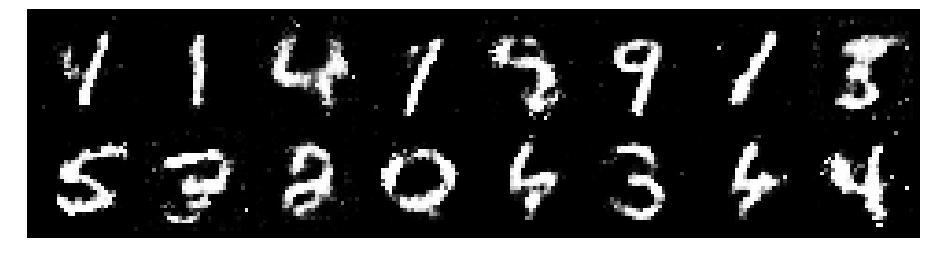

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.1397, Generator Loss: 1.0308
D(x): 0.5983, D(G(z)): 0.4093


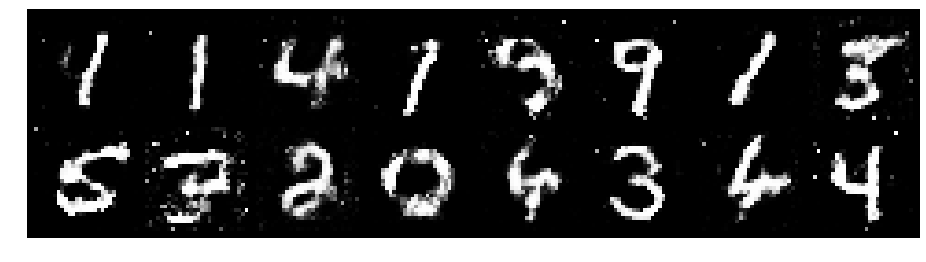

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.1641, Generator Loss: 0.8021
D(x): 0.6059, D(G(z)): 0.4449


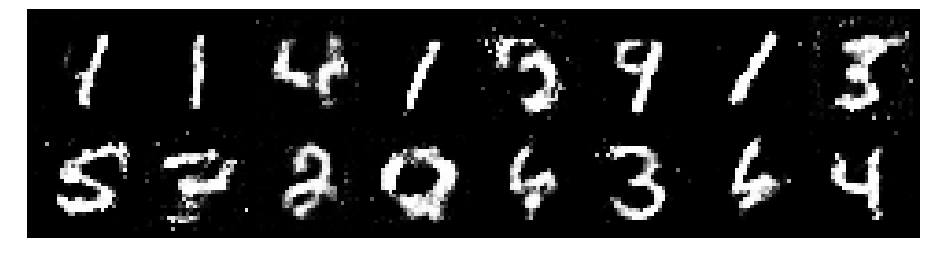

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.1978, Generator Loss: 1.1686
D(x): 0.5766, D(G(z)): 0.3944


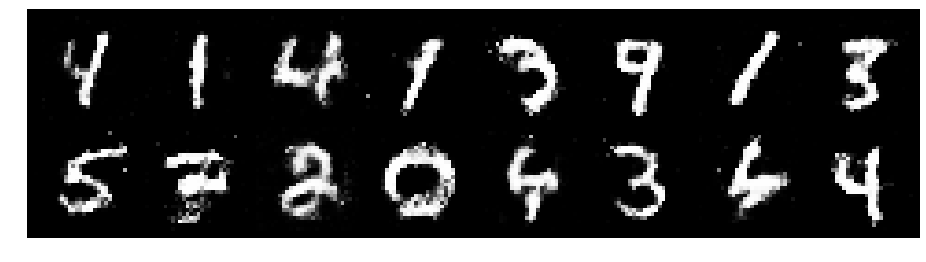

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2458, Generator Loss: 1.0958
D(x): 0.5604, D(G(z)): 0.4280


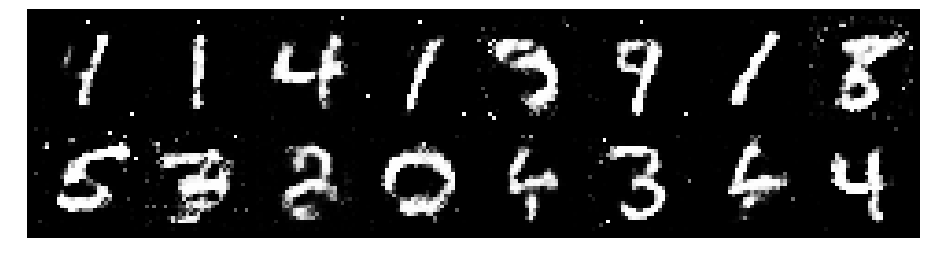

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.3738, Generator Loss: 0.9689
D(x): 0.5341, D(G(z)): 0.4419


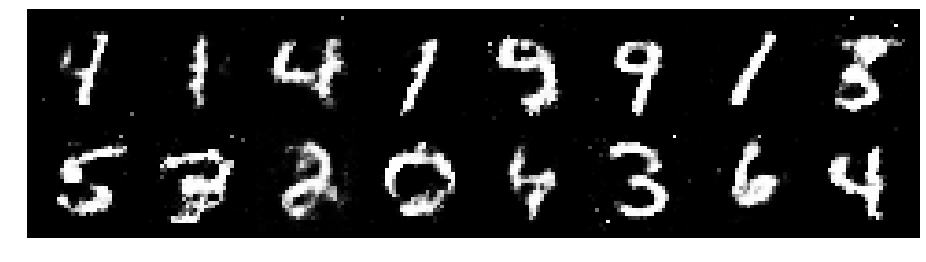

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2188, Generator Loss: 0.9417
D(x): 0.5996, D(G(z)): 0.4269


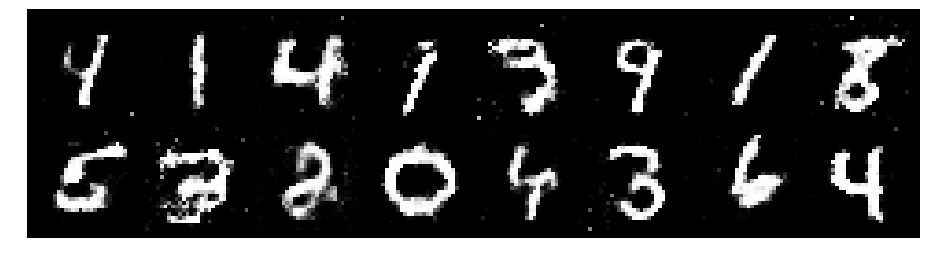

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2284, Generator Loss: 1.0317
D(x): 0.5659, D(G(z)): 0.3907


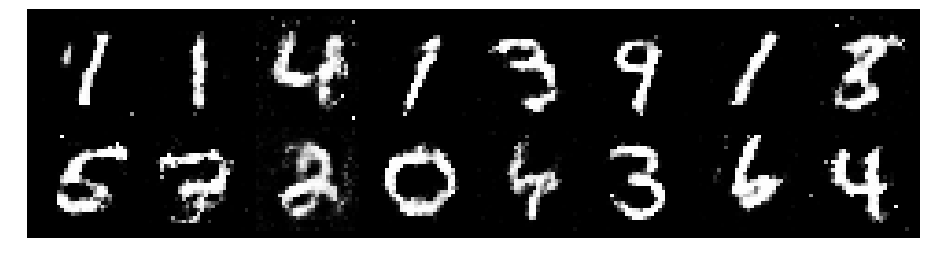

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.1435, Generator Loss: 1.1351
D(x): 0.5954, D(G(z)): 0.3754


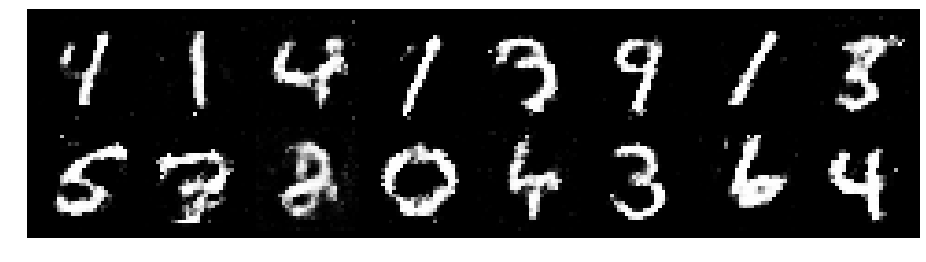

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2553, Generator Loss: 1.1023
D(x): 0.5472, D(G(z)): 0.3682


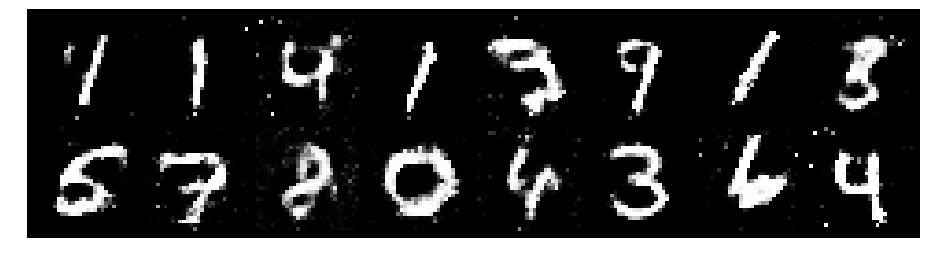

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.1076, Generator Loss: 1.0526
D(x): 0.6184, D(G(z)): 0.4106


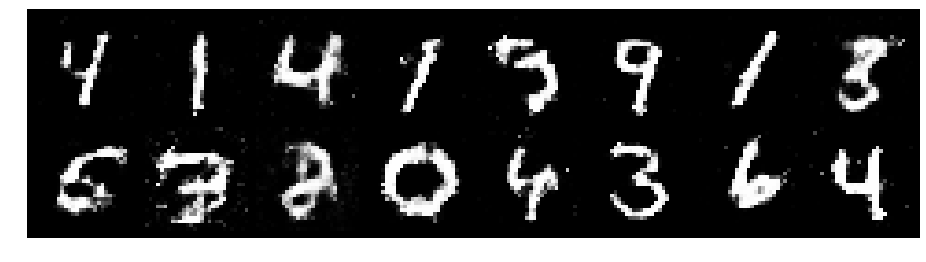

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2763, Generator Loss: 0.9773
D(x): 0.6006, D(G(z)): 0.4554


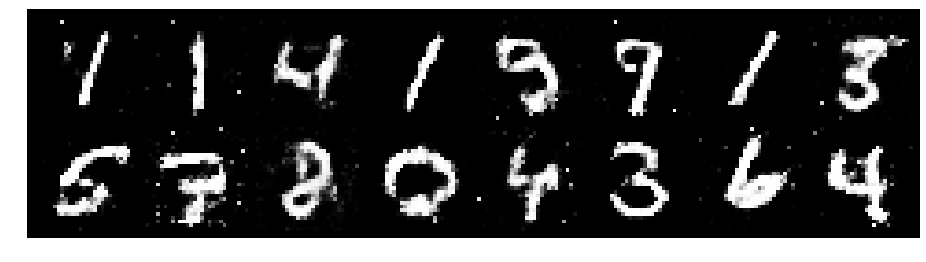

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2218, Generator Loss: 0.9303
D(x): 0.5634, D(G(z)): 0.4184


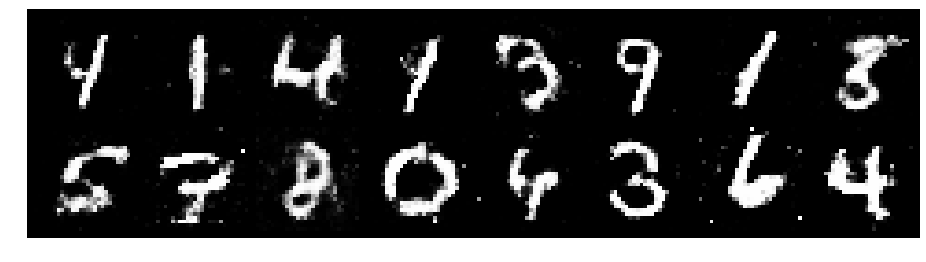

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.2379, Generator Loss: 1.1072
D(x): 0.5406, D(G(z)): 0.3892


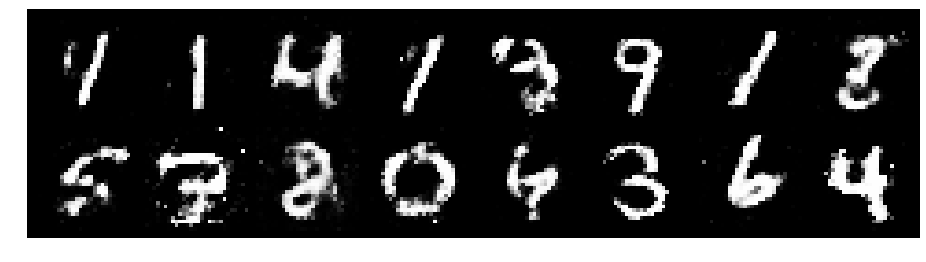

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2660, Generator Loss: 0.7850
D(x): 0.5644, D(G(z)): 0.4479


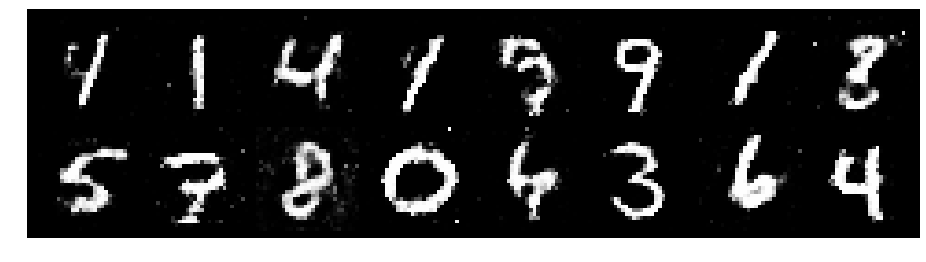

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.1137, Generator Loss: 1.0761
D(x): 0.5634, D(G(z)): 0.3493


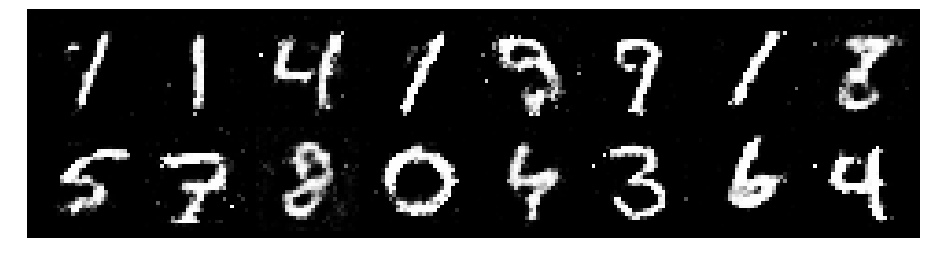

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2105, Generator Loss: 0.9663
D(x): 0.6268, D(G(z)): 0.4600


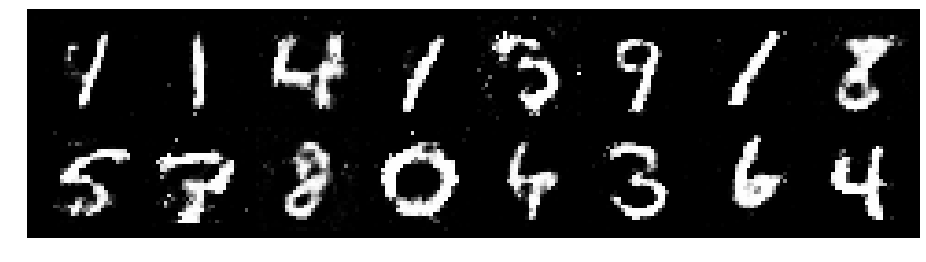

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.1634, Generator Loss: 1.0818
D(x): 0.6129, D(G(z)): 0.4245


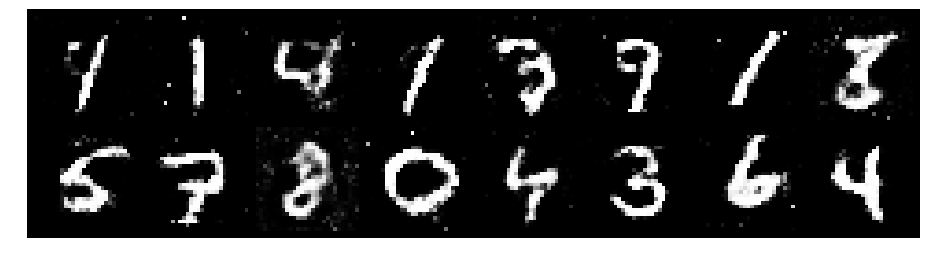

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.1801, Generator Loss: 0.9380
D(x): 0.5830, D(G(z)): 0.4227


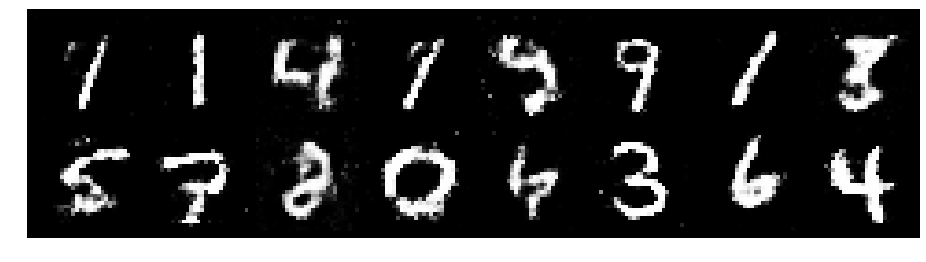

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2092, Generator Loss: 0.8947
D(x): 0.5907, D(G(z)): 0.4457


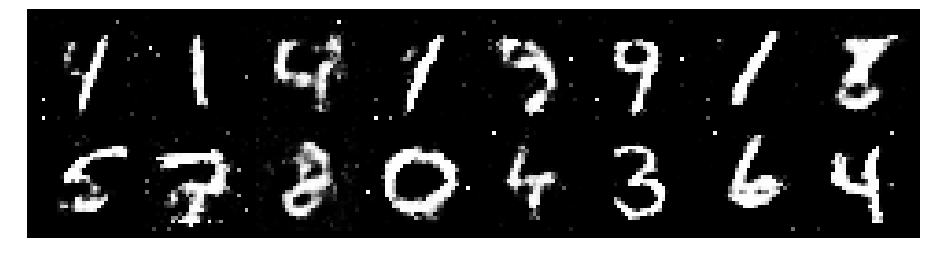

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8614
D(x): 0.5804, D(G(z)): 0.4684


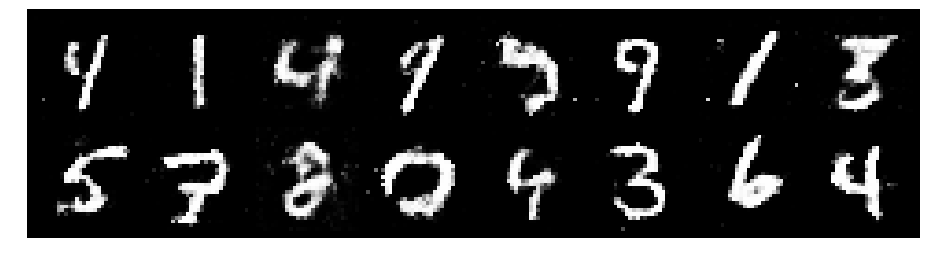

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.0596, Generator Loss: 1.0593
D(x): 0.5760, D(G(z)): 0.3333


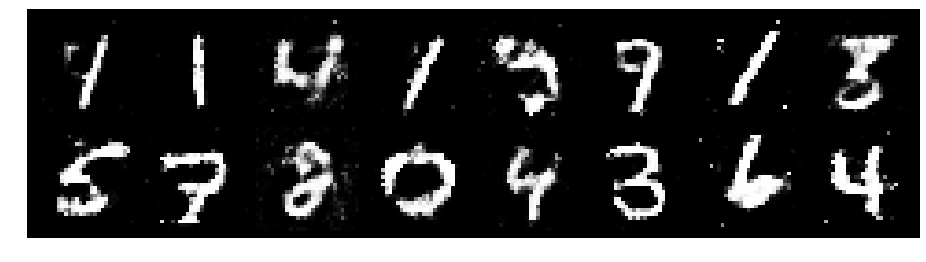

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2774, Generator Loss: 1.1056
D(x): 0.5906, D(G(z)): 0.4268


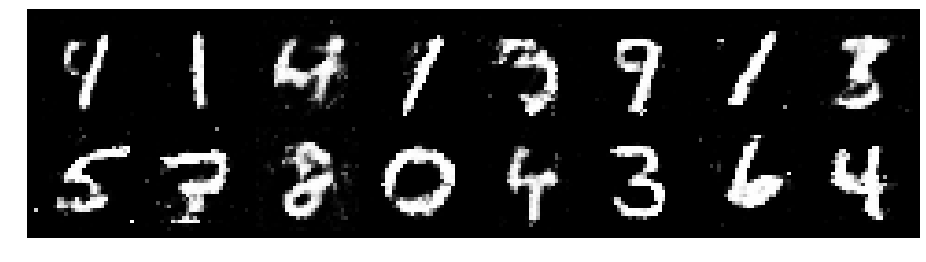

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.1108, Generator Loss: 1.2082
D(x): 0.6092, D(G(z)): 0.3826


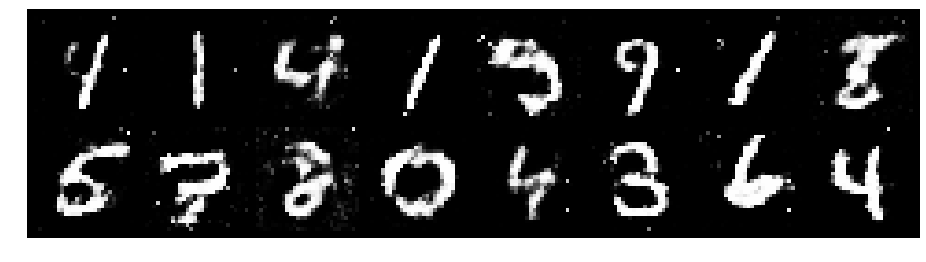

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.1858, Generator Loss: 1.1855
D(x): 0.5909, D(G(z)): 0.4047


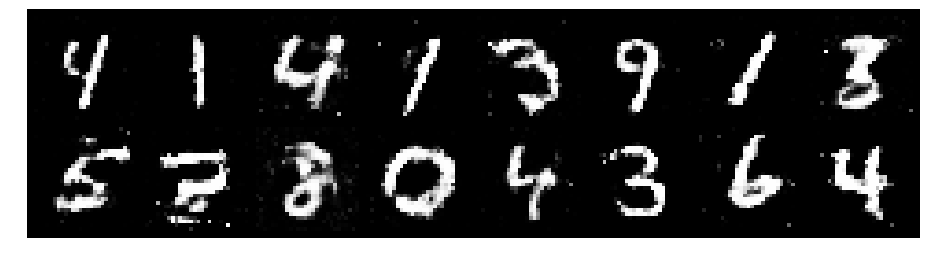

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2520, Generator Loss: 0.9954
D(x): 0.5407, D(G(z)): 0.4110


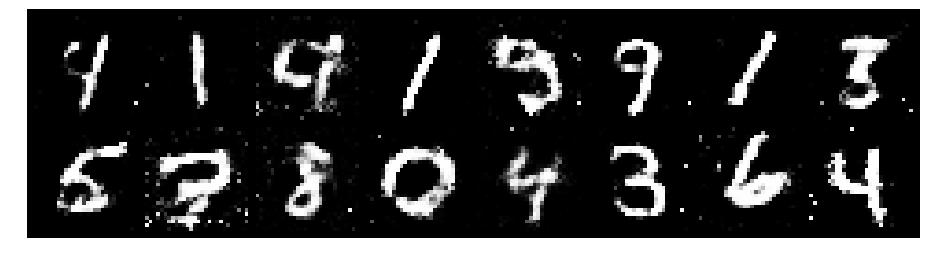

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.3456, Generator Loss: 1.1082
D(x): 0.5119, D(G(z)): 0.4095


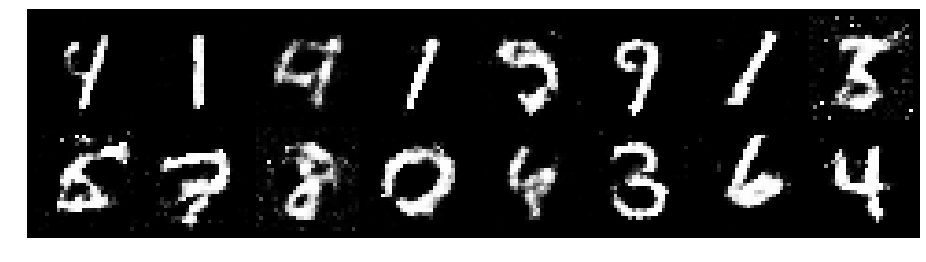

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.1502, Generator Loss: 0.9539
D(x): 0.6251, D(G(z)): 0.4238


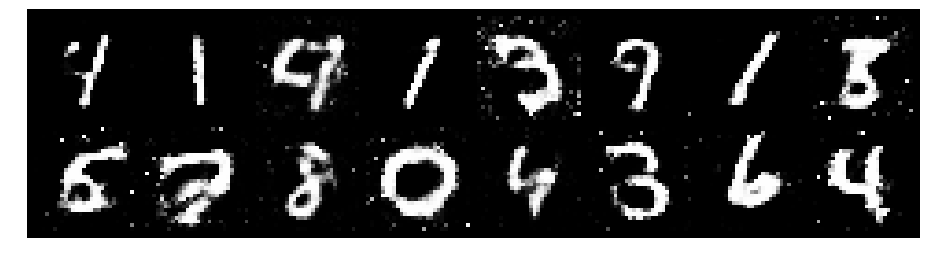

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.3689, Generator Loss: 0.8299
D(x): 0.6056, D(G(z)): 0.5031


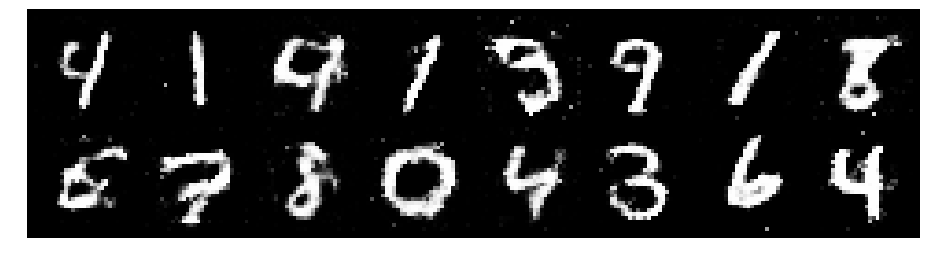

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.3012, Generator Loss: 0.8827
D(x): 0.6032, D(G(z)): 0.4637


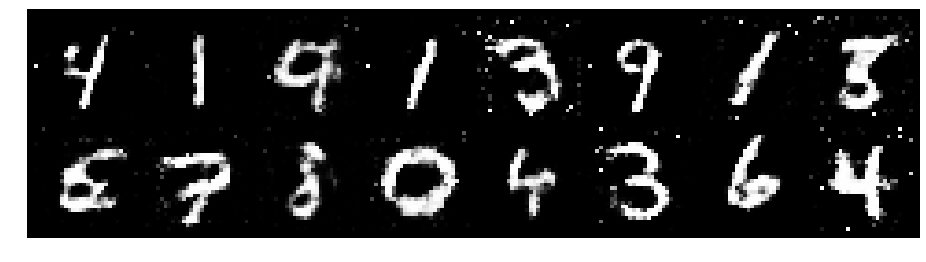

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2832, Generator Loss: 0.9549
D(x): 0.5724, D(G(z)): 0.4311


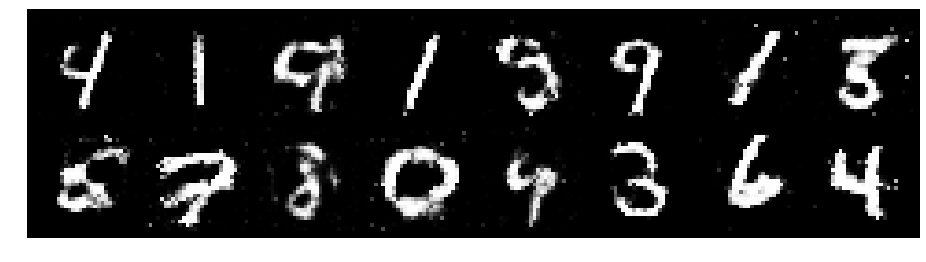

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.3560, Generator Loss: 0.9423
D(x): 0.5528, D(G(z)): 0.4671


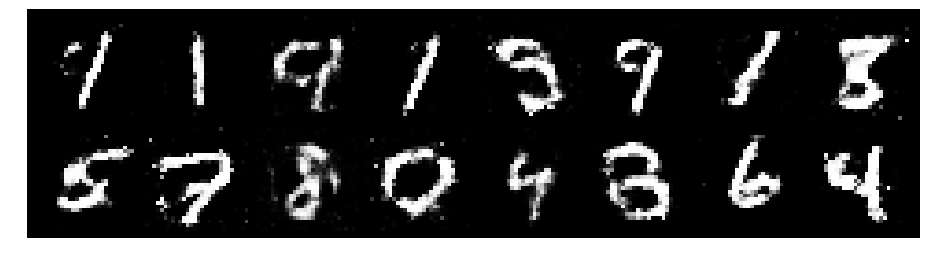

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.3502, Generator Loss: 0.9234
D(x): 0.5572, D(G(z)): 0.4736


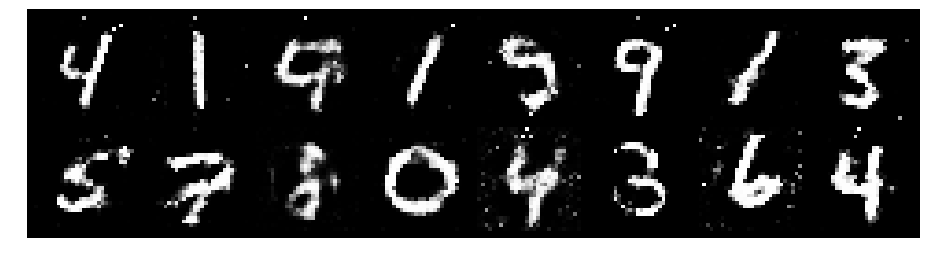

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.1319, Generator Loss: 0.9270
D(x): 0.6007, D(G(z)): 0.4146


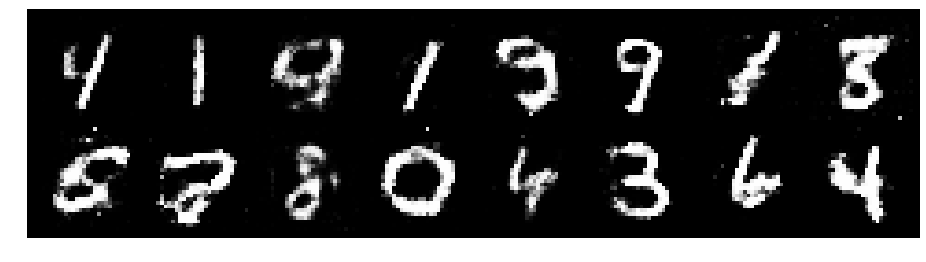

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.3063, Generator Loss: 1.0708
D(x): 0.5997, D(G(z)): 0.4653


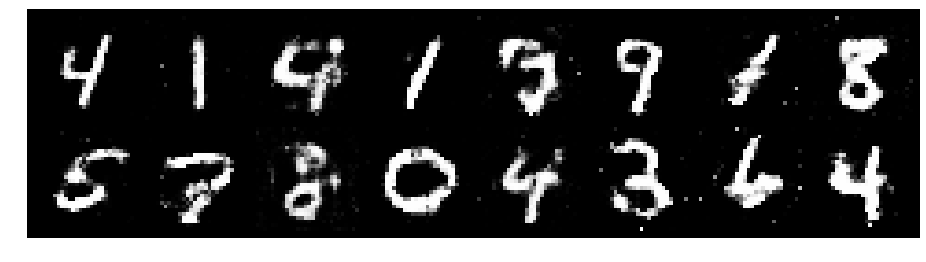

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2423, Generator Loss: 1.1490
D(x): 0.5364, D(G(z)): 0.3861


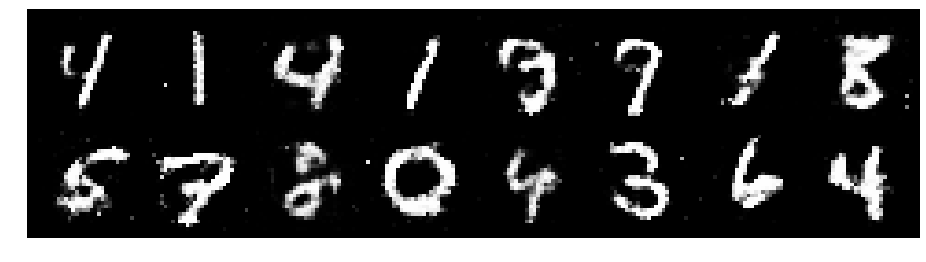

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2439, Generator Loss: 0.8730
D(x): 0.6278, D(G(z)): 0.4615


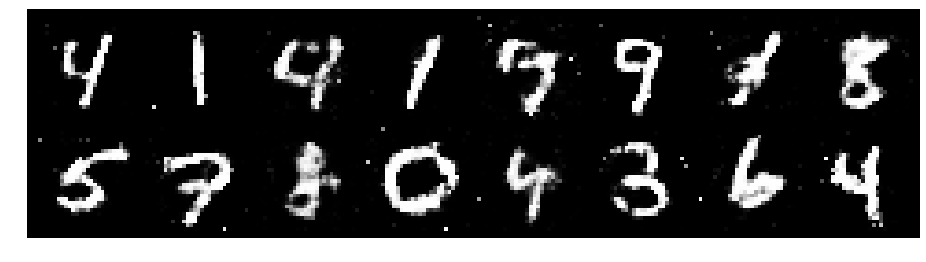

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2011, Generator Loss: 1.1585
D(x): 0.5746, D(G(z)): 0.3867


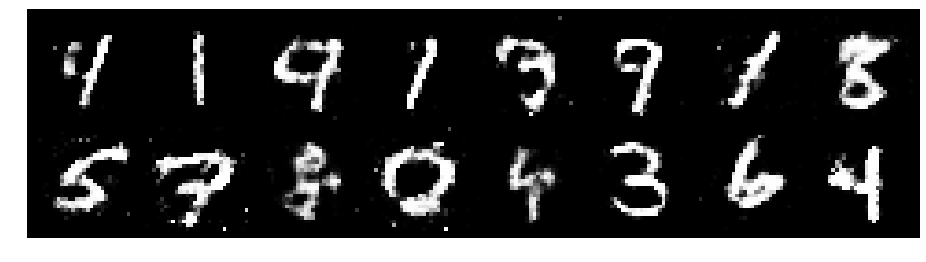

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2213, Generator Loss: 0.9444
D(x): 0.5868, D(G(z)): 0.4228


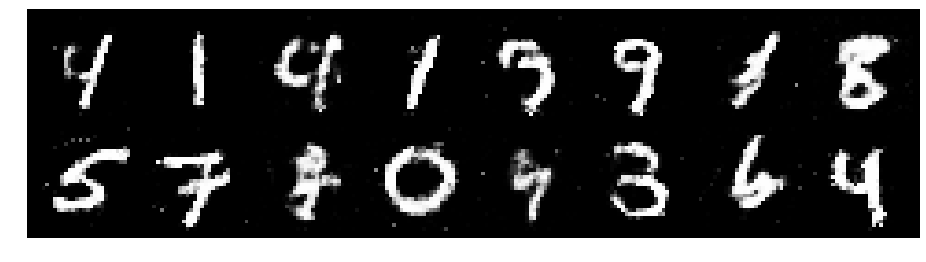

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.3329, Generator Loss: 0.7400
D(x): 0.5908, D(G(z)): 0.4964


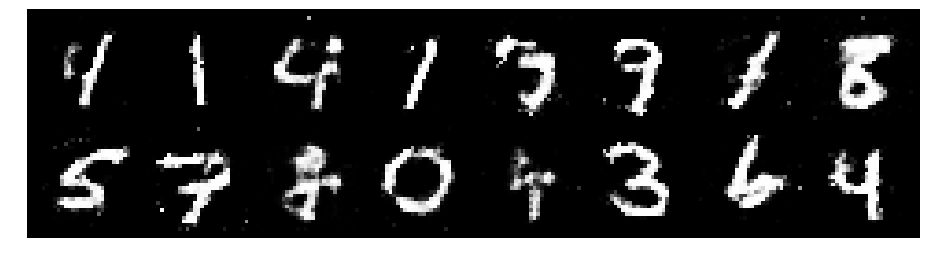

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2150, Generator Loss: 1.0426
D(x): 0.5862, D(G(z)): 0.4449


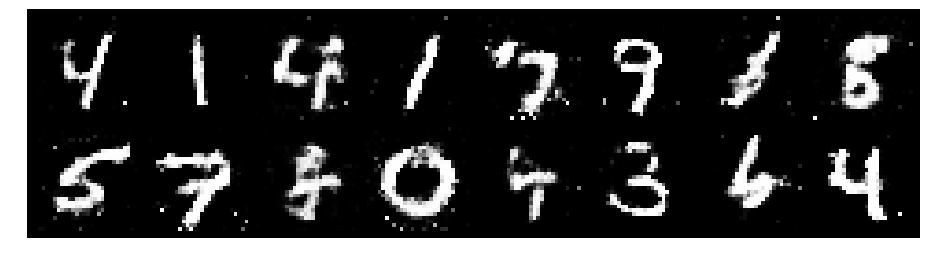

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.2547, Generator Loss: 0.9316
D(x): 0.5261, D(G(z)): 0.3977


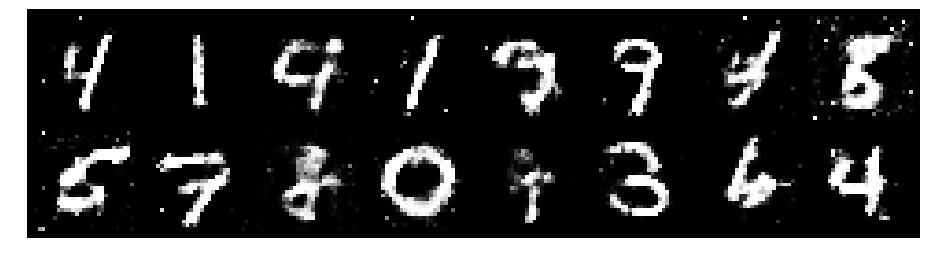

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.2897, Generator Loss: 0.8011
D(x): 0.5368, D(G(z)): 0.4351


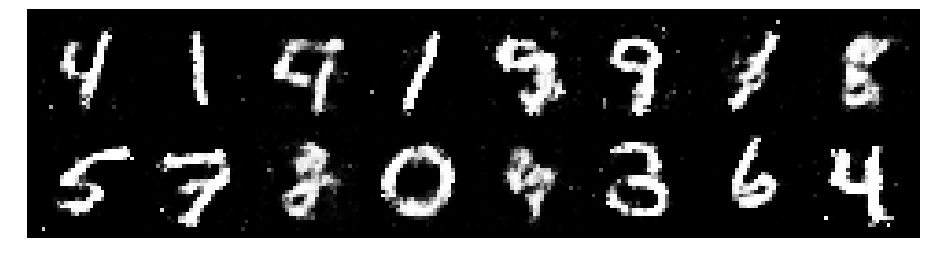

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.1144, Generator Loss: 0.9021
D(x): 0.5857, D(G(z)): 0.3981


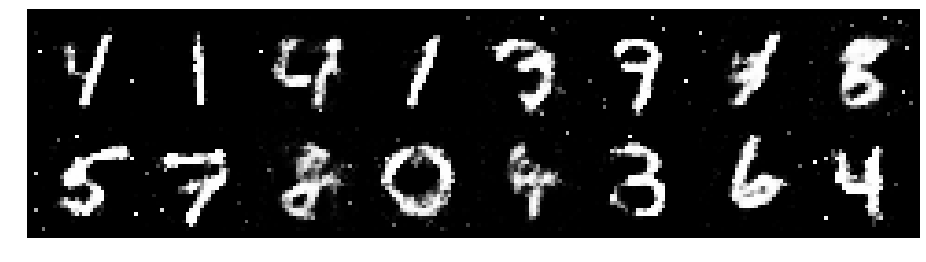

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2532, Generator Loss: 0.8561
D(x): 0.5722, D(G(z)): 0.4422


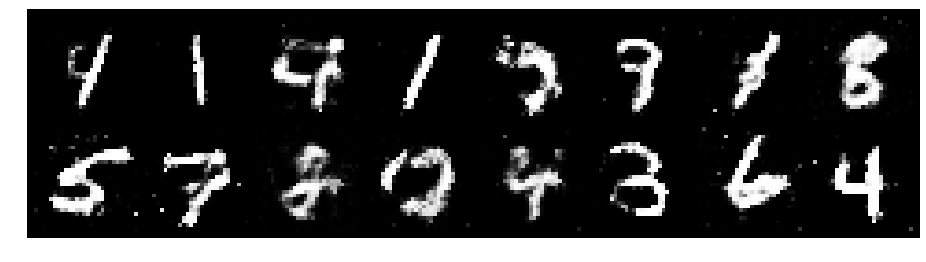

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.3191, Generator Loss: 1.0449
D(x): 0.5274, D(G(z)): 0.4234


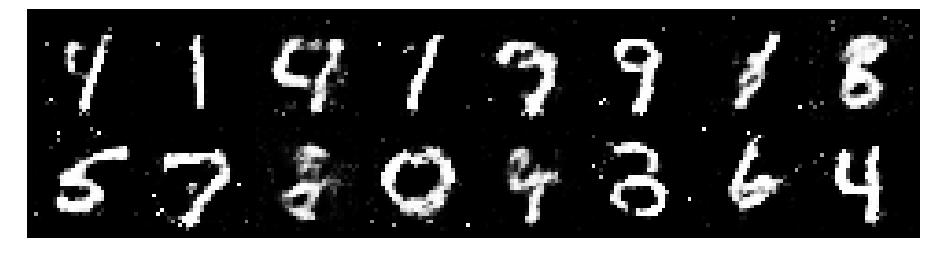

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2312, Generator Loss: 0.9978
D(x): 0.5608, D(G(z)): 0.4198


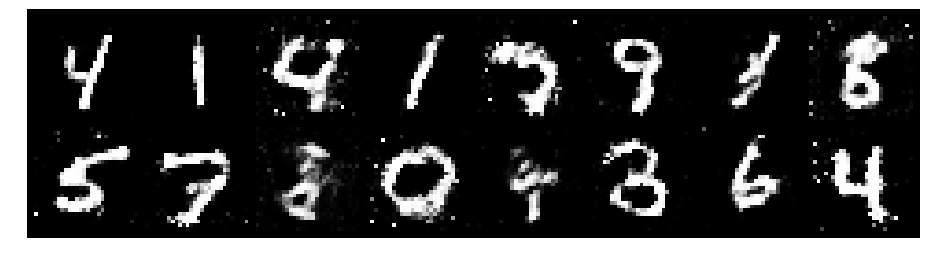

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.3284, Generator Loss: 0.8108
D(x): 0.5588, D(G(z)): 0.4696


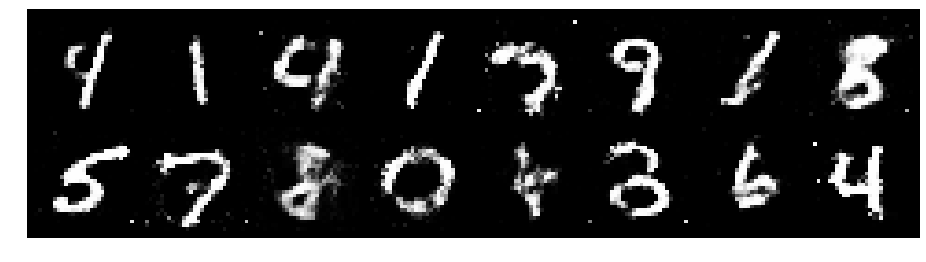

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.1906, Generator Loss: 0.8838
D(x): 0.5541, D(G(z)): 0.4143


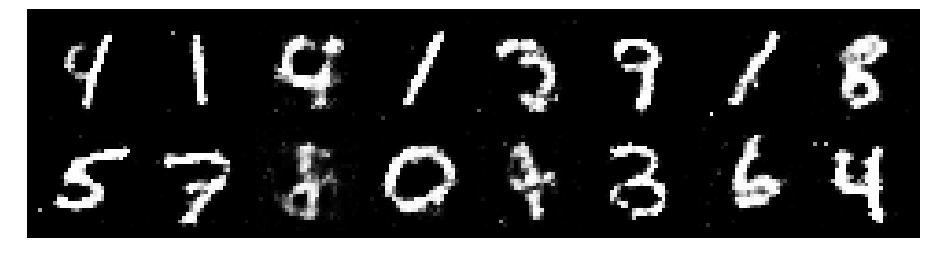

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2500, Generator Loss: 0.8991
D(x): 0.5445, D(G(z)): 0.4322


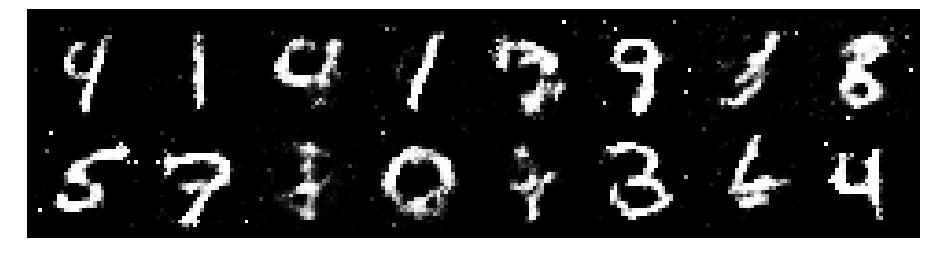

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.2813, Generator Loss: 0.9165
D(x): 0.4954, D(G(z)): 0.3976


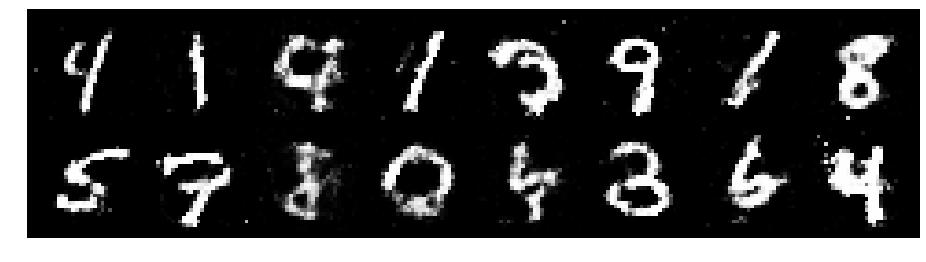

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2768, Generator Loss: 0.7492
D(x): 0.5434, D(G(z)): 0.4381


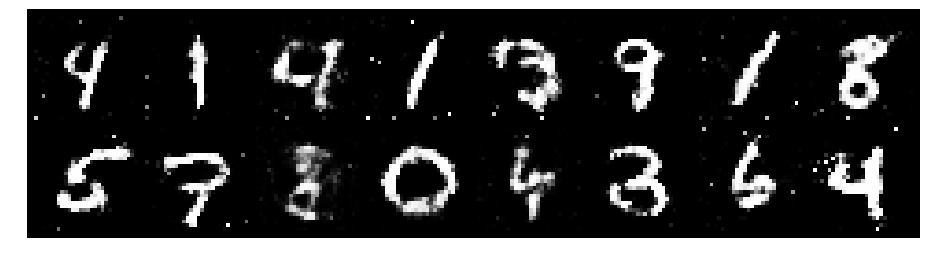

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.2134, Generator Loss: 0.9782
D(x): 0.5541, D(G(z)): 0.4021


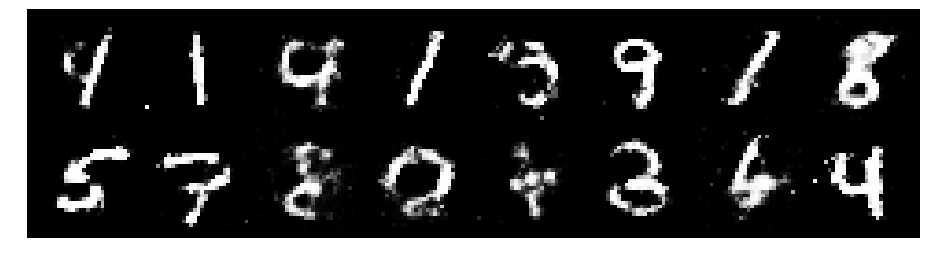

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2739, Generator Loss: 1.0123
D(x): 0.5923, D(G(z)): 0.4481


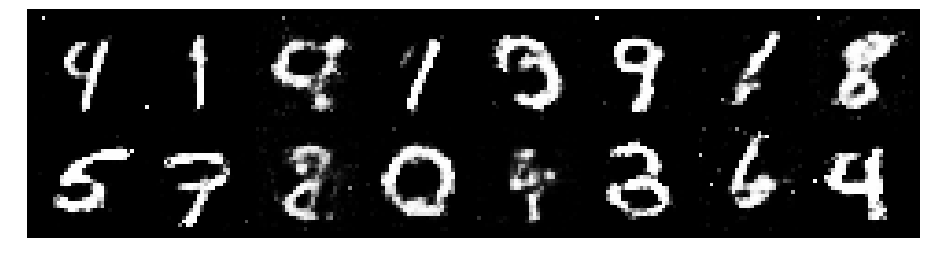

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.1903, Generator Loss: 1.1341
D(x): 0.5553, D(G(z)): 0.3647


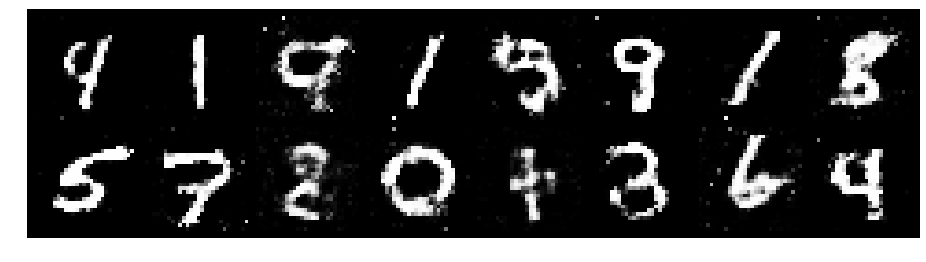

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.4023, Generator Loss: 0.9472
D(x): 0.5830, D(G(z)): 0.5016


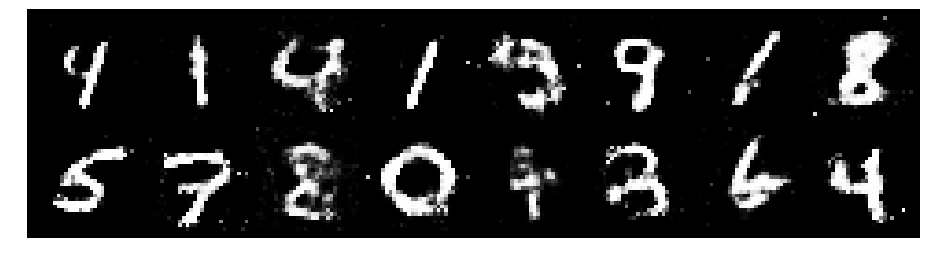

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.1671, Generator Loss: 1.0735
D(x): 0.5974, D(G(z)): 0.4068


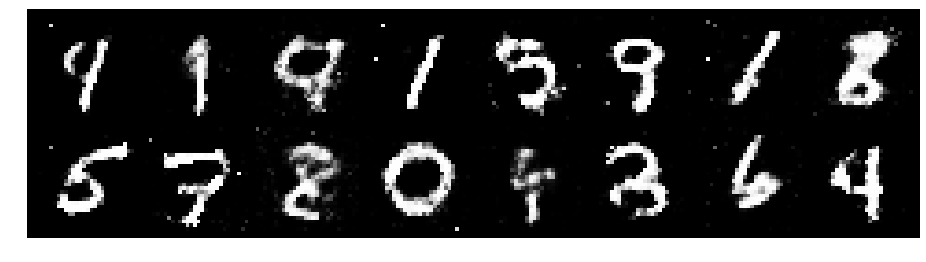

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2367, Generator Loss: 1.0618
D(x): 0.5390, D(G(z)): 0.3952


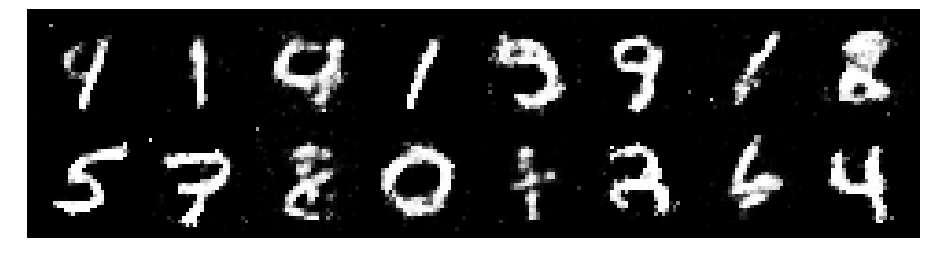

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.1591, Generator Loss: 0.9392
D(x): 0.5666, D(G(z)): 0.3799


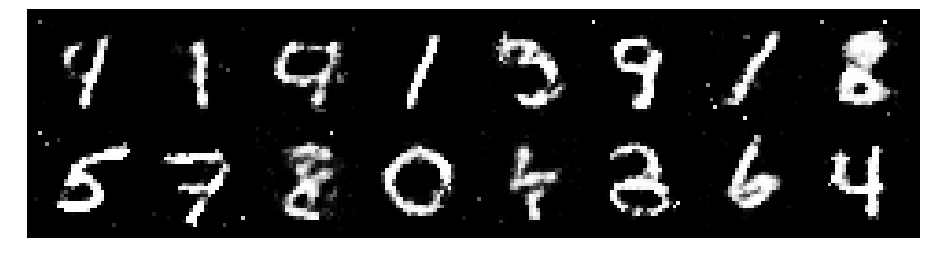

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.3168, Generator Loss: 1.0821
D(x): 0.5540, D(G(z)): 0.4151


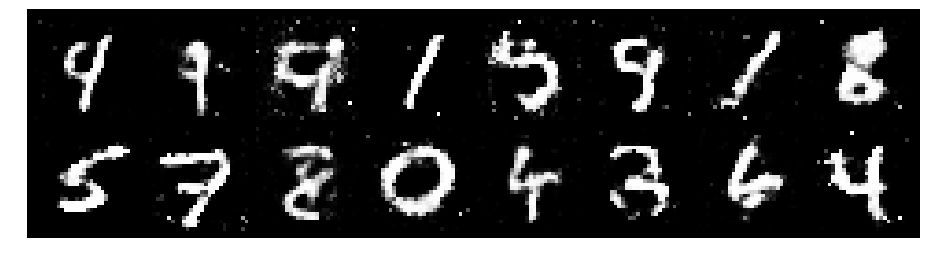

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2702, Generator Loss: 0.9594
D(x): 0.5778, D(G(z)): 0.4405


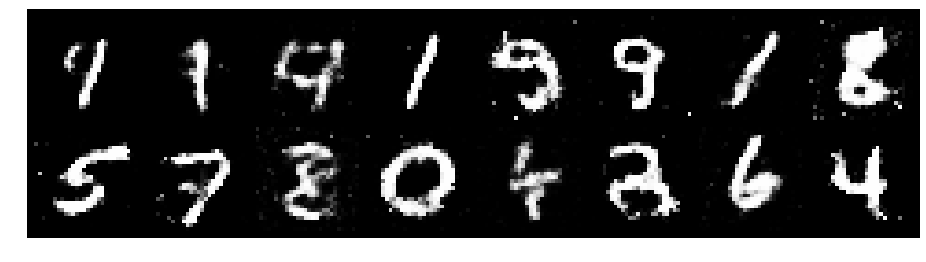

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.1920, Generator Loss: 0.8204
D(x): 0.6469, D(G(z)): 0.4608


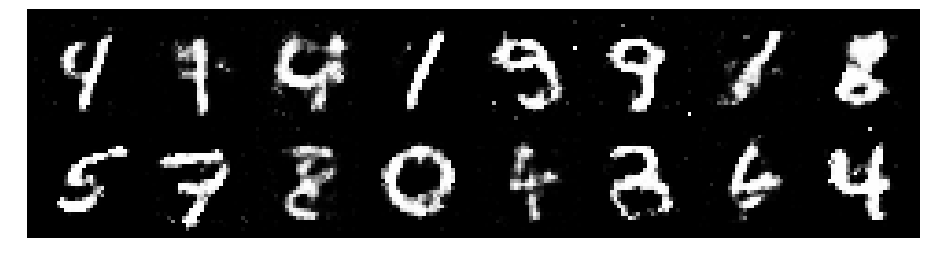

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2930, Generator Loss: 0.8454
D(x): 0.5363, D(G(z)): 0.4436


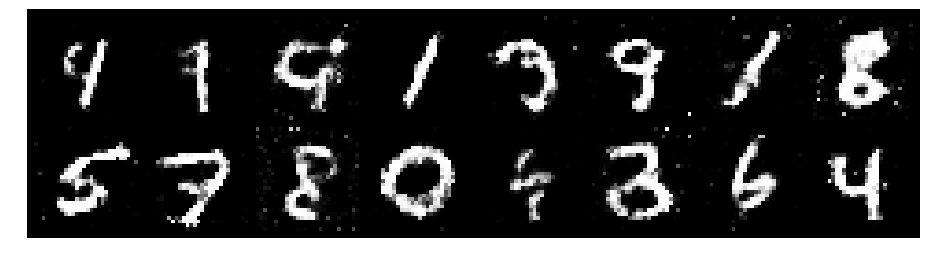

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2651, Generator Loss: 0.9491
D(x): 0.5463, D(G(z)): 0.4289


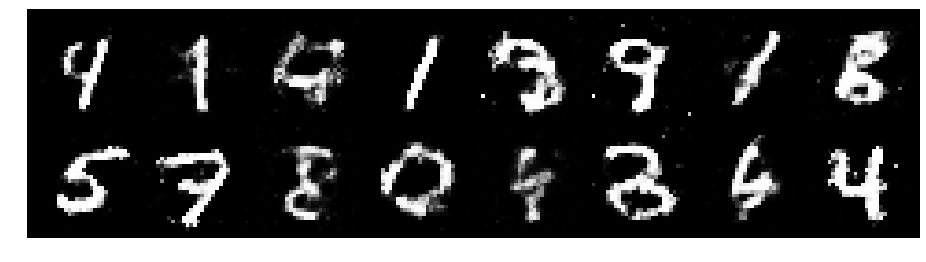

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.1756, Generator Loss: 0.9820
D(x): 0.5856, D(G(z)): 0.4101


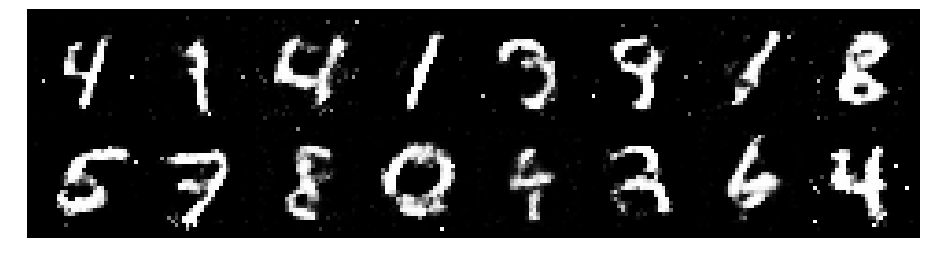

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2922, Generator Loss: 0.8549
D(x): 0.5233, D(G(z)): 0.4370


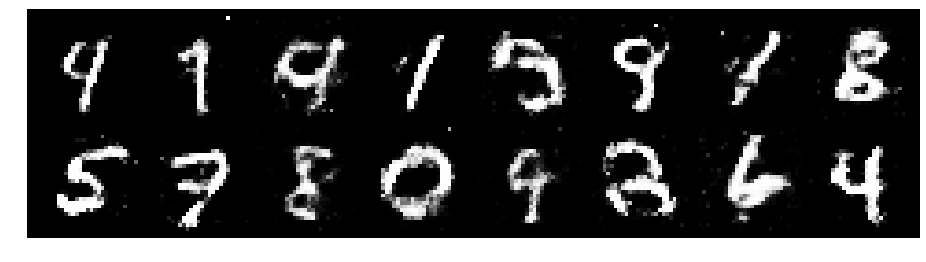

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2695, Generator Loss: 0.9138
D(x): 0.5497, D(G(z)): 0.4375


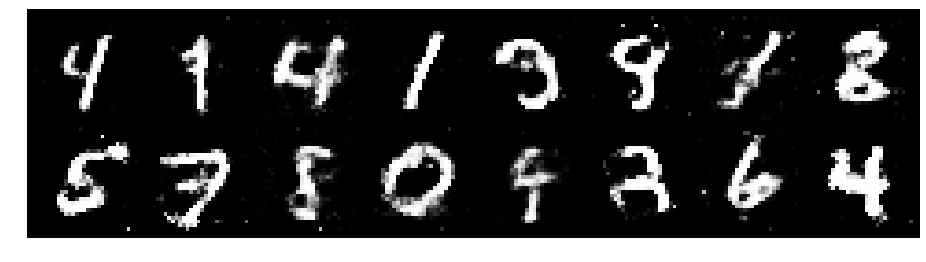

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.3912, Generator Loss: 0.8234
D(x): 0.6033, D(G(z)): 0.4764


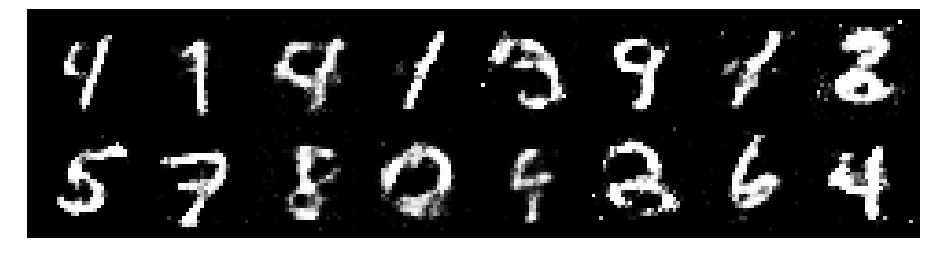

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.1118, Generator Loss: 1.2670
D(x): 0.6155, D(G(z)): 0.4071


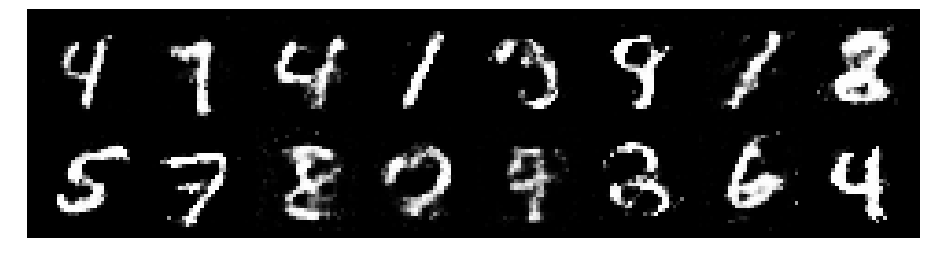

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2809, Generator Loss: 0.8810
D(x): 0.5209, D(G(z)): 0.4251


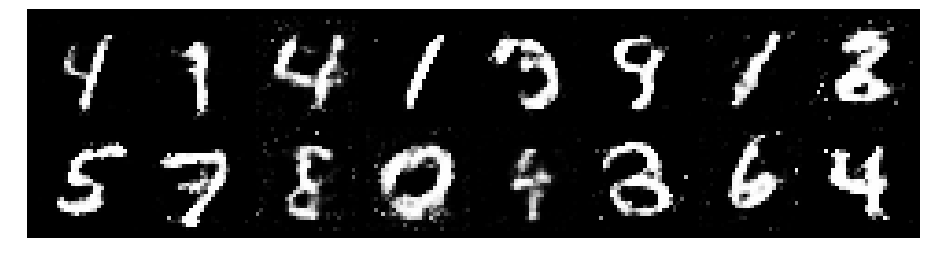

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.3435, Generator Loss: 0.9365
D(x): 0.5542, D(G(z)): 0.4510


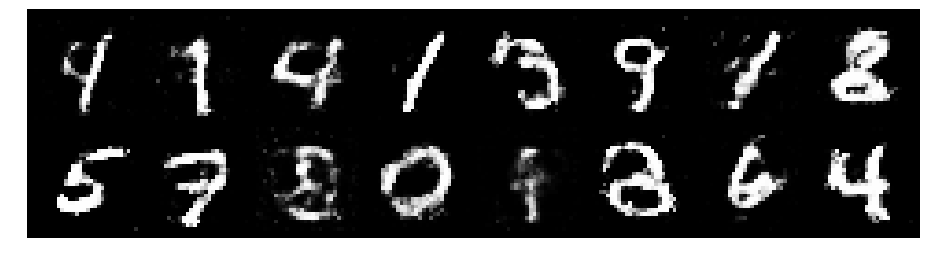

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2926, Generator Loss: 0.9170
D(x): 0.5565, D(G(z)): 0.4291


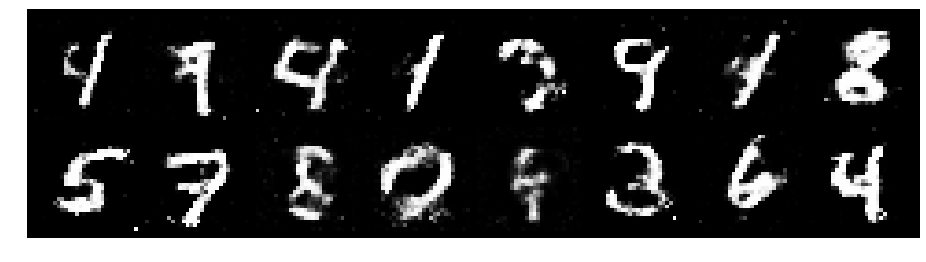

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2778, Generator Loss: 0.8059
D(x): 0.5989, D(G(z)): 0.4719


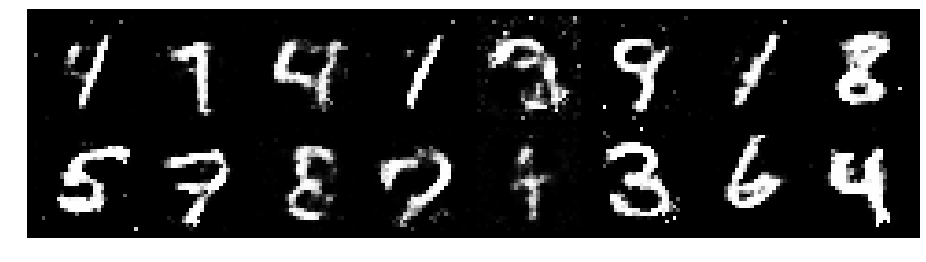

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2544, Generator Loss: 0.8553
D(x): 0.5322, D(G(z)): 0.4167


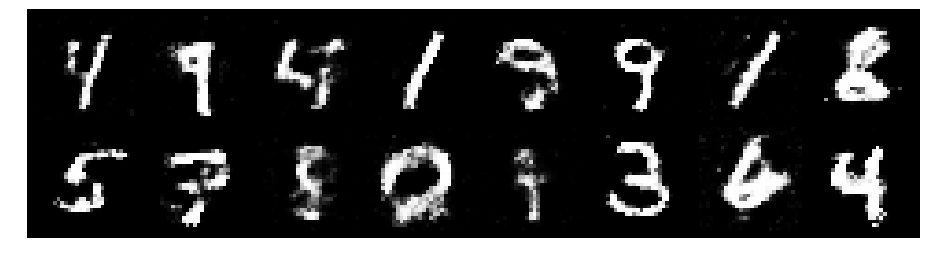

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2279, Generator Loss: 0.8257
D(x): 0.5986, D(G(z)): 0.4758


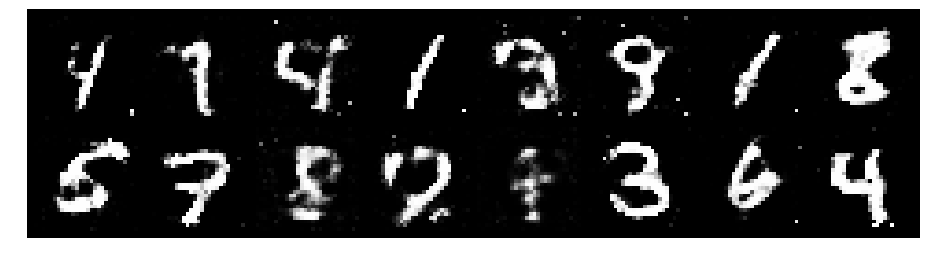

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.3279, Generator Loss: 0.7918
D(x): 0.5906, D(G(z)): 0.4972


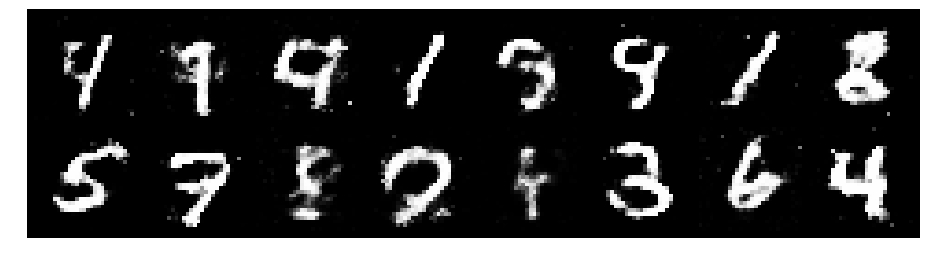

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2328, Generator Loss: 0.9504
D(x): 0.5488, D(G(z)): 0.4098


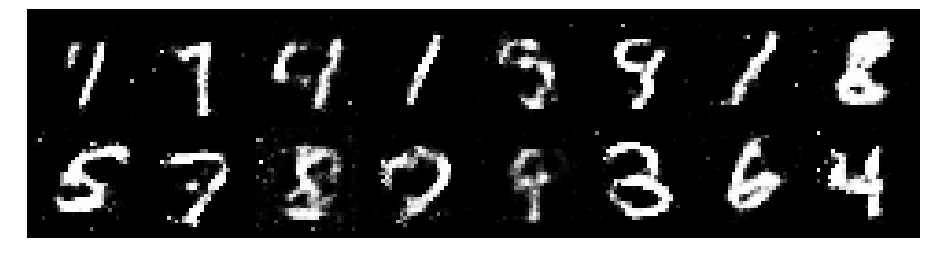

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2133, Generator Loss: 0.9676
D(x): 0.5511, D(G(z)): 0.4003


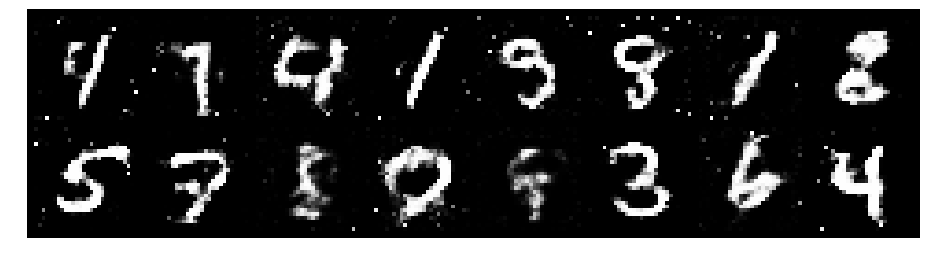

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.1652, Generator Loss: 0.9164
D(x): 0.6016, D(G(z)): 0.4408


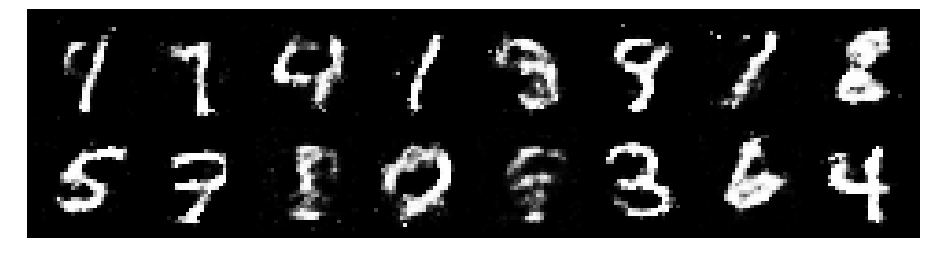

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.0827, Generator Loss: 0.9729
D(x): 0.5933, D(G(z)): 0.3655


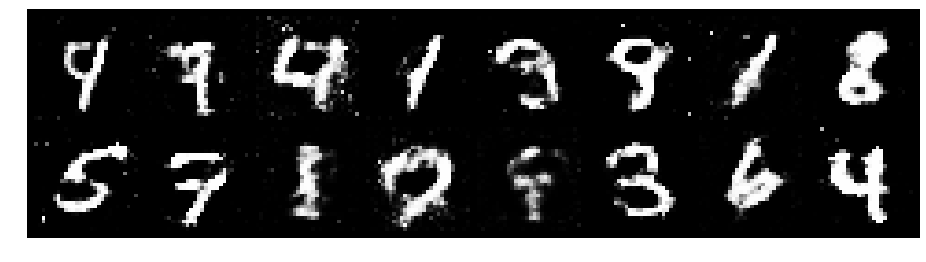

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2019, Generator Loss: 0.9966
D(x): 0.5416, D(G(z)): 0.3998


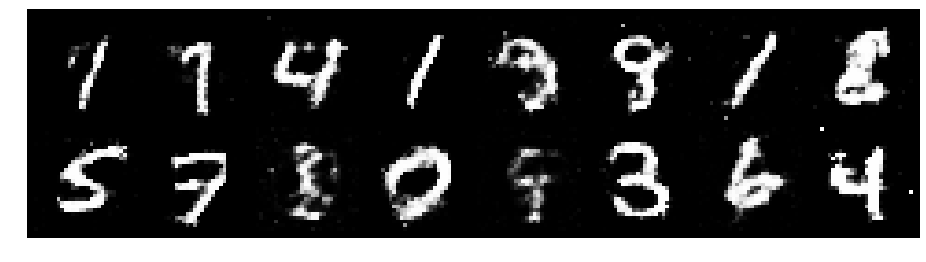

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.1547, Generator Loss: 1.0453
D(x): 0.5911, D(G(z)): 0.4040


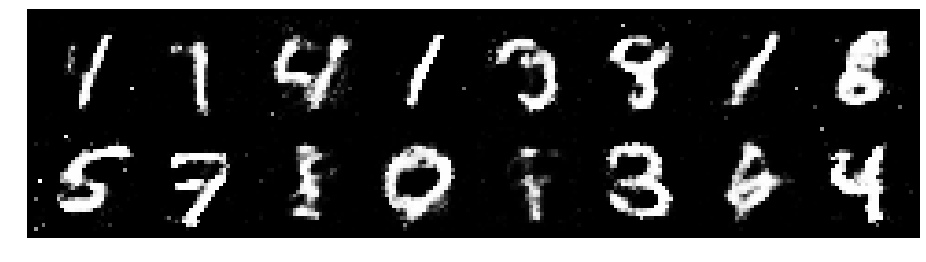

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2571, Generator Loss: 0.8005
D(x): 0.5699, D(G(z)): 0.4677


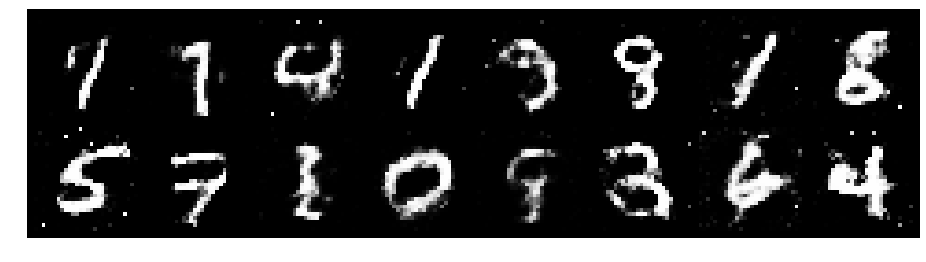

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.3263, Generator Loss: 0.7631
D(x): 0.6076, D(G(z)): 0.5099


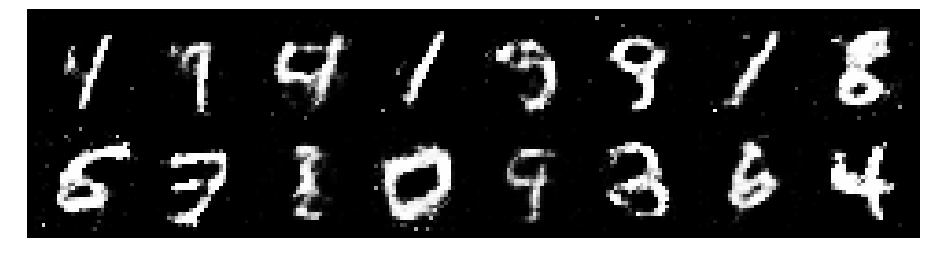

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2785, Generator Loss: 0.9147
D(x): 0.5850, D(G(z)): 0.4455


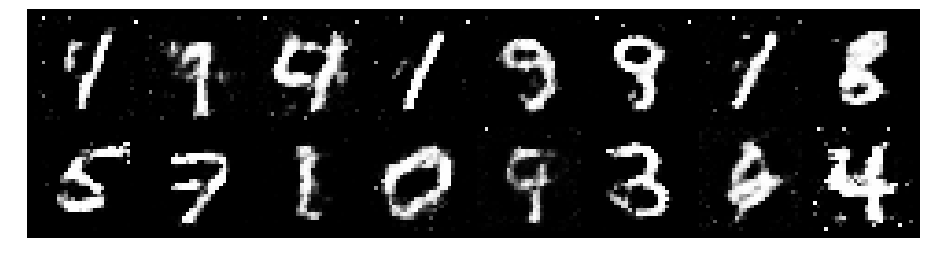

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.1386, Generator Loss: 0.8702
D(x): 0.5596, D(G(z)): 0.3917


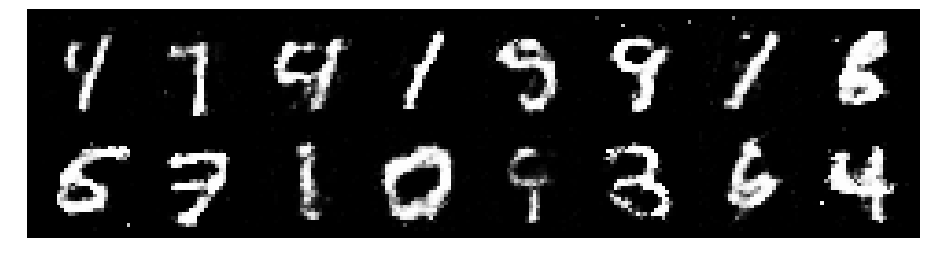

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.3459, Generator Loss: 0.8698
D(x): 0.5401, D(G(z)): 0.4702


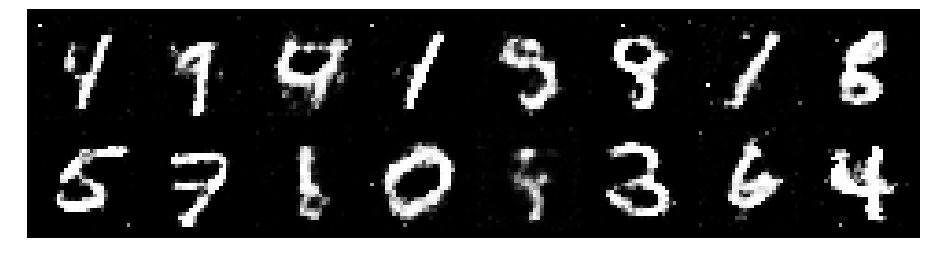

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.3332, Generator Loss: 0.8971
D(x): 0.5590, D(G(z)): 0.4051


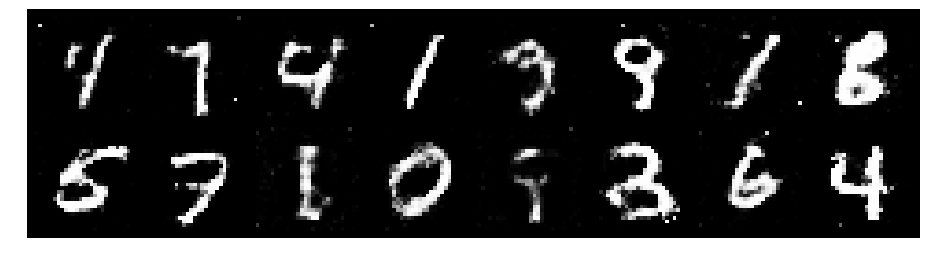

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2696, Generator Loss: 1.0405
D(x): 0.5904, D(G(z)): 0.4419


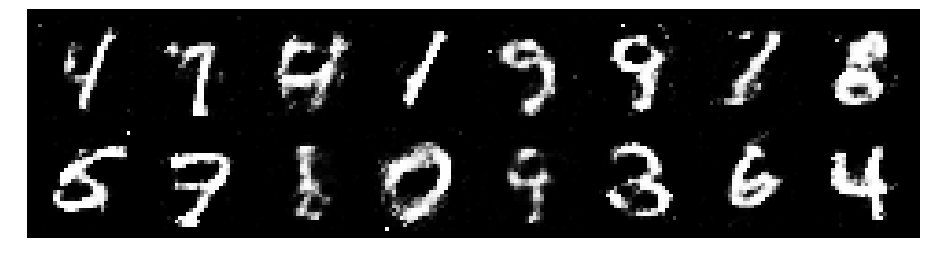

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.3515, Generator Loss: 0.9589
D(x): 0.5442, D(G(z)): 0.4329


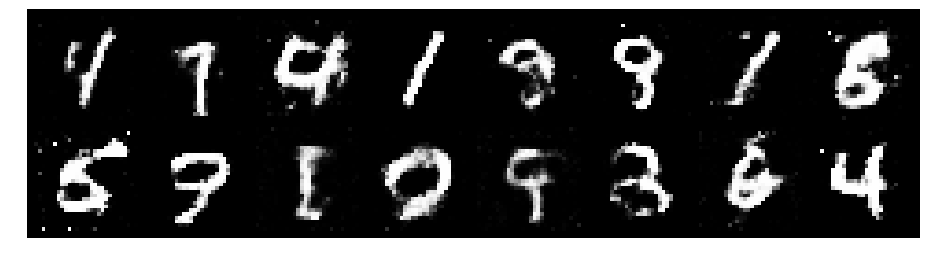

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.1575, Generator Loss: 0.9119
D(x): 0.5739, D(G(z)): 0.3987


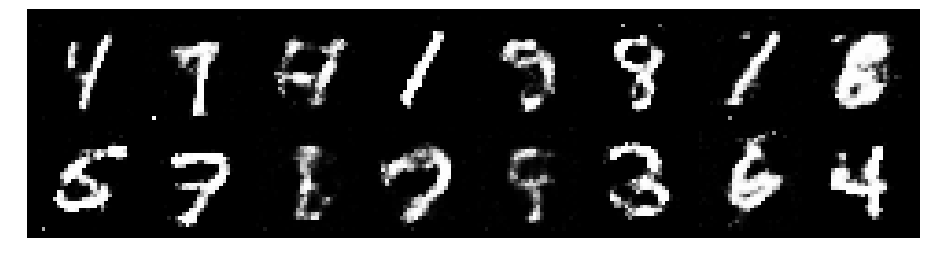

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.1979, Generator Loss: 1.0007
D(x): 0.5940, D(G(z)): 0.4356


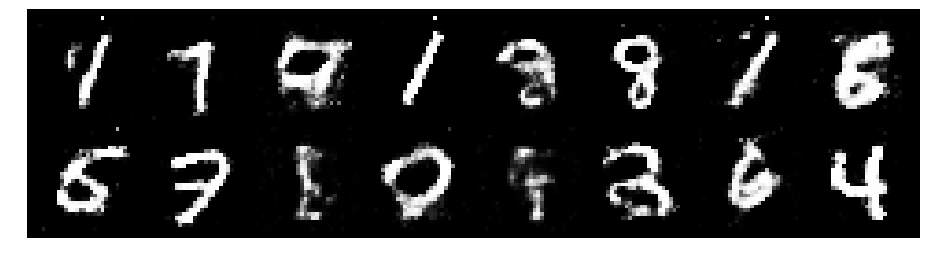

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.1707, Generator Loss: 0.9567
D(x): 0.6195, D(G(z)): 0.4443


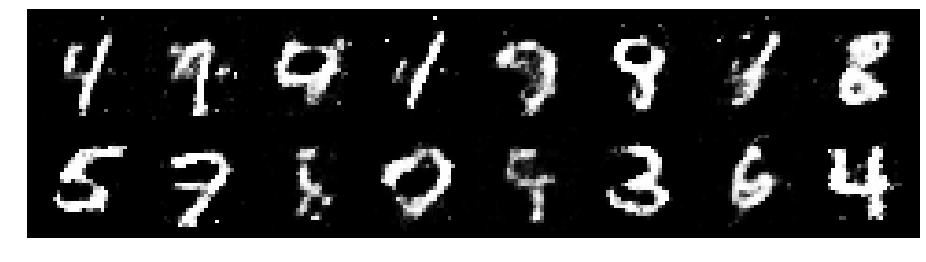

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.2238, Generator Loss: 1.0346
D(x): 0.5873, D(G(z)): 0.4491


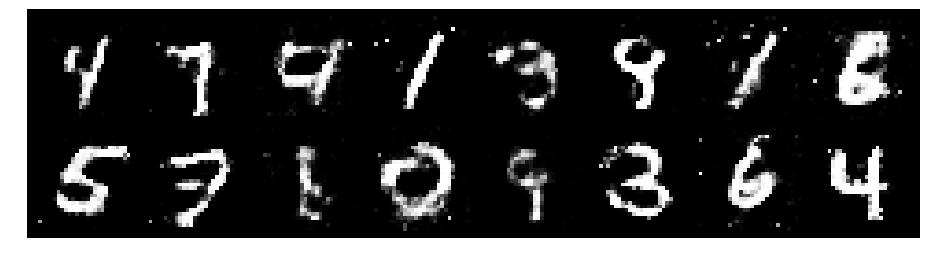

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2049, Generator Loss: 0.9391
D(x): 0.5948, D(G(z)): 0.4287


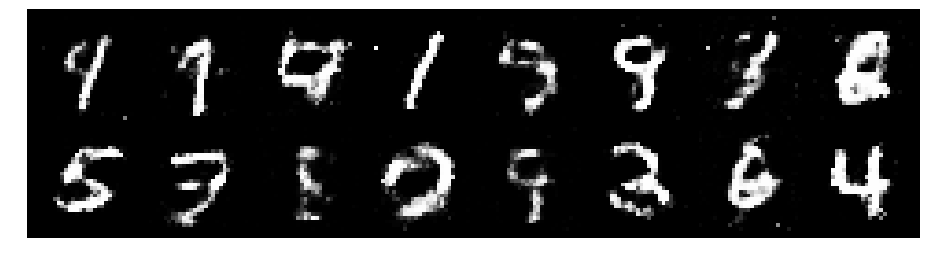

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2517, Generator Loss: 1.0865
D(x): 0.5470, D(G(z)): 0.4240


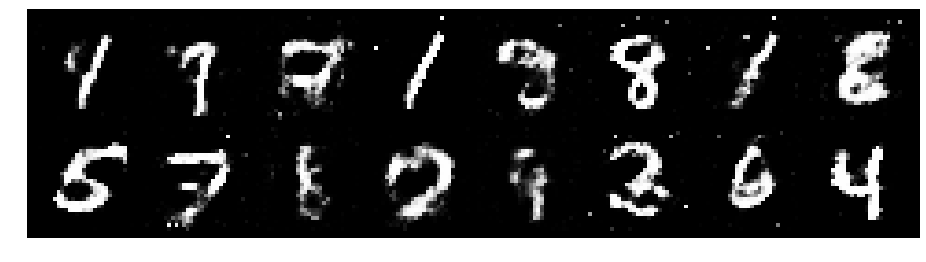

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.1797, Generator Loss: 0.9826
D(x): 0.5294, D(G(z)): 0.3782


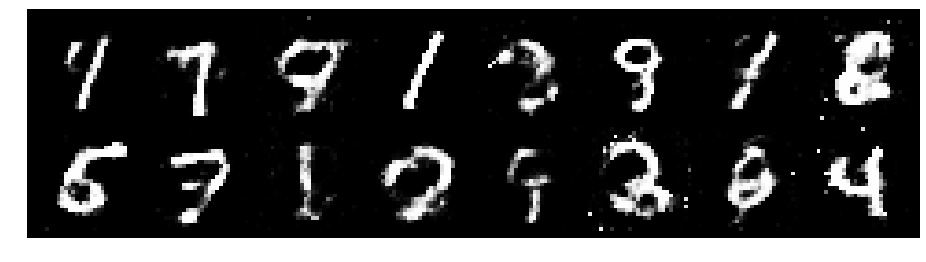

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.1471, Generator Loss: 0.9253
D(x): 0.6025, D(G(z)): 0.4214


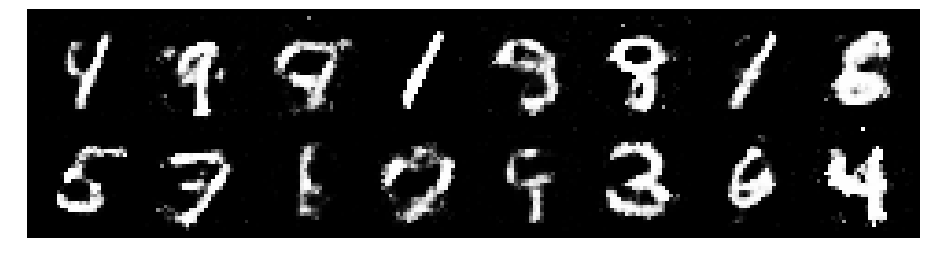

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2704, Generator Loss: 0.9224
D(x): 0.5515, D(G(z)): 0.4350


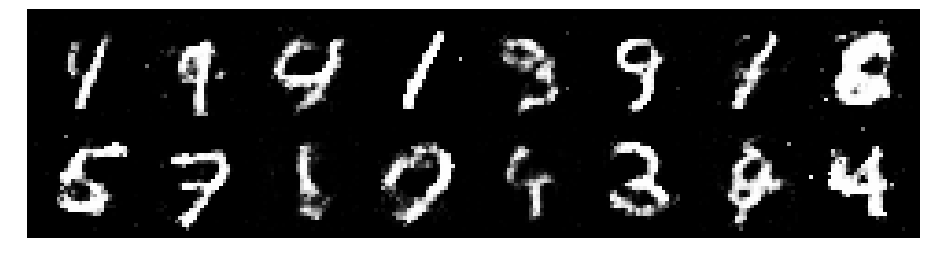

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2916, Generator Loss: 1.0550
D(x): 0.6011, D(G(z)): 0.4550


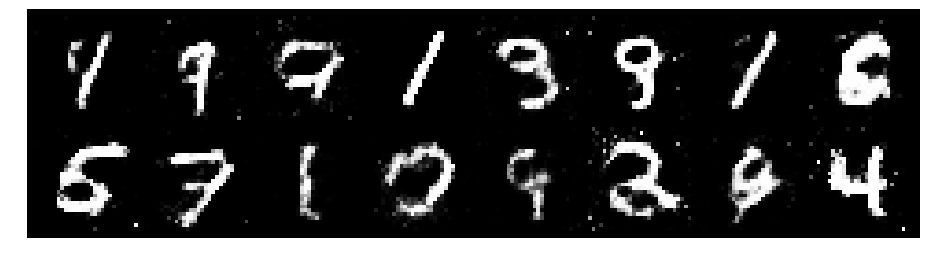

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2159, Generator Loss: 1.2344
D(x): 0.5798, D(G(z)): 0.3941


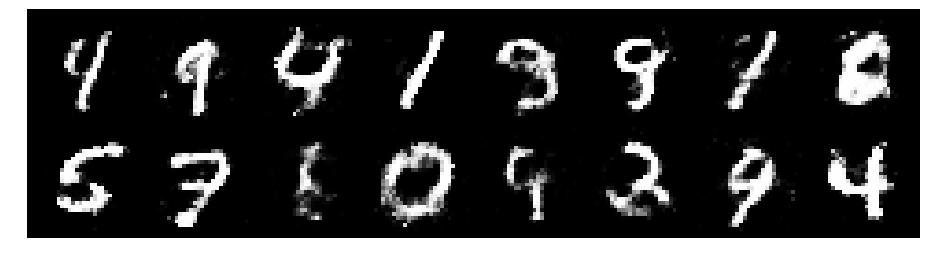

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2283, Generator Loss: 0.9694
D(x): 0.5551, D(G(z)): 0.4162


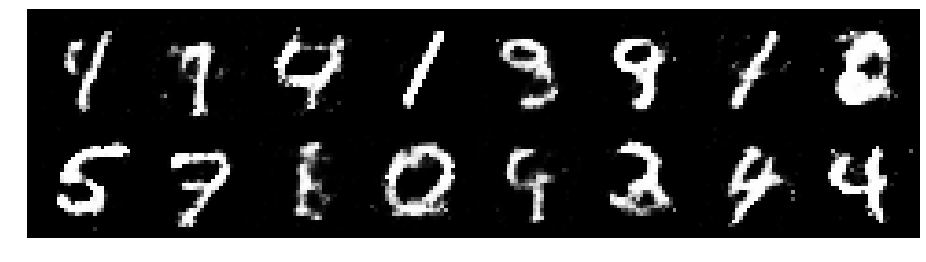

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2675, Generator Loss: 0.7604
D(x): 0.6048, D(G(z)): 0.4986


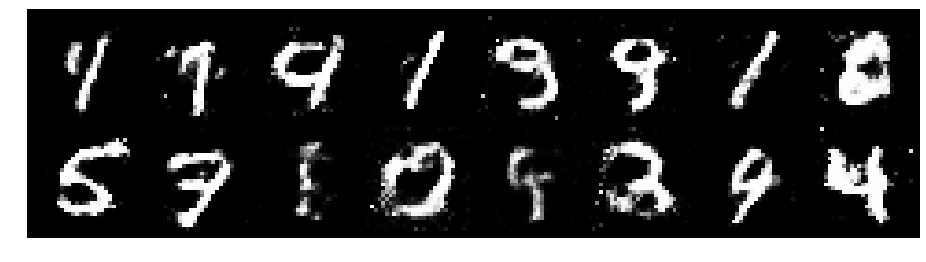

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2779, Generator Loss: 0.8433
D(x): 0.5548, D(G(z)): 0.4465


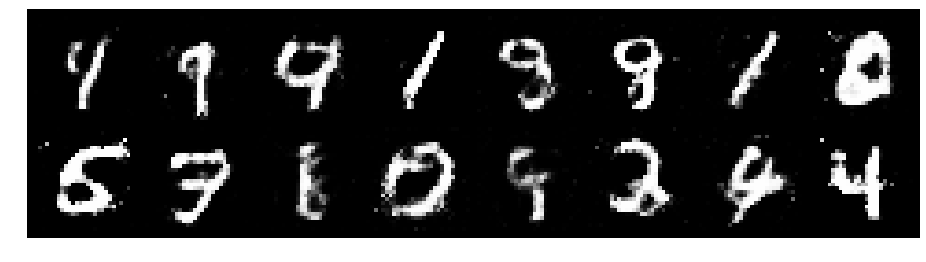

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.3366, Generator Loss: 0.9515
D(x): 0.5821, D(G(z)): 0.4747


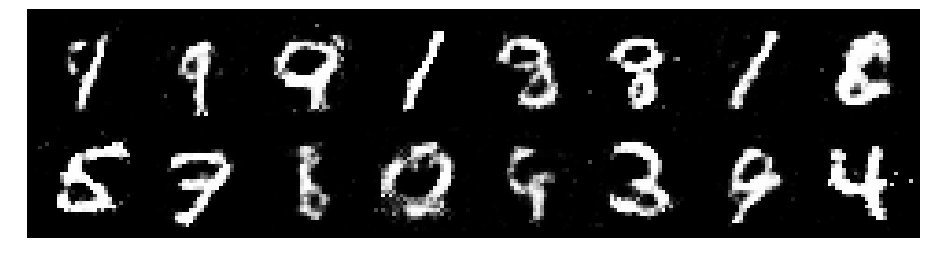

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2484, Generator Loss: 0.9103
D(x): 0.5538, D(G(z)): 0.4225


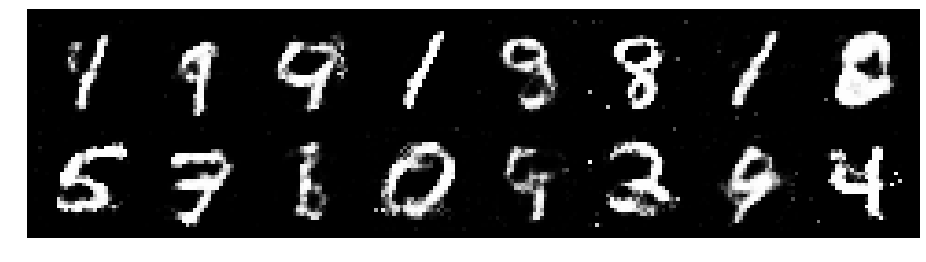

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.3607, Generator Loss: 0.8562
D(x): 0.5786, D(G(z)): 0.4865


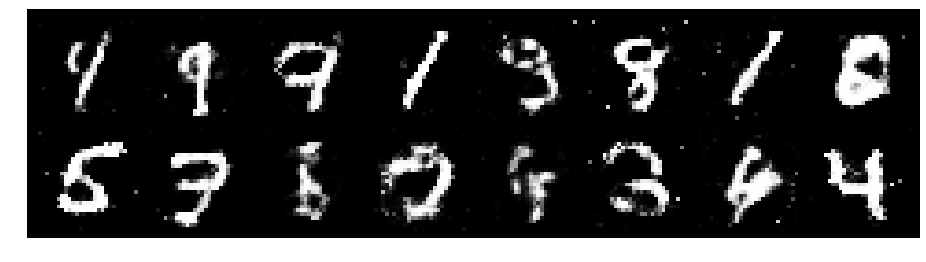

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.3372, Generator Loss: 0.9557
D(x): 0.5297, D(G(z)): 0.4535


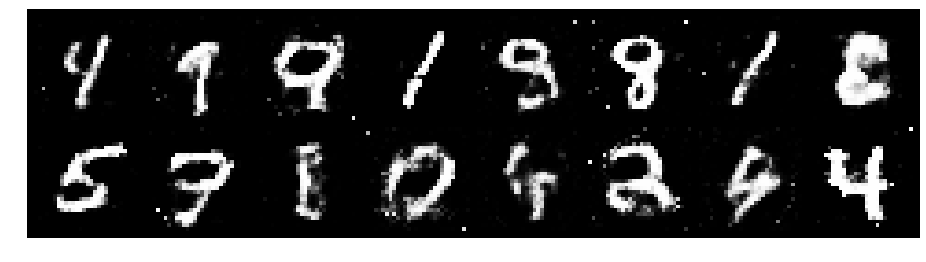

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2803, Generator Loss: 0.9836
D(x): 0.5279, D(G(z)): 0.4153


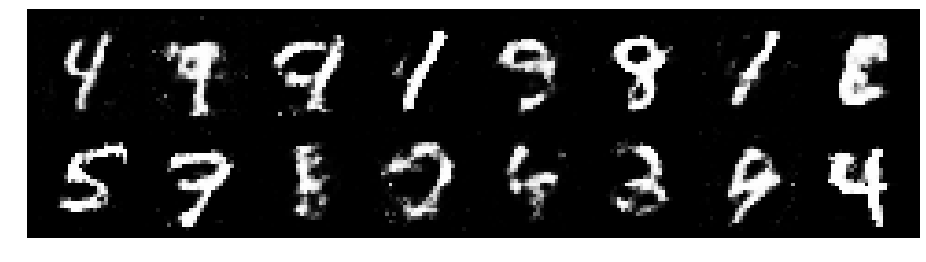

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.3130, Generator Loss: 0.8747
D(x): 0.5719, D(G(z)): 0.4788


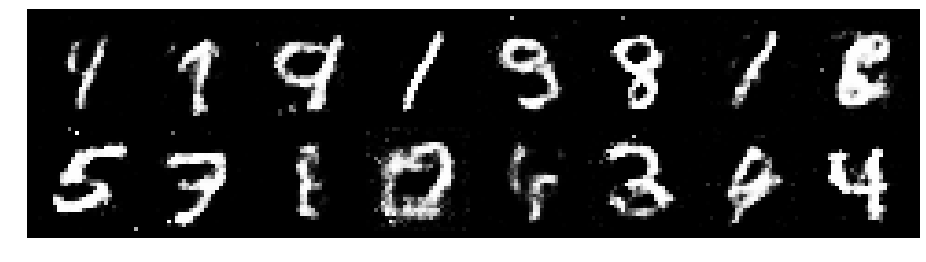

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2675, Generator Loss: 0.9091
D(x): 0.5350, D(G(z)): 0.4186


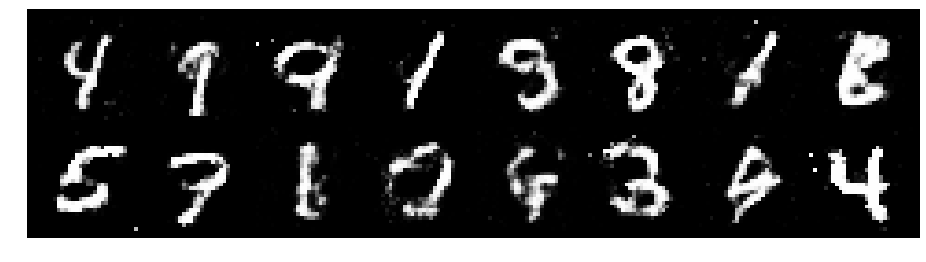

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2422, Generator Loss: 1.1688
D(x): 0.5813, D(G(z)): 0.4193


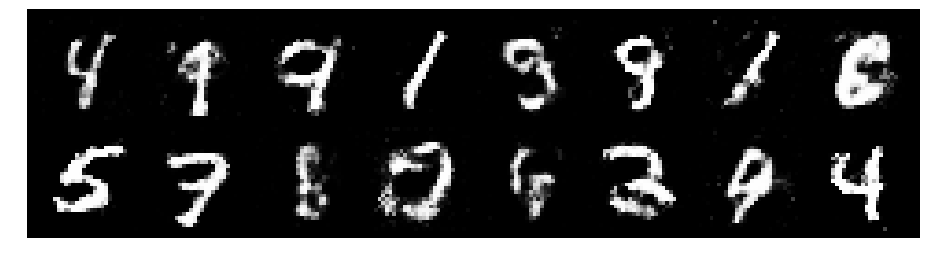

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.1956, Generator Loss: 0.9345
D(x): 0.5665, D(G(z)): 0.4222


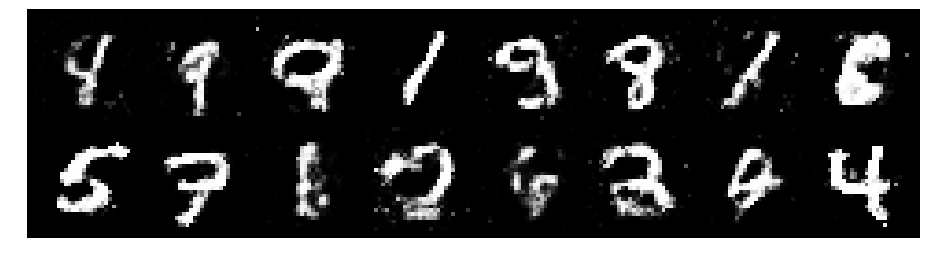

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.2318, Generator Loss: 0.9323
D(x): 0.5545, D(G(z)): 0.4260


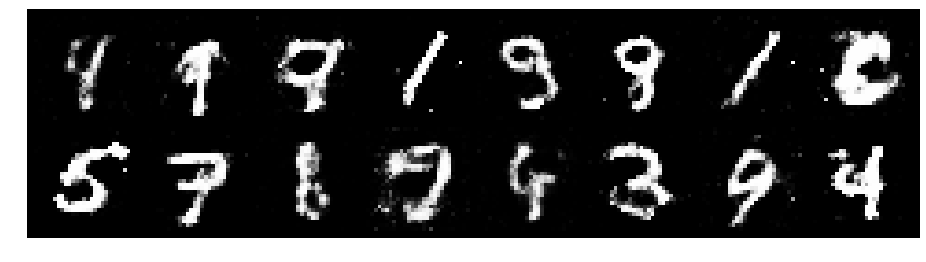

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2380, Generator Loss: 0.8307
D(x): 0.5769, D(G(z)): 0.4608


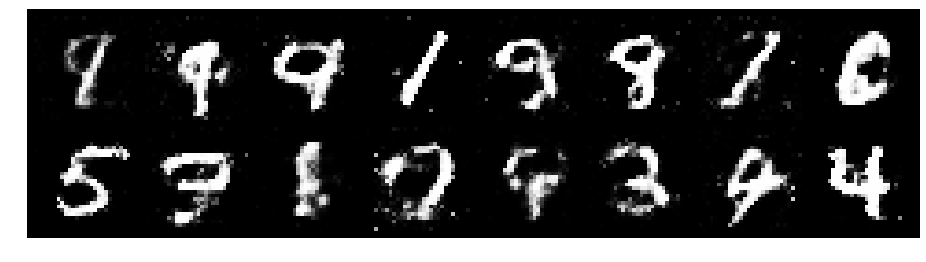

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2891, Generator Loss: 0.9248
D(x): 0.5439, D(G(z)): 0.4004


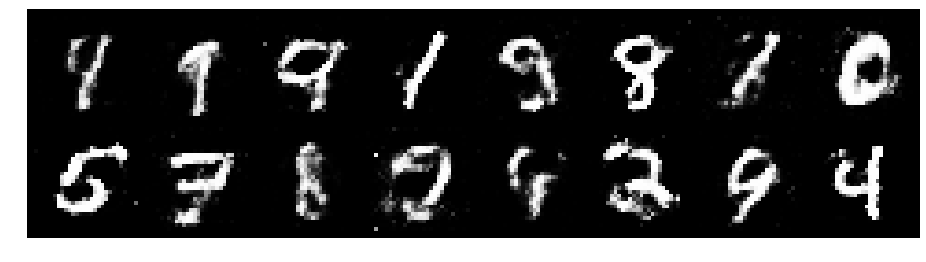

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.3455, Generator Loss: 0.9158
D(x): 0.5414, D(G(z)): 0.4689


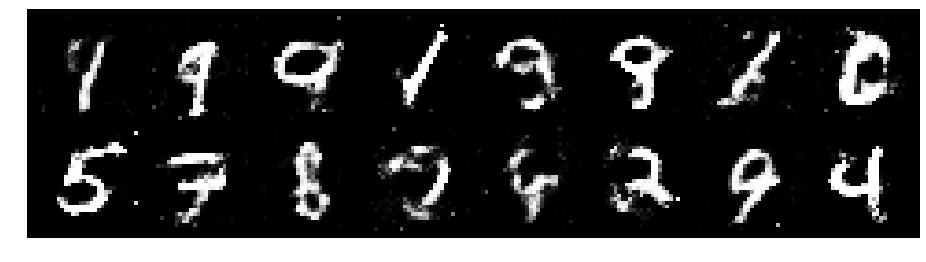

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2373, Generator Loss: 0.8318
D(x): 0.5874, D(G(z)): 0.4576


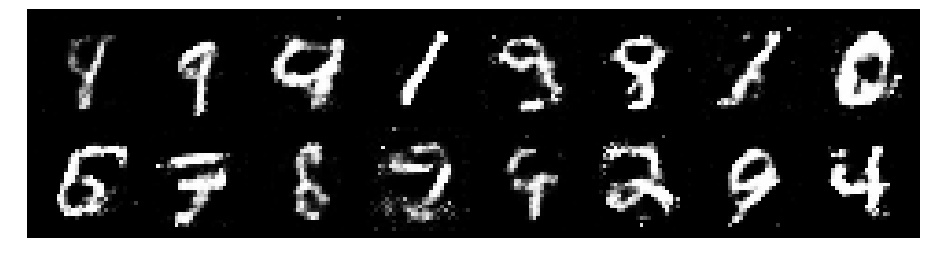

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2077, Generator Loss: 1.0727
D(x): 0.5398, D(G(z)): 0.3984


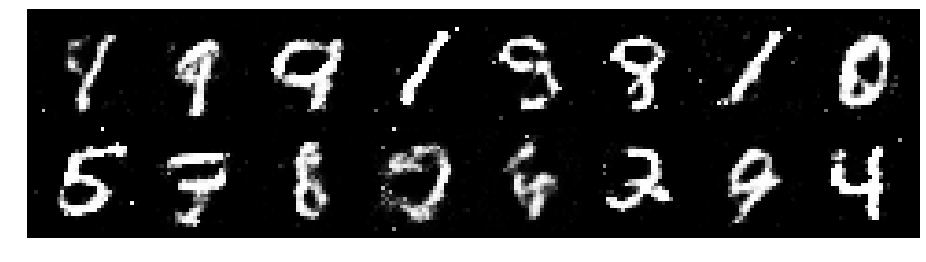

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2234, Generator Loss: 1.1097
D(x): 0.5627, D(G(z)): 0.4130


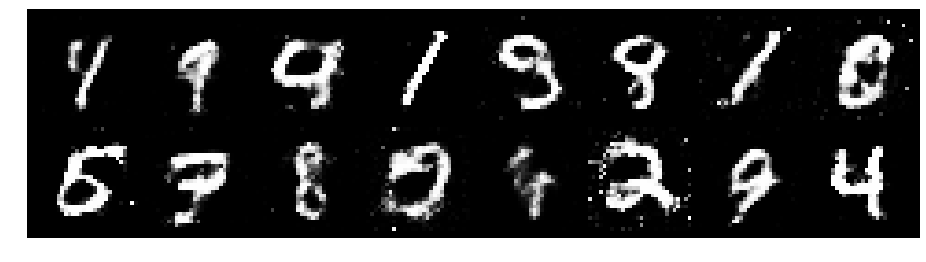

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.2770, Generator Loss: 0.8032
D(x): 0.5361, D(G(z)): 0.4252


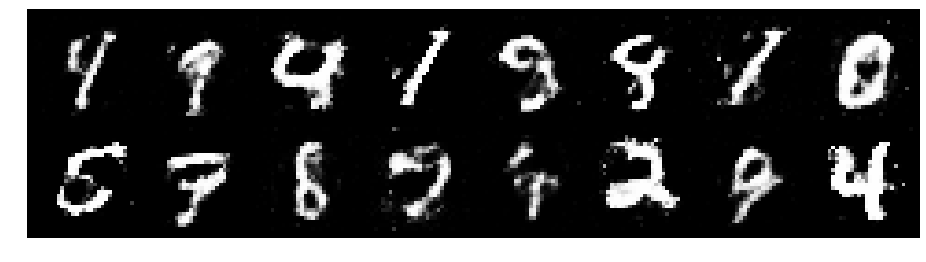

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.2109, Generator Loss: 0.8919
D(x): 0.5663, D(G(z)): 0.4274


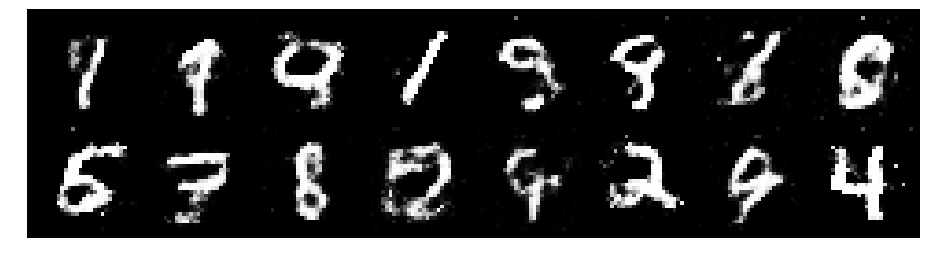

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.3020, Generator Loss: 0.8971
D(x): 0.5886, D(G(z)): 0.4823


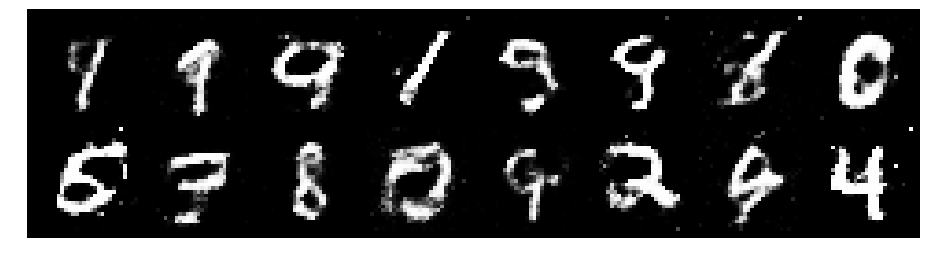

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.3798, Generator Loss: 0.9134
D(x): 0.5904, D(G(z)): 0.5164


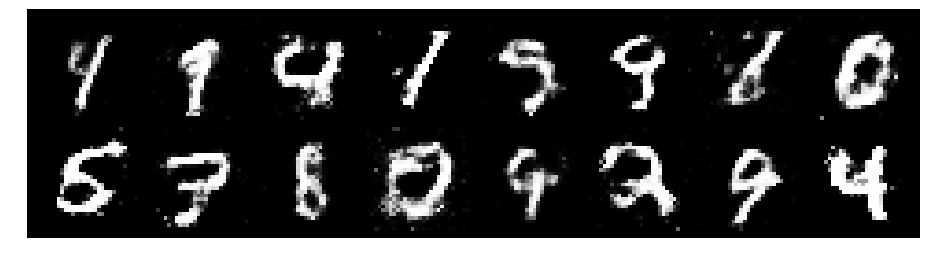

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.2698, Generator Loss: 0.9121
D(x): 0.5612, D(G(z)): 0.4355


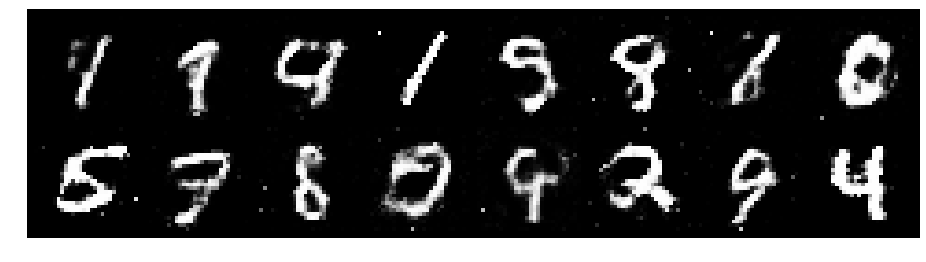

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.3789, Generator Loss: 0.9009
D(x): 0.5102, D(G(z)): 0.4196


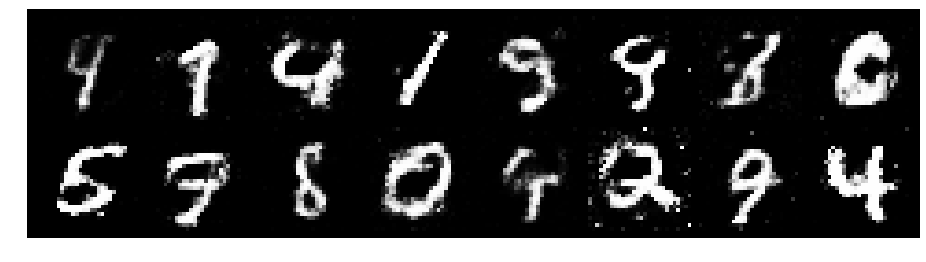

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2784, Generator Loss: 0.7792
D(x): 0.5704, D(G(z)): 0.4588


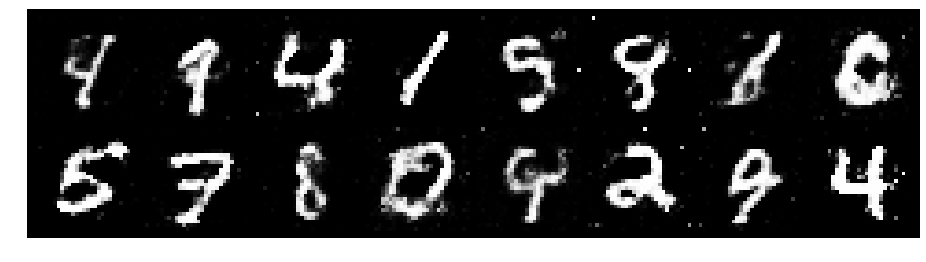

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2526, Generator Loss: 0.9297
D(x): 0.6162, D(G(z)): 0.4897


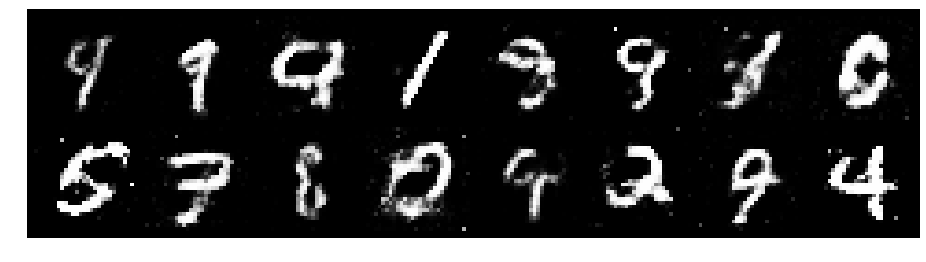

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2014, Generator Loss: 0.9437
D(x): 0.5614, D(G(z)): 0.3889


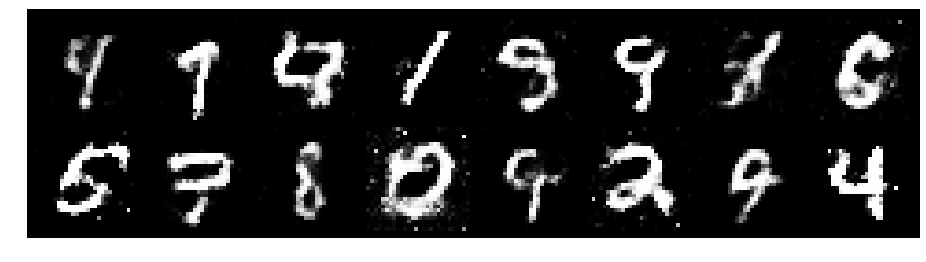

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.3688, Generator Loss: 0.8713
D(x): 0.5368, D(G(z)): 0.4764


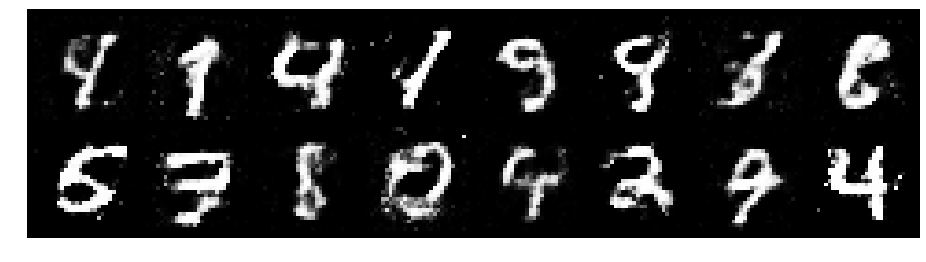

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.3350, Generator Loss: 0.8822
D(x): 0.5895, D(G(z)): 0.4832


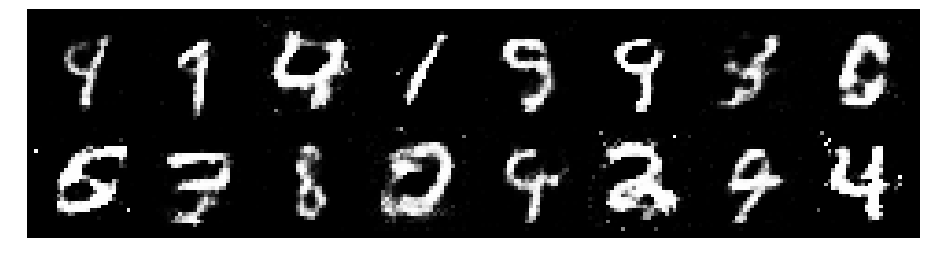

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.3406, Generator Loss: 0.8021
D(x): 0.6225, D(G(z)): 0.5011


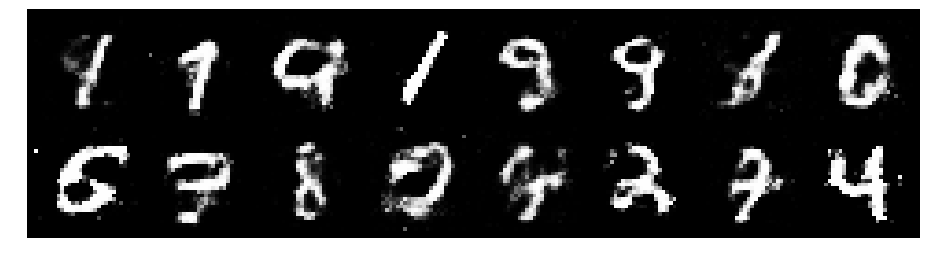

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.3561, Generator Loss: 0.9255
D(x): 0.5347, D(G(z)): 0.4655


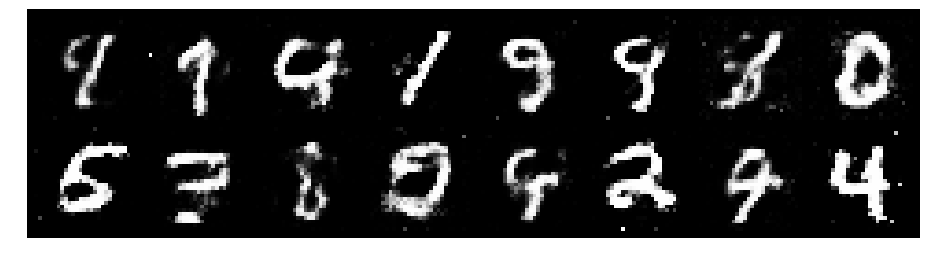

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.4067, Generator Loss: 0.8096
D(x): 0.5382, D(G(z)): 0.5036


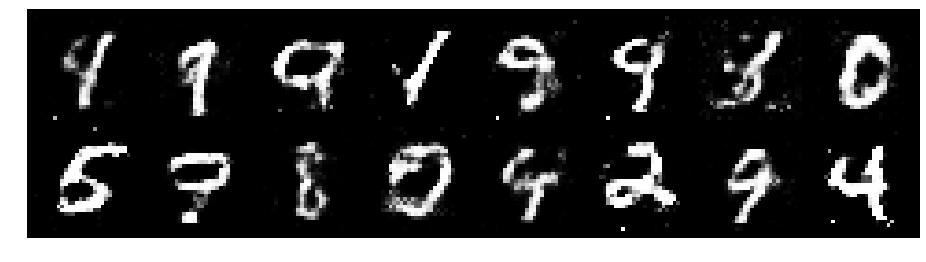

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2533, Generator Loss: 0.8734
D(x): 0.5937, D(G(z)): 0.4483


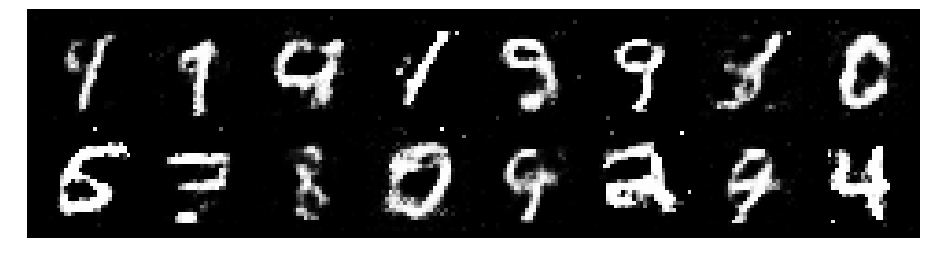

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1172, Generator Loss: 0.9088
D(x): 0.6347, D(G(z)): 0.4380


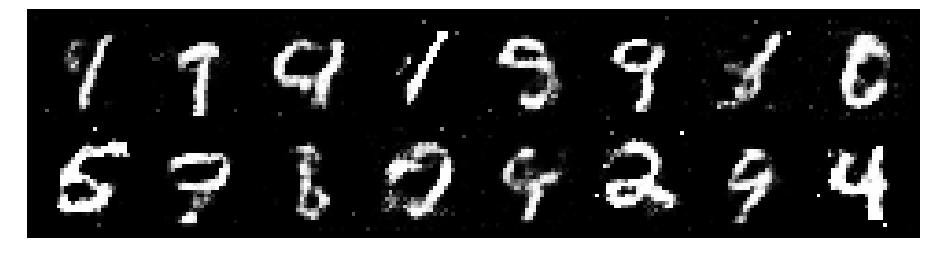

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2846, Generator Loss: 0.9516
D(x): 0.5656, D(G(z)): 0.4387


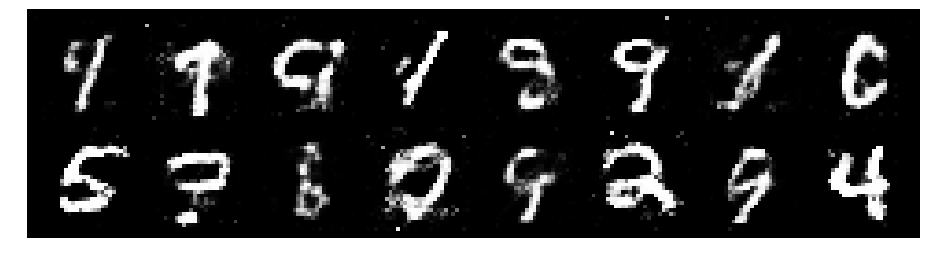

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2053, Generator Loss: 0.9812
D(x): 0.5581, D(G(z)): 0.4121


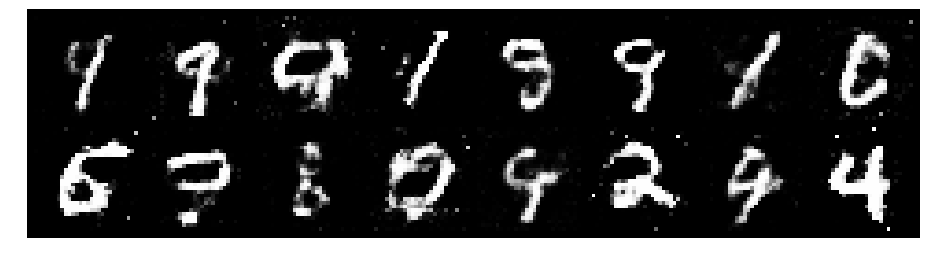

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.1578, Generator Loss: 0.9202
D(x): 0.5782, D(G(z)): 0.4057


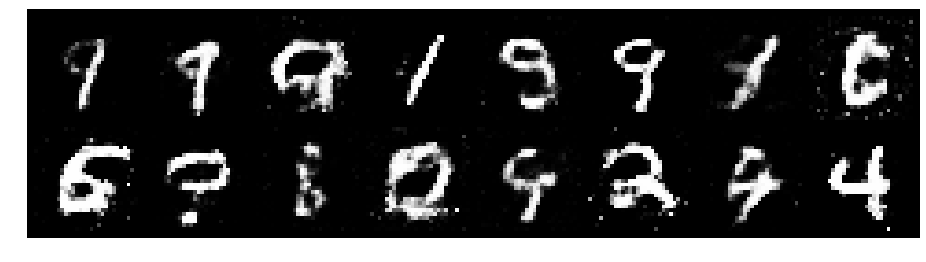

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2230, Generator Loss: 1.0423
D(x): 0.5816, D(G(z)): 0.4291


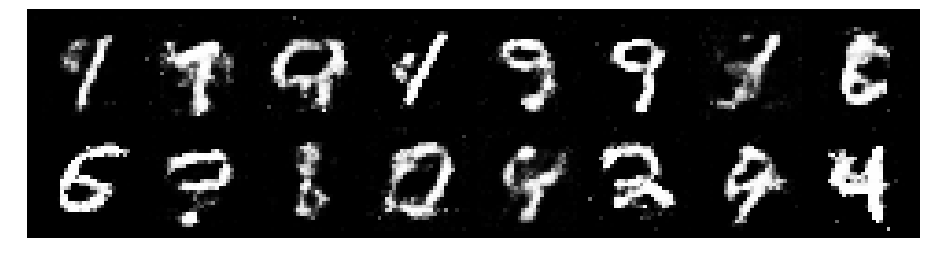

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2053, Generator Loss: 0.9921
D(x): 0.5841, D(G(z)): 0.4250


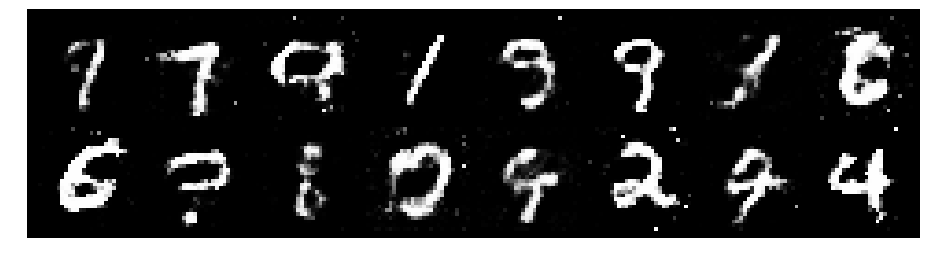

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.1814, Generator Loss: 1.1460
D(x): 0.5533, D(G(z)): 0.3881


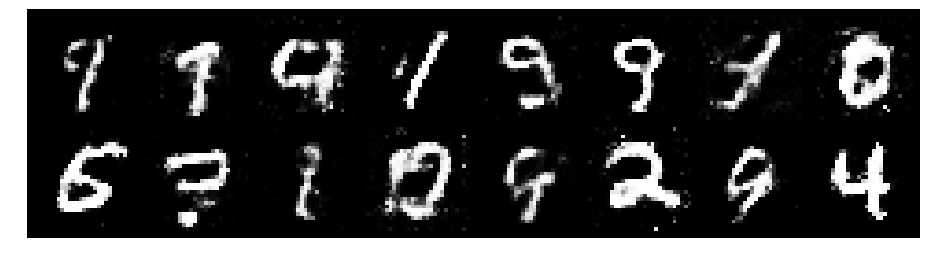

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2488, Generator Loss: 0.9038
D(x): 0.5591, D(G(z)): 0.4456


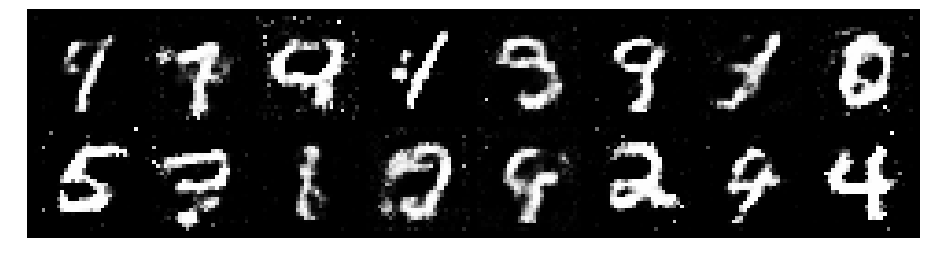

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2482, Generator Loss: 0.9427
D(x): 0.5656, D(G(z)): 0.4308


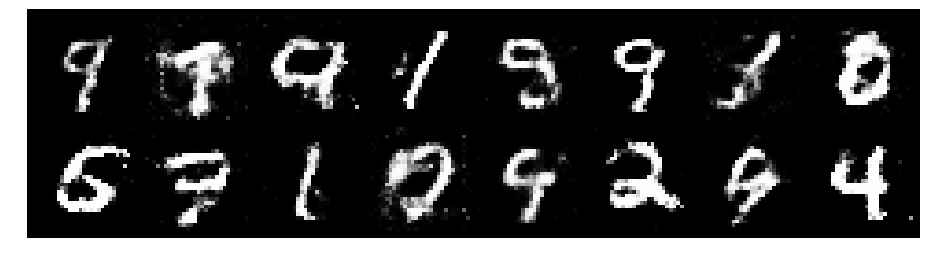

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2285, Generator Loss: 0.9944
D(x): 0.5553, D(G(z)): 0.4161


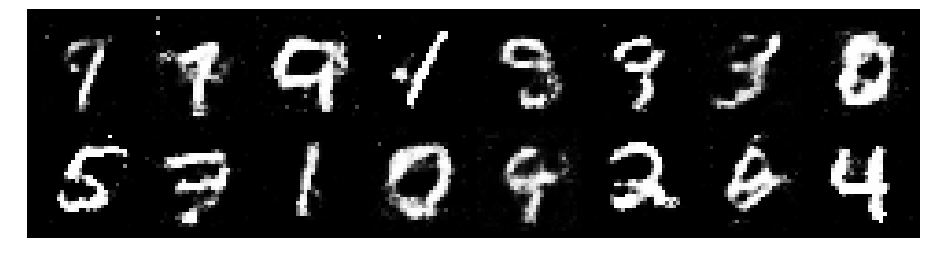

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.2367, Generator Loss: 1.0168
D(x): 0.5803, D(G(z)): 0.4278


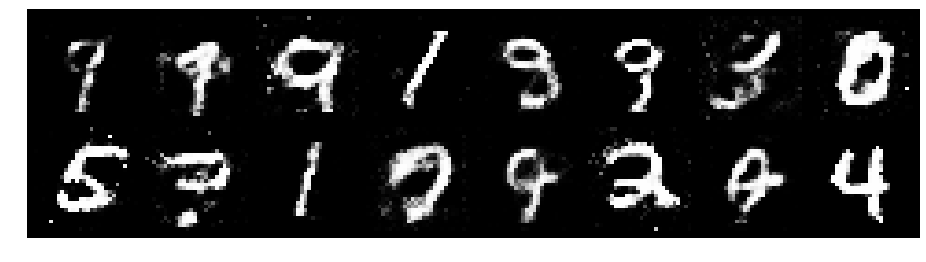

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.1094, Generator Loss: 1.0642
D(x): 0.6106, D(G(z)): 0.3959


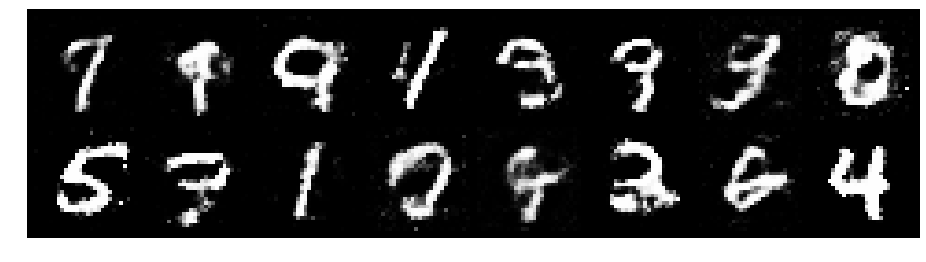

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2405, Generator Loss: 0.9485
D(x): 0.5601, D(G(z)): 0.4155


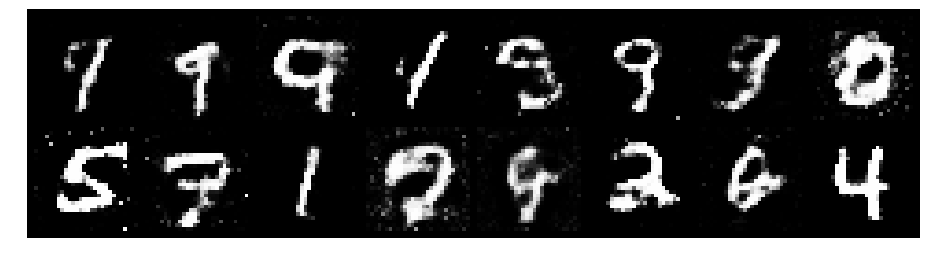

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2124, Generator Loss: 1.0199
D(x): 0.5824, D(G(z)): 0.4414


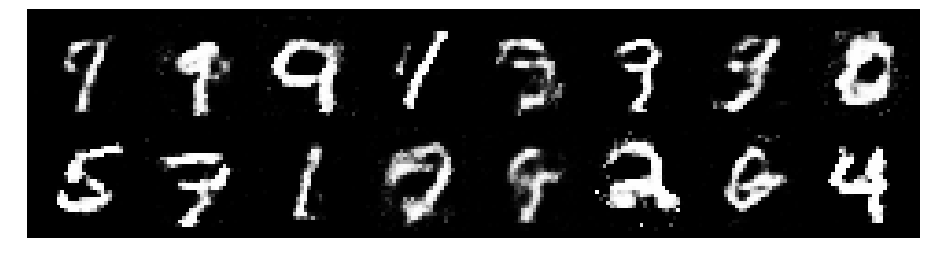

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2170, Generator Loss: 1.1407
D(x): 0.5954, D(G(z)): 0.4149


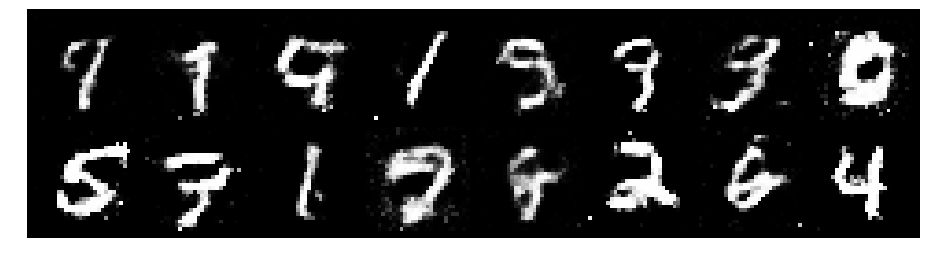

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.1949, Generator Loss: 0.8498
D(x): 0.5596, D(G(z)): 0.4148


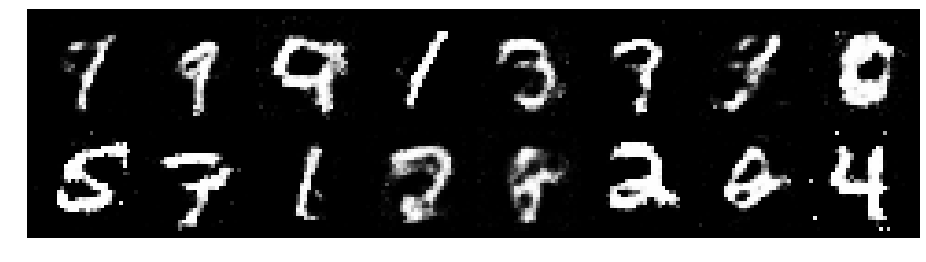

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.1928, Generator Loss: 1.0505
D(x): 0.5891, D(G(z)): 0.4198


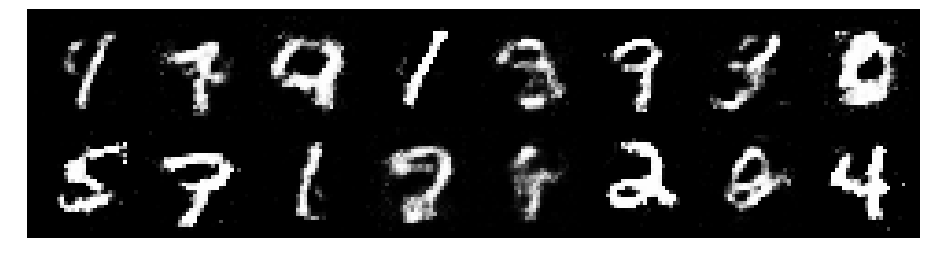

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2513, Generator Loss: 0.7882
D(x): 0.5876, D(G(z)): 0.4660


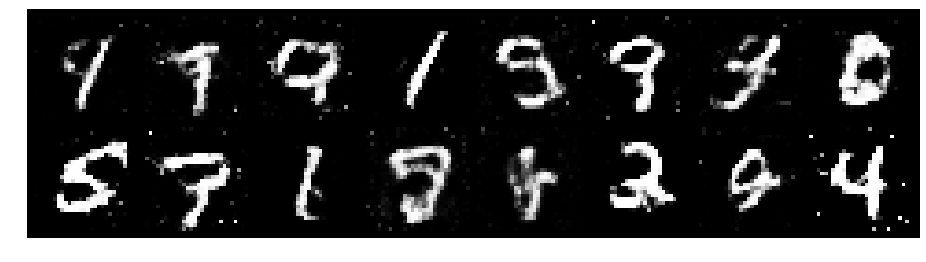

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.2302, Generator Loss: 0.8570
D(x): 0.5546, D(G(z)): 0.4284


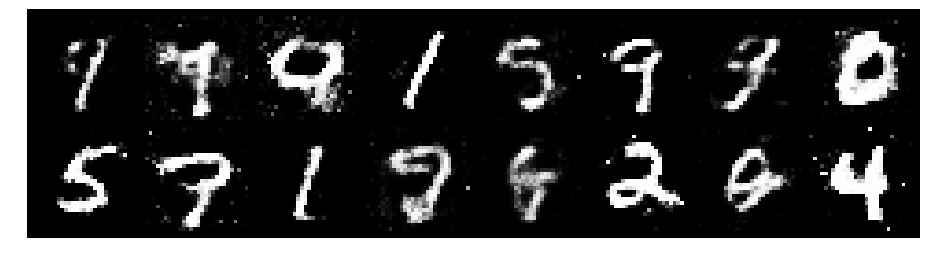

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.2376, Generator Loss: 0.8388
D(x): 0.5816, D(G(z)): 0.4551


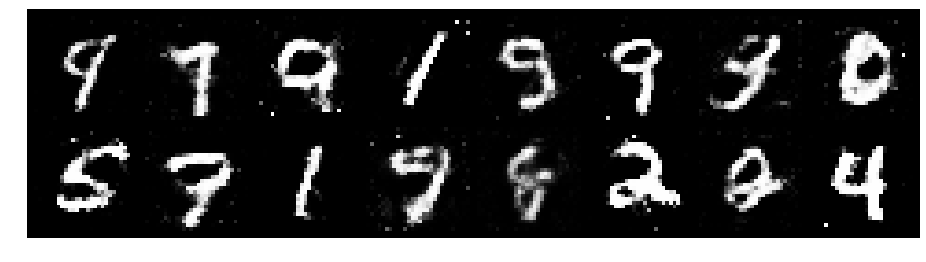

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2928, Generator Loss: 0.8718
D(x): 0.5359, D(G(z)): 0.4527


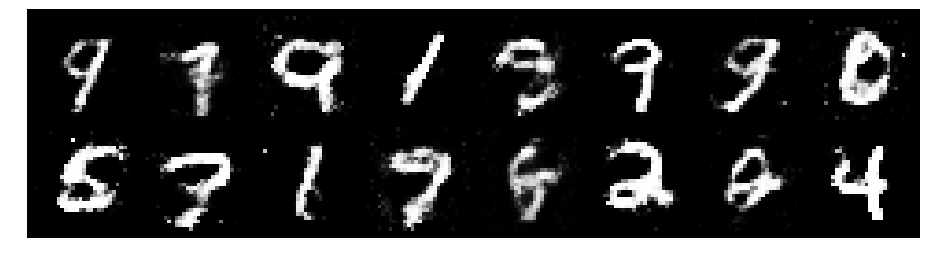

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.4141, Generator Loss: 0.9894
D(x): 0.5563, D(G(z)): 0.4907


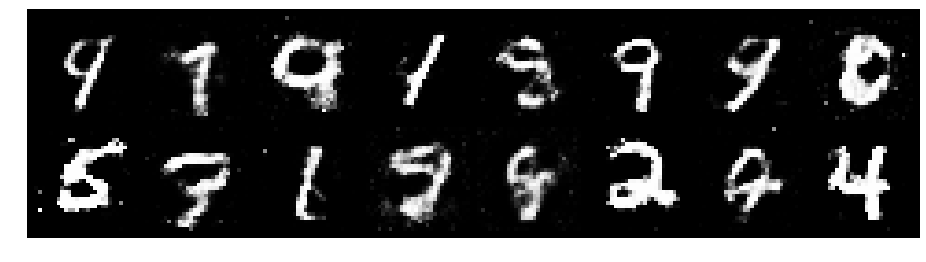

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.2757, Generator Loss: 0.8217
D(x): 0.6197, D(G(z)): 0.4958


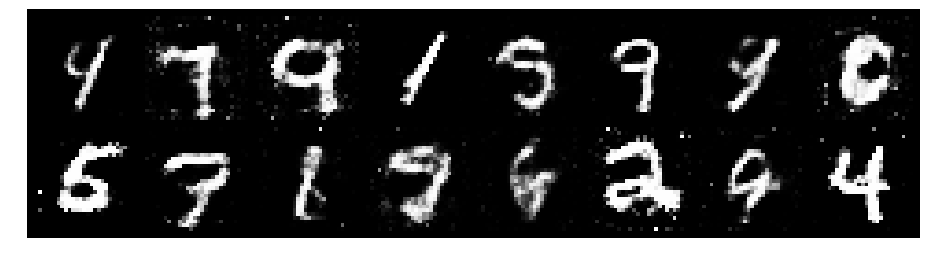

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2385, Generator Loss: 0.9521
D(x): 0.5903, D(G(z)): 0.4288


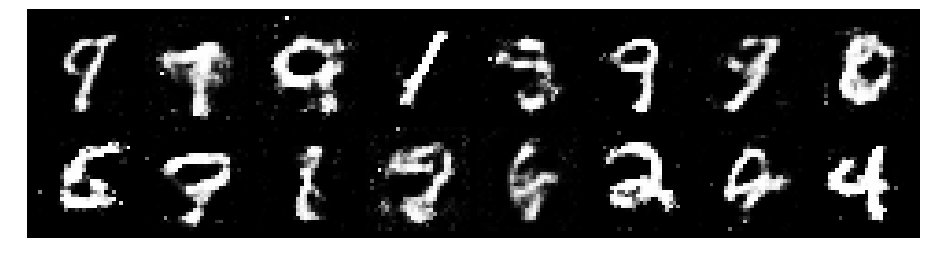

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.1486, Generator Loss: 0.9920
D(x): 0.6208, D(G(z)): 0.4316


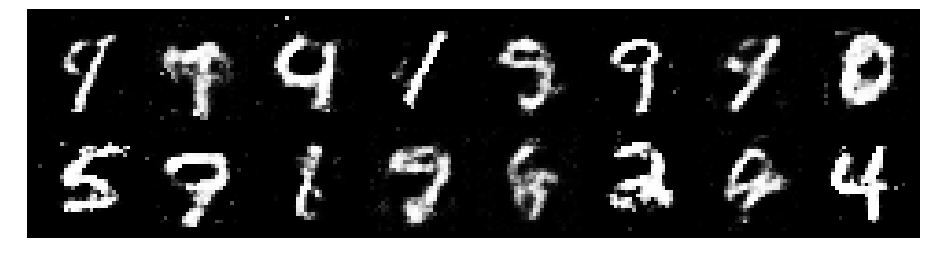

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2167, Generator Loss: 0.7968
D(x): 0.5907, D(G(z)): 0.4574


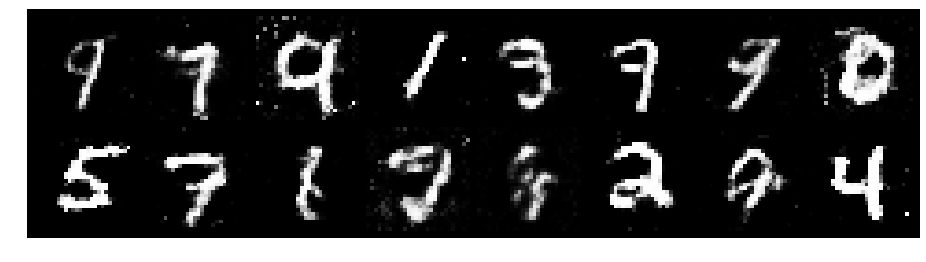

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.1910, Generator Loss: 1.0201
D(x): 0.5908, D(G(z)): 0.4130


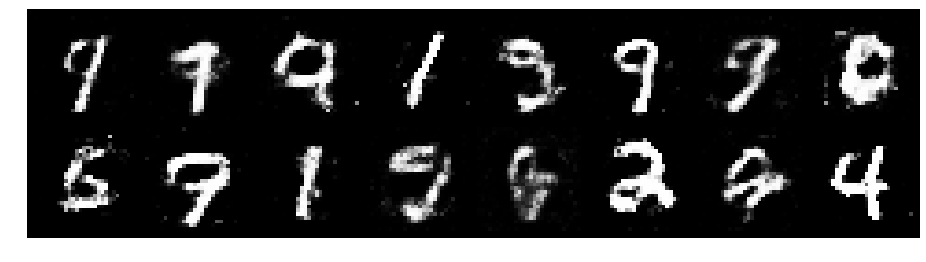

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.3307, Generator Loss: 0.7682
D(x): 0.5750, D(G(z)): 0.5048


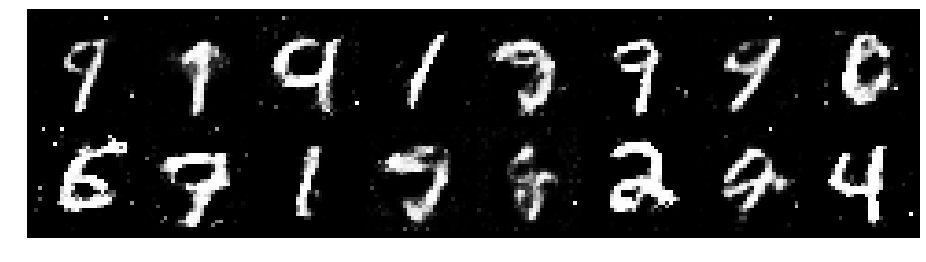

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2302, Generator Loss: 0.9805
D(x): 0.5885, D(G(z)): 0.4390


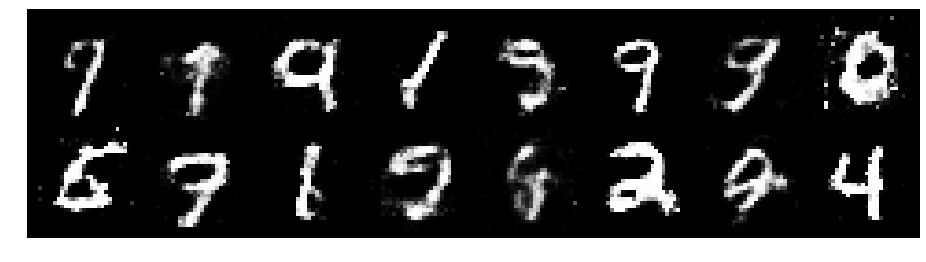

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.3364, Generator Loss: 0.8633
D(x): 0.5364, D(G(z)): 0.4615


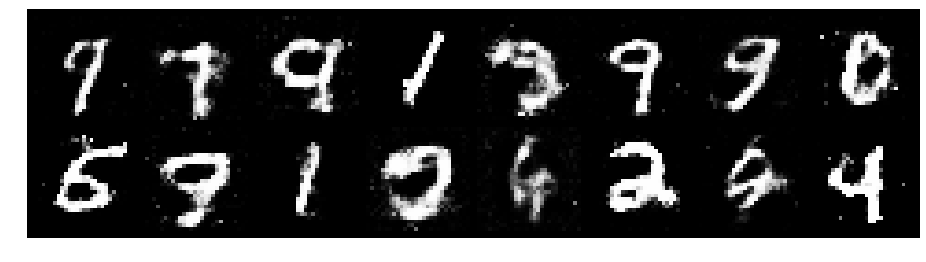

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2696, Generator Loss: 0.9139
D(x): 0.5870, D(G(z)): 0.4317


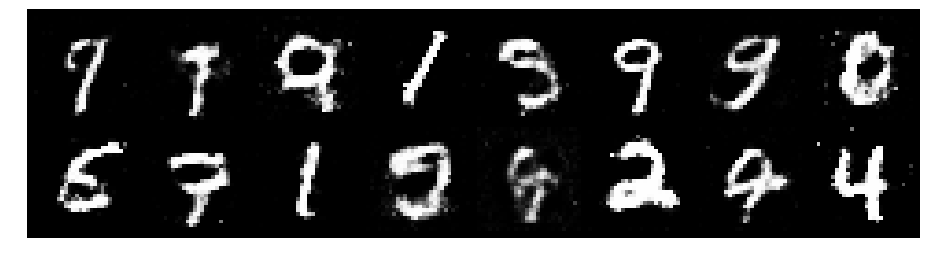

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.1841, Generator Loss: 1.2075
D(x): 0.6183, D(G(z)): 0.4164


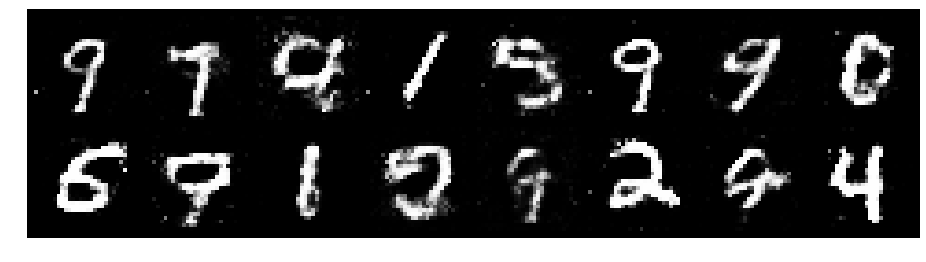

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.1438, Generator Loss: 1.1761
D(x): 0.6066, D(G(z)): 0.3776


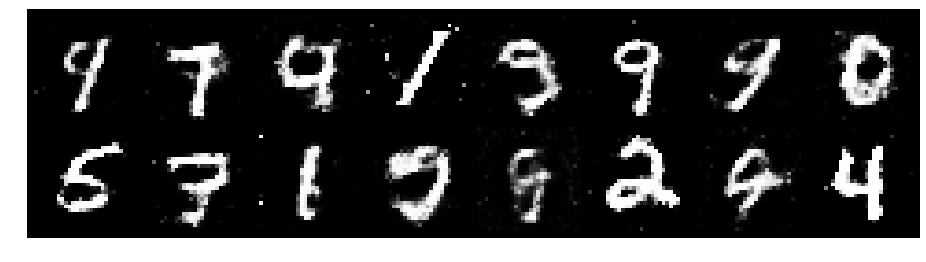

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2022, Generator Loss: 0.9190
D(x): 0.5990, D(G(z)): 0.4319


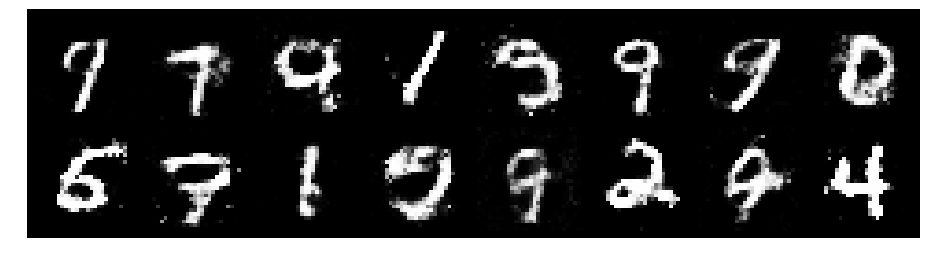

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.1502, Generator Loss: 1.0704
D(x): 0.6173, D(G(z)): 0.4161


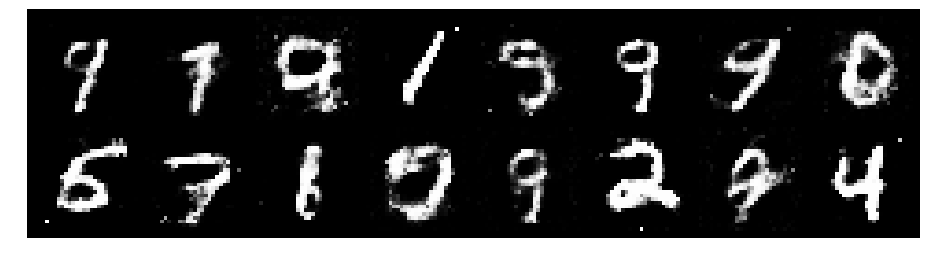

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2552, Generator Loss: 0.8928
D(x): 0.5410, D(G(z)): 0.4404


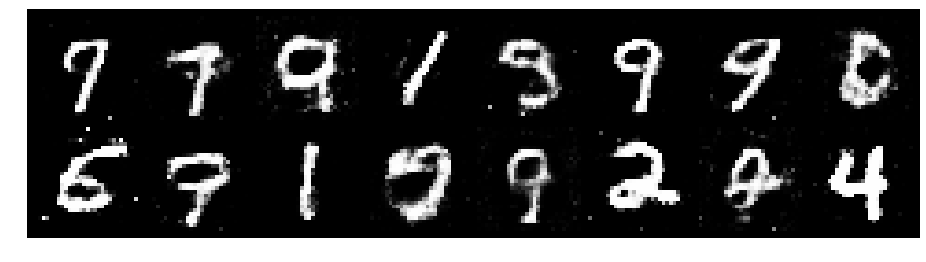

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.3283, Generator Loss: 0.9293
D(x): 0.5268, D(G(z)): 0.4036


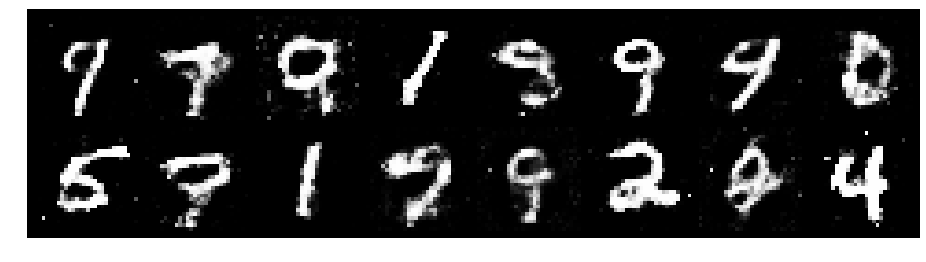

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2639, Generator Loss: 0.9290
D(x): 0.5526, D(G(z)): 0.4227


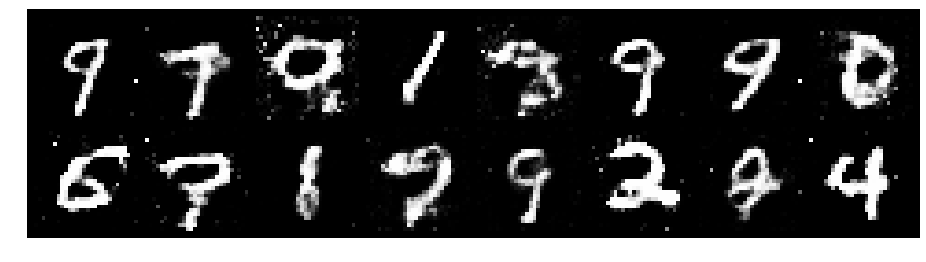

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3373, Generator Loss: 0.9070
D(x): 0.5749, D(G(z)): 0.4656


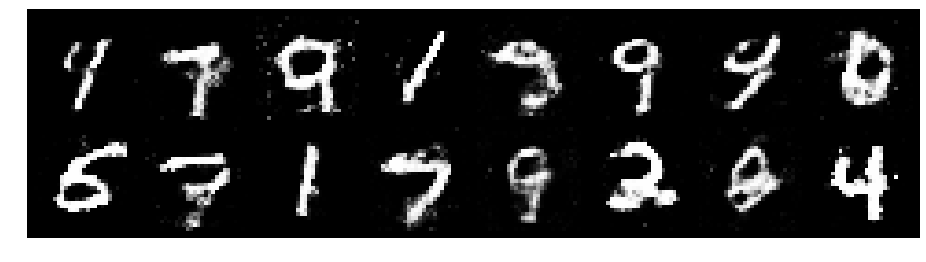

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2358, Generator Loss: 1.0064
D(x): 0.5487, D(G(z)): 0.4046


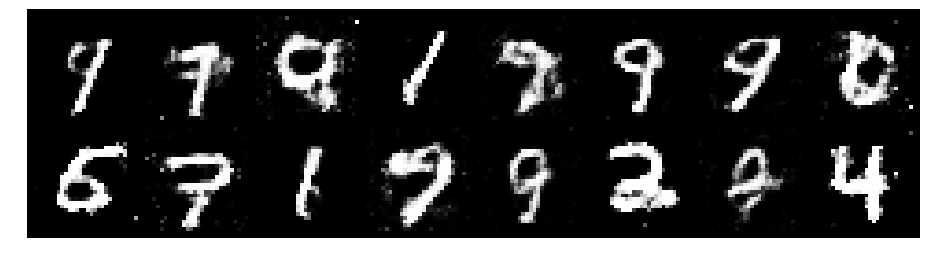

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.3071, Generator Loss: 0.8524
D(x): 0.5489, D(G(z)): 0.4590


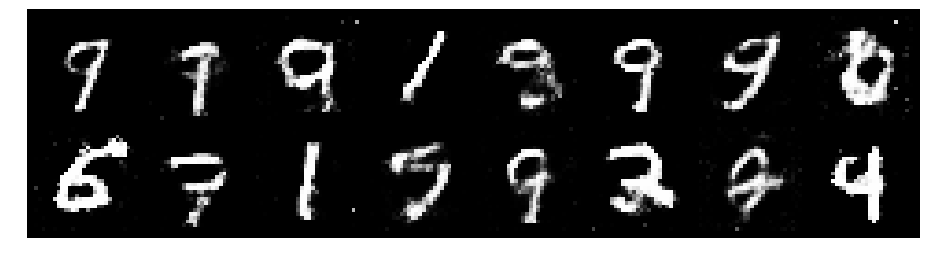

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.3478, Generator Loss: 0.7238
D(x): 0.5606, D(G(z)): 0.4864


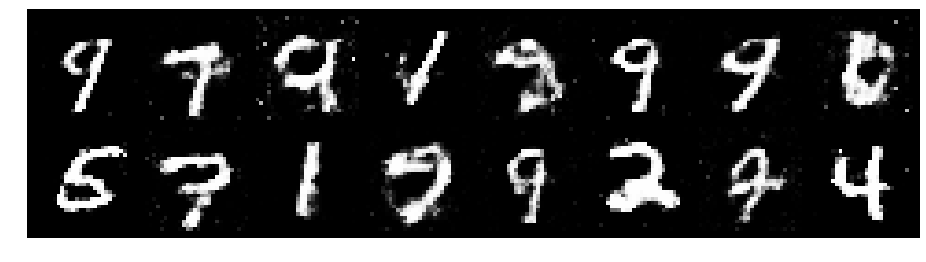

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.3392, Generator Loss: 0.8571
D(x): 0.5766, D(G(z)): 0.4782


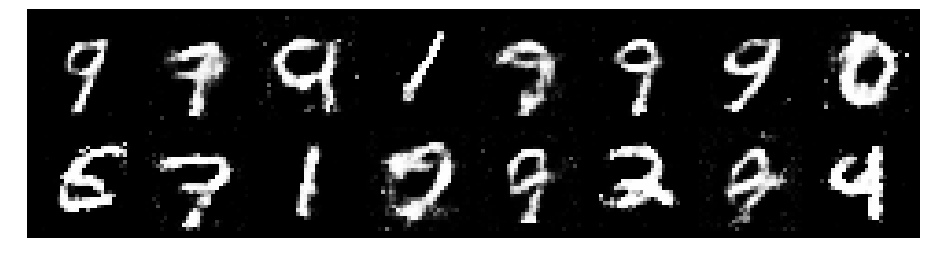

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.1661, Generator Loss: 0.8444
D(x): 0.5754, D(G(z)): 0.4181


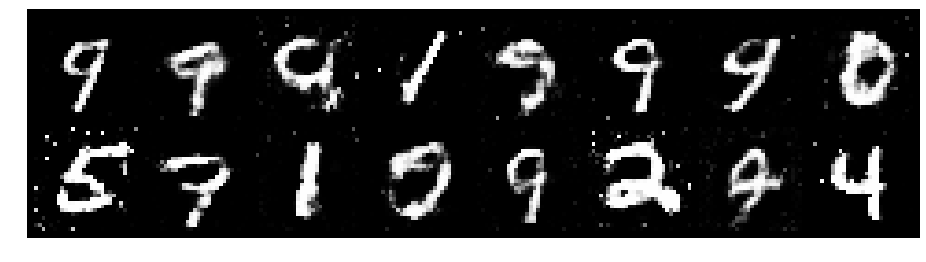

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.2406, Generator Loss: 0.9364
D(x): 0.5319, D(G(z)): 0.3969


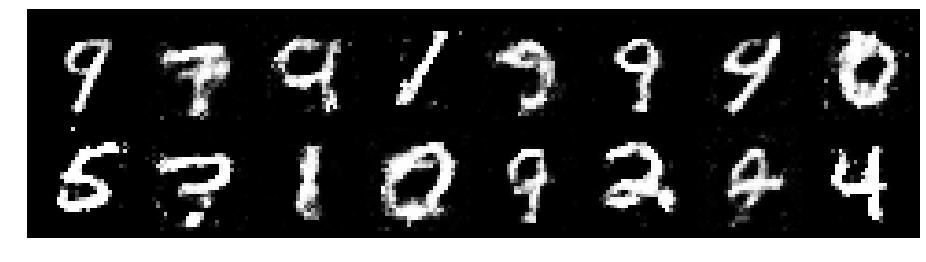

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2306, Generator Loss: 0.9461
D(x): 0.5405, D(G(z)): 0.4151


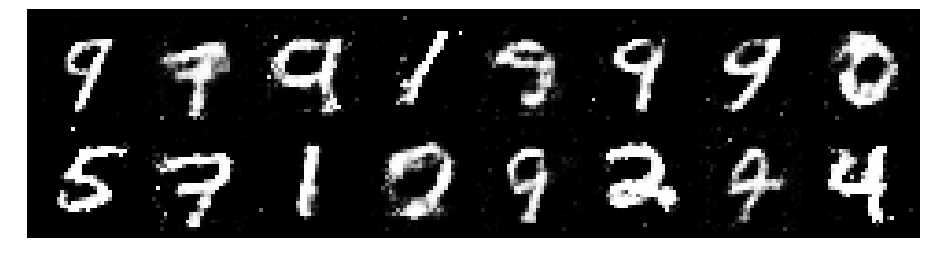

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.3720, Generator Loss: 0.9746
D(x): 0.5319, D(G(z)): 0.4361


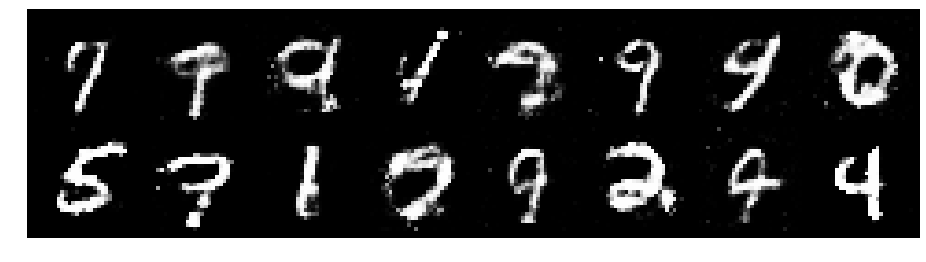

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2261, Generator Loss: 1.1840
D(x): 0.5648, D(G(z)): 0.4005


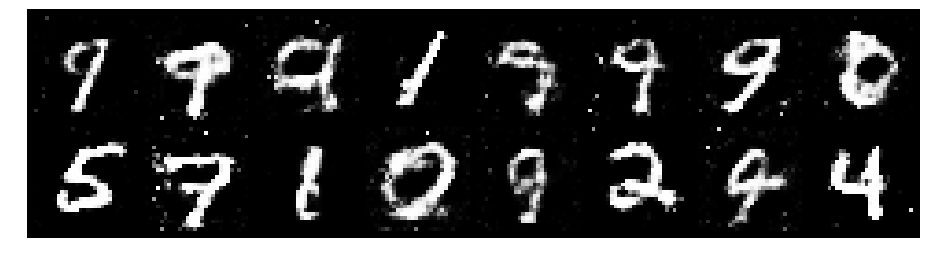

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.1922, Generator Loss: 0.8055
D(x): 0.6018, D(G(z)): 0.4530


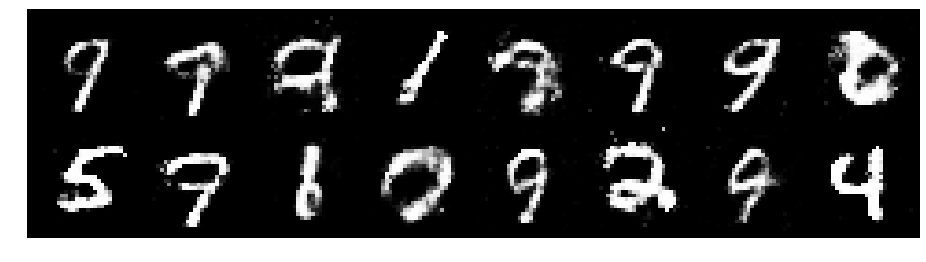

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.1748, Generator Loss: 0.9215
D(x): 0.5809, D(G(z)): 0.4175


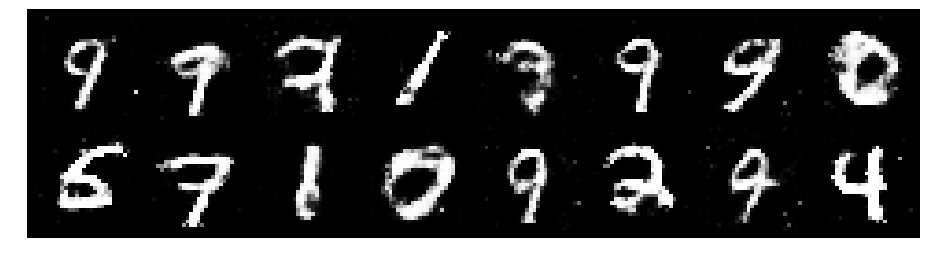

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2979, Generator Loss: 0.8504
D(x): 0.5661, D(G(z)): 0.4690


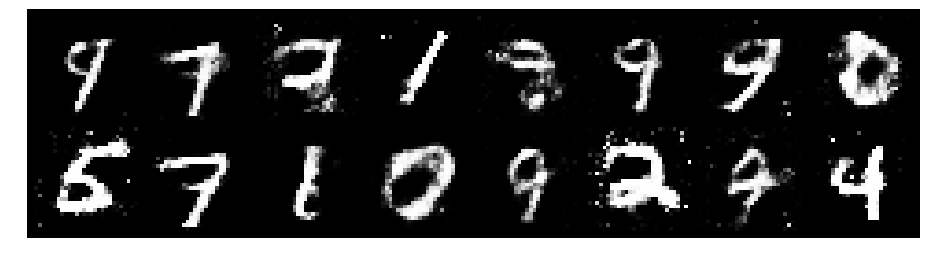

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.3284, Generator Loss: 0.8879
D(x): 0.5397, D(G(z)): 0.4433


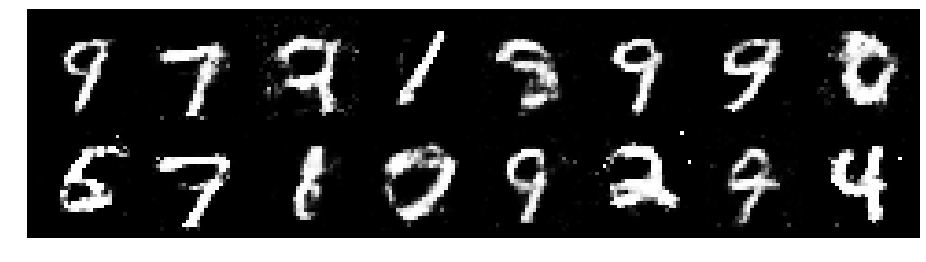

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.4146, Generator Loss: 0.9840
D(x): 0.5569, D(G(z)): 0.4467


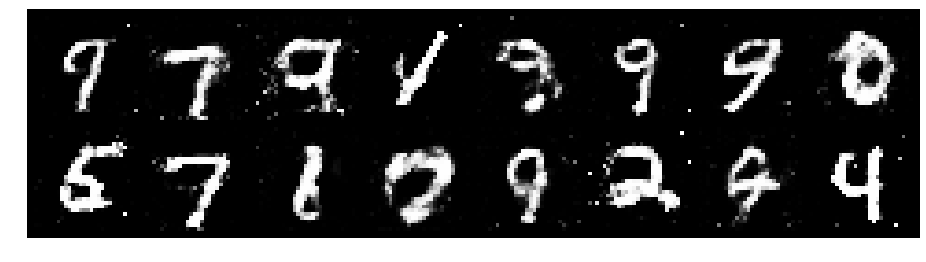

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.1373, Generator Loss: 1.0955
D(x): 0.5886, D(G(z)): 0.4009


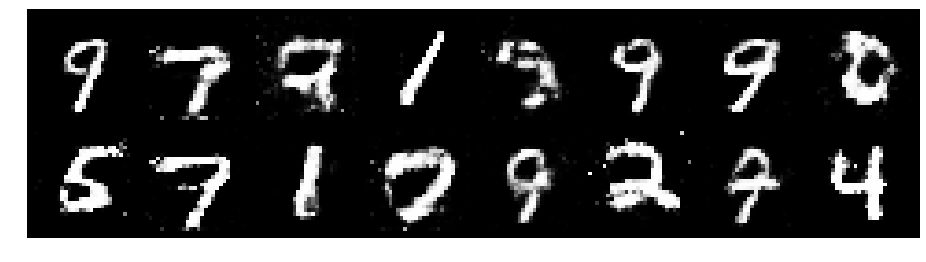

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.1486, Generator Loss: 1.0783
D(x): 0.5462, D(G(z)): 0.3625


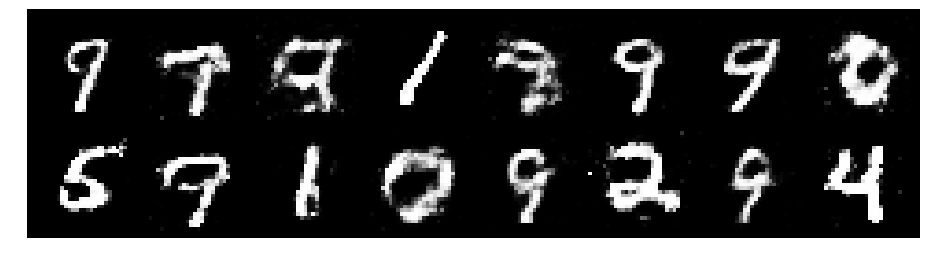

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2788, Generator Loss: 0.8067
D(x): 0.5616, D(G(z)): 0.4758


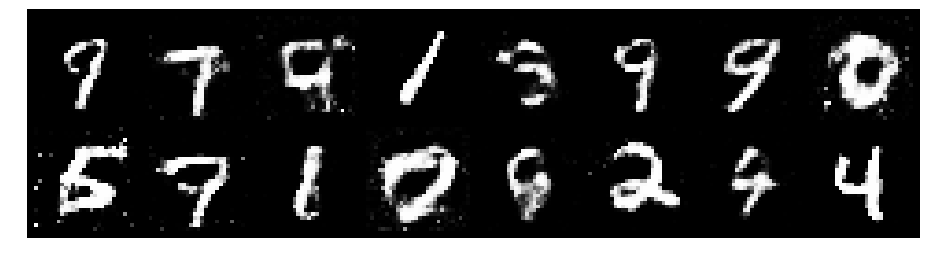

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2299, Generator Loss: 0.9361
D(x): 0.5795, D(G(z)): 0.4421


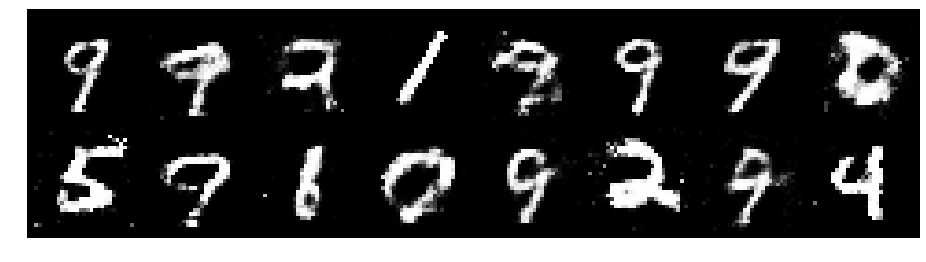

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2209, Generator Loss: 0.9424
D(x): 0.5874, D(G(z)): 0.4339


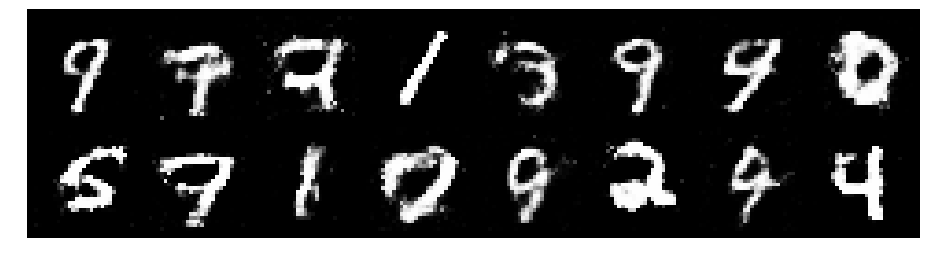

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.1575, Generator Loss: 0.8547
D(x): 0.6049, D(G(z)): 0.4305


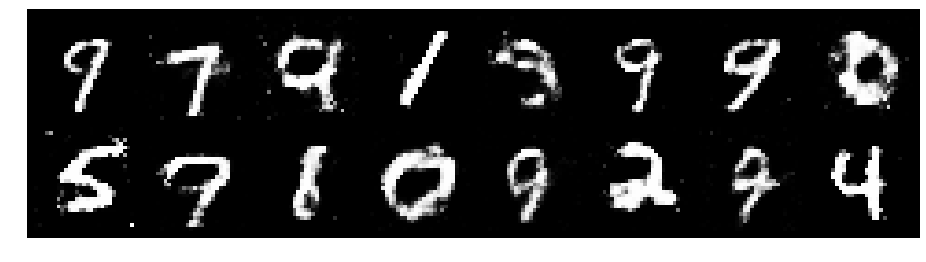

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2217, Generator Loss: 1.0458
D(x): 0.5476, D(G(z)): 0.4079


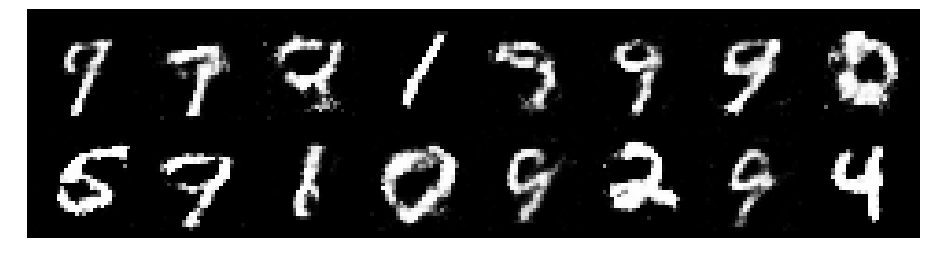

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2153, Generator Loss: 0.9275
D(x): 0.5474, D(G(z)): 0.4150


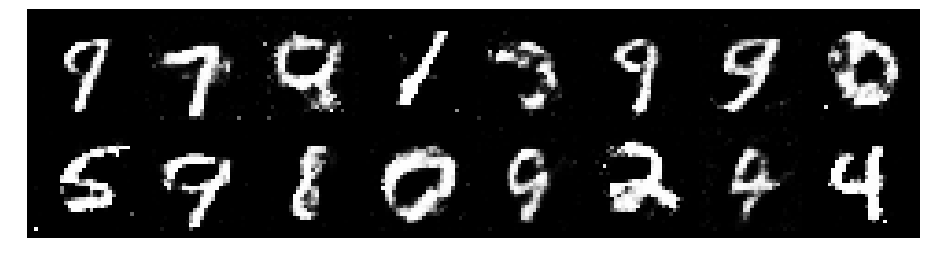

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.1808, Generator Loss: 0.9912
D(x): 0.5933, D(G(z)): 0.4192


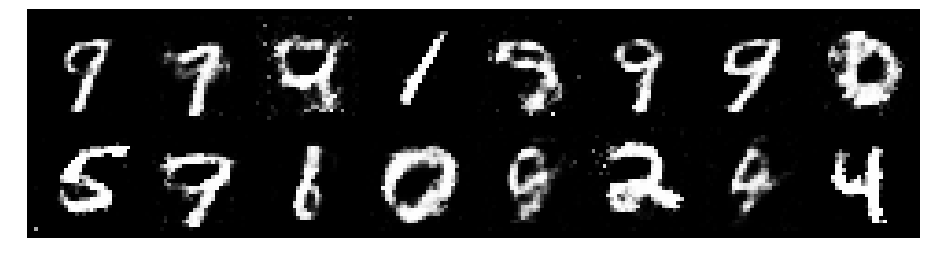

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2308, Generator Loss: 0.9487
D(x): 0.5944, D(G(z)): 0.4299


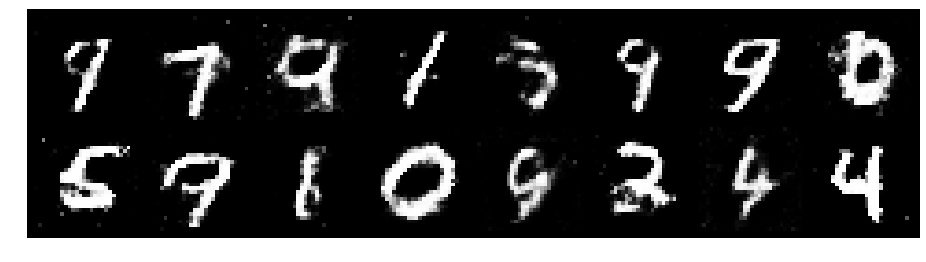

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.3332, Generator Loss: 0.8165
D(x): 0.5071, D(G(z)): 0.4439


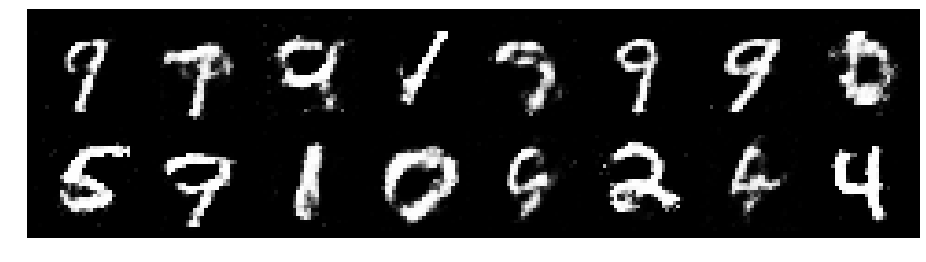

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.3502, Generator Loss: 0.7261
D(x): 0.5635, D(G(z)): 0.4925


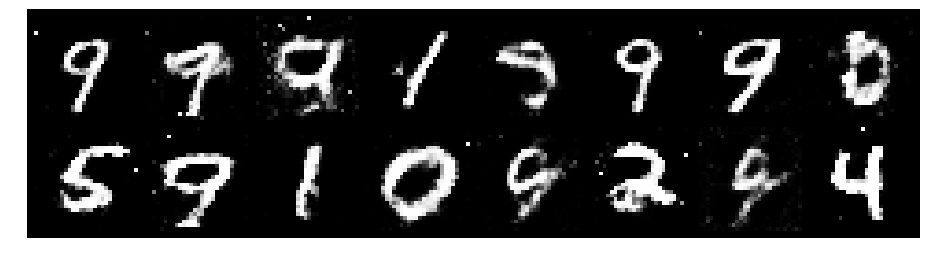

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.3354, Generator Loss: 0.9077
D(x): 0.5504, D(G(z)): 0.4460


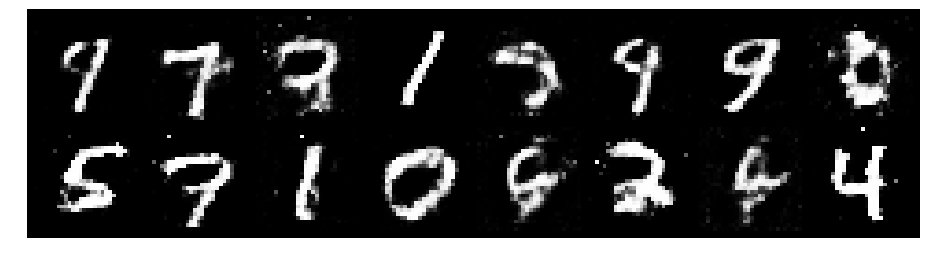

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2693, Generator Loss: 1.0456
D(x): 0.5487, D(G(z)): 0.4095


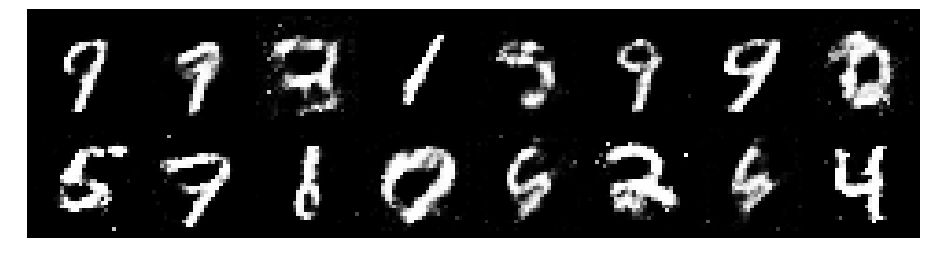

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.2588, Generator Loss: 0.8270
D(x): 0.5945, D(G(z)): 0.4747


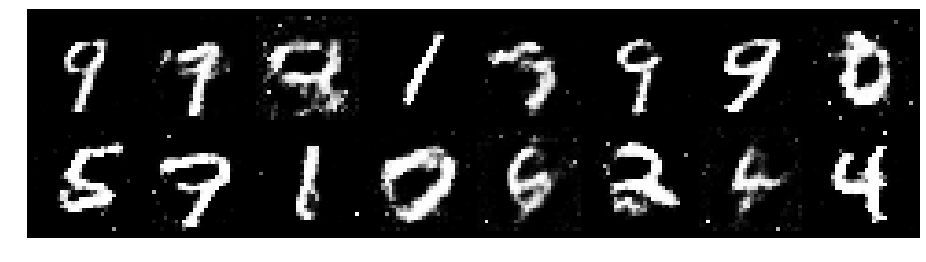

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2040, Generator Loss: 1.0478
D(x): 0.5572, D(G(z)): 0.4213


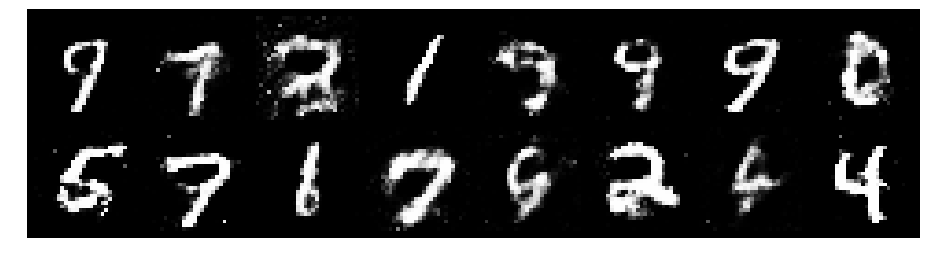

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2296, Generator Loss: 1.0275
D(x): 0.5459, D(G(z)): 0.4096


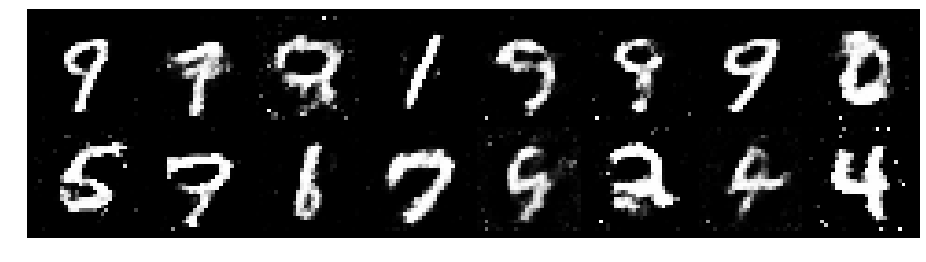

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.3072, Generator Loss: 0.9726
D(x): 0.5522, D(G(z)): 0.4450


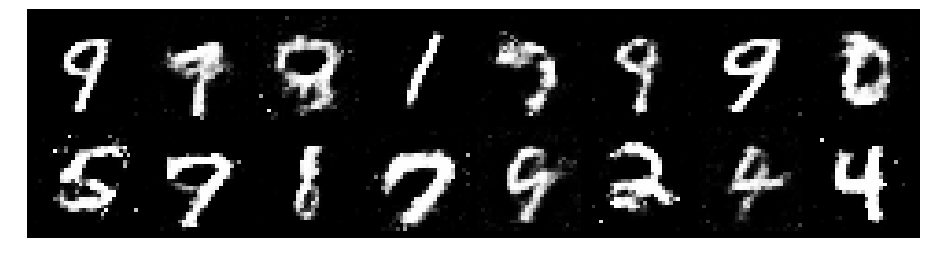

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8550
D(x): 0.5479, D(G(z)): 0.4481


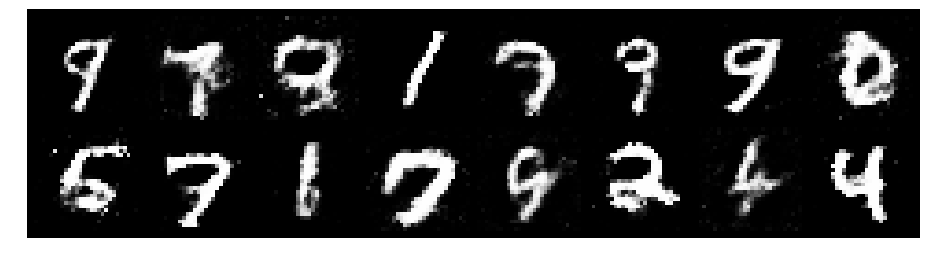

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3119, Generator Loss: 0.8906
D(x): 0.5496, D(G(z)): 0.4504


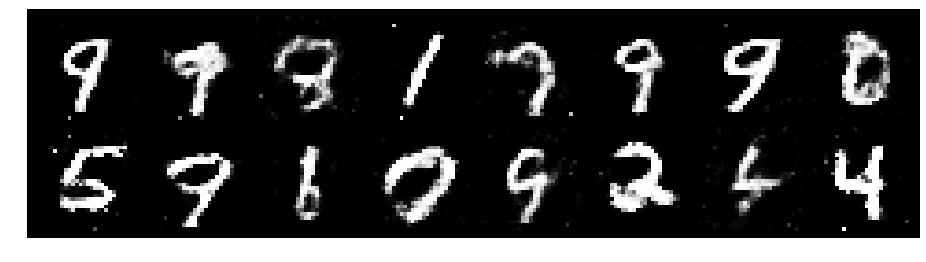

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.2241, Generator Loss: 0.9167
D(x): 0.5857, D(G(z)): 0.4343


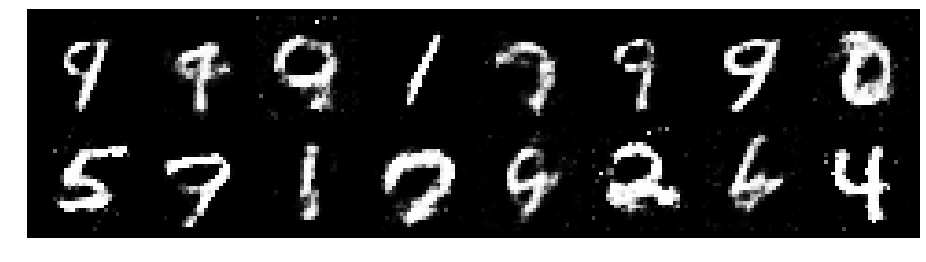

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.3351, Generator Loss: 0.8722
D(x): 0.5228, D(G(z)): 0.4510


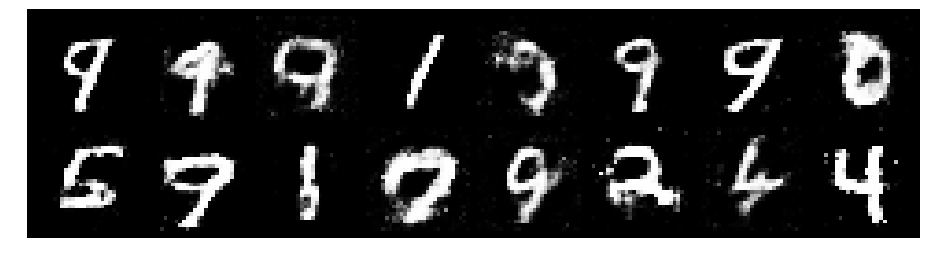

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2605, Generator Loss: 0.9007
D(x): 0.5550, D(G(z)): 0.4277


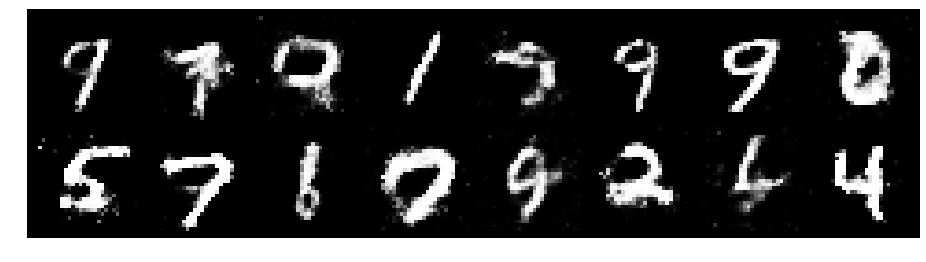

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.3565, Generator Loss: 0.8891
D(x): 0.5771, D(G(z)): 0.4663


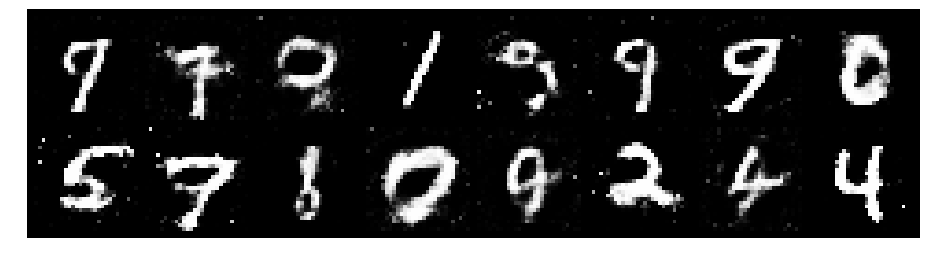

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.2759, Generator Loss: 0.9214
D(x): 0.6106, D(G(z)): 0.4663


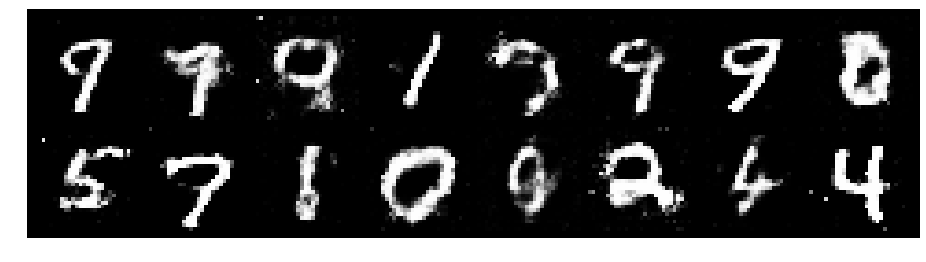

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.1694, Generator Loss: 0.9798
D(x): 0.6057, D(G(z)): 0.4332


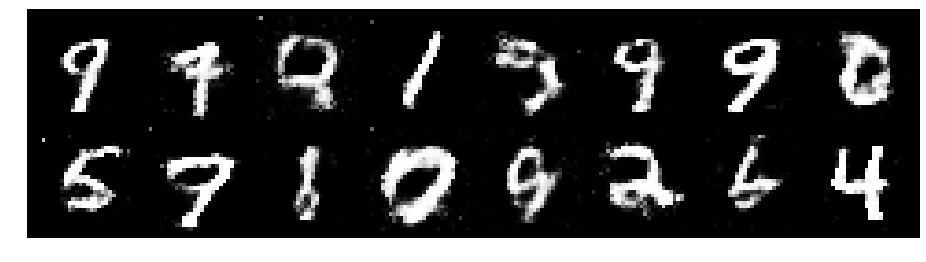

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.3089, Generator Loss: 0.9476
D(x): 0.5466, D(G(z)): 0.4624


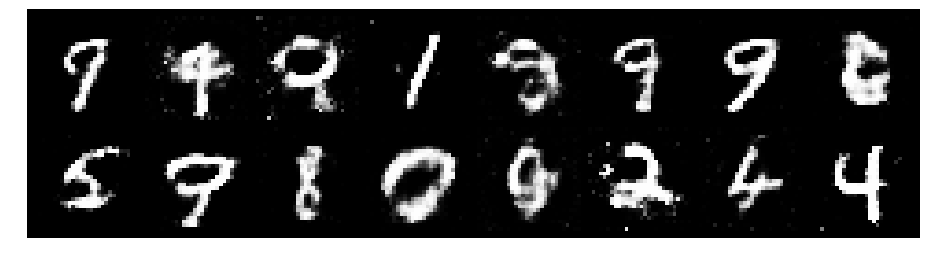

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.3207, Generator Loss: 0.8352
D(x): 0.5371, D(G(z)): 0.4638


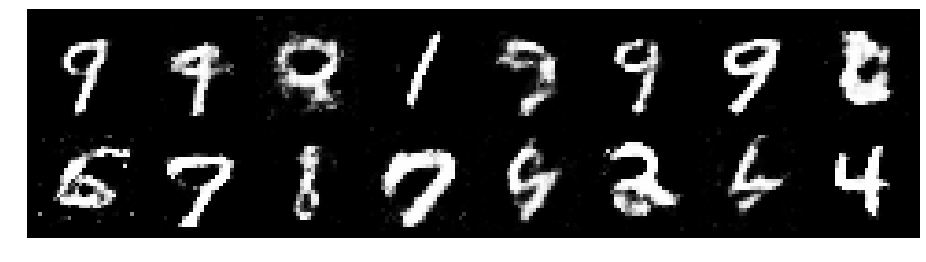

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2224, Generator Loss: 0.9934
D(x): 0.5416, D(G(z)): 0.3911


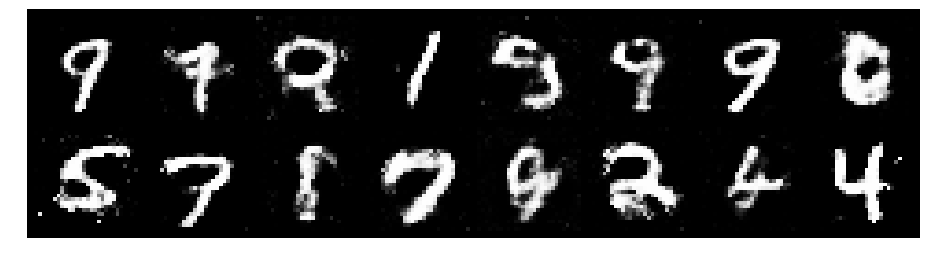

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2401, Generator Loss: 0.8686
D(x): 0.5768, D(G(z)): 0.4527


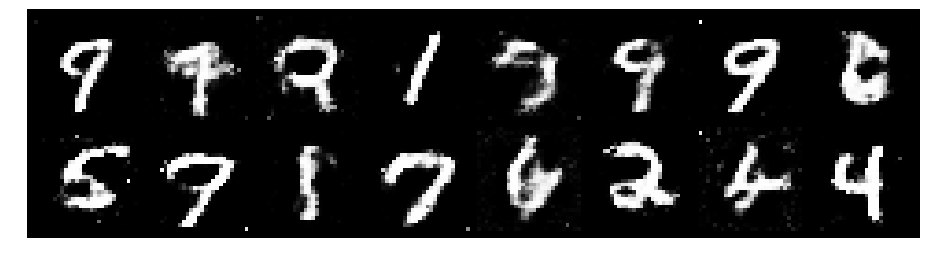

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.3741, Generator Loss: 0.8728
D(x): 0.5037, D(G(z)): 0.4356


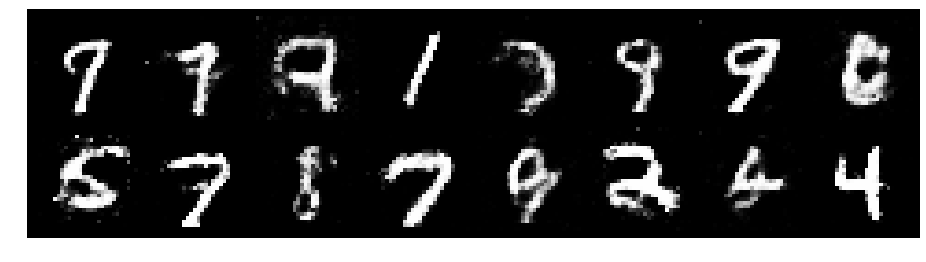

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.3053, Generator Loss: 0.8068
D(x): 0.5728, D(G(z)): 0.4788


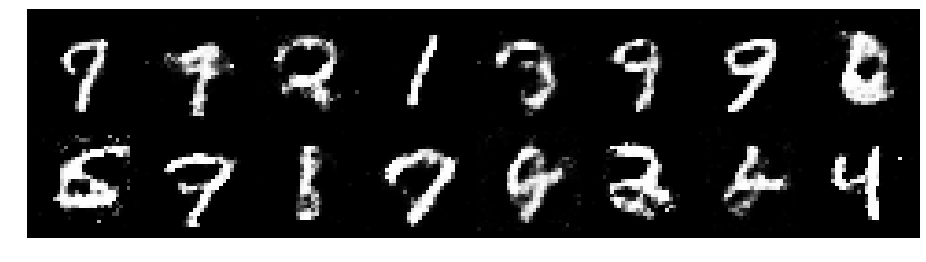

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2896, Generator Loss: 0.8354
D(x): 0.5354, D(G(z)): 0.4600


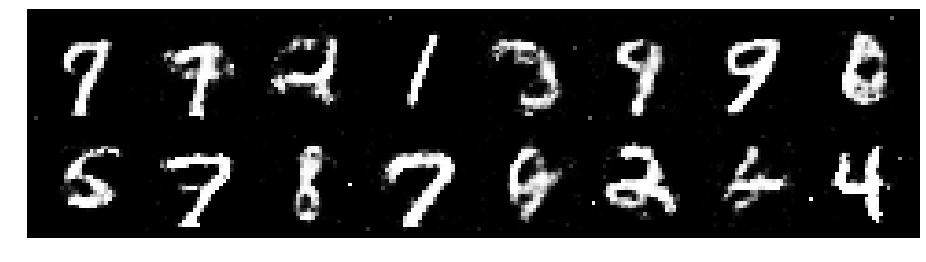

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2919, Generator Loss: 0.8838
D(x): 0.5496, D(G(z)): 0.4394


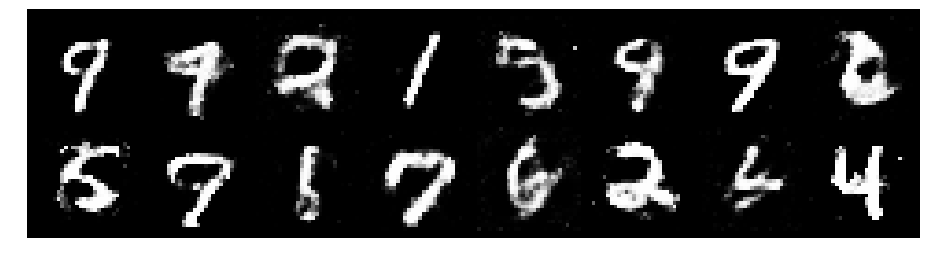

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.3228, Generator Loss: 0.7646
D(x): 0.5581, D(G(z)): 0.4805


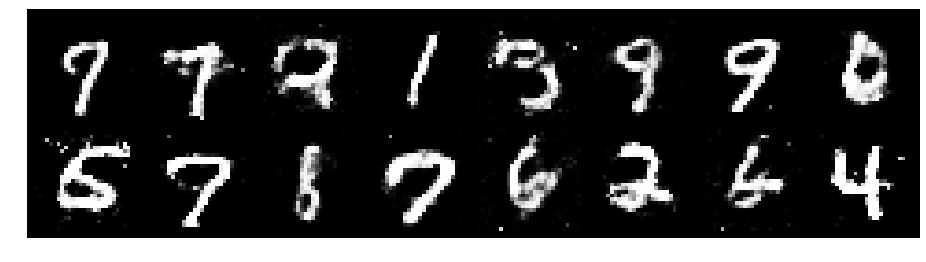

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.3278, Generator Loss: 0.7879
D(x): 0.5332, D(G(z)): 0.4567


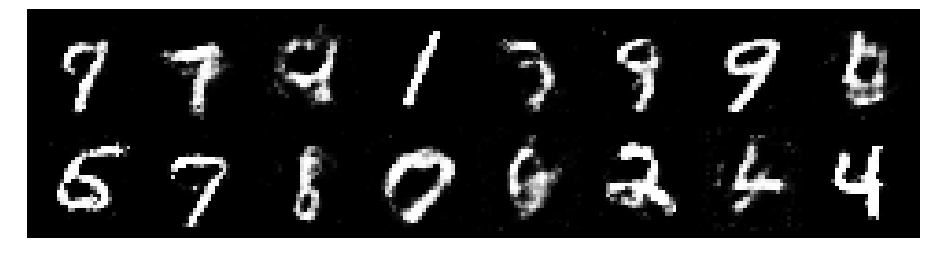

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.3543, Generator Loss: 0.8015
D(x): 0.5395, D(G(z)): 0.4708


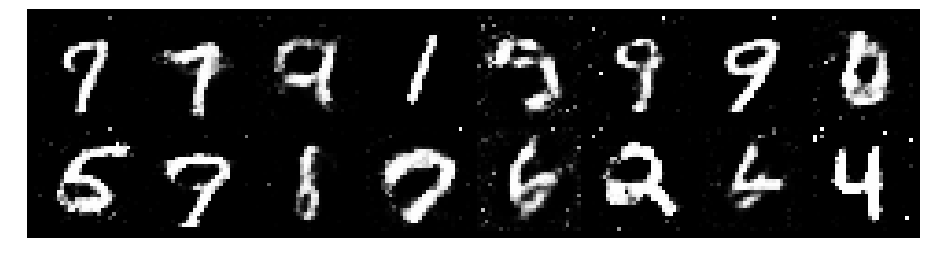

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.3735, Generator Loss: 0.9479
D(x): 0.5376, D(G(z)): 0.4410


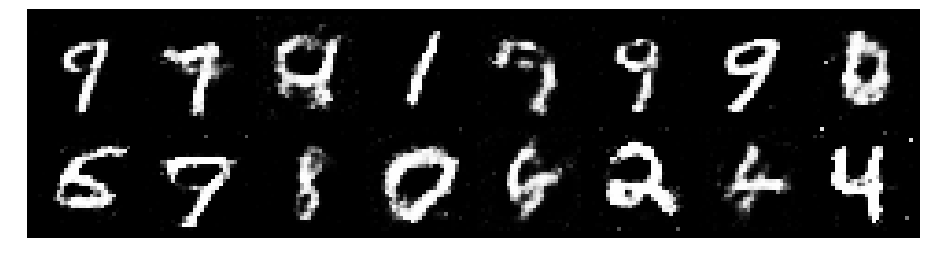

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.3486, Generator Loss: 0.7657
D(x): 0.5374, D(G(z)): 0.4769


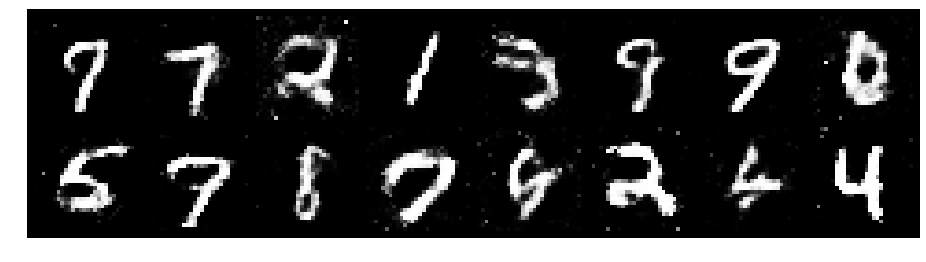

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.3936, Generator Loss: 0.7233
D(x): 0.5294, D(G(z)): 0.4847


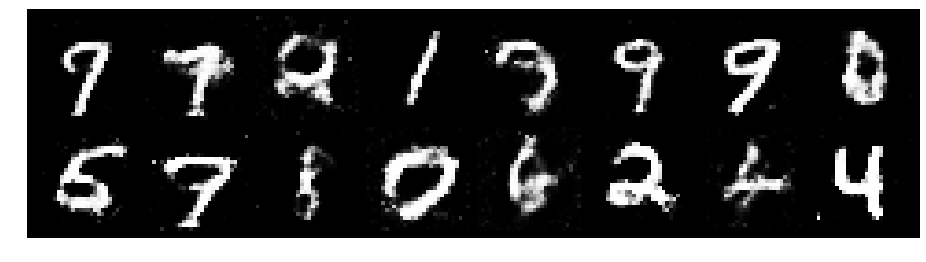

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2955, Generator Loss: 0.7657
D(x): 0.5512, D(G(z)): 0.4652


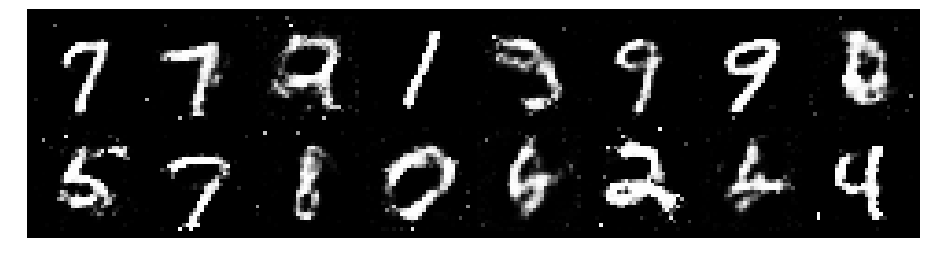

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.3001, Generator Loss: 0.8525
D(x): 0.5428, D(G(z)): 0.4487


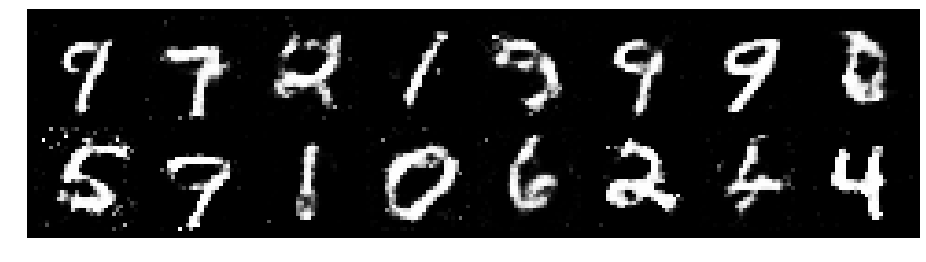

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2558, Generator Loss: 0.8668
D(x): 0.5926, D(G(z)): 0.4600


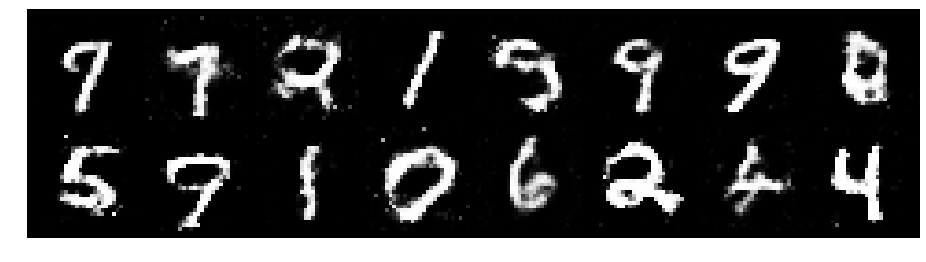

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.3477, Generator Loss: 0.8810
D(x): 0.5636, D(G(z)): 0.4611


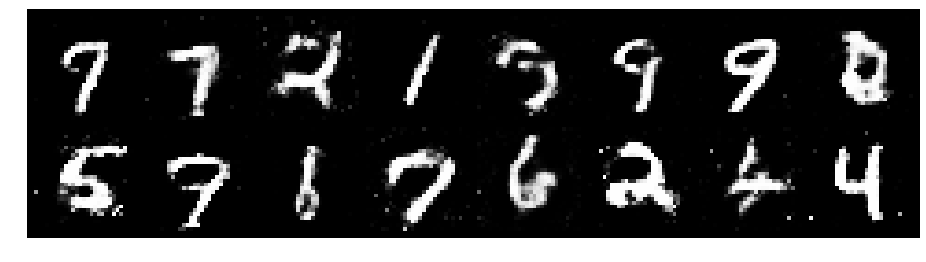

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2273, Generator Loss: 0.9749
D(x): 0.6123, D(G(z)): 0.4306


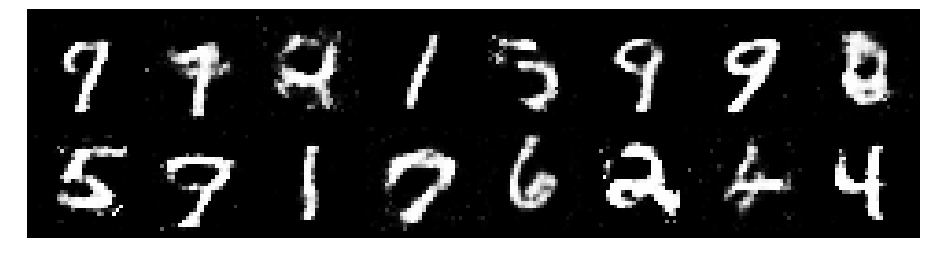

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3973, Generator Loss: 1.1607
D(x): 0.5134, D(G(z)): 0.4010


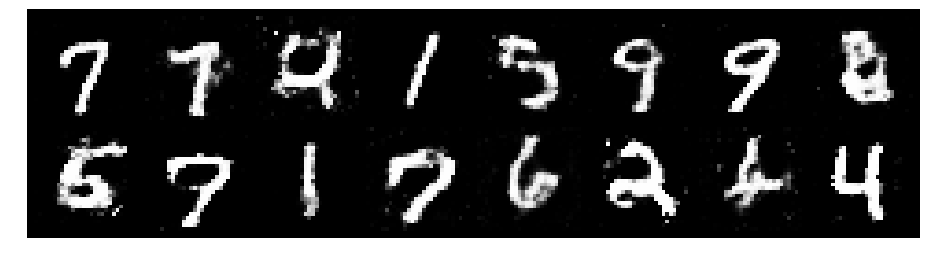

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.3039, Generator Loss: 0.8657
D(x): 0.5999, D(G(z)): 0.4802


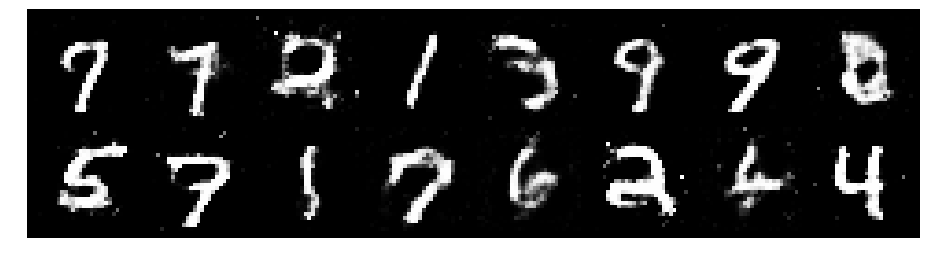

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2032, Generator Loss: 1.0806
D(x): 0.5597, D(G(z)): 0.3956


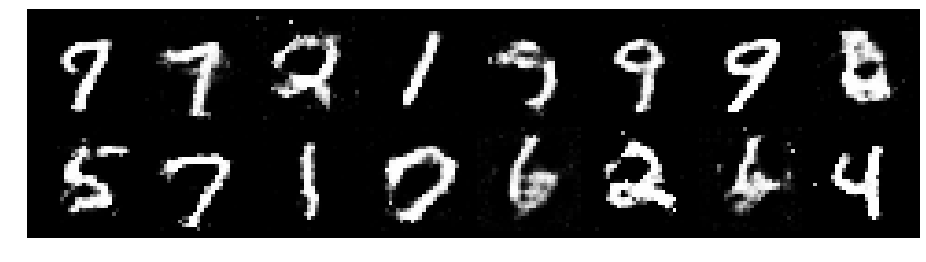

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.1929, Generator Loss: 0.9852
D(x): 0.5845, D(G(z)): 0.4012


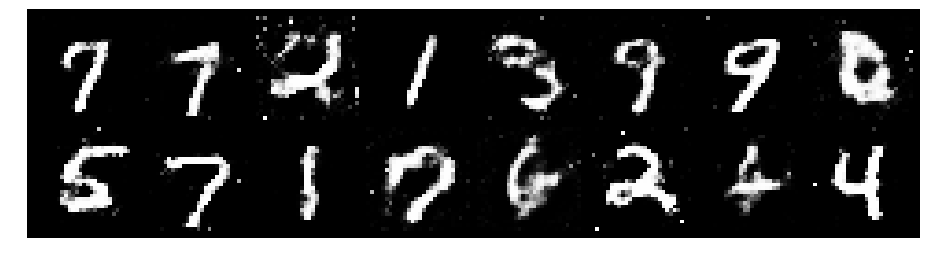

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2111, Generator Loss: 0.9498
D(x): 0.5431, D(G(z)): 0.4055


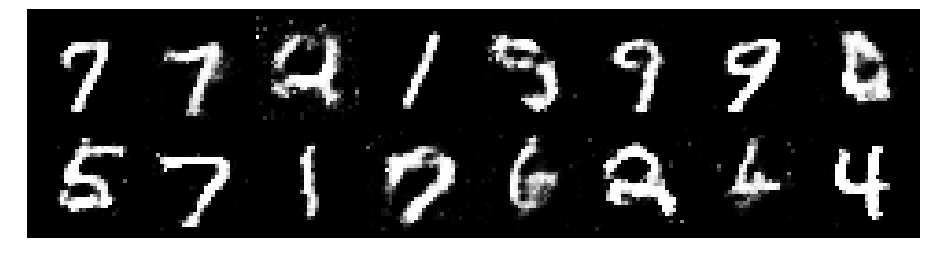

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.1769, Generator Loss: 1.1341
D(x): 0.5389, D(G(z)): 0.3644


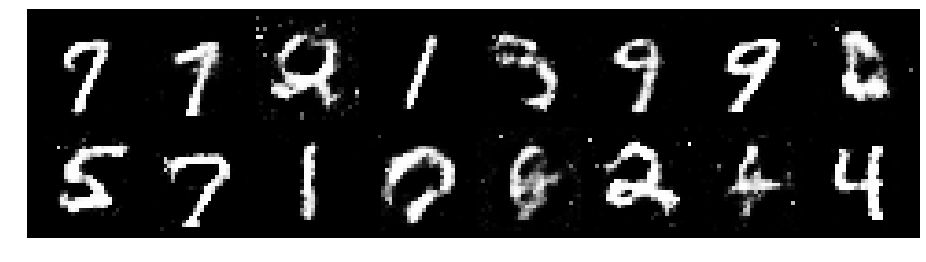

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.1859, Generator Loss: 1.1541
D(x): 0.5395, D(G(z)): 0.3660


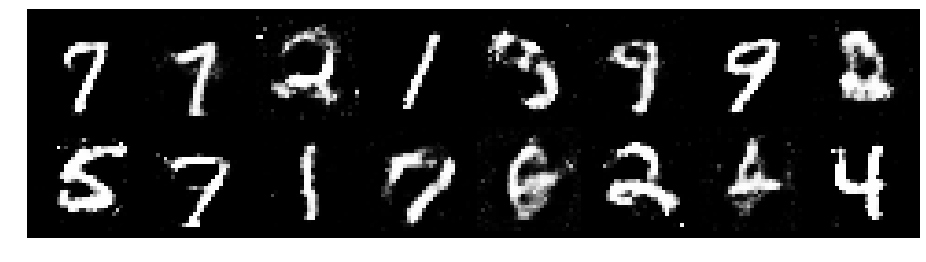

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2354, Generator Loss: 1.0799
D(x): 0.5421, D(G(z)): 0.3964


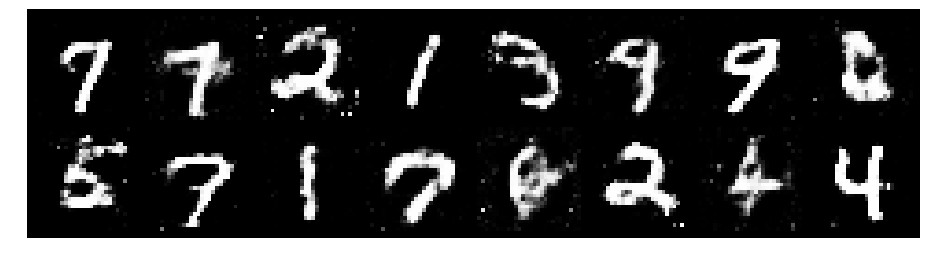

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2452, Generator Loss: 1.0768
D(x): 0.5463, D(G(z)): 0.4195


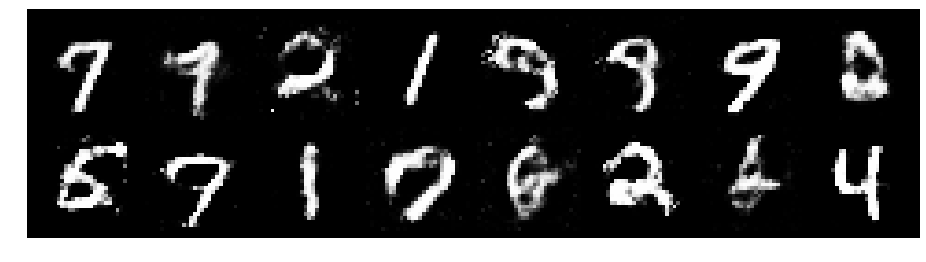

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2210, Generator Loss: 0.8997
D(x): 0.5663, D(G(z)): 0.4408


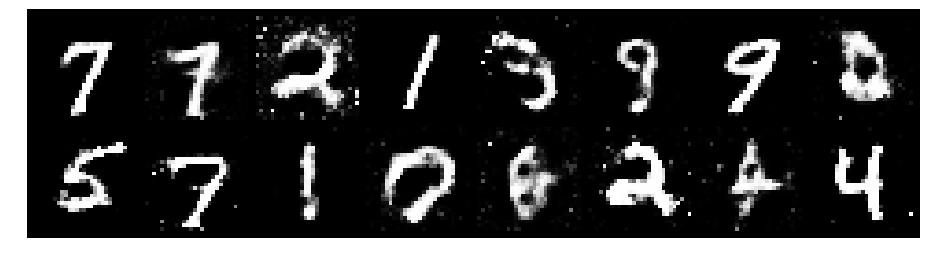

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2457, Generator Loss: 0.8633
D(x): 0.5590, D(G(z)): 0.4374


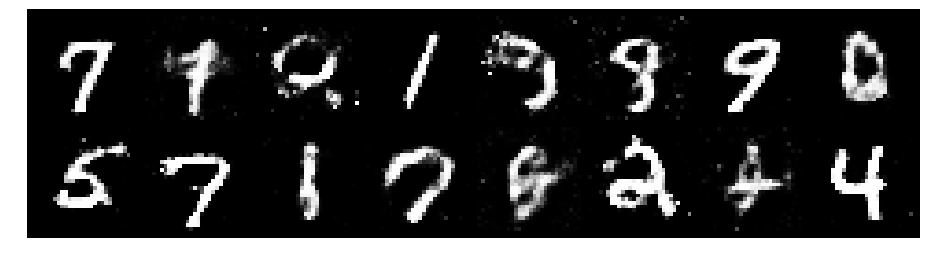

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.1334, Generator Loss: 0.9184
D(x): 0.5678, D(G(z)): 0.3860


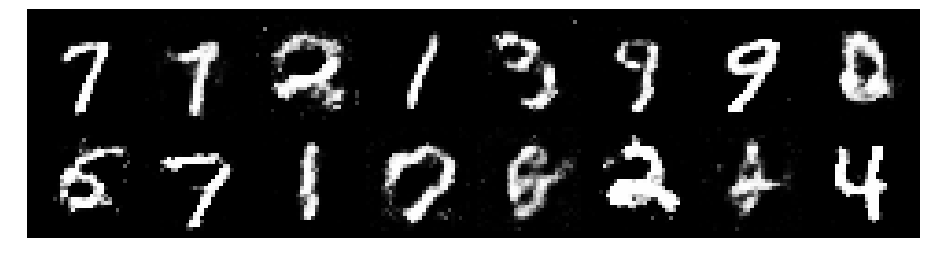

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2495, Generator Loss: 0.8618
D(x): 0.5411, D(G(z)): 0.4213


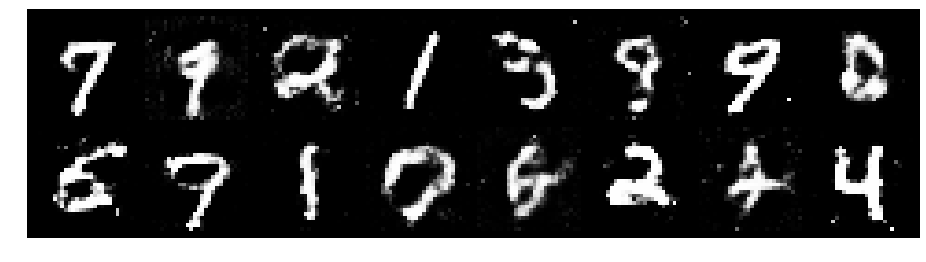

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2829, Generator Loss: 0.9001
D(x): 0.5457, D(G(z)): 0.4527


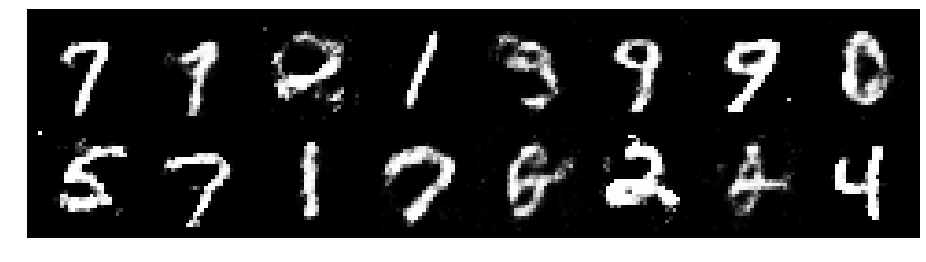

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2288, Generator Loss: 0.8738
D(x): 0.5682, D(G(z)): 0.4267


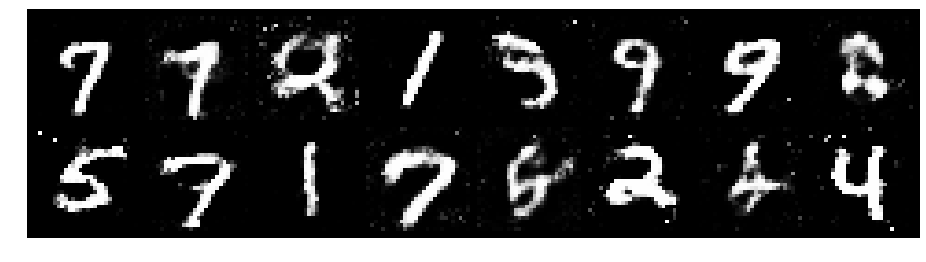

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.2512, Generator Loss: 0.8237
D(x): 0.5445, D(G(z)): 0.4450


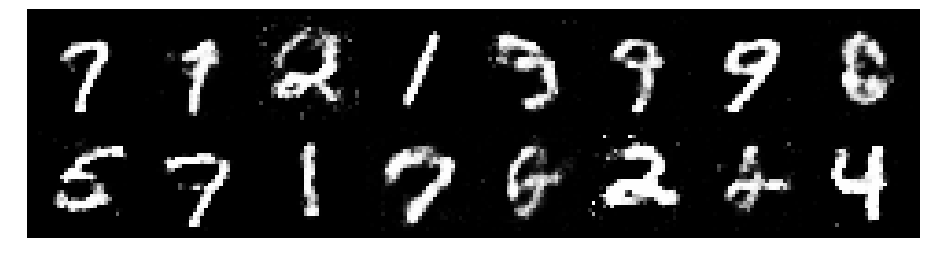

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2315, Generator Loss: 0.8913
D(x): 0.5508, D(G(z)): 0.4208


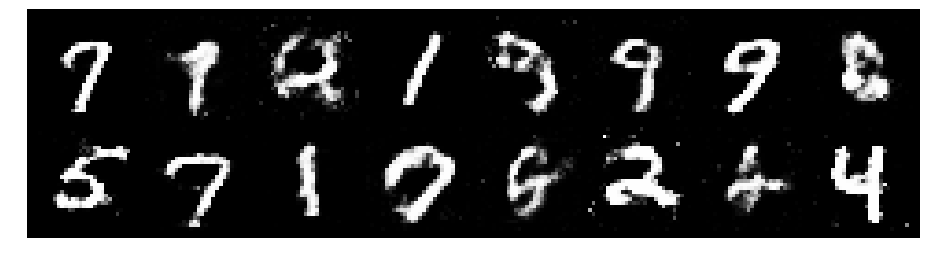

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2018, Generator Loss: 0.9227
D(x): 0.5718, D(G(z)): 0.4337


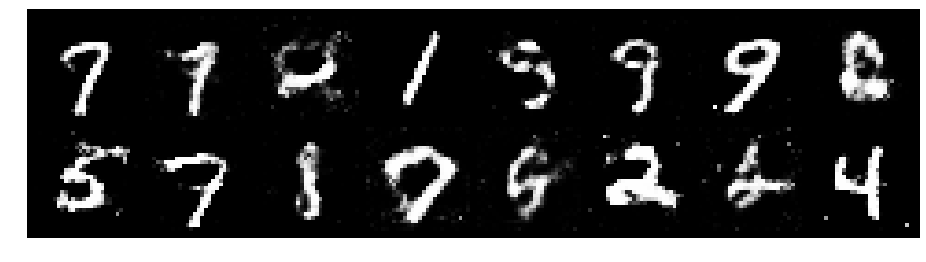

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.2170, Generator Loss: 0.9055
D(x): 0.5573, D(G(z)): 0.4135


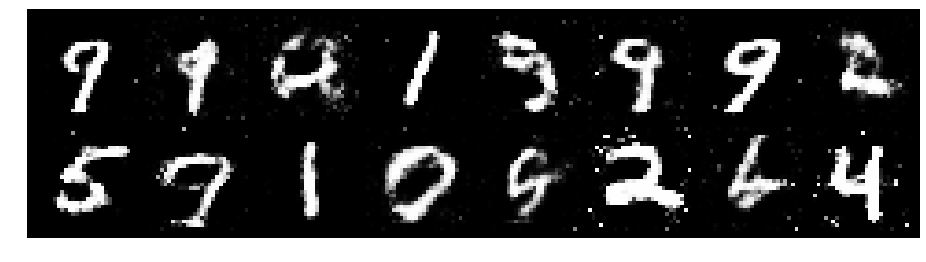

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.1930, Generator Loss: 0.9075
D(x): 0.5677, D(G(z)): 0.4294


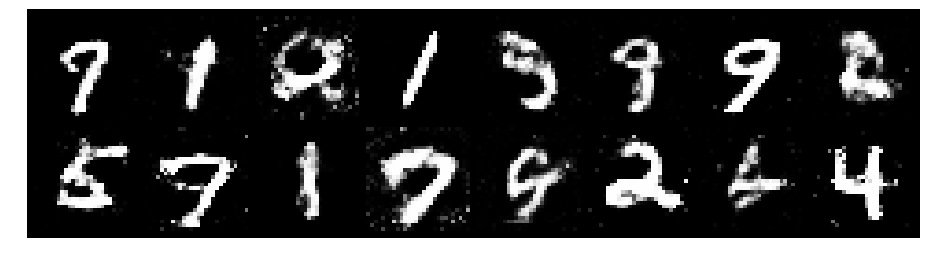

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.3528, Generator Loss: 0.8660
D(x): 0.5261, D(G(z)): 0.4678


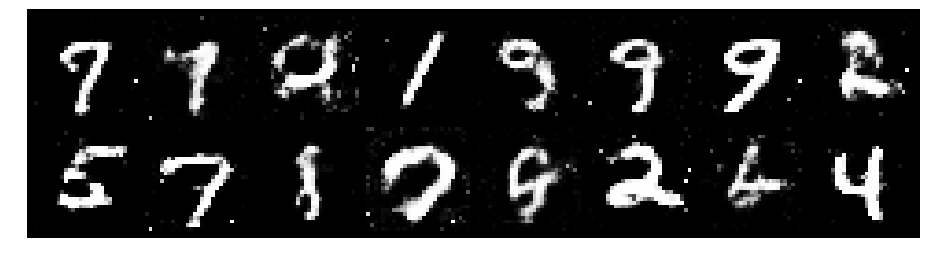

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.2199, Generator Loss: 0.8982
D(x): 0.5719, D(G(z)): 0.4262


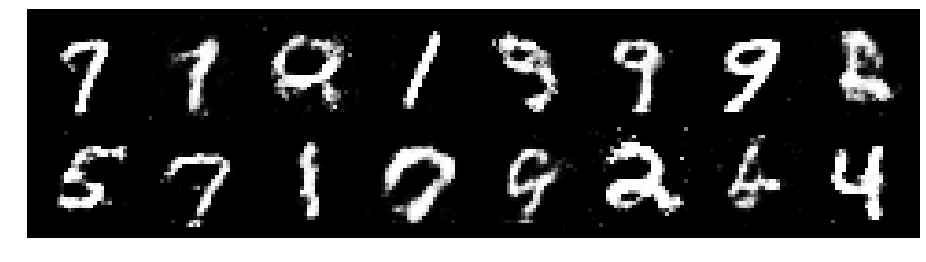

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.3484, Generator Loss: 0.8983
D(x): 0.5379, D(G(z)): 0.4646


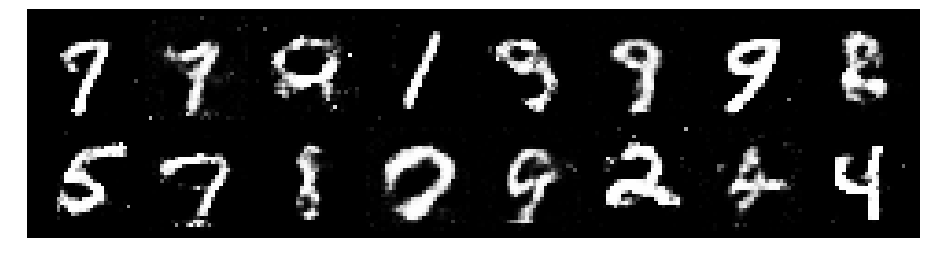

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.3634, Generator Loss: 0.8022
D(x): 0.5421, D(G(z)): 0.4528


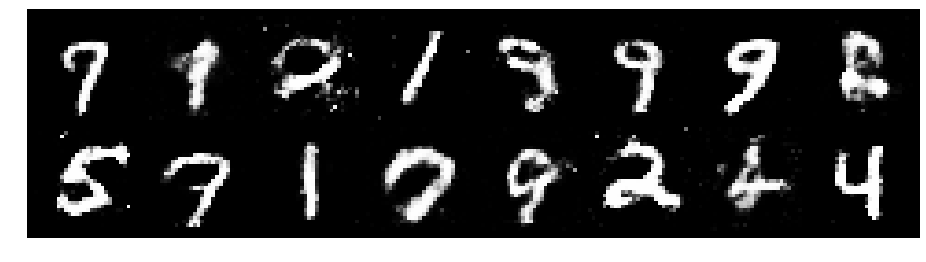

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2018, Generator Loss: 1.0238
D(x): 0.5549, D(G(z)): 0.3897


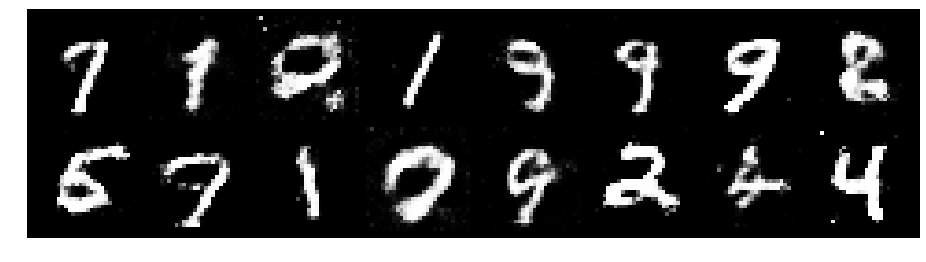

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2910, Generator Loss: 0.9125
D(x): 0.5515, D(G(z)): 0.4549


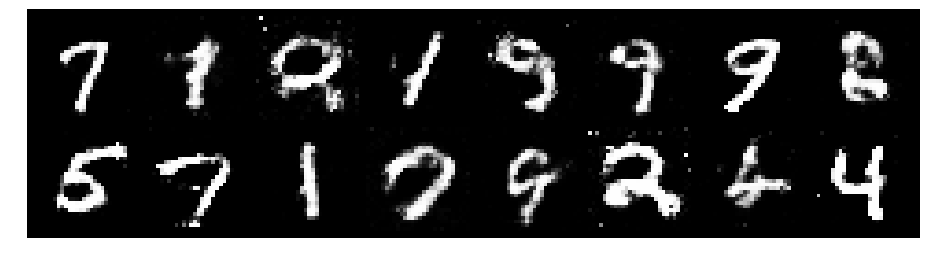

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2030, Generator Loss: 0.9462
D(x): 0.5597, D(G(z)): 0.4196


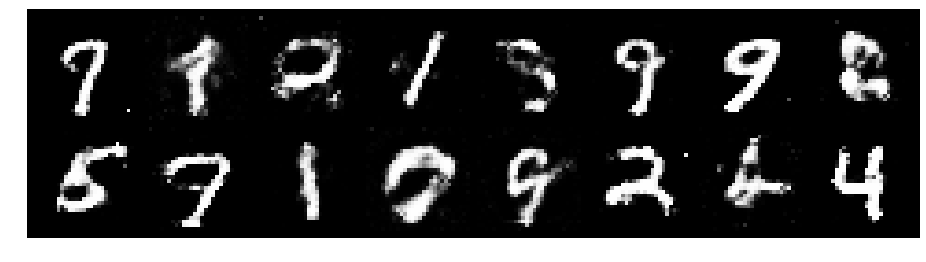

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.3475, Generator Loss: 0.7300
D(x): 0.5506, D(G(z)): 0.4910


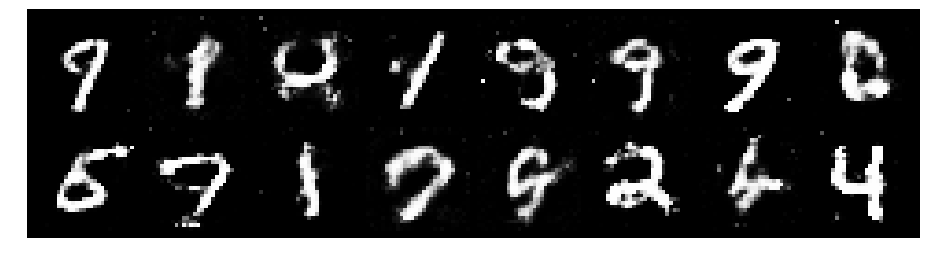

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.3700, Generator Loss: 0.8197
D(x): 0.5087, D(G(z)): 0.4571


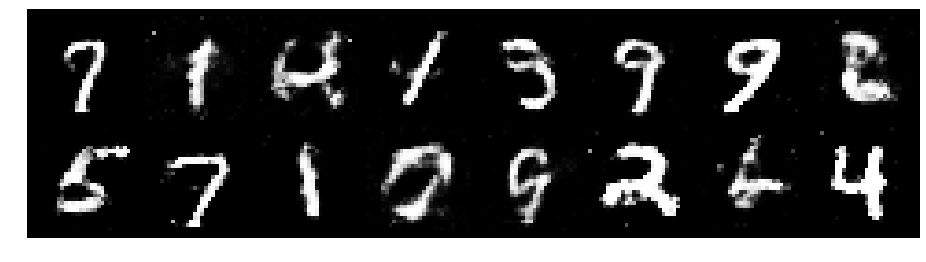

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.4156, Generator Loss: 0.9792
D(x): 0.5396, D(G(z)): 0.4810


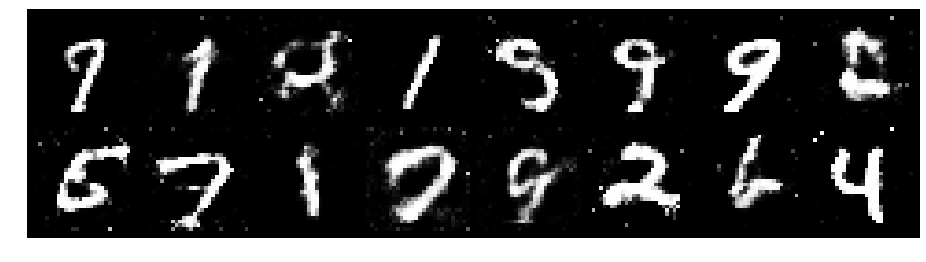

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.1872, Generator Loss: 0.9626
D(x): 0.5876, D(G(z)): 0.4293


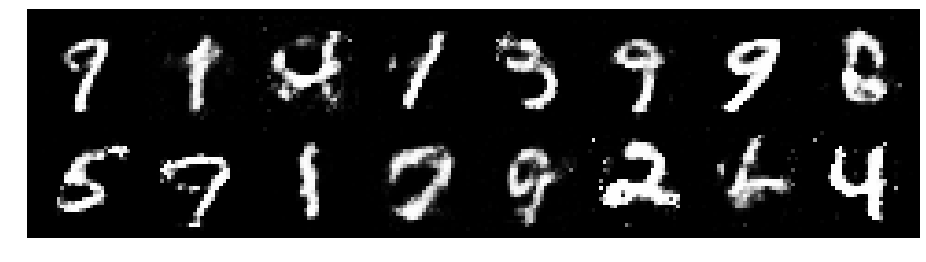

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.1836, Generator Loss: 1.0400
D(x): 0.5638, D(G(z)): 0.3974


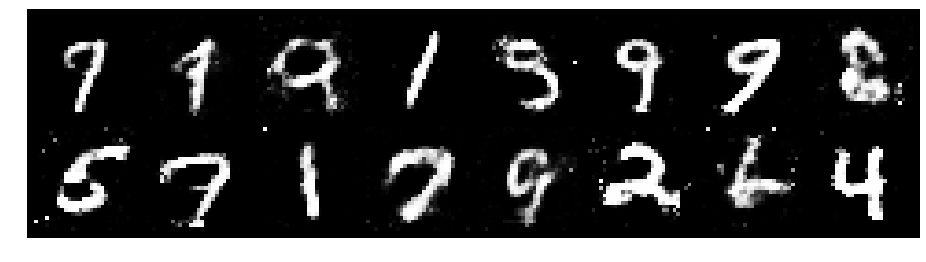

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.3334, Generator Loss: 0.9107
D(x): 0.5248, D(G(z)): 0.4506


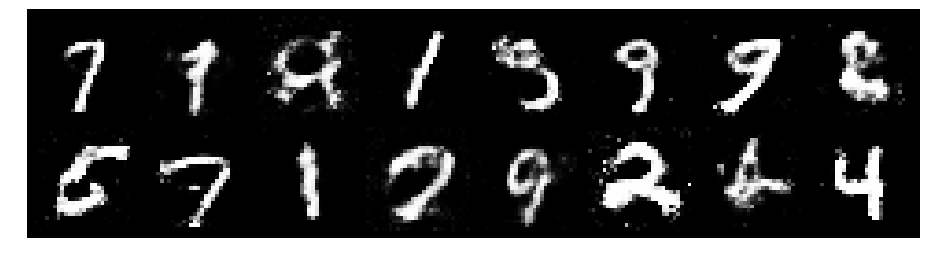

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2458, Generator Loss: 0.8815
D(x): 0.5735, D(G(z)): 0.4464


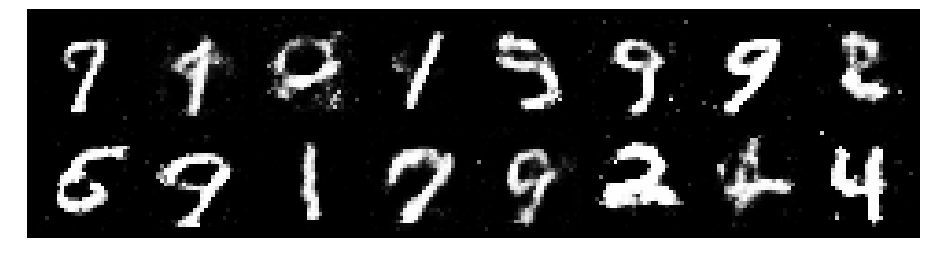

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.2208, Generator Loss: 0.8782
D(x): 0.5610, D(G(z)): 0.4323


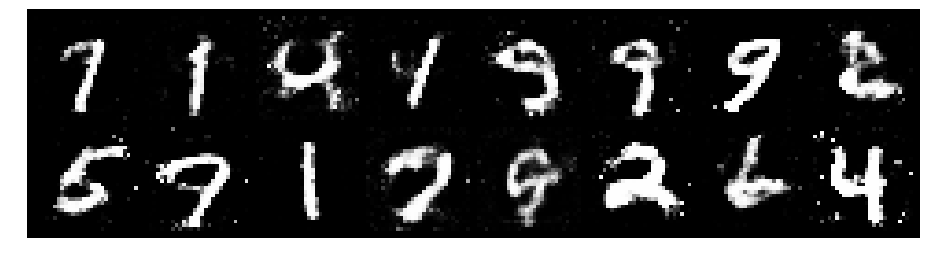

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.2090, Generator Loss: 0.8752
D(x): 0.5948, D(G(z)): 0.4546


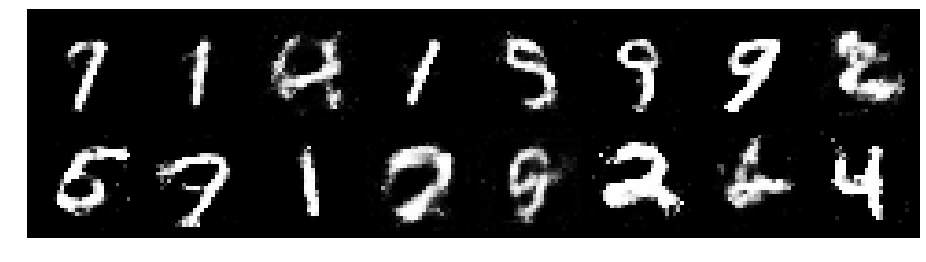

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2895, Generator Loss: 0.8514
D(x): 0.5286, D(G(z)): 0.4450


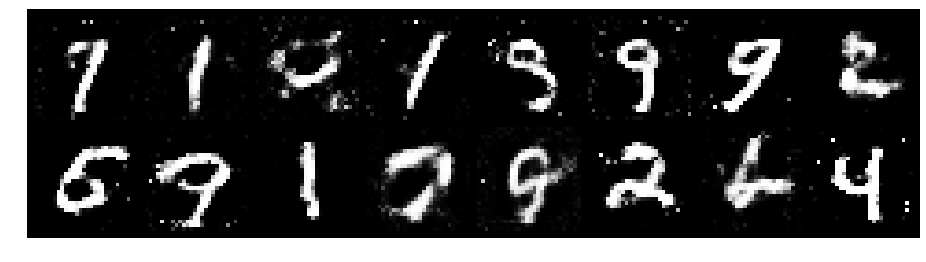

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2685, Generator Loss: 0.8525
D(x): 0.5552, D(G(z)): 0.4495


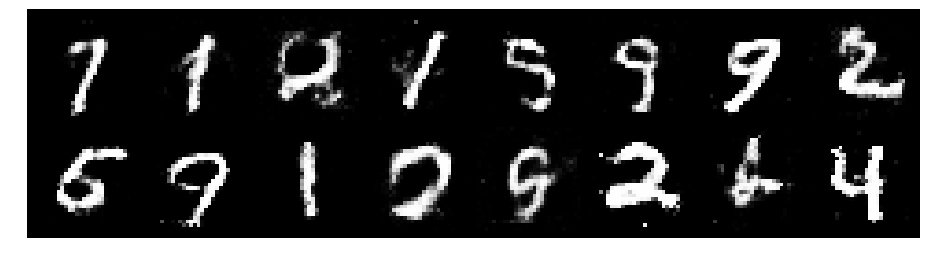

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.1916, Generator Loss: 0.9481
D(x): 0.5743, D(G(z)): 0.4175


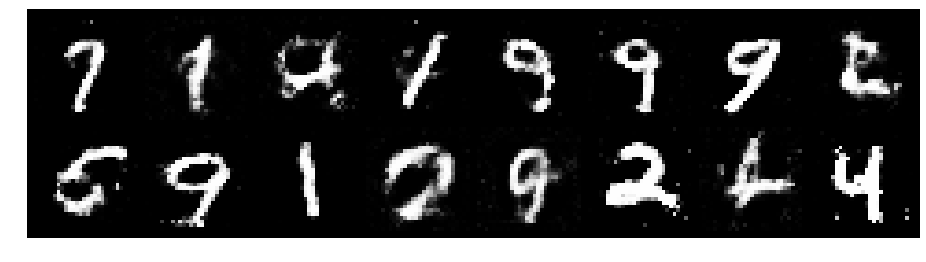

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.2552, Generator Loss: 0.9247
D(x): 0.5603, D(G(z)): 0.4333


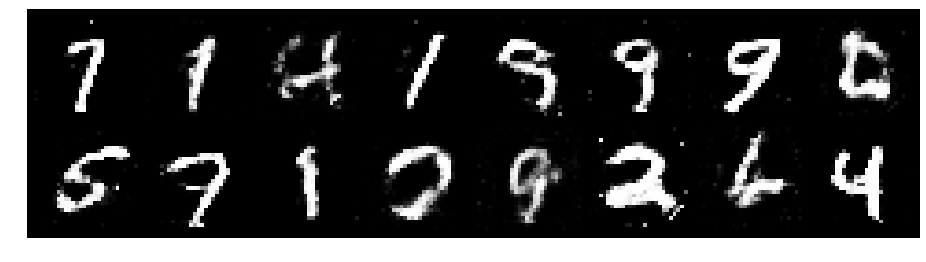

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3180, Generator Loss: 0.8632
D(x): 0.5243, D(G(z)): 0.4506


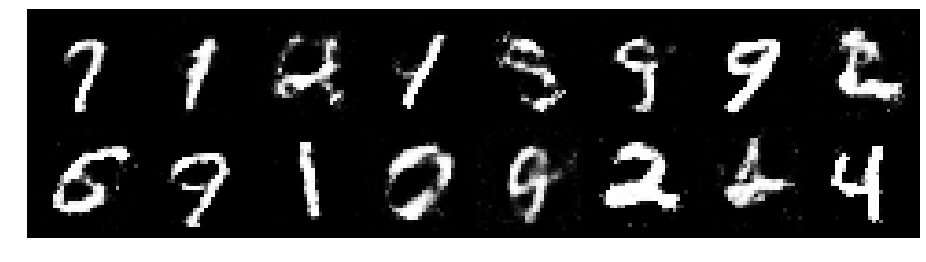

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2838, Generator Loss: 1.0267
D(x): 0.5538, D(G(z)): 0.4266


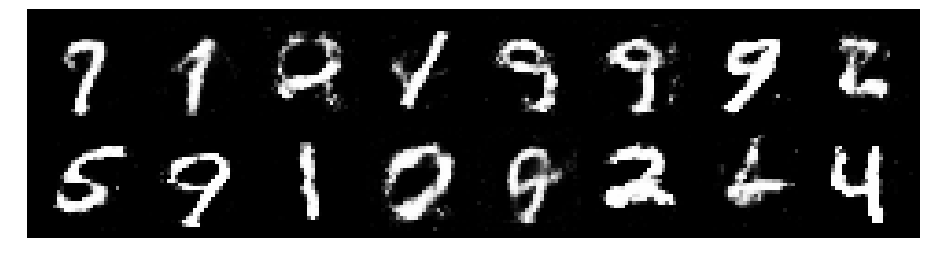

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2668, Generator Loss: 0.8811
D(x): 0.5861, D(G(z)): 0.4610


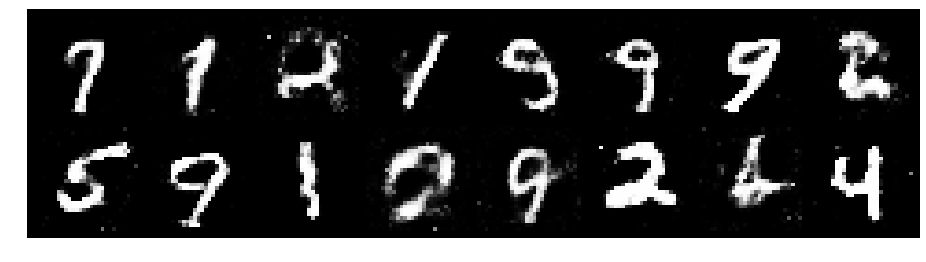

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.0781, Generator Loss: 1.0276
D(x): 0.6101, D(G(z)): 0.3948


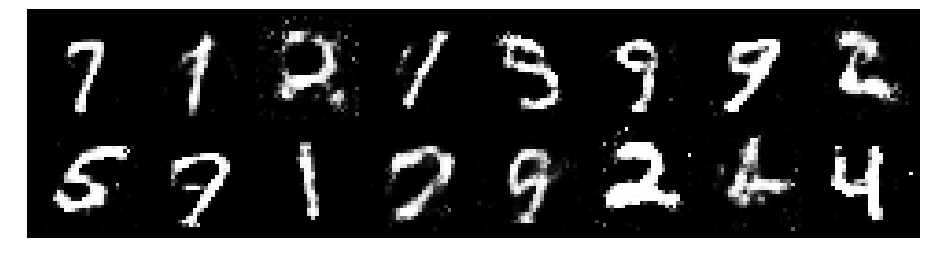

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.1777, Generator Loss: 0.9821
D(x): 0.5362, D(G(z)): 0.3786


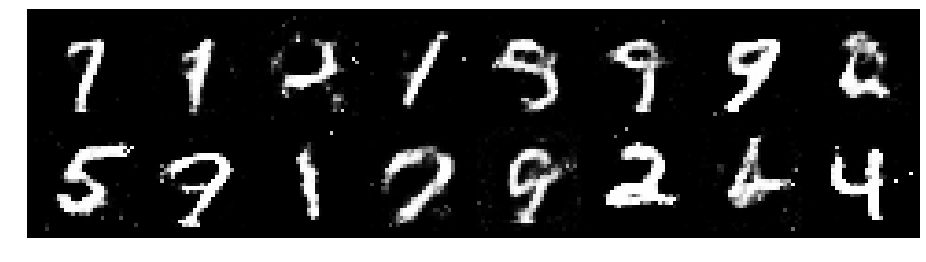

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2597, Generator Loss: 0.8992
D(x): 0.5529, D(G(z)): 0.4371


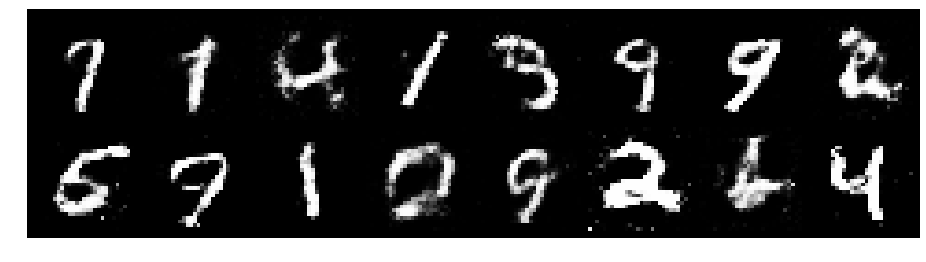

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.1853, Generator Loss: 0.8761
D(x): 0.5713, D(G(z)): 0.4134


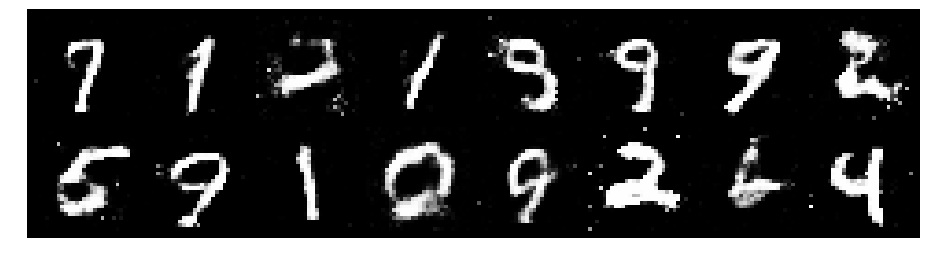

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2782, Generator Loss: 0.9359
D(x): 0.5739, D(G(z)): 0.4419


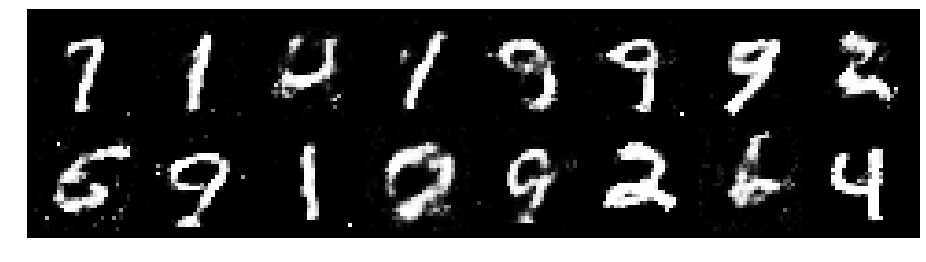

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.3152, Generator Loss: 1.0559
D(x): 0.5553, D(G(z)): 0.4426


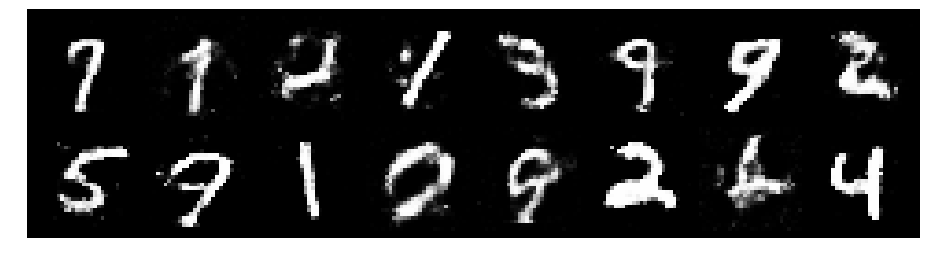

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2858, Generator Loss: 0.9303
D(x): 0.5315, D(G(z)): 0.4333


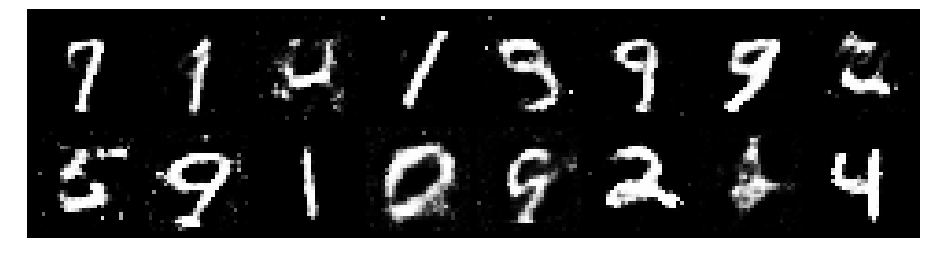

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2757, Generator Loss: 0.7584
D(x): 0.5460, D(G(z)): 0.4290


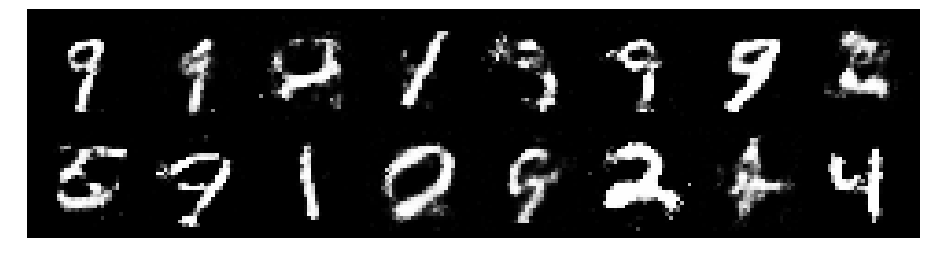

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2513, Generator Loss: 0.7665
D(x): 0.5769, D(G(z)): 0.4613


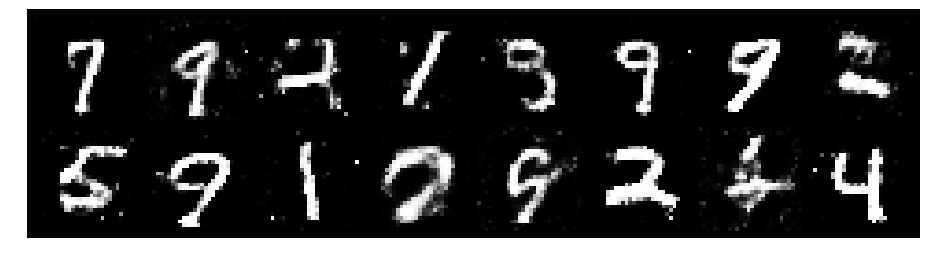

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.1499, Generator Loss: 1.1229
D(x): 0.5908, D(G(z)): 0.4093


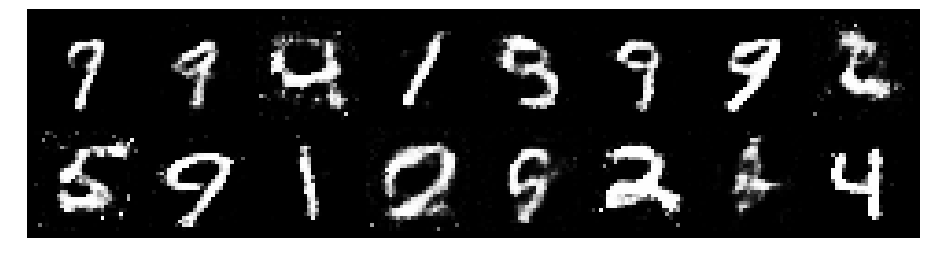

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.1728, Generator Loss: 0.9177
D(x): 0.5605, D(G(z)): 0.4047


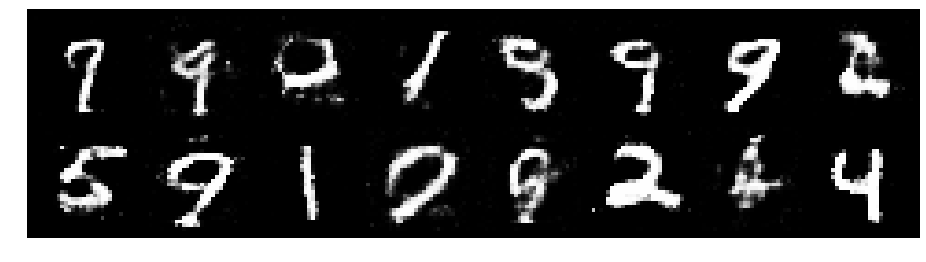

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.1769, Generator Loss: 0.8773
D(x): 0.5809, D(G(z)): 0.4324


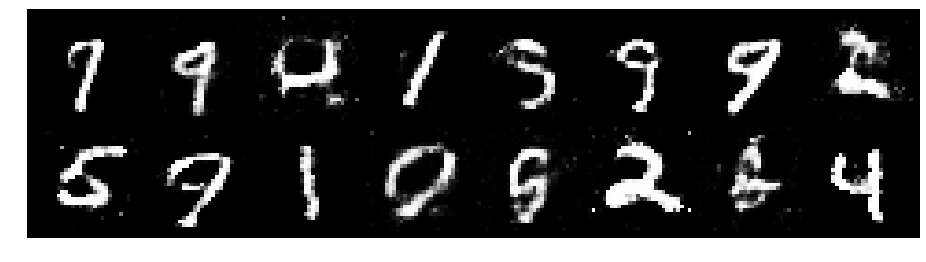

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.2861, Generator Loss: 0.8557
D(x): 0.5392, D(G(z)): 0.4445


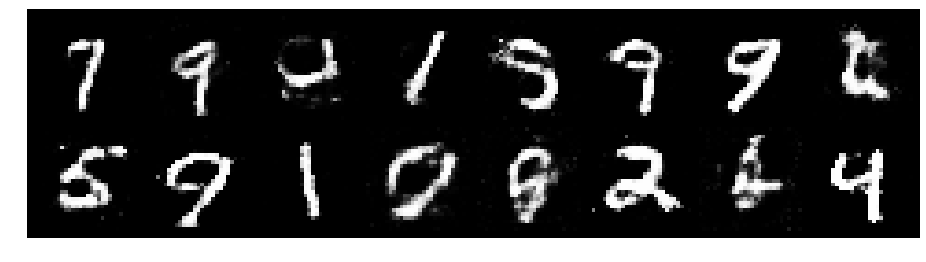

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.1901, Generator Loss: 0.9168
D(x): 0.5711, D(G(z)): 0.4228


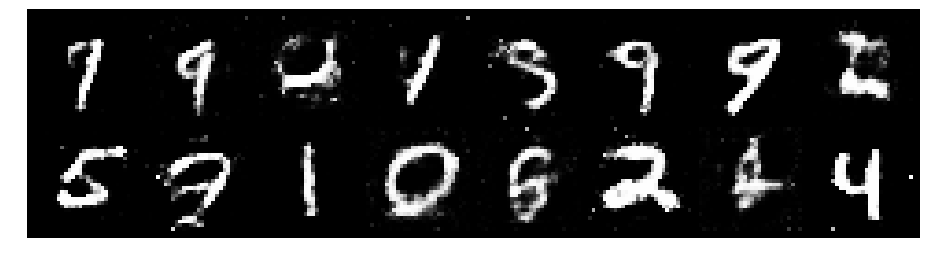

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.1870, Generator Loss: 0.8611
D(x): 0.5730, D(G(z)): 0.4254


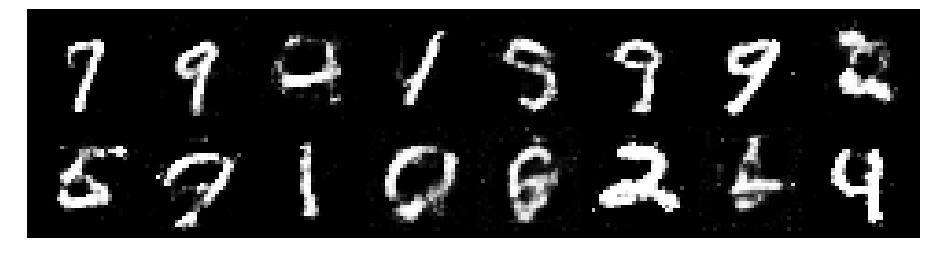

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.1576, Generator Loss: 1.0201
D(x): 0.6435, D(G(z)): 0.4239


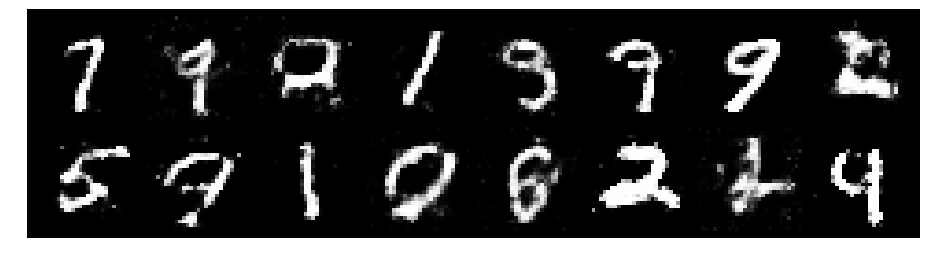

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.3138, Generator Loss: 0.7429
D(x): 0.5492, D(G(z)): 0.4755


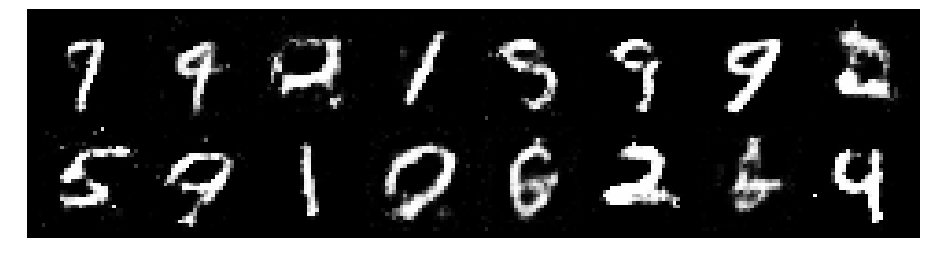

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.1790, Generator Loss: 1.0931
D(x): 0.5795, D(G(z)): 0.4052


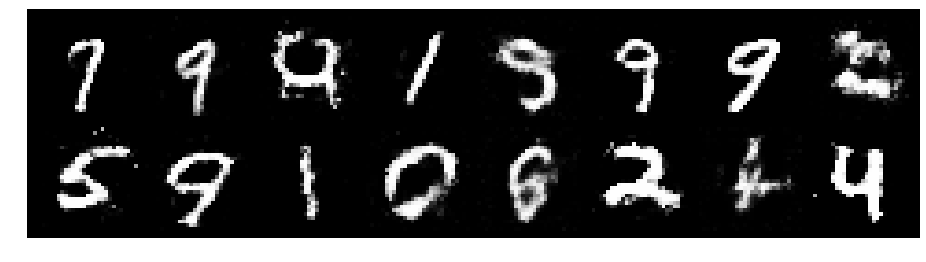

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2805, Generator Loss: 0.9488
D(x): 0.5423, D(G(z)): 0.4198


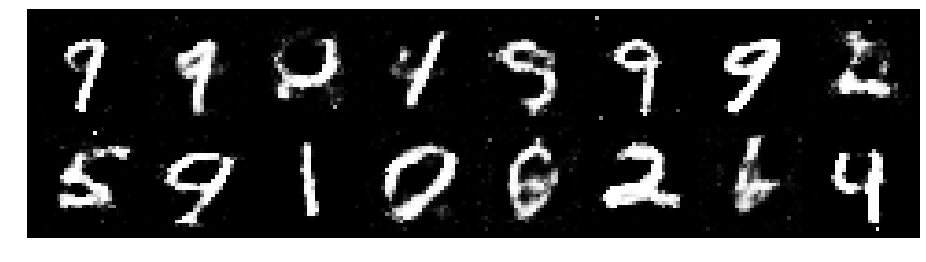

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.1954, Generator Loss: 1.0766
D(x): 0.5658, D(G(z)): 0.3885


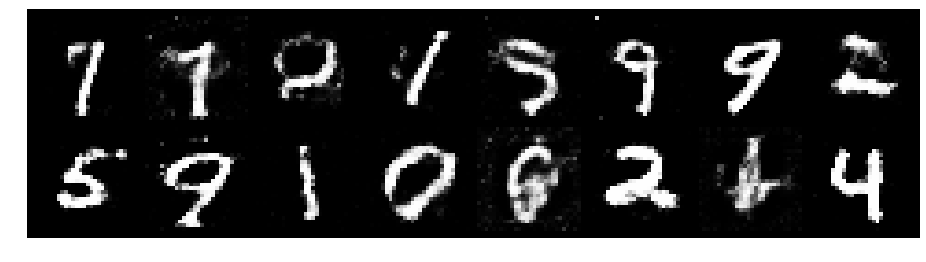

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.2305, Generator Loss: 0.8883
D(x): 0.5762, D(G(z)): 0.4338


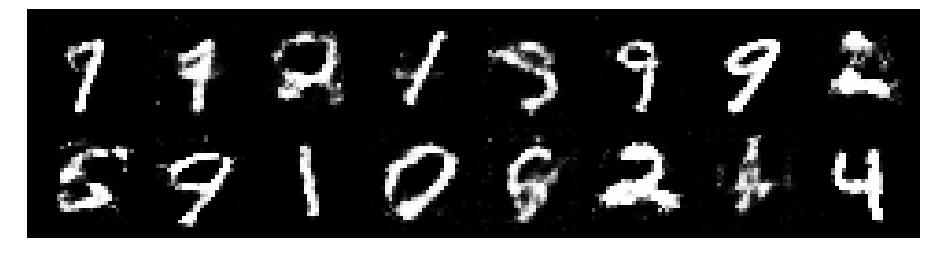

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3267, Generator Loss: 1.0215
D(x): 0.5582, D(G(z)): 0.4592


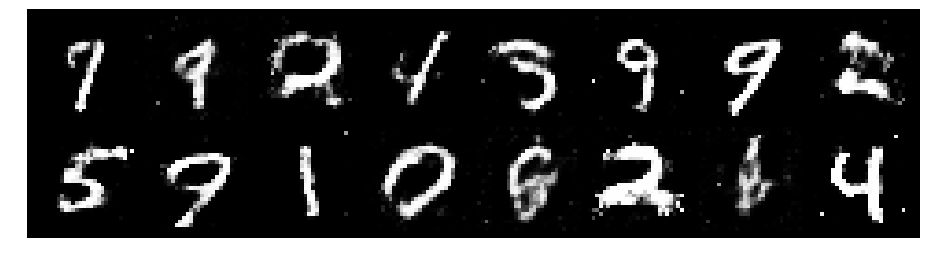

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.3137, Generator Loss: 0.9883
D(x): 0.5153, D(G(z)): 0.4137


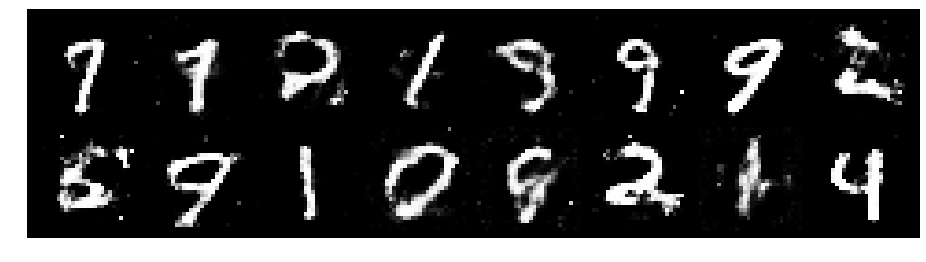

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2670, Generator Loss: 0.9452
D(x): 0.5636, D(G(z)): 0.4479


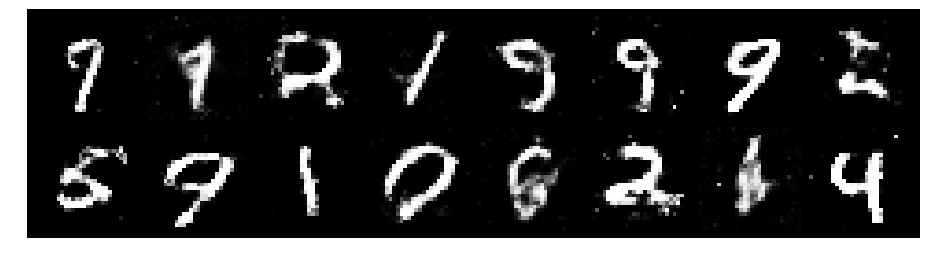

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2753, Generator Loss: 0.8425
D(x): 0.5730, D(G(z)): 0.4713


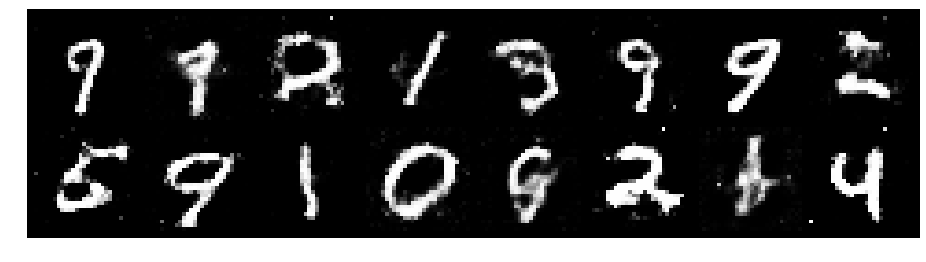

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.3198, Generator Loss: 0.8547
D(x): 0.5430, D(G(z)): 0.4651


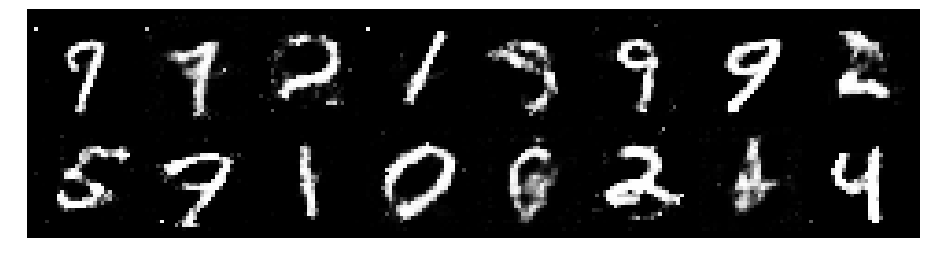

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.1636, Generator Loss: 1.0722
D(x): 0.5155, D(G(z)): 0.3457


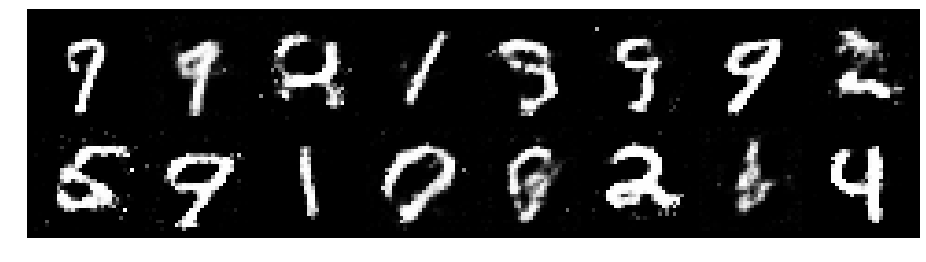

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.1042, Generator Loss: 0.8279
D(x): 0.6424, D(G(z)): 0.4355


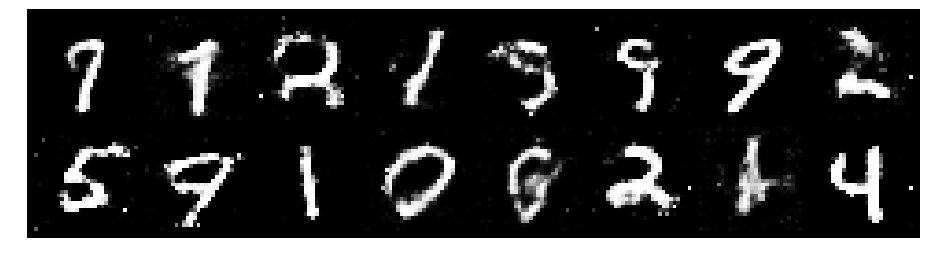

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2755, Generator Loss: 0.9396
D(x): 0.5793, D(G(z)): 0.4672


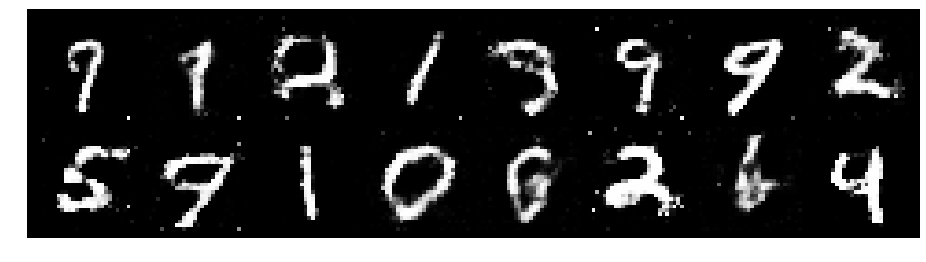

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2634, Generator Loss: 0.9869
D(x): 0.5665, D(G(z)): 0.4376


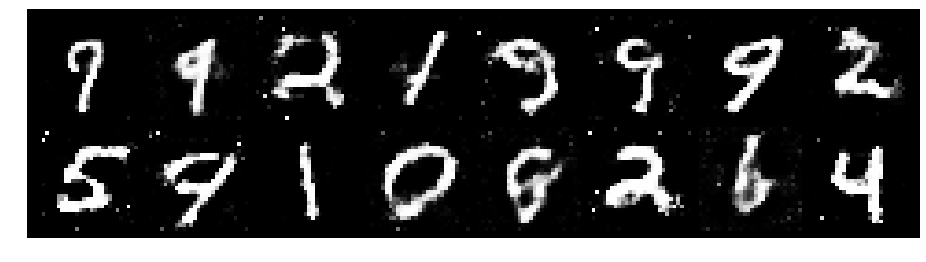

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3058, Generator Loss: 0.9222
D(x): 0.5418, D(G(z)): 0.4430


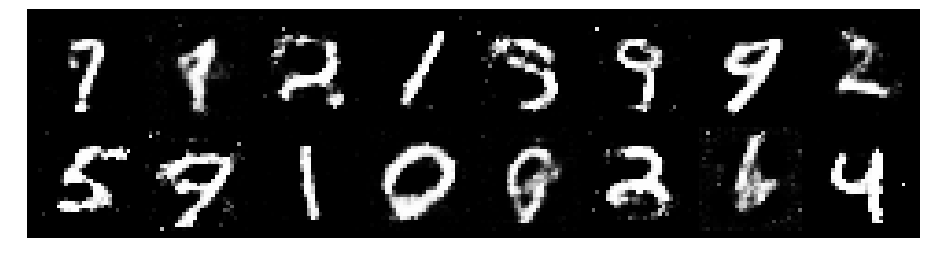

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2025, Generator Loss: 0.9353
D(x): 0.5723, D(G(z)): 0.4264


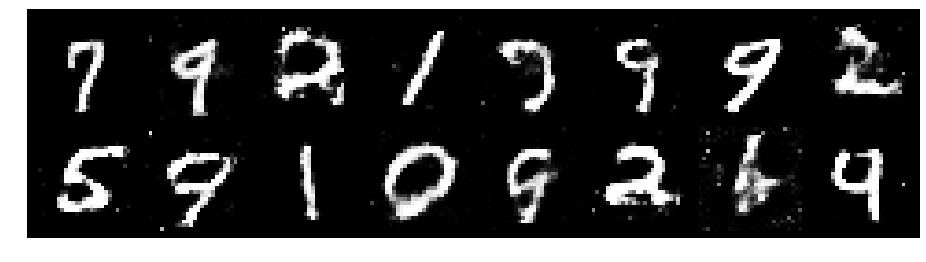

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2808, Generator Loss: 0.8416
D(x): 0.5609, D(G(z)): 0.4354


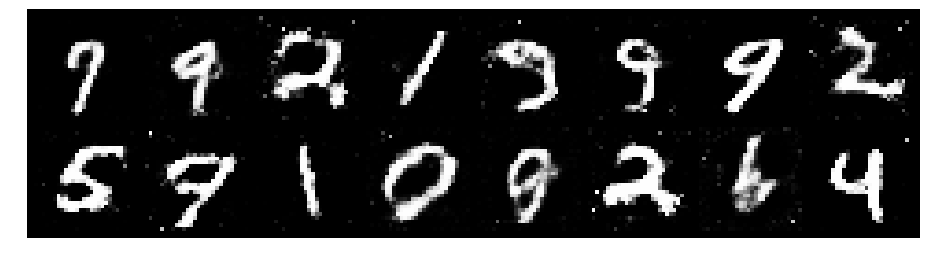

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2987, Generator Loss: 0.8569
D(x): 0.5559, D(G(z)): 0.4471


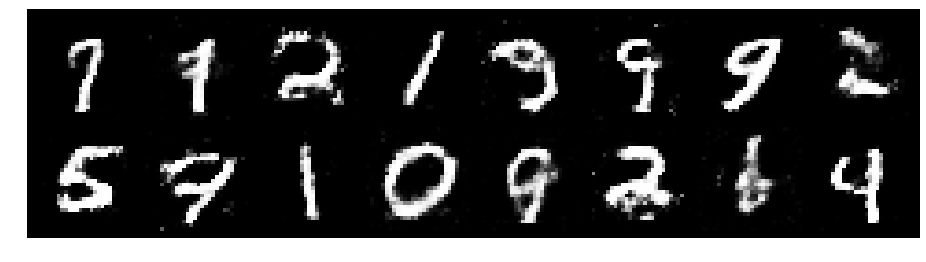

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2365, Generator Loss: 0.9362
D(x): 0.5165, D(G(z)): 0.3926


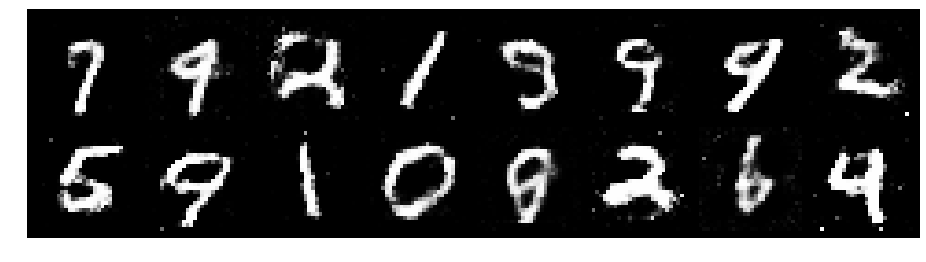

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2823, Generator Loss: 0.8341
D(x): 0.5580, D(G(z)): 0.4662


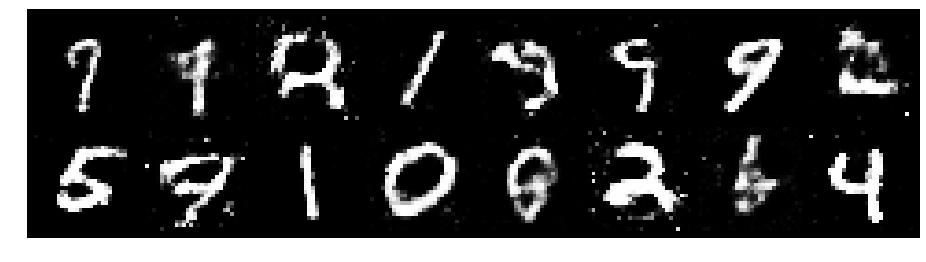

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2679, Generator Loss: 0.8489
D(x): 0.5510, D(G(z)): 0.4628


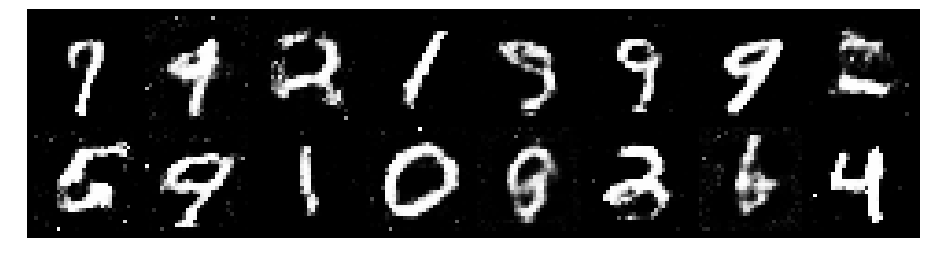

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8857
D(x): 0.5434, D(G(z)): 0.4271


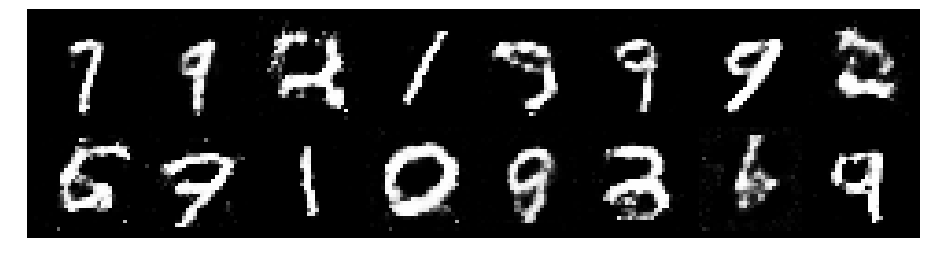

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2200, Generator Loss: 0.8477
D(x): 0.5410, D(G(z)): 0.4241


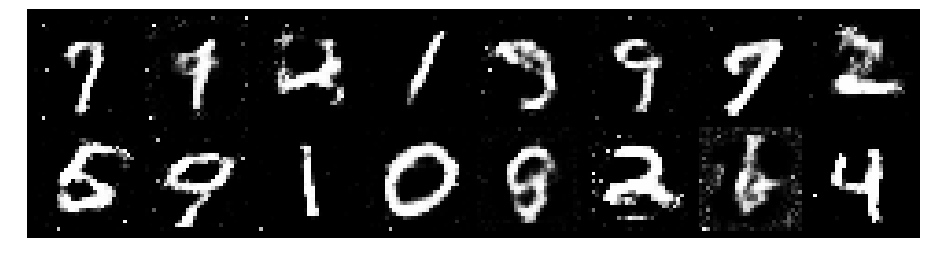

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2119, Generator Loss: 0.9417
D(x): 0.5514, D(G(z)): 0.4181


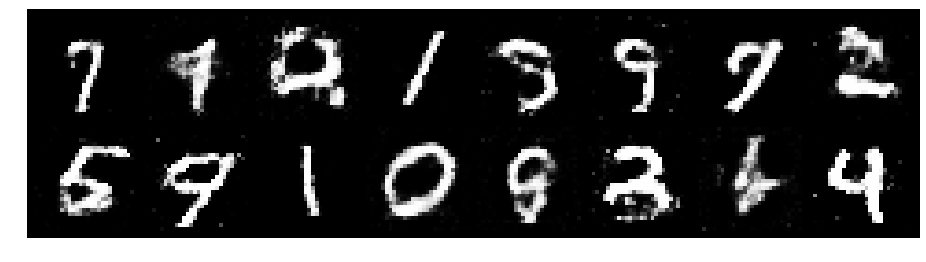

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1799, Generator Loss: 0.8458
D(x): 0.6251, D(G(z)): 0.4571


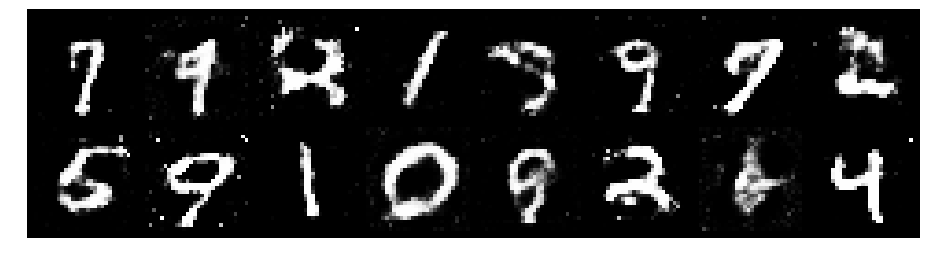

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2854, Generator Loss: 0.8989
D(x): 0.6032, D(G(z)): 0.4955


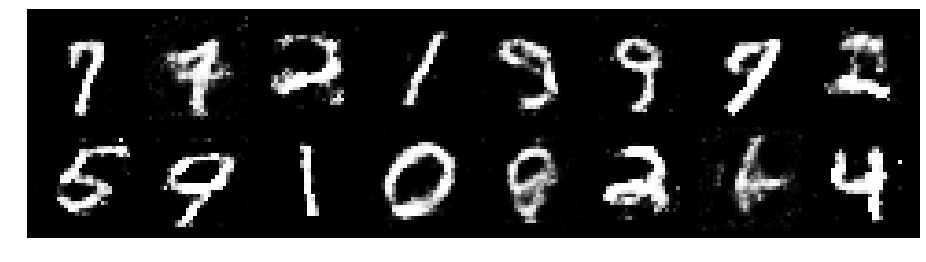

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.3490, Generator Loss: 0.7940
D(x): 0.5447, D(G(z)): 0.4716


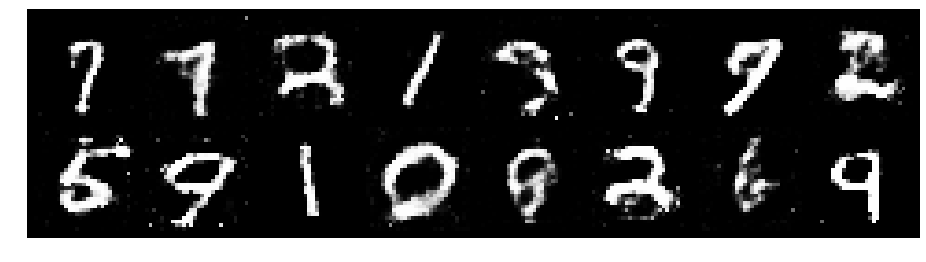

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.1600, Generator Loss: 1.0165
D(x): 0.5697, D(G(z)): 0.4088


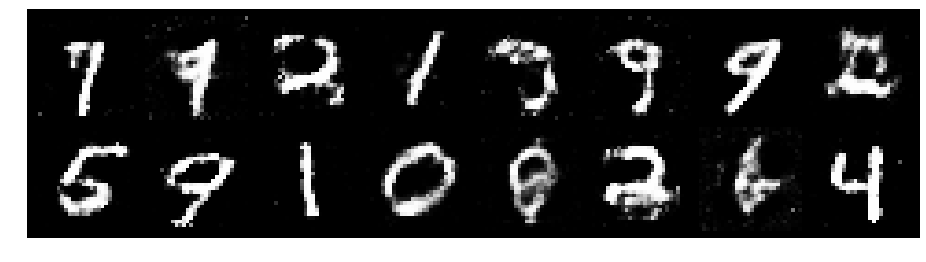

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.1158, Generator Loss: 0.8905
D(x): 0.6472, D(G(z)): 0.4245


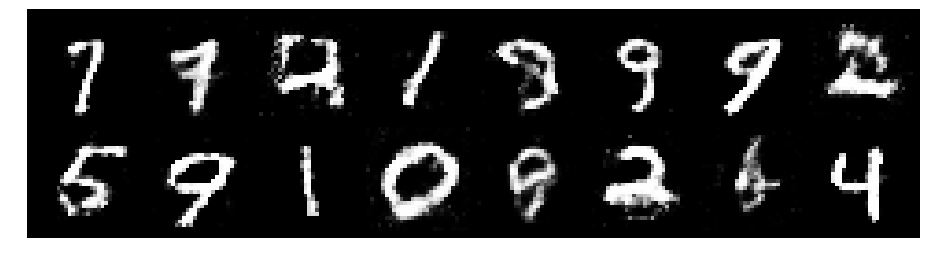

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.3300, Generator Loss: 0.7859
D(x): 0.5707, D(G(z)): 0.4743


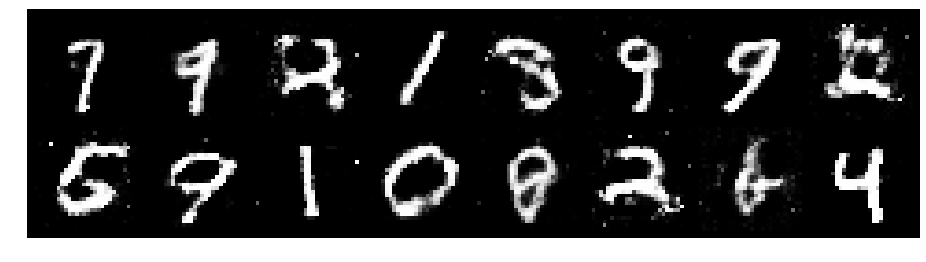

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.3149, Generator Loss: 0.9901
D(x): 0.5588, D(G(z)): 0.4608


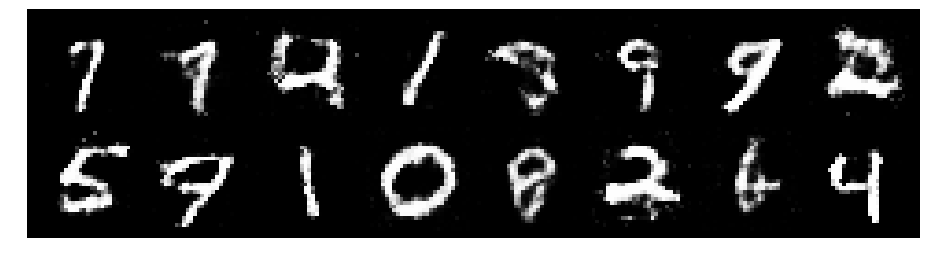

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2815, Generator Loss: 0.9256
D(x): 0.5457, D(G(z)): 0.4228


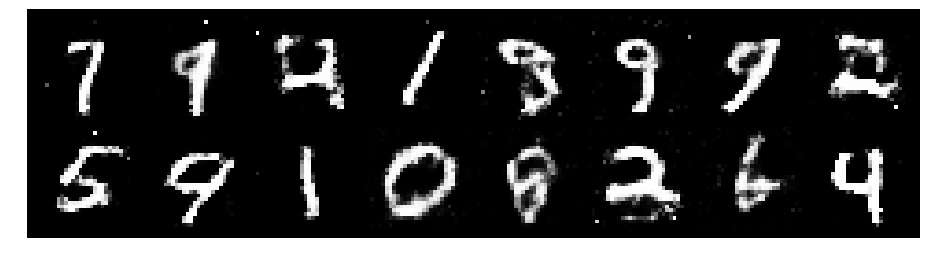

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2650, Generator Loss: 0.8475
D(x): 0.5717, D(G(z)): 0.4483


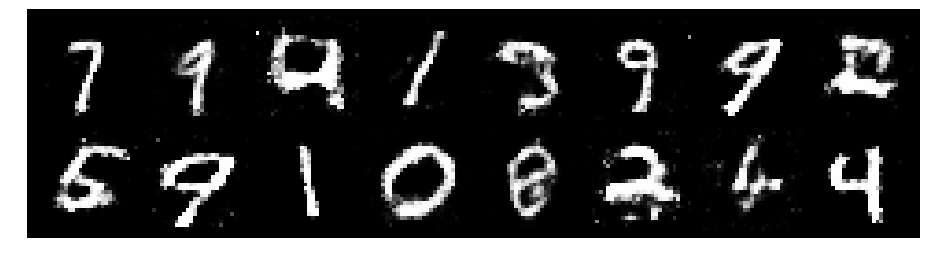

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.4169, Generator Loss: 0.9642
D(x): 0.5590, D(G(z)): 0.4733


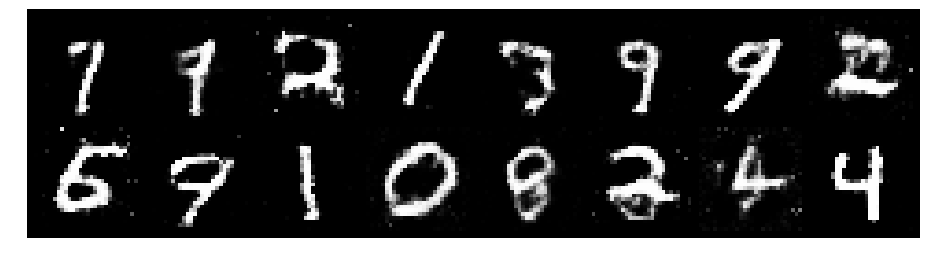

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.1771, Generator Loss: 0.8790
D(x): 0.5672, D(G(z)): 0.4105


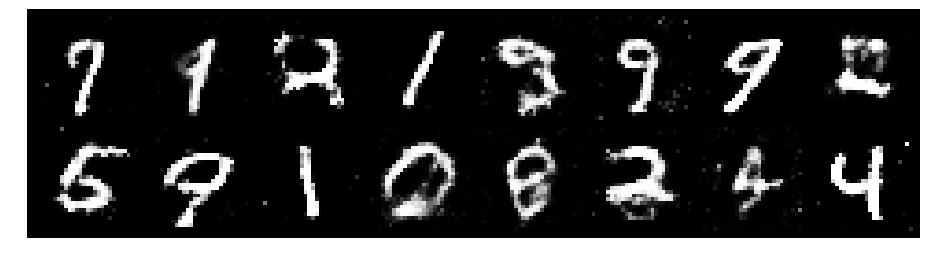

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.3087, Generator Loss: 1.0255
D(x): 0.5643, D(G(z)): 0.4408


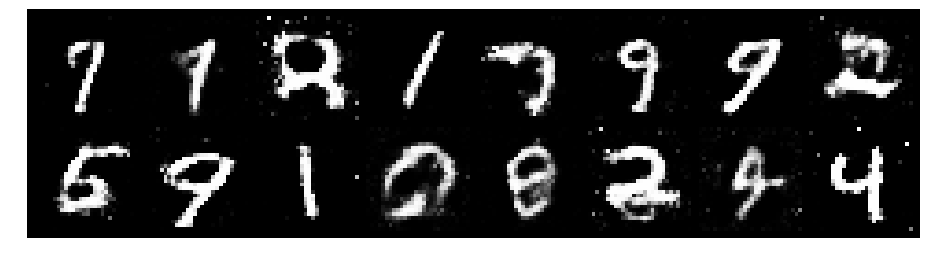

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.1824, Generator Loss: 0.8221
D(x): 0.5958, D(G(z)): 0.4215


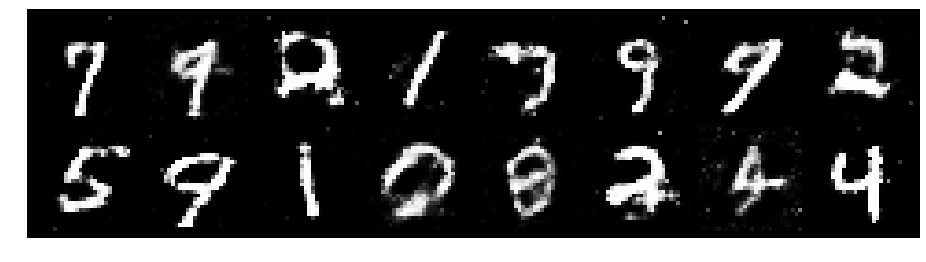

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.1731, Generator Loss: 0.8791
D(x): 0.6232, D(G(z)): 0.4445


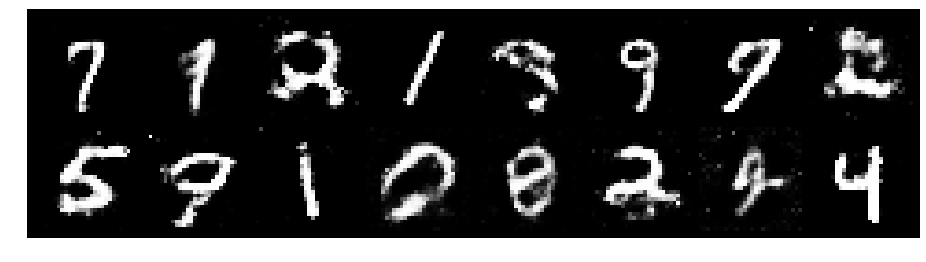

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2573, Generator Loss: 0.8934
D(x): 0.5819, D(G(z)): 0.4514


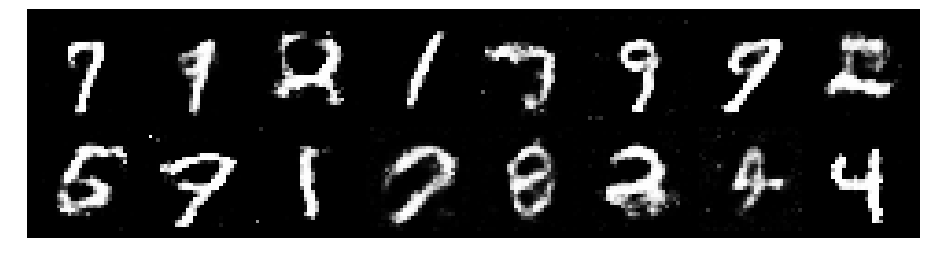

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2967, Generator Loss: 0.9449
D(x): 0.5524, D(G(z)): 0.4381


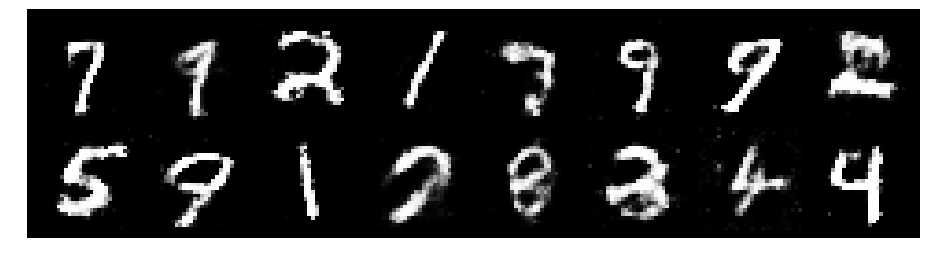

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2612, Generator Loss: 0.8730
D(x): 0.5268, D(G(z)): 0.3991


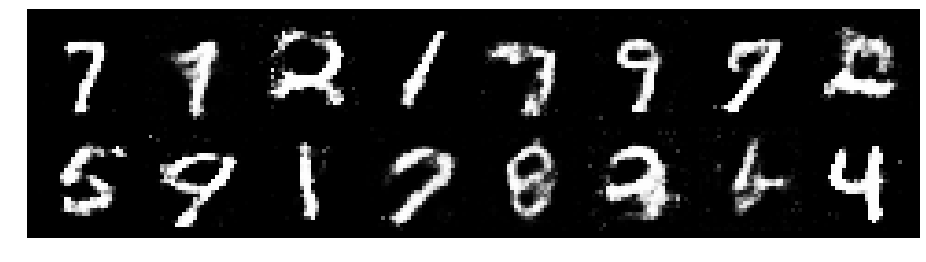

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2415, Generator Loss: 0.9324
D(x): 0.5468, D(G(z)): 0.4057


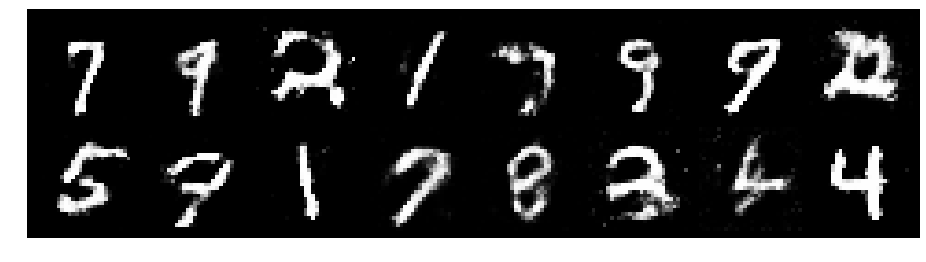

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2212, Generator Loss: 1.0160
D(x): 0.5523, D(G(z)): 0.3985


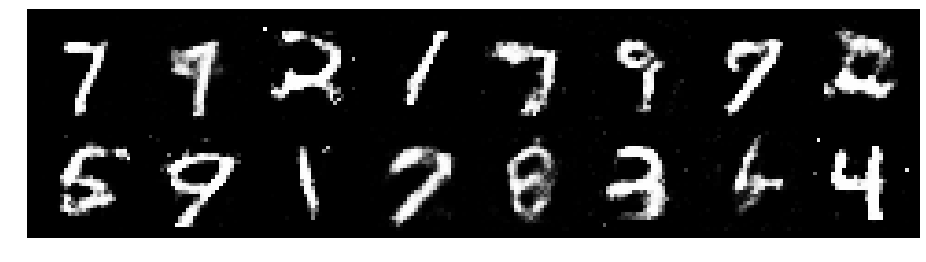

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.1809, Generator Loss: 1.0989
D(x): 0.5663, D(G(z)): 0.3978


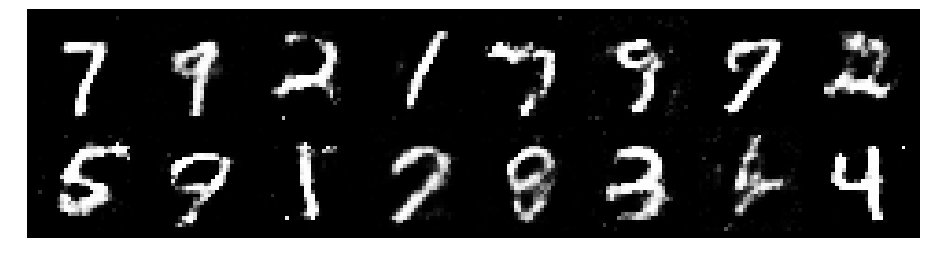

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.1963, Generator Loss: 1.0401
D(x): 0.5730, D(G(z)): 0.4107


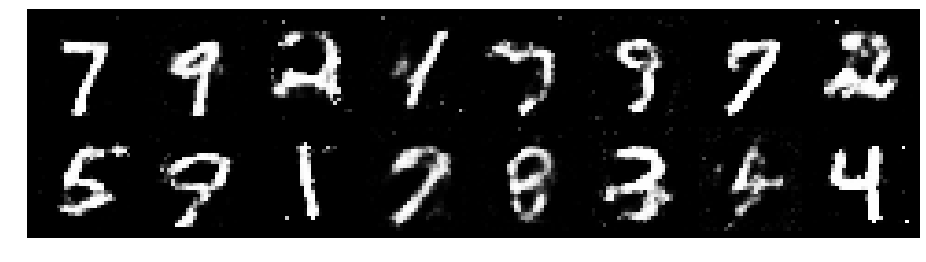

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.3097, Generator Loss: 0.8797
D(x): 0.5689, D(G(z)): 0.4681


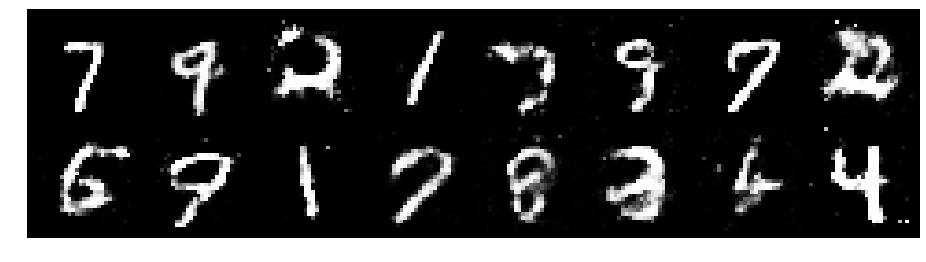

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.1934, Generator Loss: 1.0492
D(x): 0.5677, D(G(z)): 0.4106


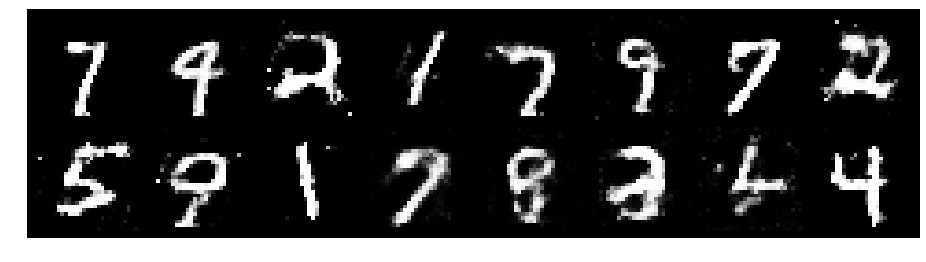

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.1988, Generator Loss: 0.9364
D(x): 0.5719, D(G(z)): 0.4126


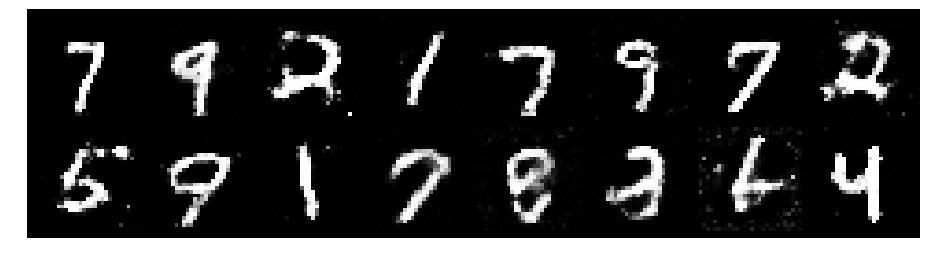

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2451, Generator Loss: 0.9502
D(x): 0.5686, D(G(z)): 0.4299


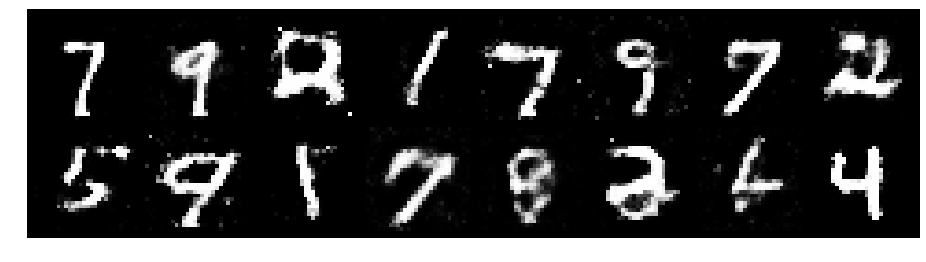

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2471, Generator Loss: 0.8257
D(x): 0.5562, D(G(z)): 0.4245


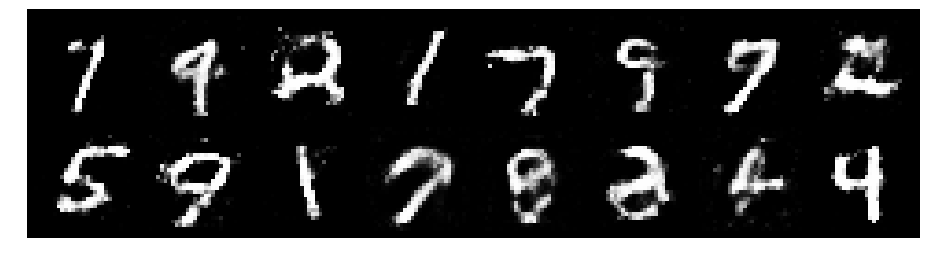

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2914, Generator Loss: 0.8729
D(x): 0.5384, D(G(z)): 0.4549


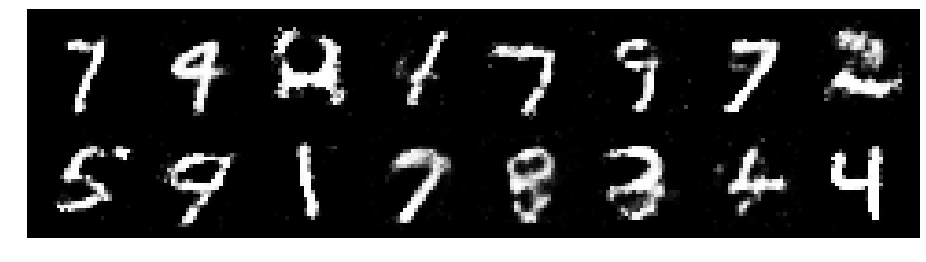

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2882, Generator Loss: 0.7717
D(x): 0.5745, D(G(z)): 0.4776


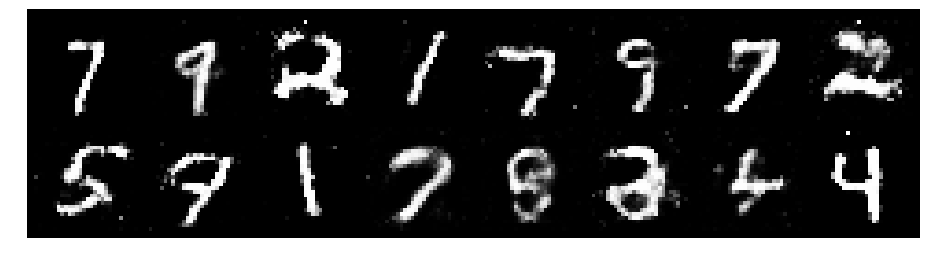

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.3190, Generator Loss: 0.7326
D(x): 0.5893, D(G(z)): 0.4898


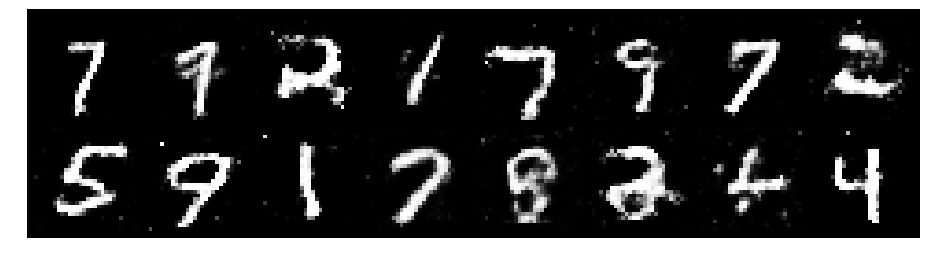

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.3239, Generator Loss: 1.0652
D(x): 0.4929, D(G(z)): 0.3945


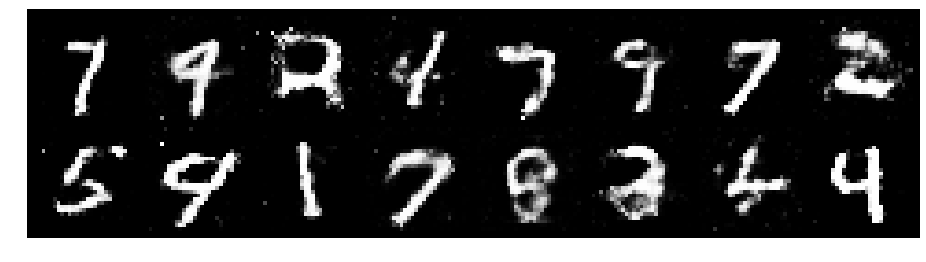

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2191, Generator Loss: 1.0290
D(x): 0.5745, D(G(z)): 0.4344


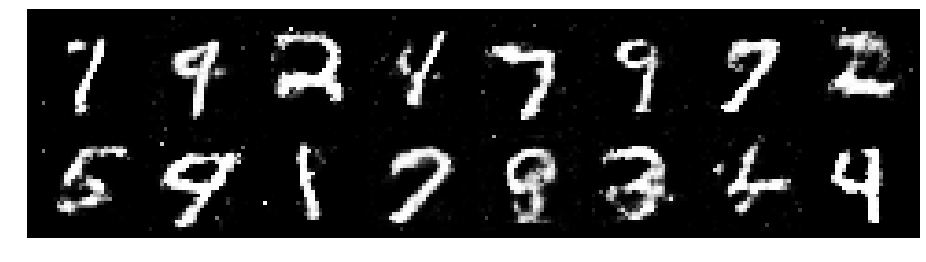

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.1931, Generator Loss: 0.9636
D(x): 0.5703, D(G(z)): 0.4275


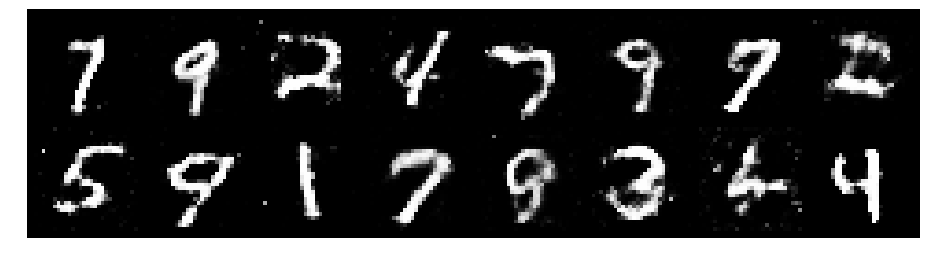

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2840, Generator Loss: 0.8437
D(x): 0.5523, D(G(z)): 0.4476


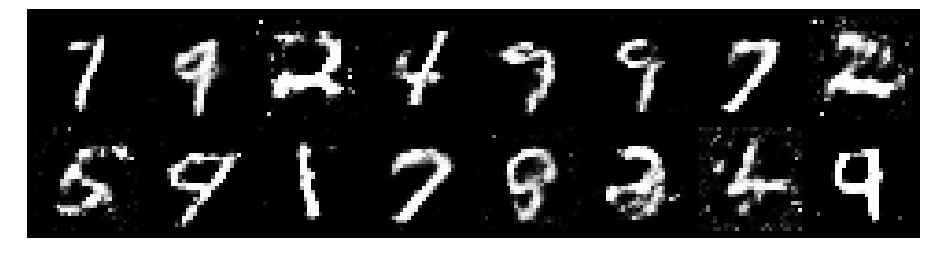

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2184, Generator Loss: 0.8409
D(x): 0.5810, D(G(z)): 0.4512


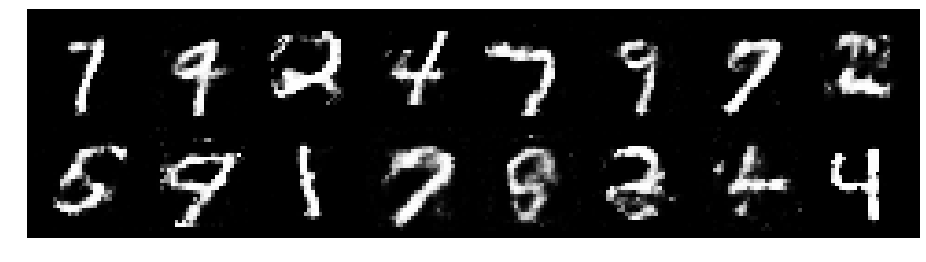

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.3052, Generator Loss: 0.8801
D(x): 0.5042, D(G(z)): 0.4360


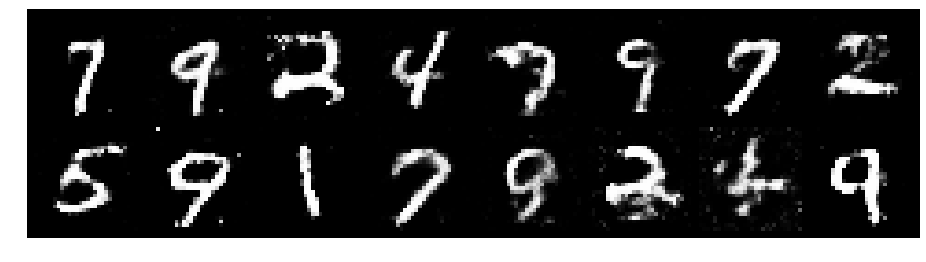

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.2500, Generator Loss: 0.8824
D(x): 0.5648, D(G(z)): 0.4456


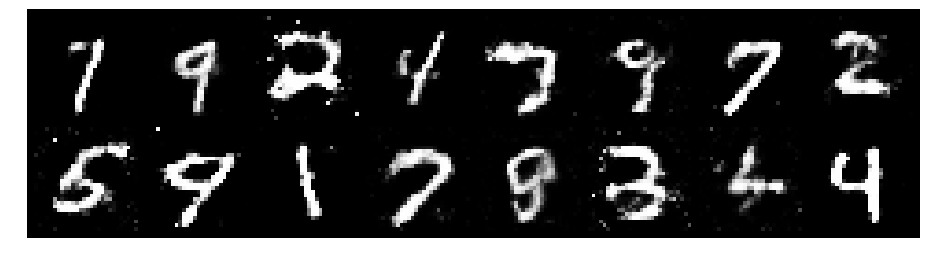

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.4038, Generator Loss: 0.7926
D(x): 0.5381, D(G(z)): 0.4917


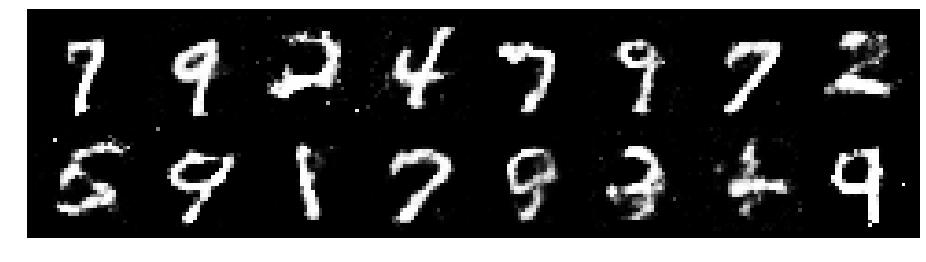

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.3667, Generator Loss: 0.8639
D(x): 0.5314, D(G(z)): 0.4562


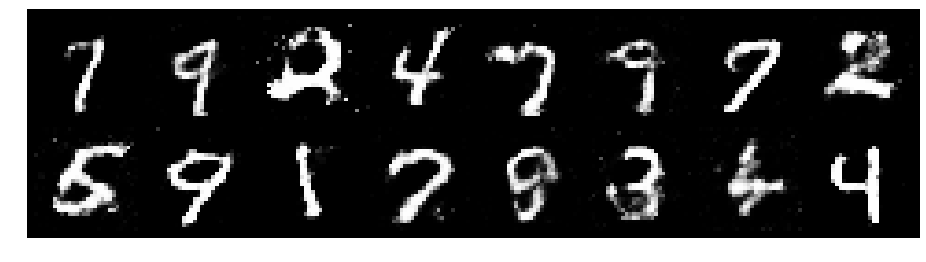

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.3350, Generator Loss: 0.8812
D(x): 0.5401, D(G(z)): 0.4614


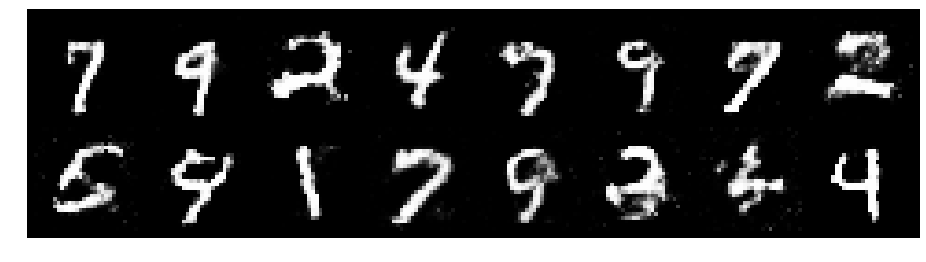

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.3297, Generator Loss: 0.8451
D(x): 0.5362, D(G(z)): 0.4454


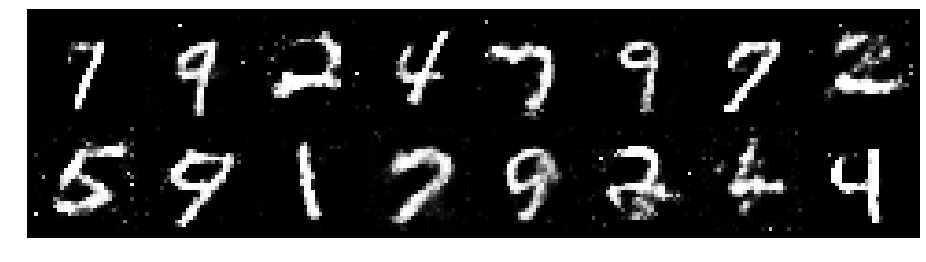

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.3598, Generator Loss: 0.9019
D(x): 0.5821, D(G(z)): 0.5041


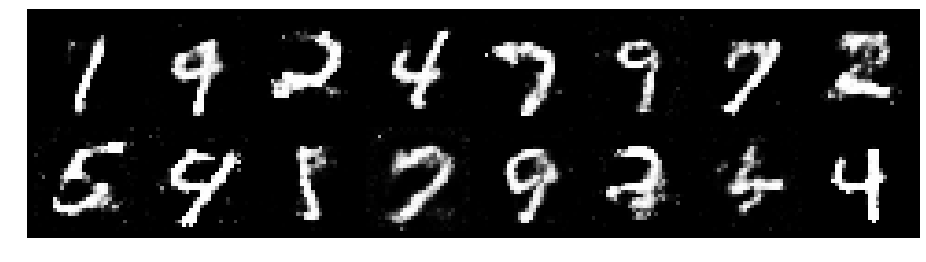

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.3517, Generator Loss: 0.8674
D(x): 0.5744, D(G(z)): 0.4583


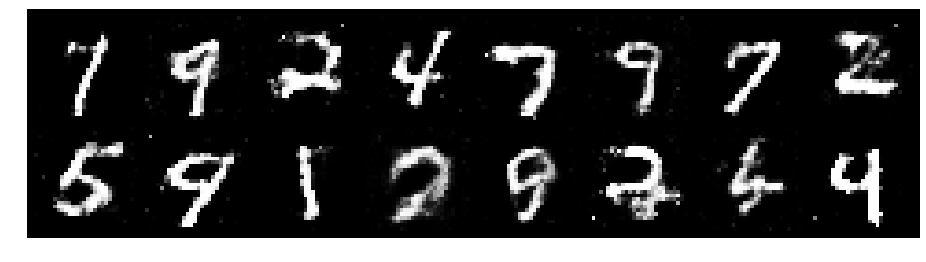

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.2839, Generator Loss: 0.8721
D(x): 0.5902, D(G(z)): 0.4794


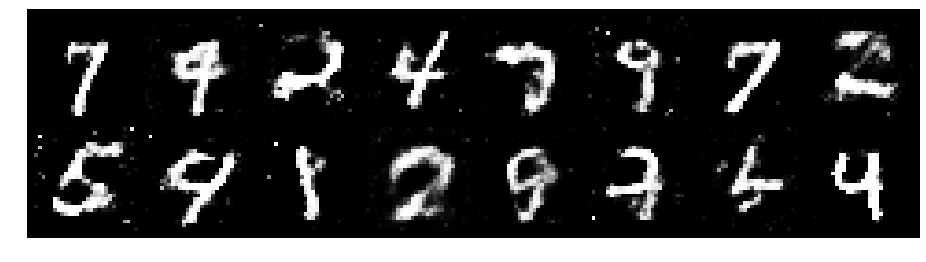

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2748, Generator Loss: 0.8053
D(x): 0.5808, D(G(z)): 0.4649


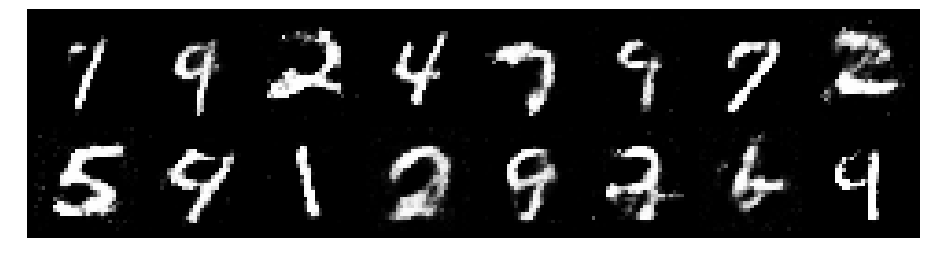

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2740, Generator Loss: 0.9310
D(x): 0.5494, D(G(z)): 0.4519


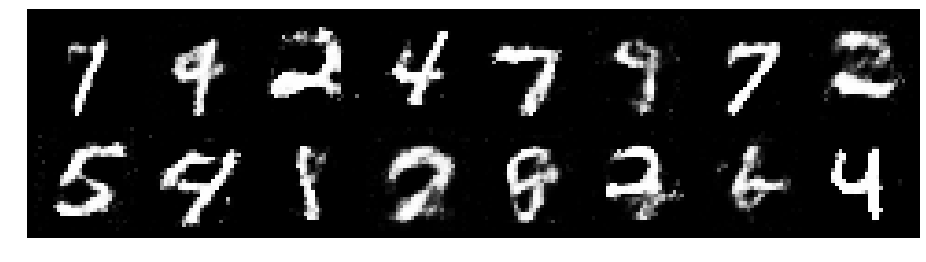

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.4835, Generator Loss: 0.7506
D(x): 0.5611, D(G(z)): 0.5283


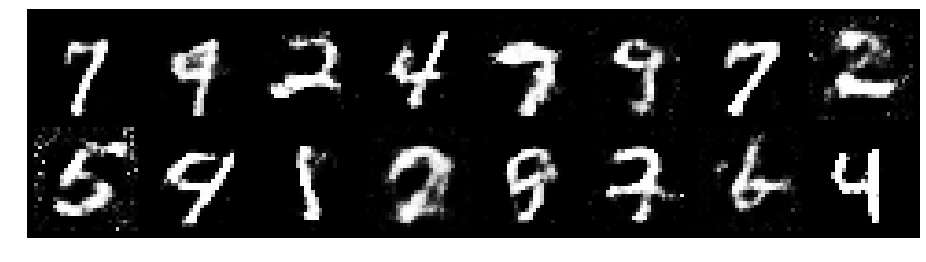

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.1995, Generator Loss: 0.9921
D(x): 0.5479, D(G(z)): 0.3793


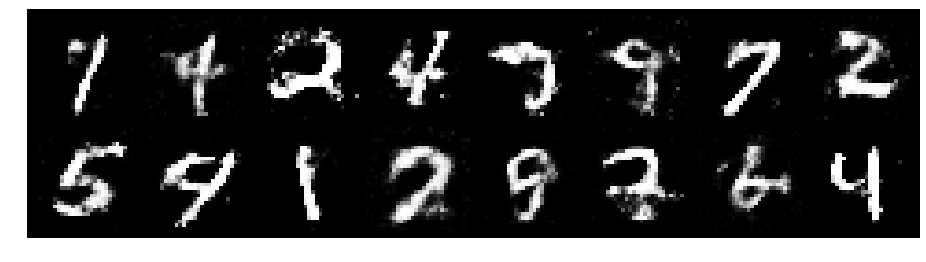

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2422, Generator Loss: 0.9081
D(x): 0.5446, D(G(z)): 0.4308


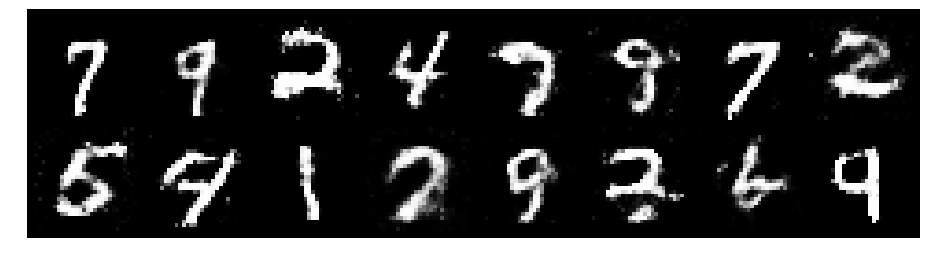

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.3102, Generator Loss: 0.9519
D(x): 0.4894, D(G(z)): 0.4004


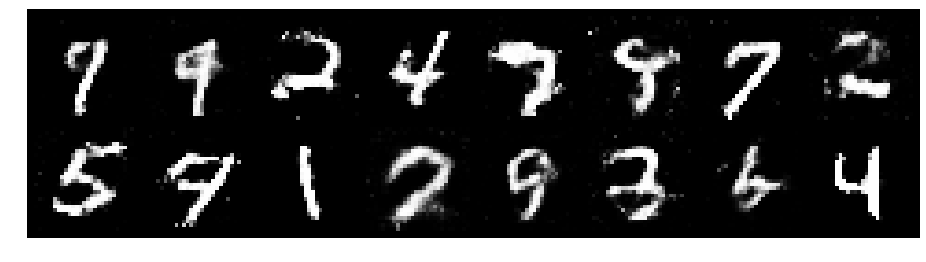

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.1194, Generator Loss: 0.9031
D(x): 0.5702, D(G(z)): 0.3881


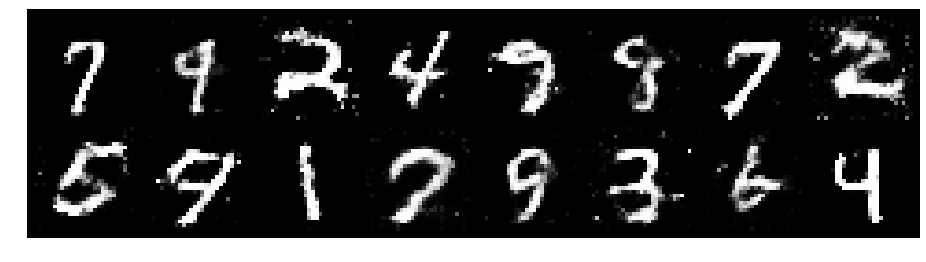

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3539, Generator Loss: 0.8701
D(x): 0.5641, D(G(z)): 0.4555


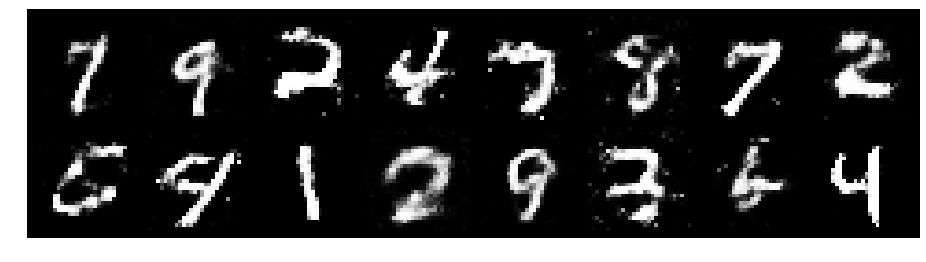

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.2260, Generator Loss: 0.8670
D(x): 0.5708, D(G(z)): 0.4249


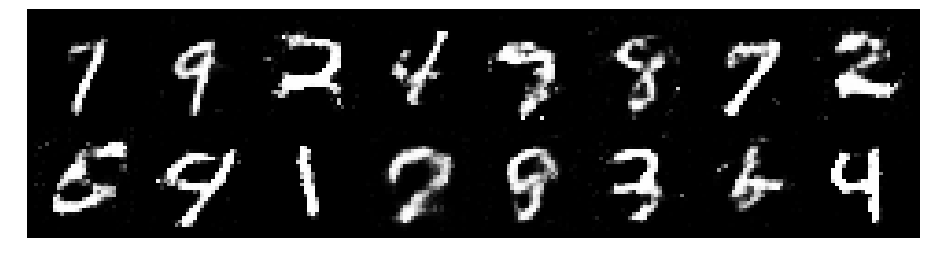

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.0993, Generator Loss: 1.0715
D(x): 0.6146, D(G(z)): 0.3655


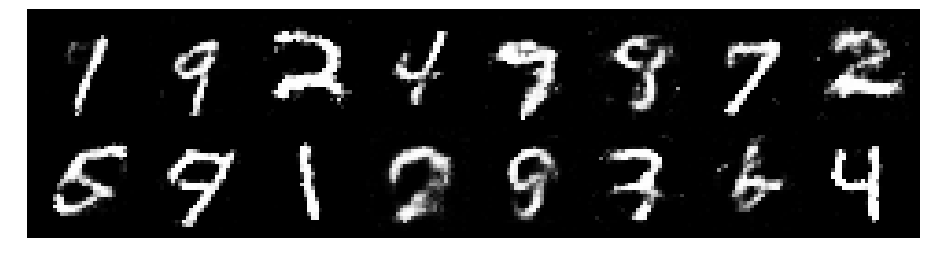

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2624, Generator Loss: 1.0498
D(x): 0.5282, D(G(z)): 0.4126


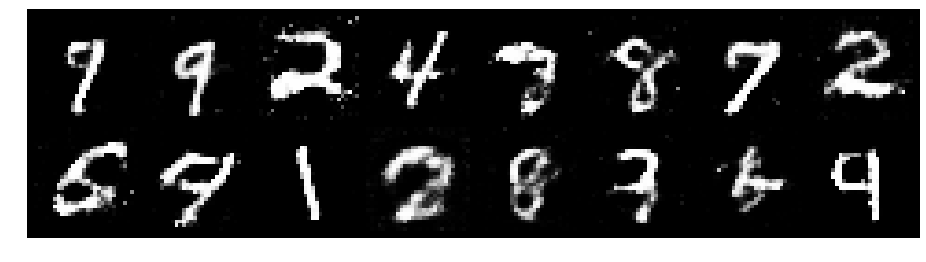

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2396, Generator Loss: 0.9369
D(x): 0.5697, D(G(z)): 0.4351


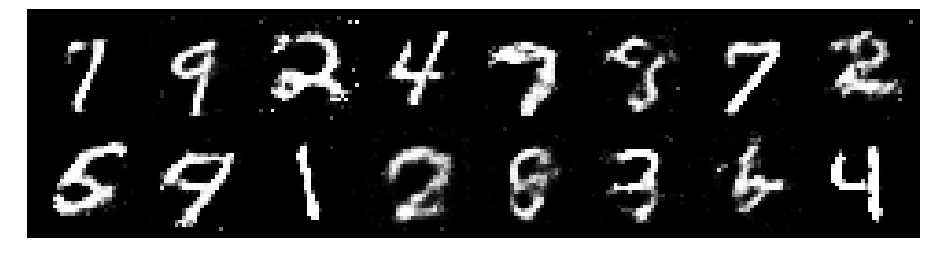

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2692, Generator Loss: 1.0299
D(x): 0.5686, D(G(z)): 0.4174


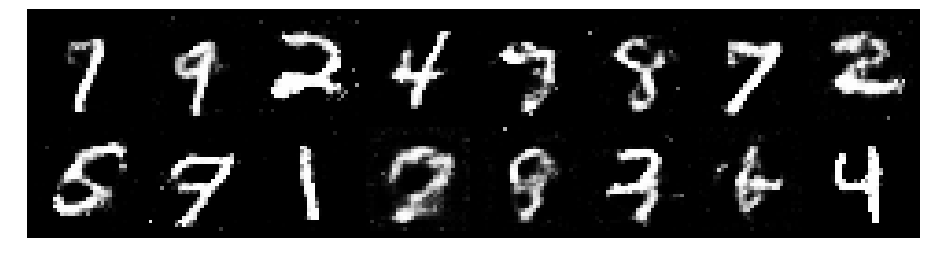

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.1785, Generator Loss: 0.9995
D(x): 0.5998, D(G(z)): 0.4337


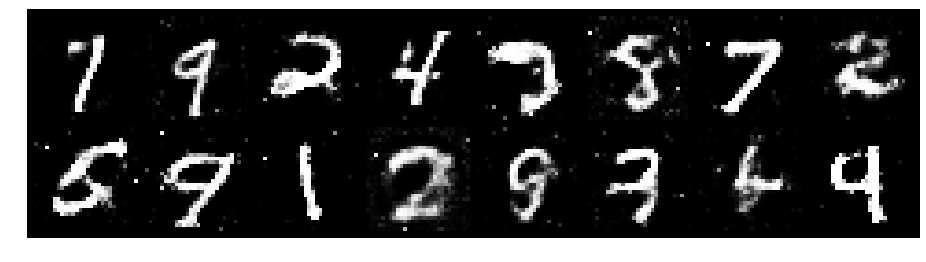

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2797, Generator Loss: 1.0366
D(x): 0.5516, D(G(z)): 0.4157


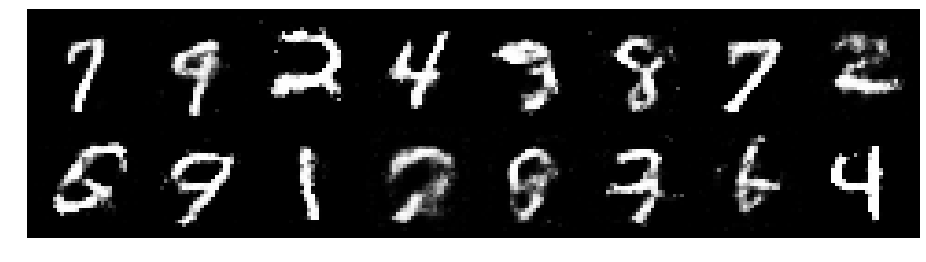

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2534, Generator Loss: 0.9131
D(x): 0.5583, D(G(z)): 0.4241


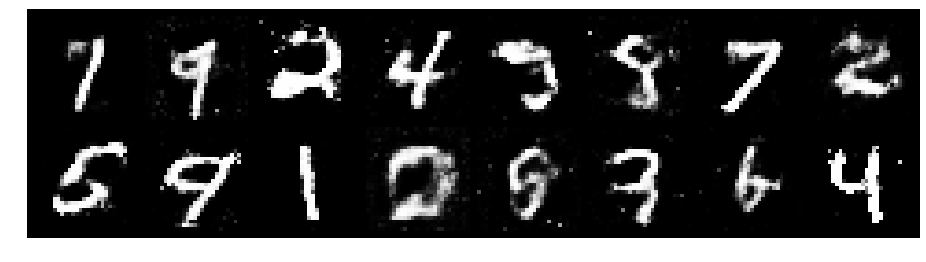

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.3164, Generator Loss: 0.8674
D(x): 0.5430, D(G(z)): 0.4511


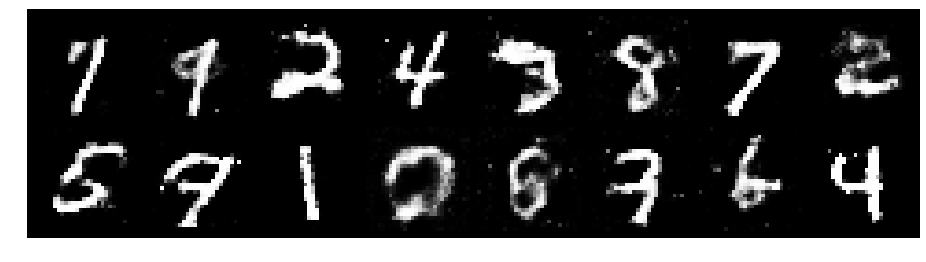

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.3255, Generator Loss: 0.9506
D(x): 0.5645, D(G(z)): 0.4512


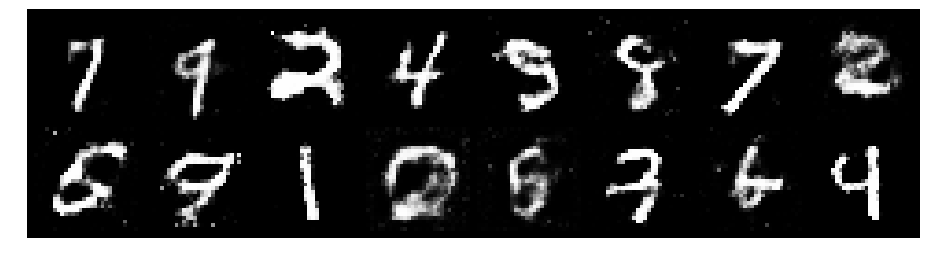

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.1607, Generator Loss: 0.8000
D(x): 0.6342, D(G(z)): 0.4599


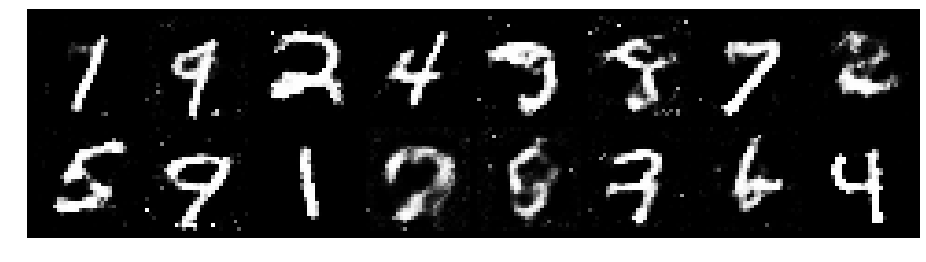

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2917, Generator Loss: 0.8435
D(x): 0.5984, D(G(z)): 0.4783


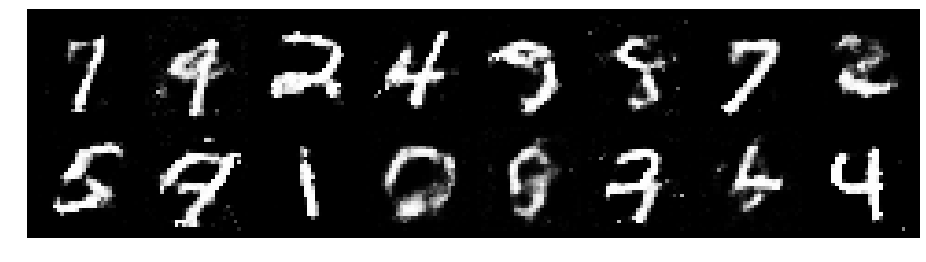

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2662, Generator Loss: 0.7858
D(x): 0.5521, D(G(z)): 0.4650


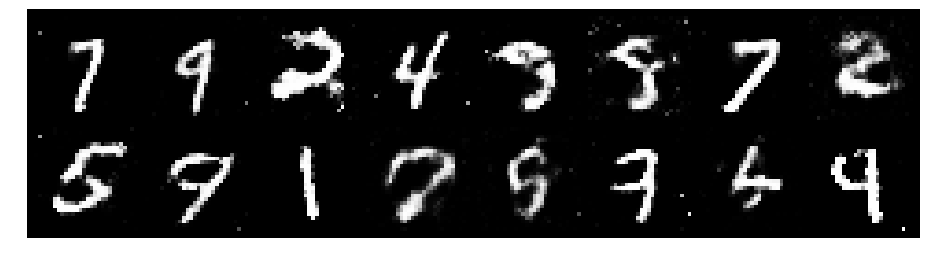

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.2938, Generator Loss: 0.8805
D(x): 0.5405, D(G(z)): 0.4491


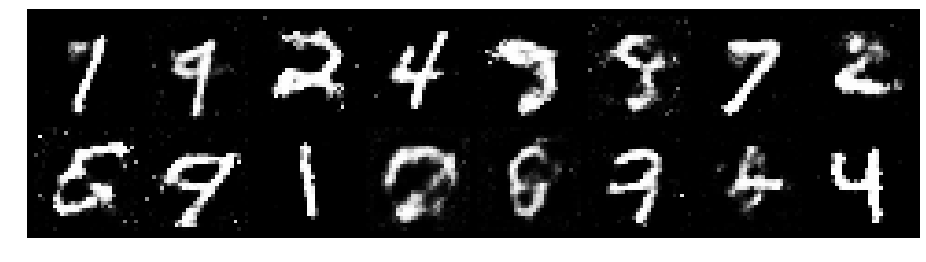

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2199, Generator Loss: 0.8832
D(x): 0.5610, D(G(z)): 0.4300


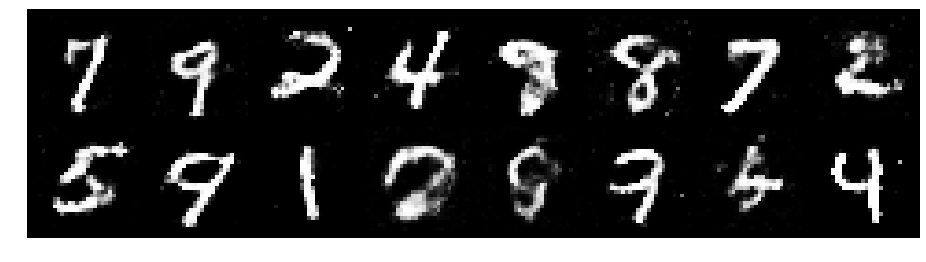

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.3037, Generator Loss: 0.7997
D(x): 0.5642, D(G(z)): 0.4764


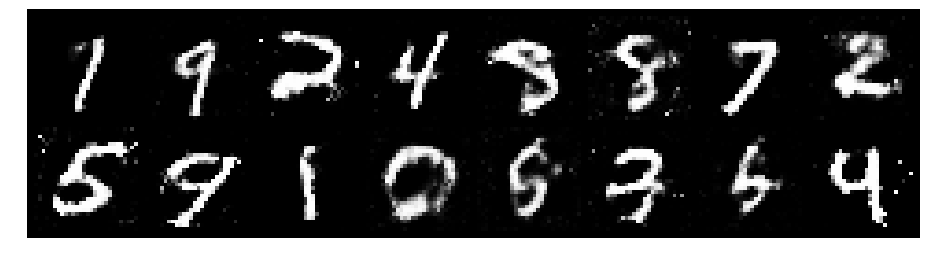

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.2563, Generator Loss: 0.8288
D(x): 0.5469, D(G(z)): 0.4505


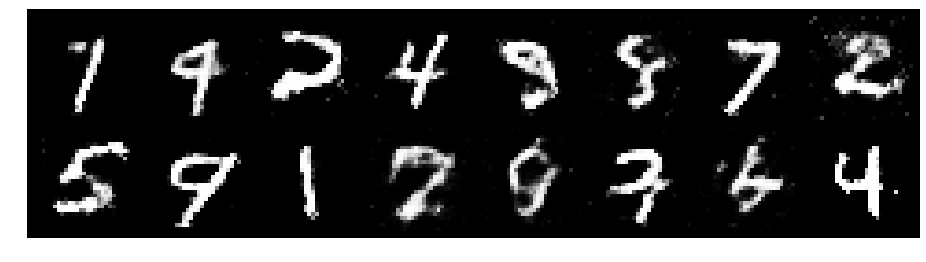

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.3257, Generator Loss: 0.9554
D(x): 0.5551, D(G(z)): 0.4612


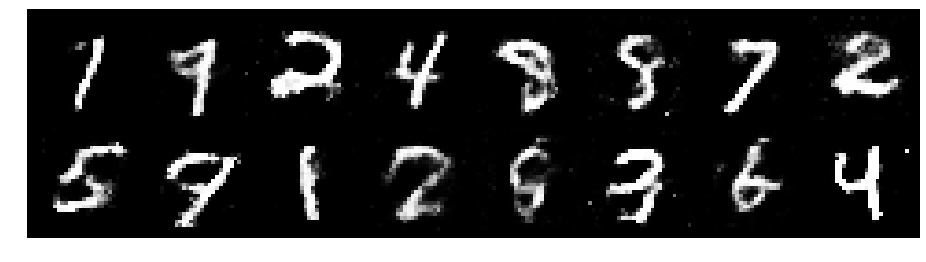

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2413, Generator Loss: 0.9373
D(x): 0.5543, D(G(z)): 0.4330


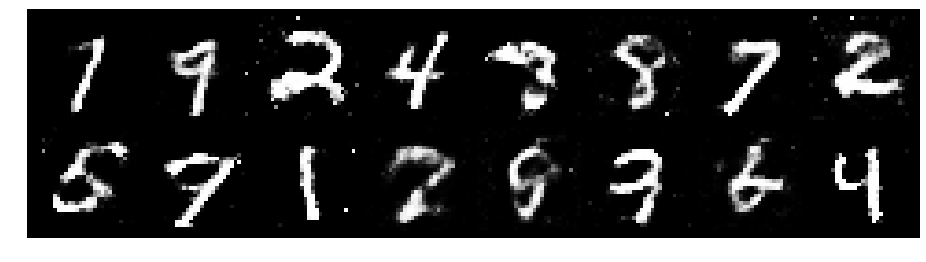

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2616, Generator Loss: 1.0430
D(x): 0.5652, D(G(z)): 0.4434


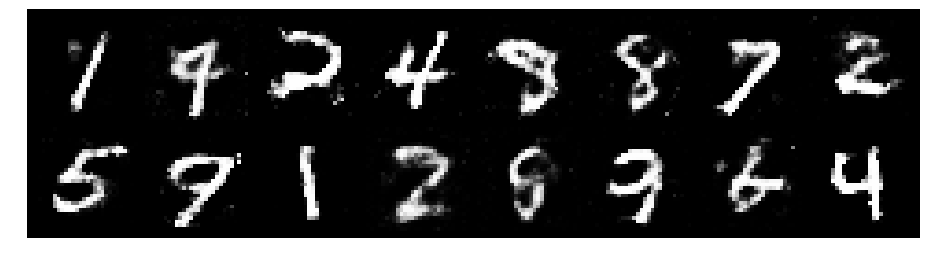

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.2647, Generator Loss: 0.8857
D(x): 0.5624, D(G(z)): 0.4657


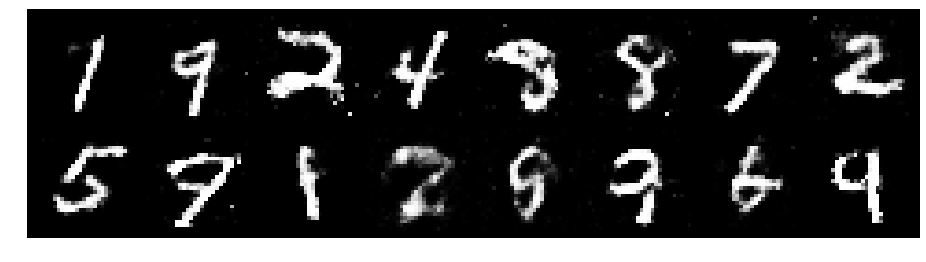

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.1740, Generator Loss: 0.9086
D(x): 0.5750, D(G(z)): 0.4290


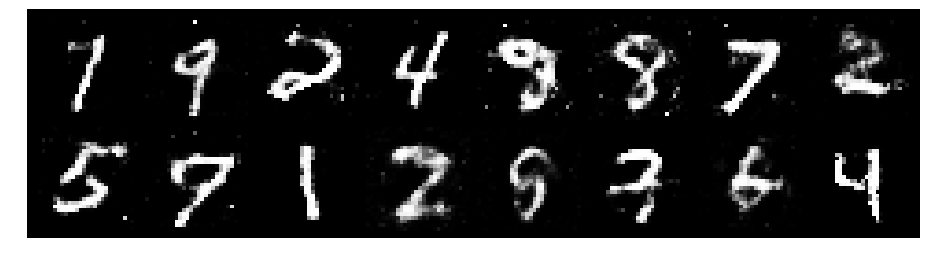

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.1586, Generator Loss: 1.0315
D(x): 0.5804, D(G(z)): 0.4204


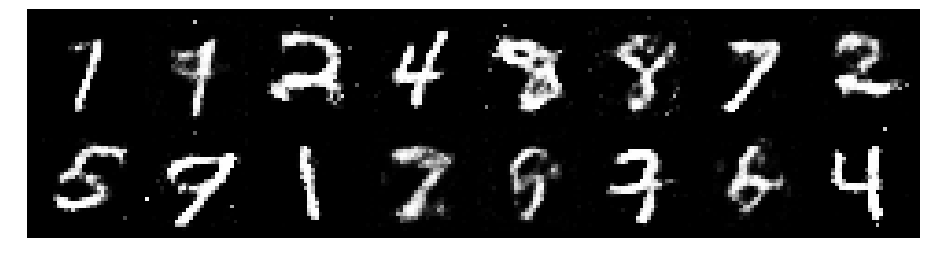

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.1854, Generator Loss: 1.0060
D(x): 0.5941, D(G(z)): 0.4295


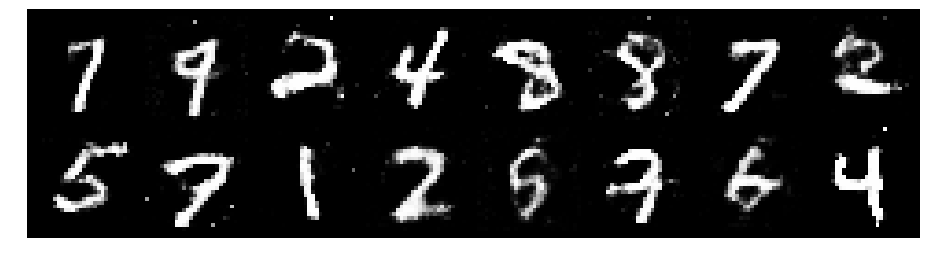

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.1298, Generator Loss: 0.9357
D(x): 0.5904, D(G(z)): 0.4194


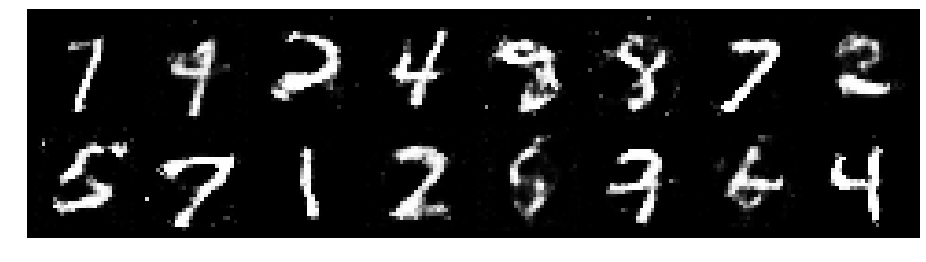

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.2865, Generator Loss: 0.8987
D(x): 0.5393, D(G(z)): 0.4457


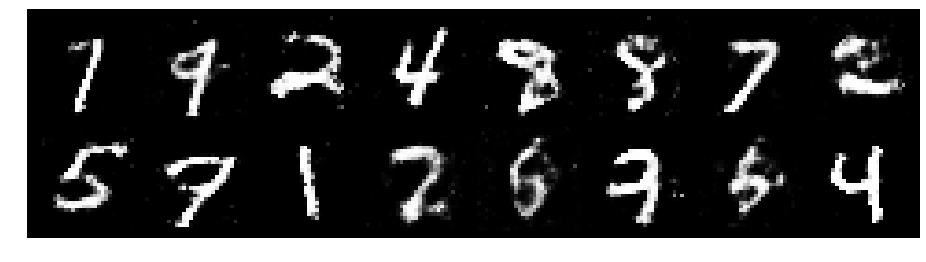

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2682, Generator Loss: 0.8403
D(x): 0.5725, D(G(z)): 0.4789


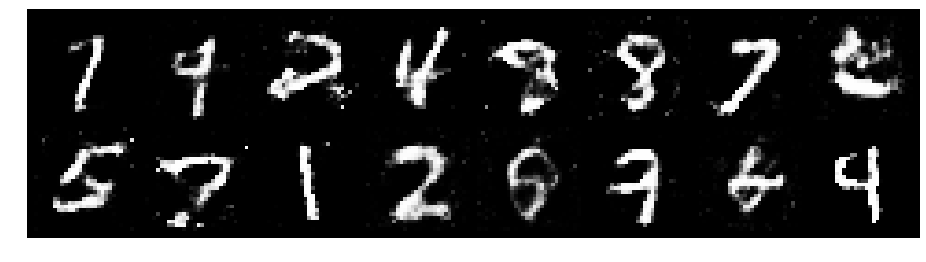

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.3541, Generator Loss: 0.9216
D(x): 0.5650, D(G(z)): 0.4787


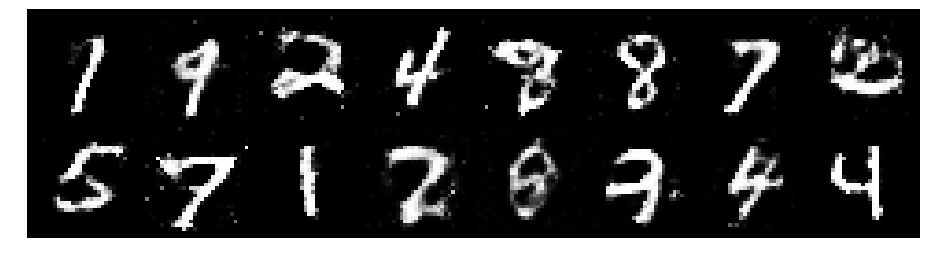

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2567, Generator Loss: 0.8433
D(x): 0.5602, D(G(z)): 0.4369


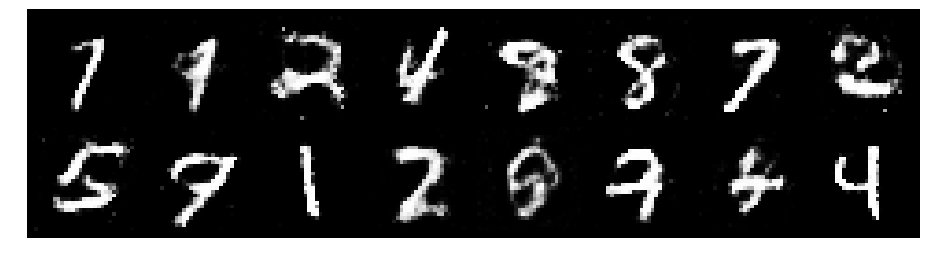

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.3022, Generator Loss: 0.7942
D(x): 0.6132, D(G(z)): 0.4786


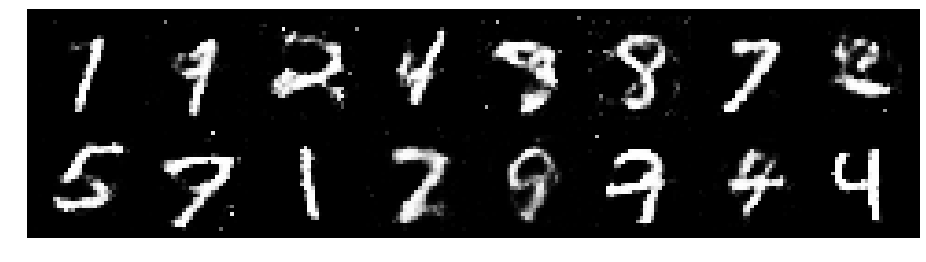

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.3627, Generator Loss: 0.8601
D(x): 0.5513, D(G(z)): 0.4704


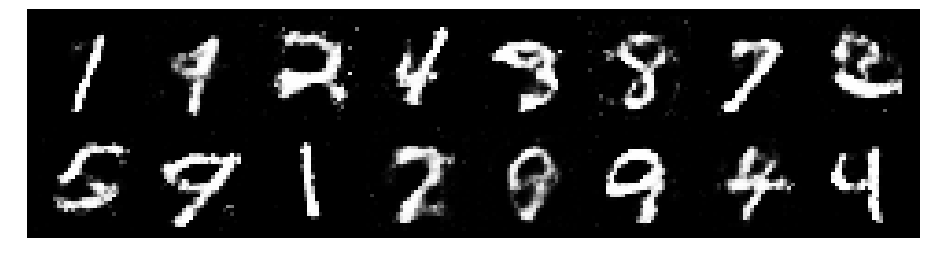

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.1774, Generator Loss: 0.9720
D(x): 0.5675, D(G(z)): 0.3973


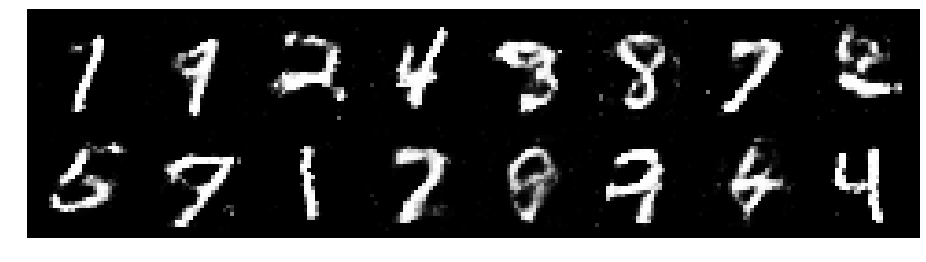

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.1446, Generator Loss: 0.9355
D(x): 0.5970, D(G(z)): 0.4101


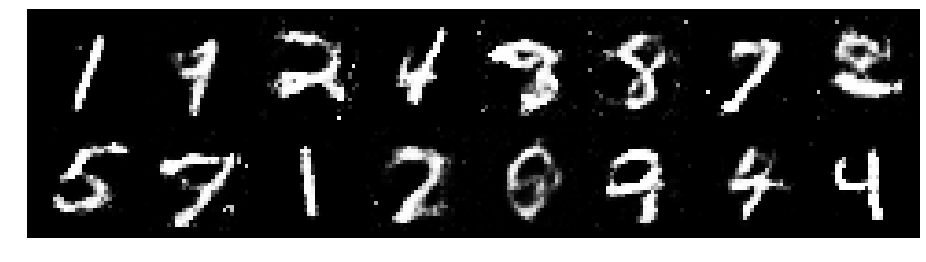

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.3026, Generator Loss: 0.8899
D(x): 0.5418, D(G(z)): 0.4455


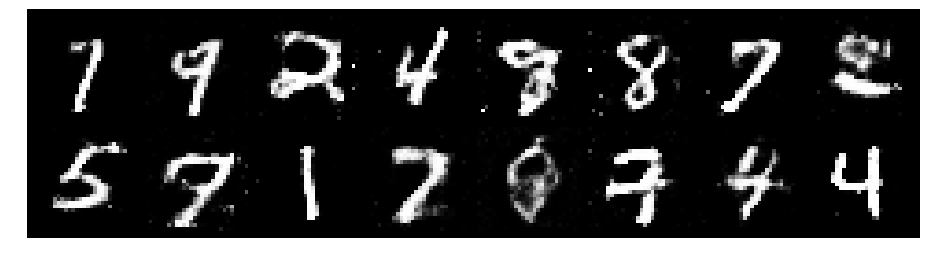

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.1844, Generator Loss: 0.8727
D(x): 0.5645, D(G(z)): 0.4265


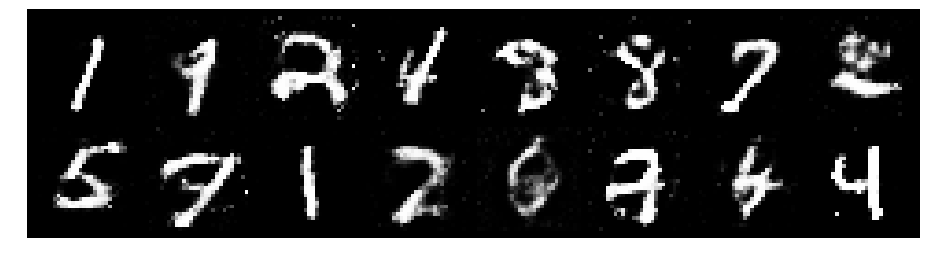

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2313, Generator Loss: 0.8493
D(x): 0.5598, D(G(z)): 0.4272


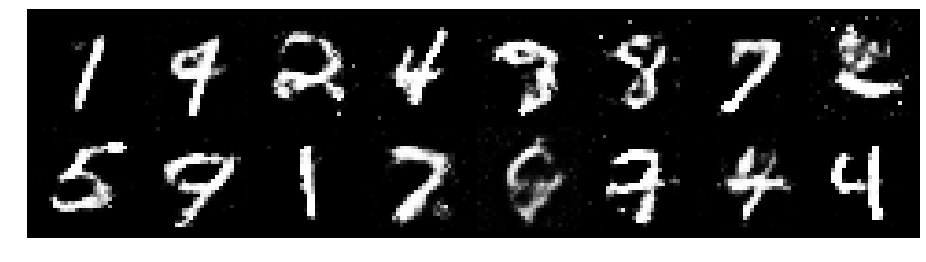

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.3082, Generator Loss: 0.9476
D(x): 0.5146, D(G(z)): 0.4327


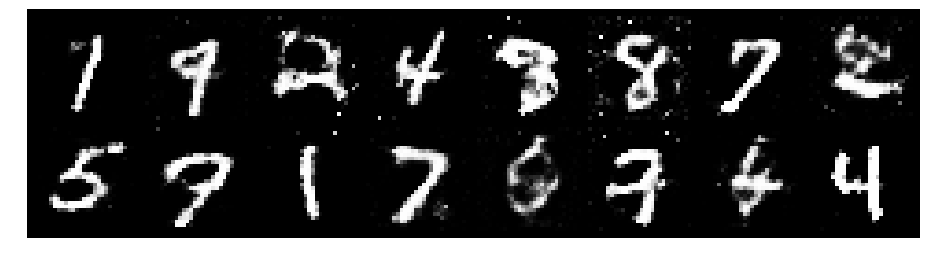

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2850, Generator Loss: 0.8688
D(x): 0.5729, D(G(z)): 0.4682


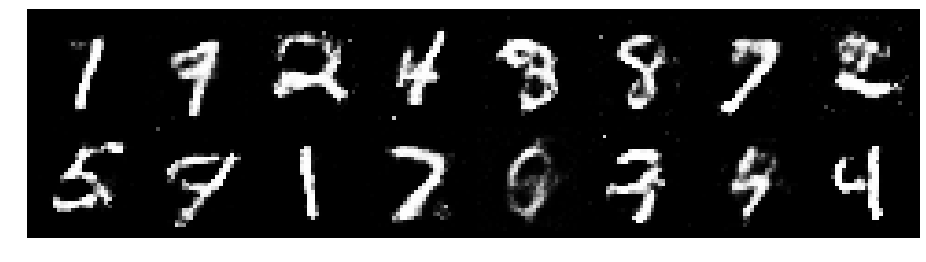

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.3110, Generator Loss: 0.8085
D(x): 0.5666, D(G(z)): 0.4808


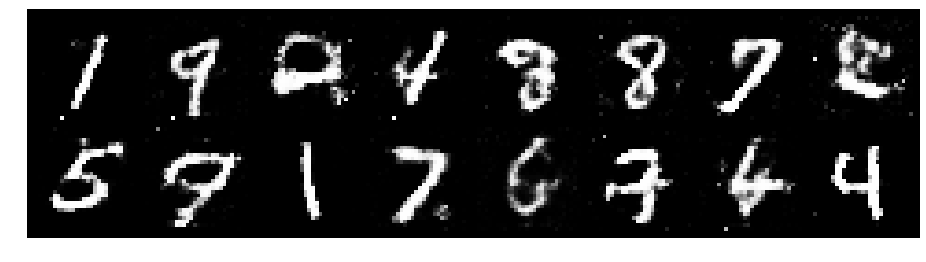

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2637, Generator Loss: 0.8371
D(x): 0.5576, D(G(z)): 0.4527


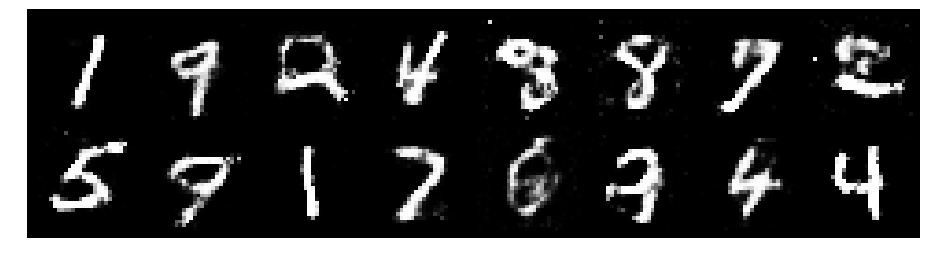

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.2244, Generator Loss: 0.8594
D(x): 0.5891, D(G(z)): 0.4664


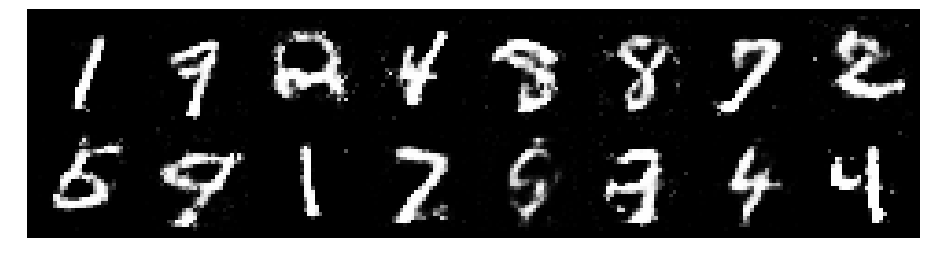

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2651, Generator Loss: 0.8539
D(x): 0.5909, D(G(z)): 0.4596


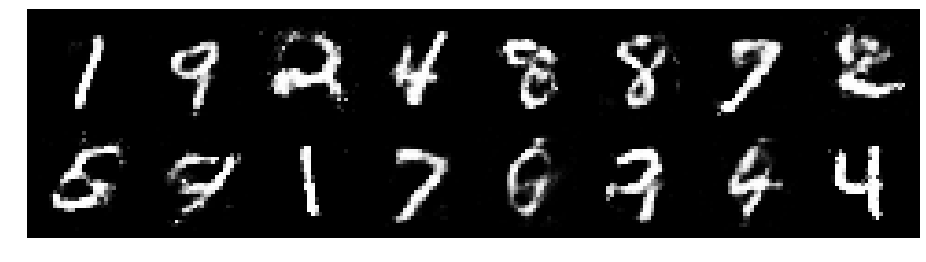

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.3429, Generator Loss: 0.8121
D(x): 0.5641, D(G(z)): 0.4901


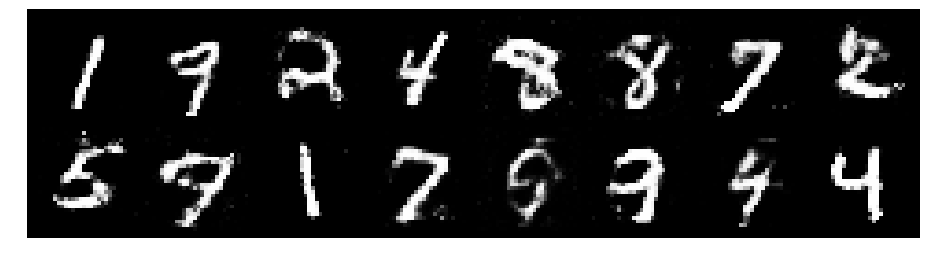

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2285, Generator Loss: 0.8163
D(x): 0.5835, D(G(z)): 0.4364


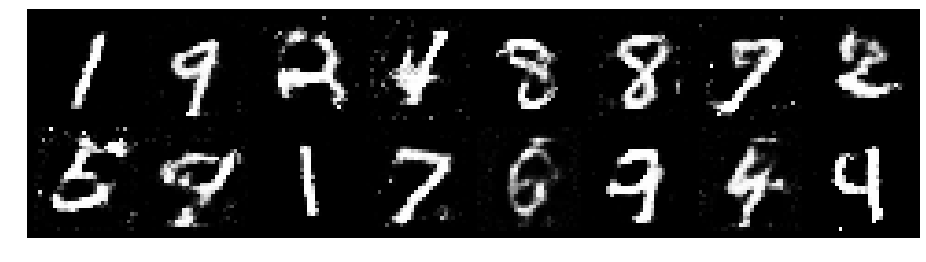

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.3082, Generator Loss: 0.7920
D(x): 0.5236, D(G(z)): 0.4535


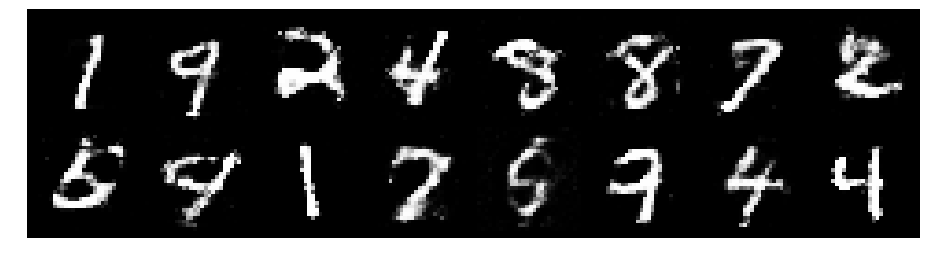

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2258, Generator Loss: 0.8553
D(x): 0.5571, D(G(z)): 0.4368


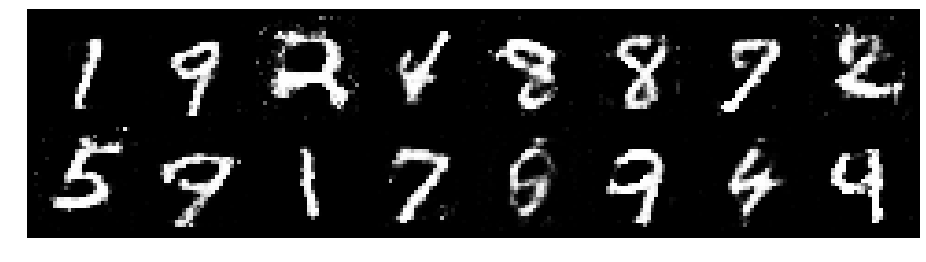

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2450, Generator Loss: 0.8707
D(x): 0.5153, D(G(z)): 0.3964


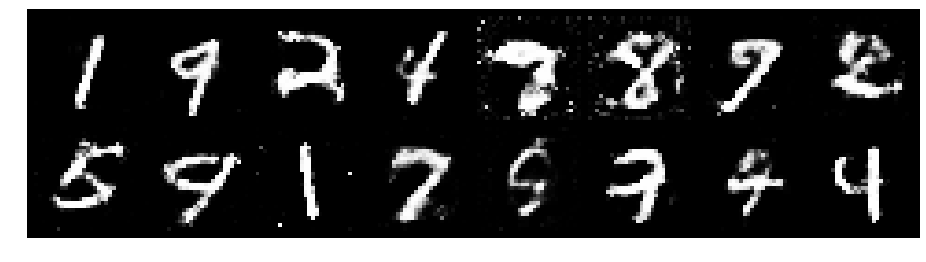

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.2424, Generator Loss: 0.9344
D(x): 0.5310, D(G(z)): 0.4139


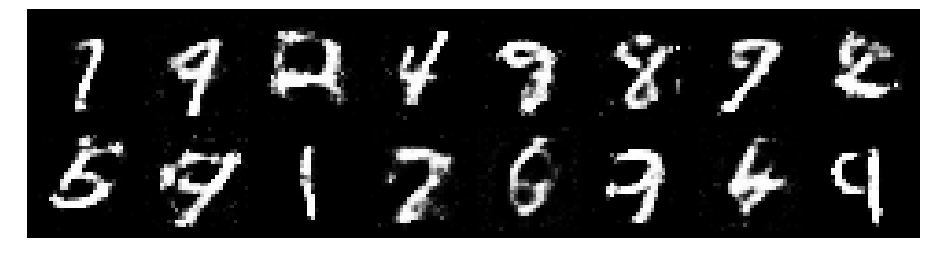

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2520, Generator Loss: 1.0475
D(x): 0.5742, D(G(z)): 0.4337


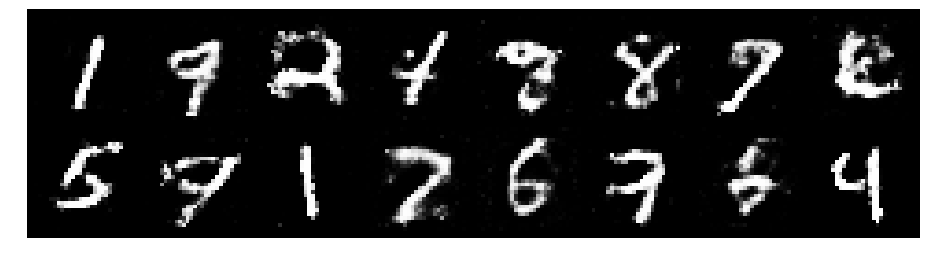

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.3390, Generator Loss: 0.8022
D(x): 0.6309, D(G(z)): 0.5164


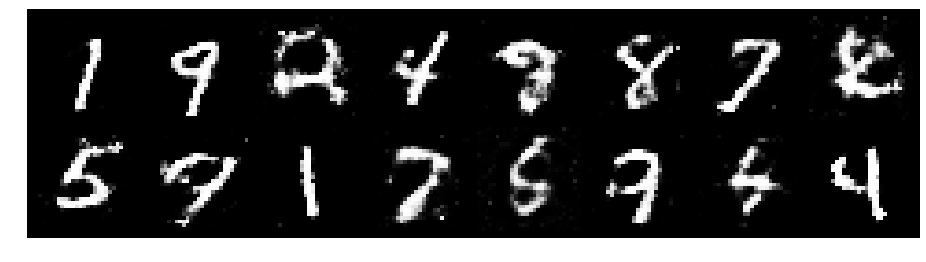

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.2826, Generator Loss: 0.9321
D(x): 0.5124, D(G(z)): 0.3979


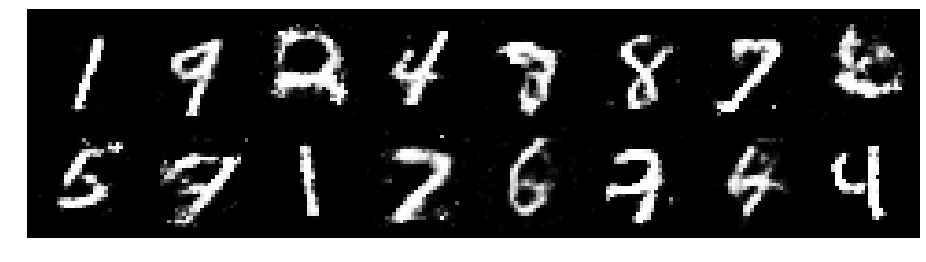

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.1579, Generator Loss: 0.9215
D(x): 0.5780, D(G(z)): 0.4142


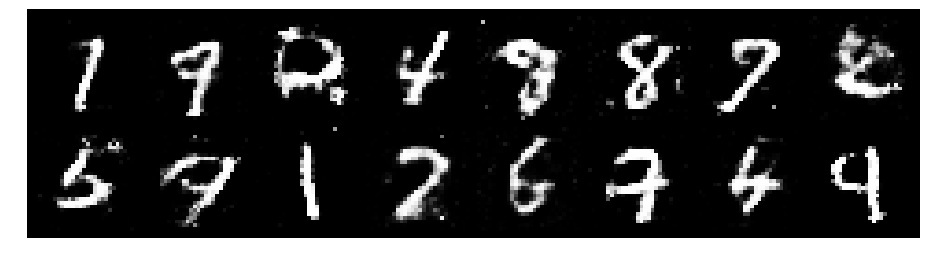

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2695, Generator Loss: 0.8817
D(x): 0.5537, D(G(z)): 0.4541


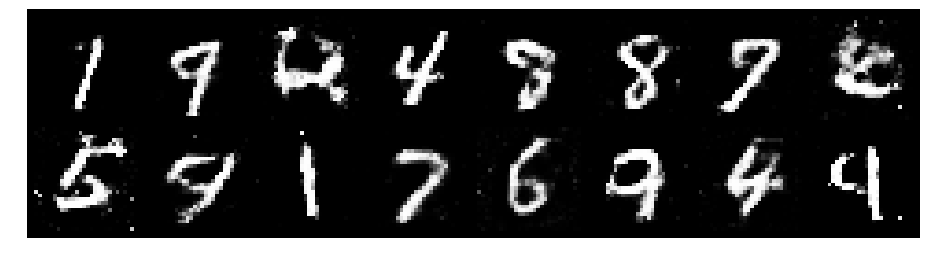

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2251, Generator Loss: 0.9847
D(x): 0.5644, D(G(z)): 0.4146


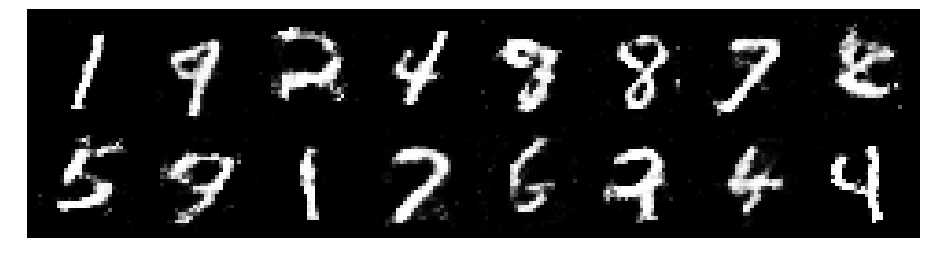

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.3516, Generator Loss: 0.8282
D(x): 0.5434, D(G(z)): 0.4735


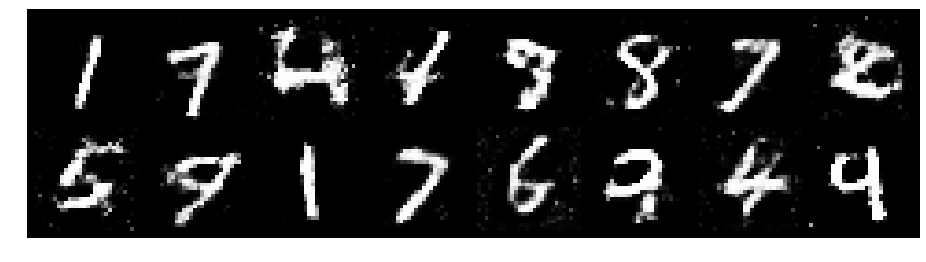

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.3248, Generator Loss: 0.8514
D(x): 0.5593, D(G(z)): 0.4632


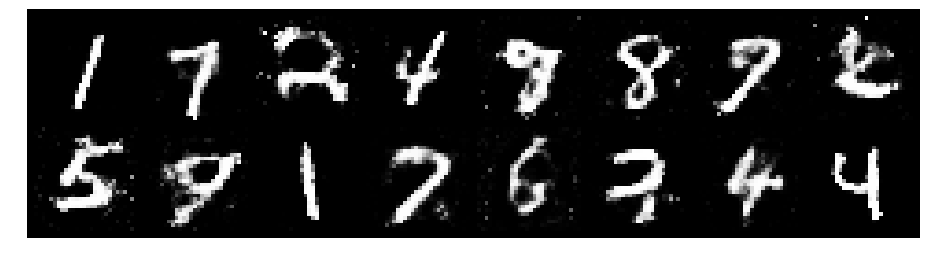

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.3122, Generator Loss: 0.8987
D(x): 0.5441, D(G(z)): 0.4635


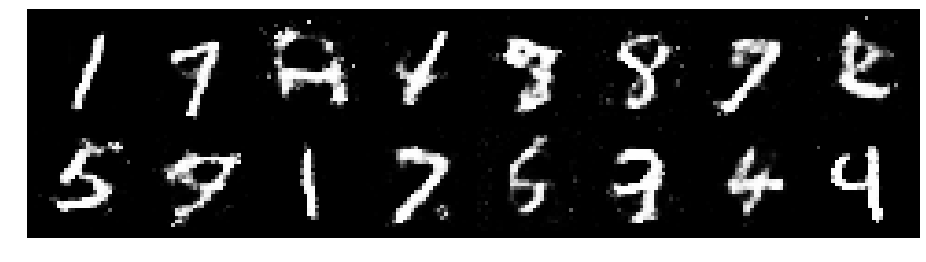

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.2528, Generator Loss: 0.8712
D(x): 0.5466, D(G(z)): 0.4310


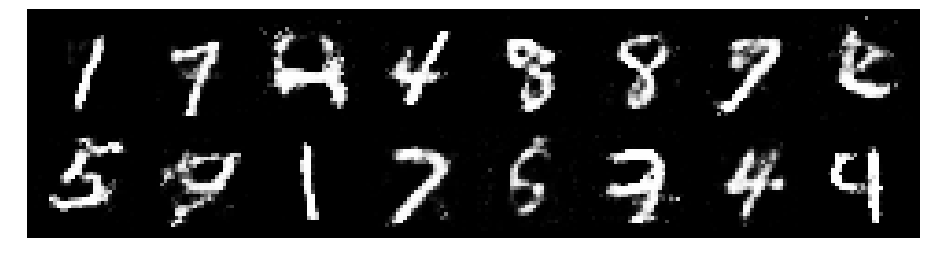

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2629, Generator Loss: 0.7929
D(x): 0.5411, D(G(z)): 0.4463


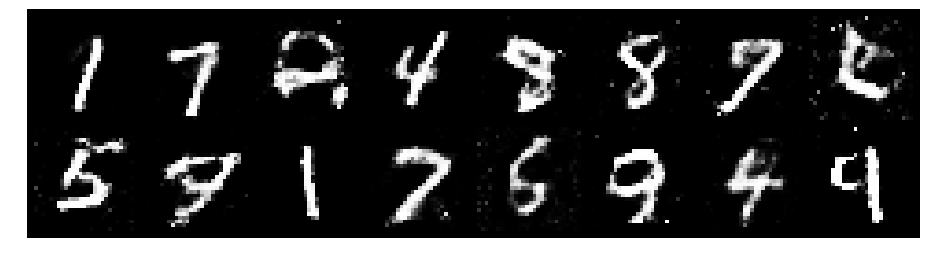

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.3440, Generator Loss: 0.8715
D(x): 0.5259, D(G(z)): 0.4580


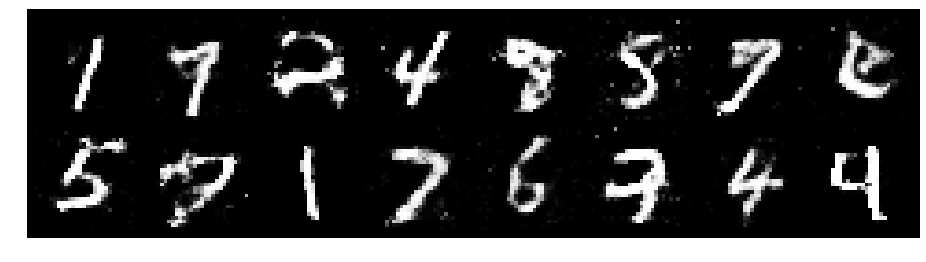

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.1832, Generator Loss: 0.9625
D(x): 0.5825, D(G(z)): 0.4036


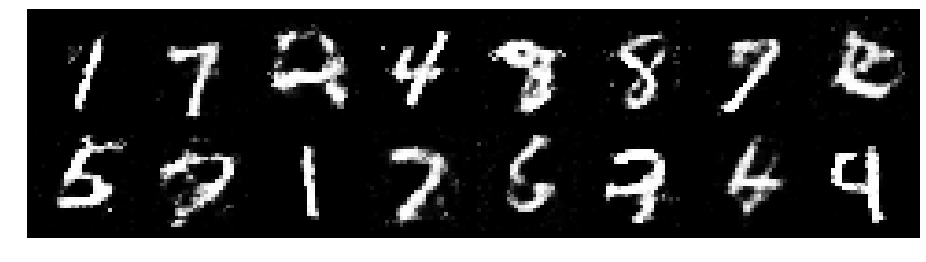

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.3000, Generator Loss: 0.7749
D(x): 0.5592, D(G(z)): 0.4705


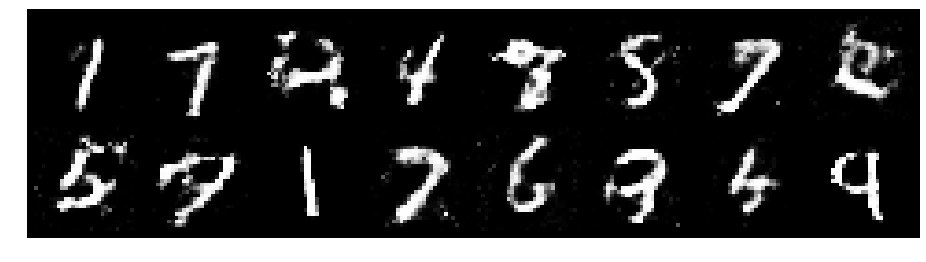

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2505, Generator Loss: 0.8083
D(x): 0.5465, D(G(z)): 0.4415


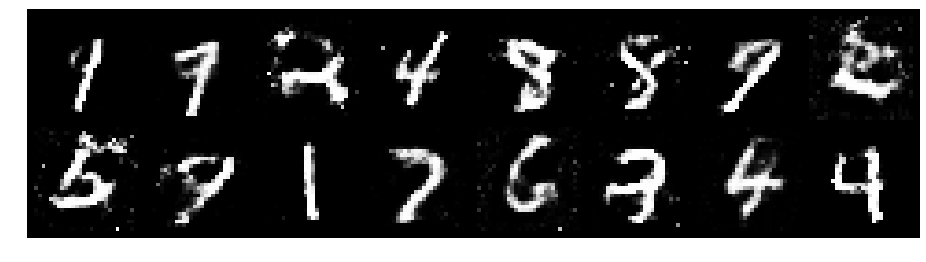

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.1623, Generator Loss: 0.9533
D(x): 0.5749, D(G(z)): 0.4115


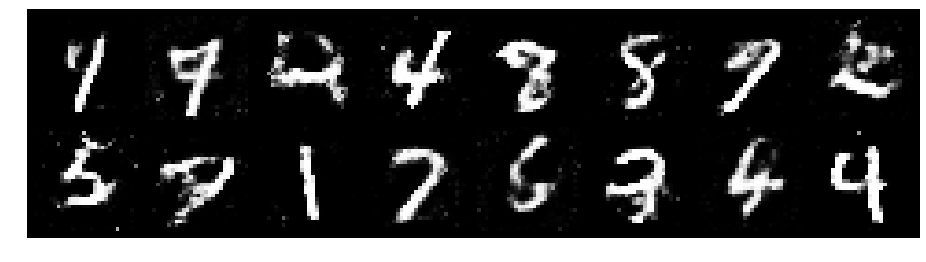

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2838, Generator Loss: 0.8578
D(x): 0.5452, D(G(z)): 0.4369


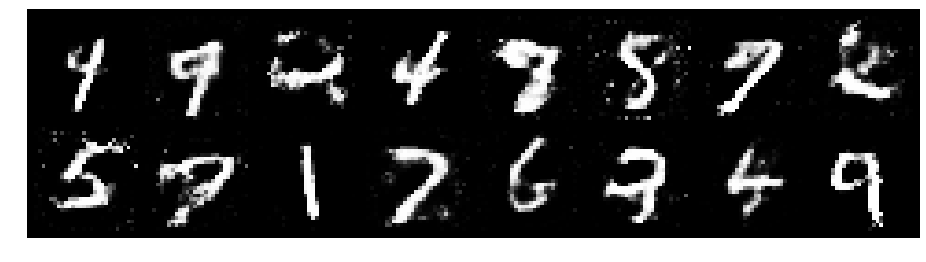

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2692, Generator Loss: 0.8447
D(x): 0.5422, D(G(z)): 0.4401


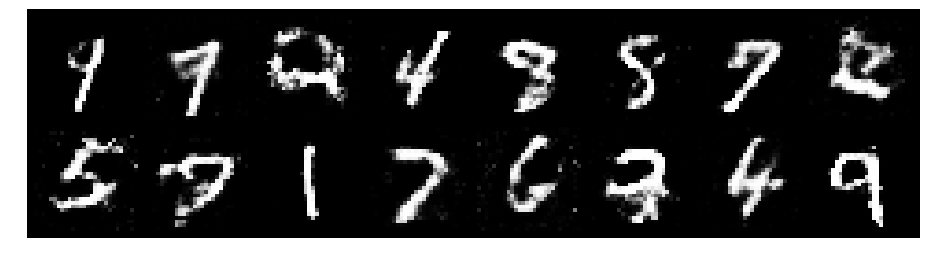

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8411
D(x): 0.5517, D(G(z)): 0.4612


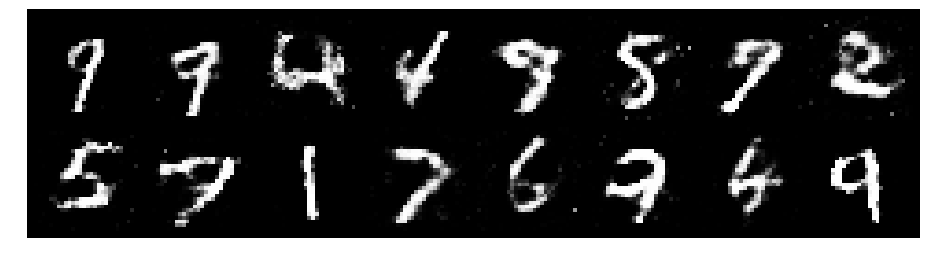

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.2906, Generator Loss: 0.8003
D(x): 0.5347, D(G(z)): 0.4578


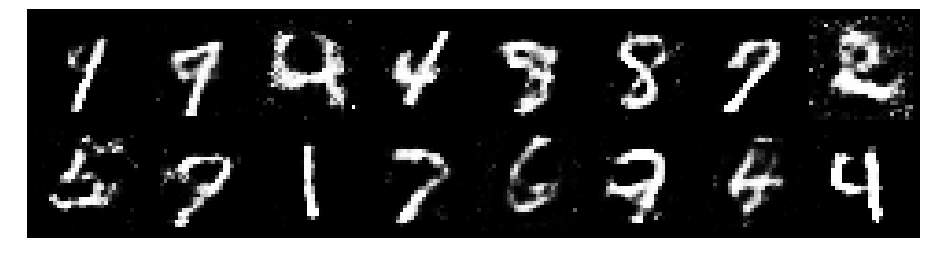

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3247, Generator Loss: 0.9927
D(x): 0.5256, D(G(z)): 0.4269


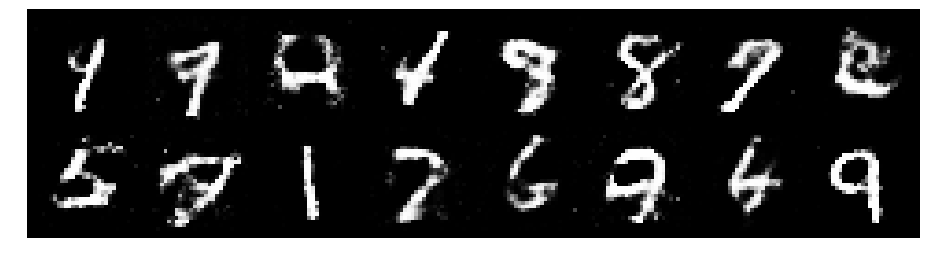

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2801, Generator Loss: 0.9029
D(x): 0.5337, D(G(z)): 0.4148


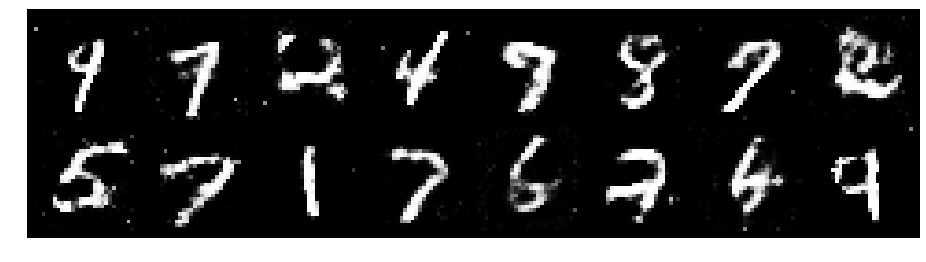

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.1280, Generator Loss: 0.8600
D(x): 0.6138, D(G(z)): 0.4378


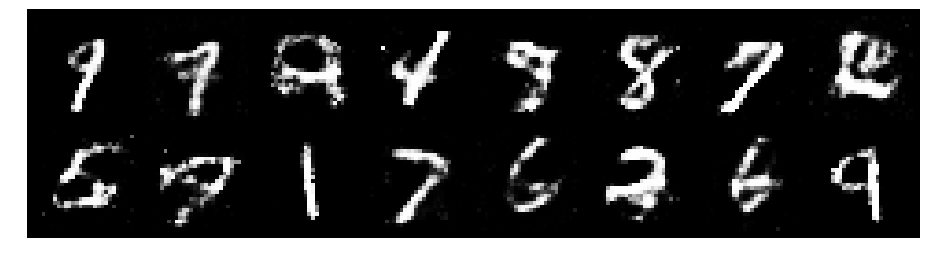

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.3142, Generator Loss: 0.8939
D(x): 0.5554, D(G(z)): 0.4721


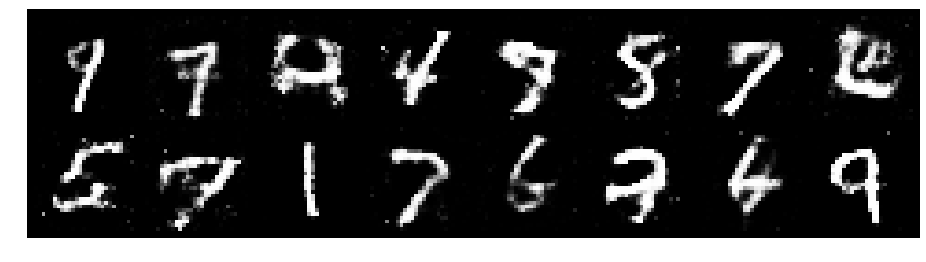

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.3002, Generator Loss: 0.8296
D(x): 0.5674, D(G(z)): 0.4810


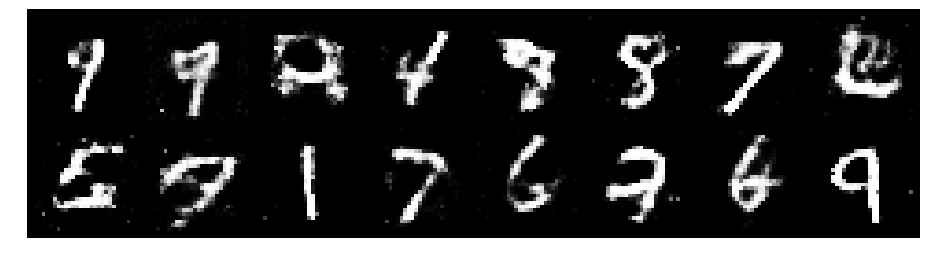

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.1515, Generator Loss: 0.9897
D(x): 0.5795, D(G(z)): 0.4033


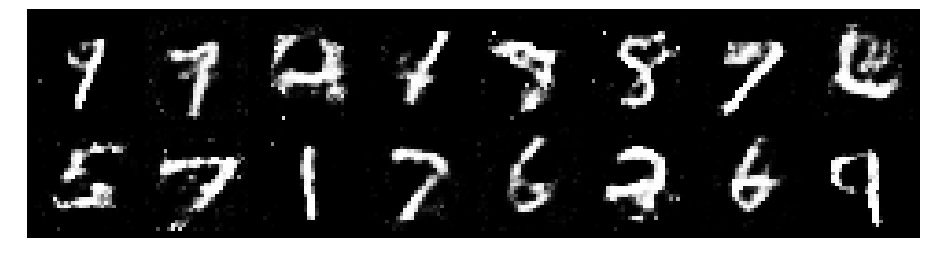

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.3311, Generator Loss: 0.7502
D(x): 0.5668, D(G(z)): 0.4843


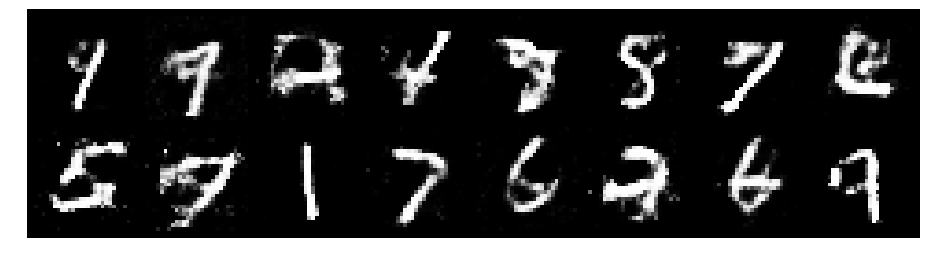

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2391, Generator Loss: 0.9299
D(x): 0.5509, D(G(z)): 0.4160


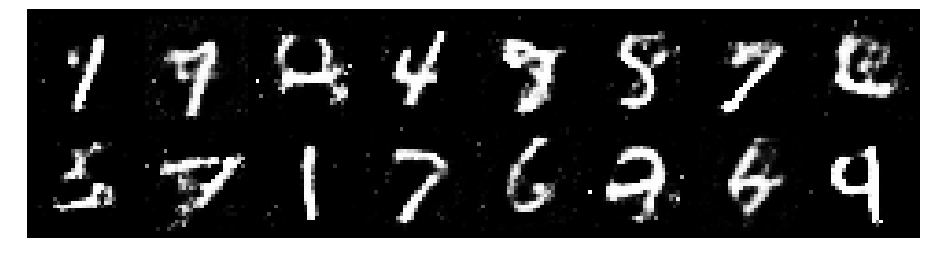

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2825, Generator Loss: 0.9058
D(x): 0.5466, D(G(z)): 0.4500


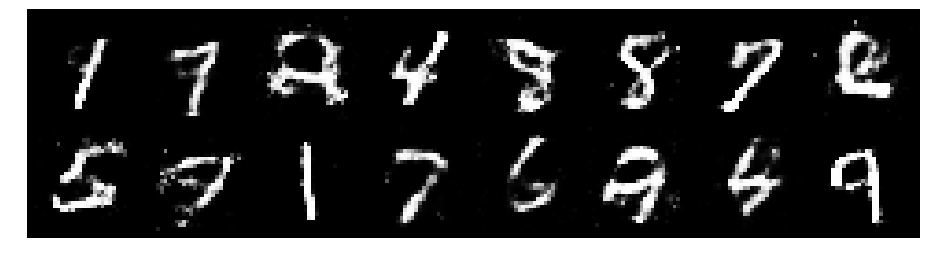

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.2050, Generator Loss: 0.8935
D(x): 0.5634, D(G(z)): 0.4319


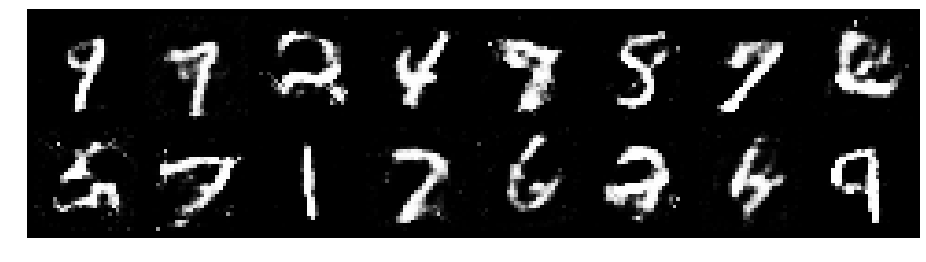

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2977, Generator Loss: 0.9834
D(x): 0.5314, D(G(z)): 0.4135


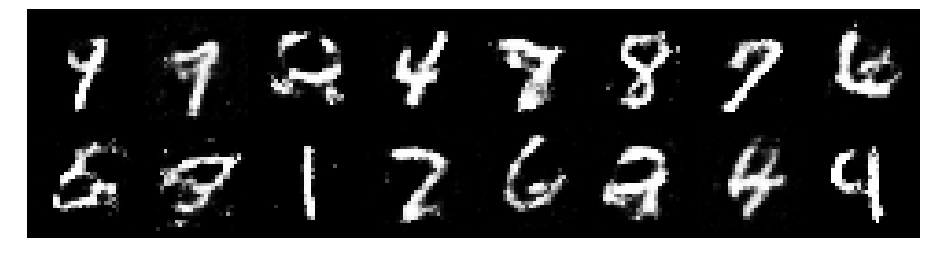

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2654, Generator Loss: 0.9174
D(x): 0.5369, D(G(z)): 0.4227


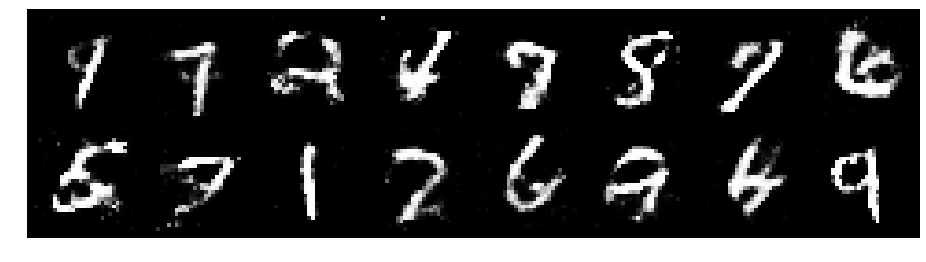

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3422, Generator Loss: 0.8132
D(x): 0.5138, D(G(z)): 0.4414


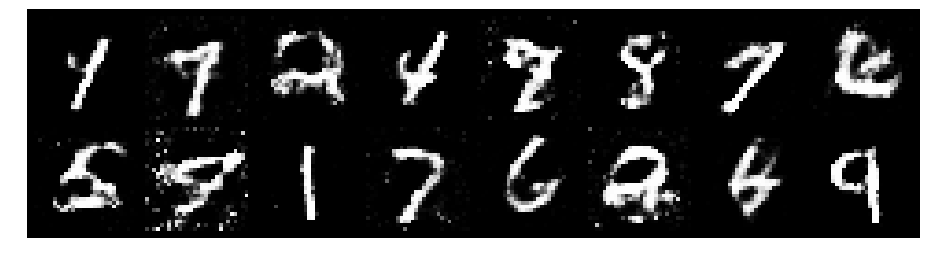

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.3519, Generator Loss: 0.7525
D(x): 0.5777, D(G(z)): 0.5177


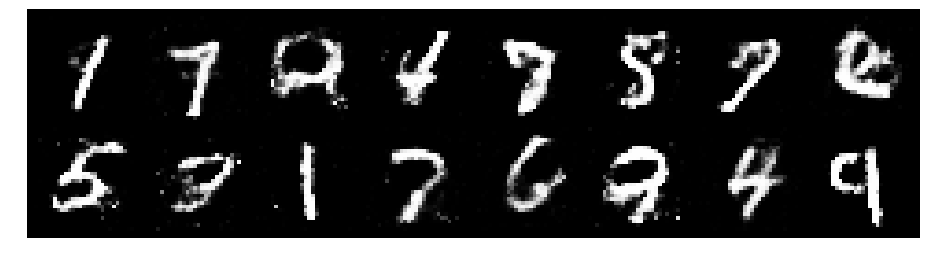

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3107, Generator Loss: 0.8476
D(x): 0.5470, D(G(z)): 0.4741


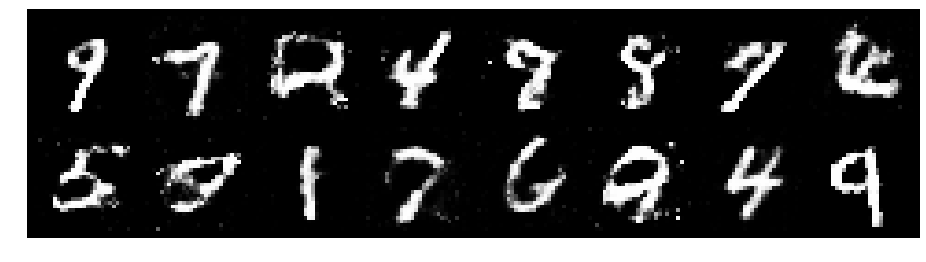

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.2673, Generator Loss: 0.8390
D(x): 0.5356, D(G(z)): 0.4442


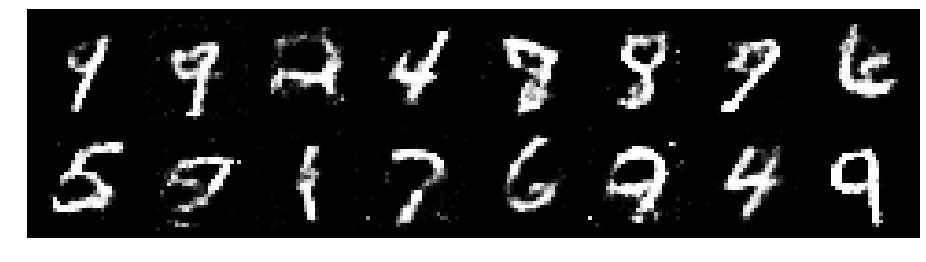

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.2592, Generator Loss: 0.8413
D(x): 0.6055, D(G(z)): 0.4852


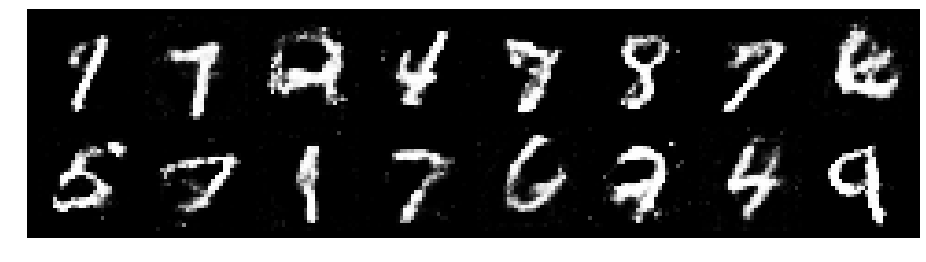

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.1586, Generator Loss: 0.8547
D(x): 0.6029, D(G(z)): 0.4340


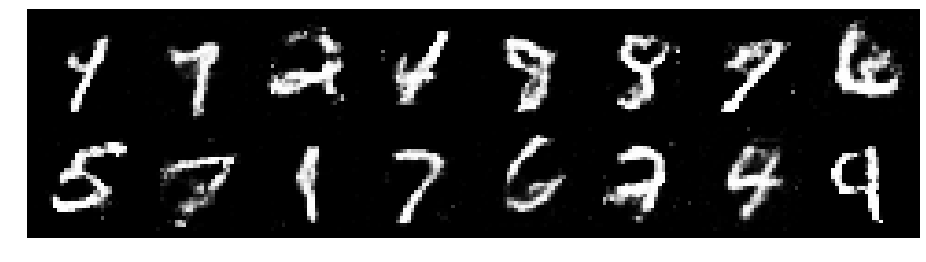

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.3006, Generator Loss: 0.8284
D(x): 0.5638, D(G(z)): 0.4730


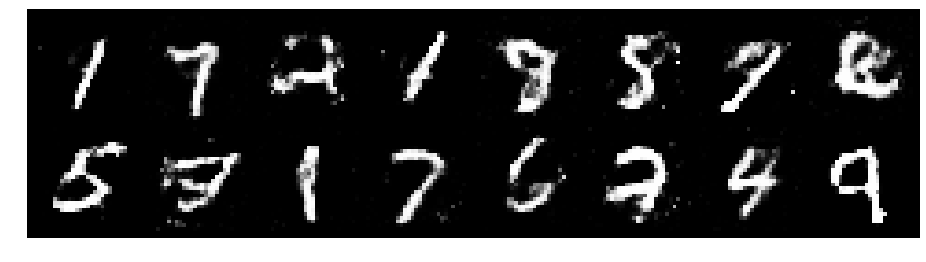

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2624, Generator Loss: 0.9096
D(x): 0.5578, D(G(z)): 0.4472


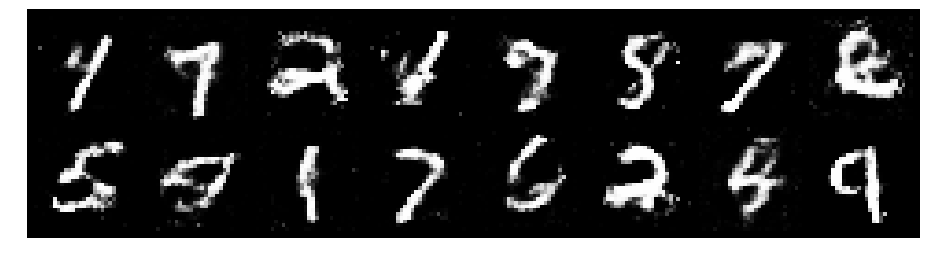

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.1939, Generator Loss: 0.9135
D(x): 0.5787, D(G(z)): 0.4257


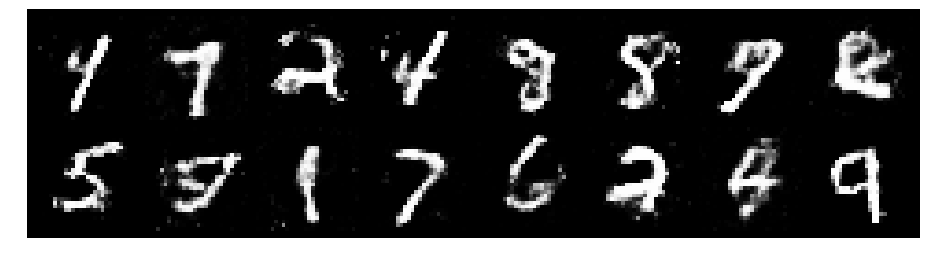

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.1666, Generator Loss: 0.9597
D(x): 0.6036, D(G(z)): 0.4415


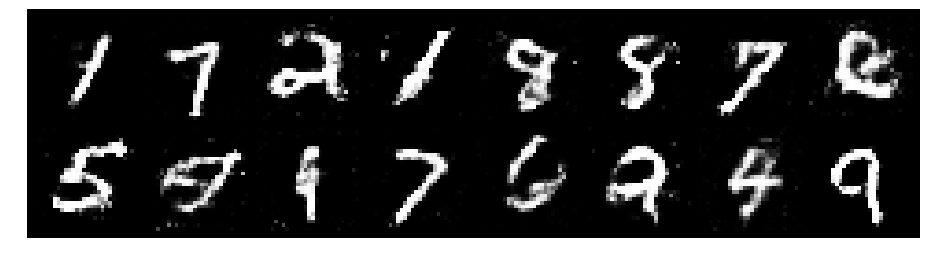

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2519, Generator Loss: 0.8773
D(x): 0.6147, D(G(z)): 0.4843


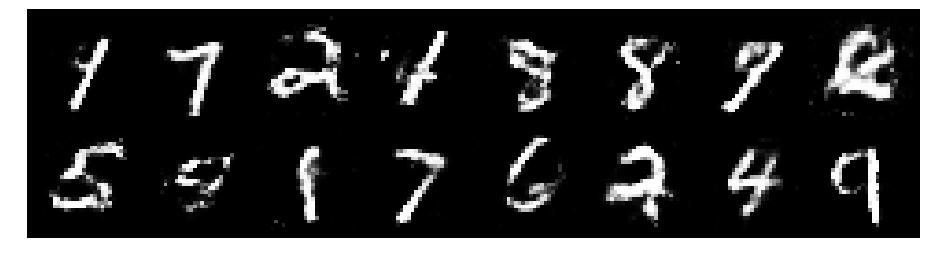

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2266, Generator Loss: 0.9054
D(x): 0.5673, D(G(z)): 0.4486


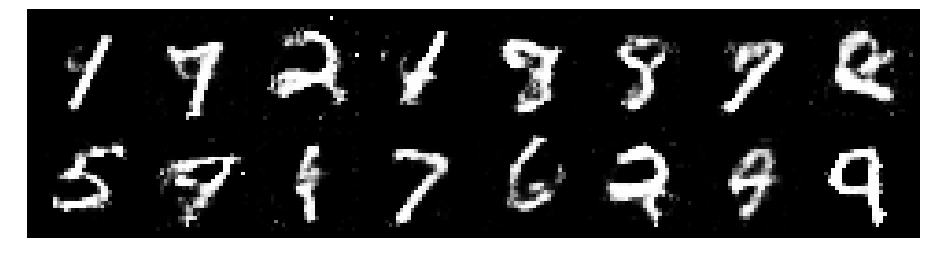

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.3932, Generator Loss: 0.9155
D(x): 0.5236, D(G(z)): 0.4808


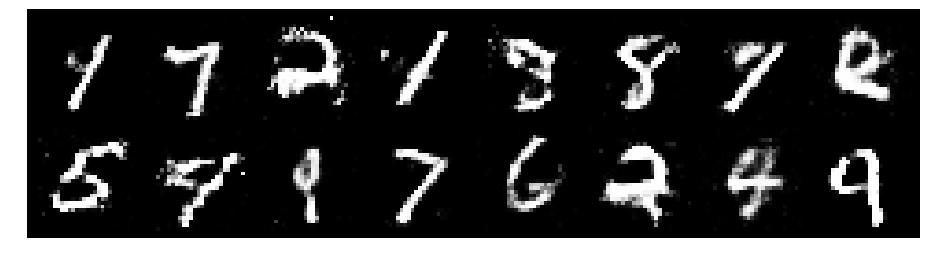

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.2152, Generator Loss: 0.9842
D(x): 0.5983, D(G(z)): 0.4445


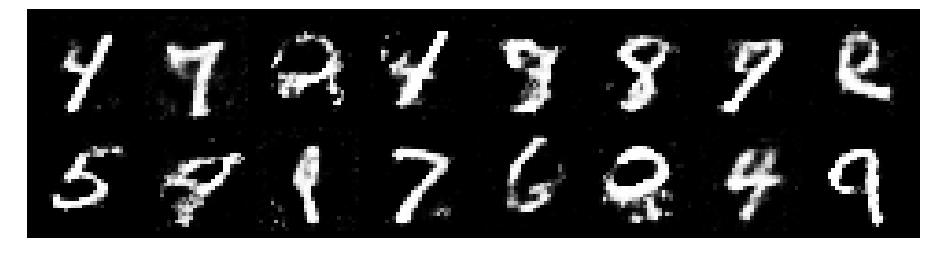

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.3377, Generator Loss: 0.8286
D(x): 0.5570, D(G(z)): 0.4748


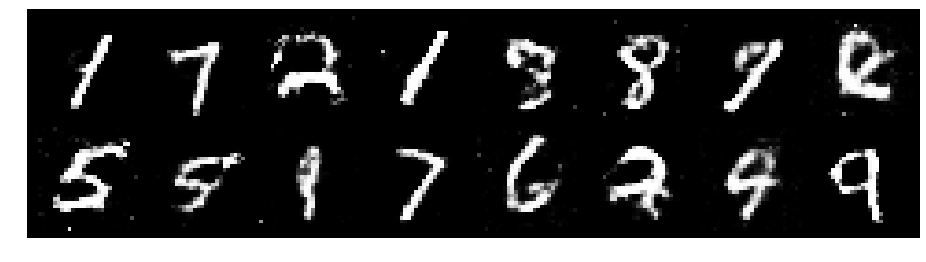

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.2429, Generator Loss: 0.9448
D(x): 0.6289, D(G(z)): 0.4769


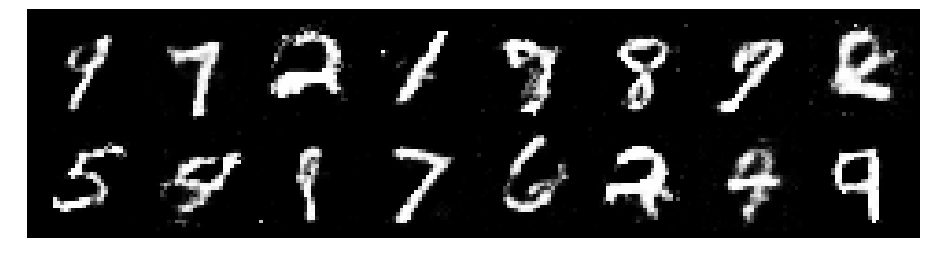

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9617
D(x): 0.5219, D(G(z)): 0.4223


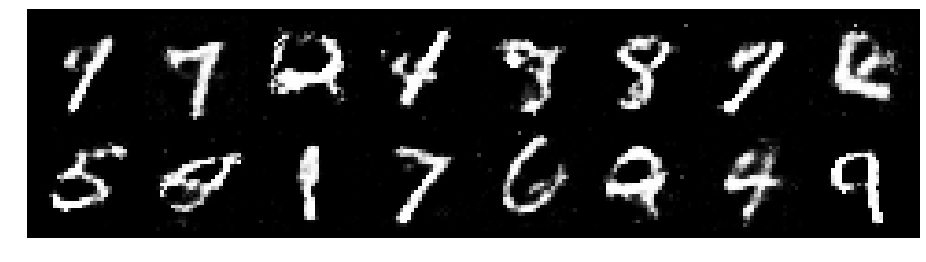

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2374, Generator Loss: 0.8138
D(x): 0.5770, D(G(z)): 0.4395


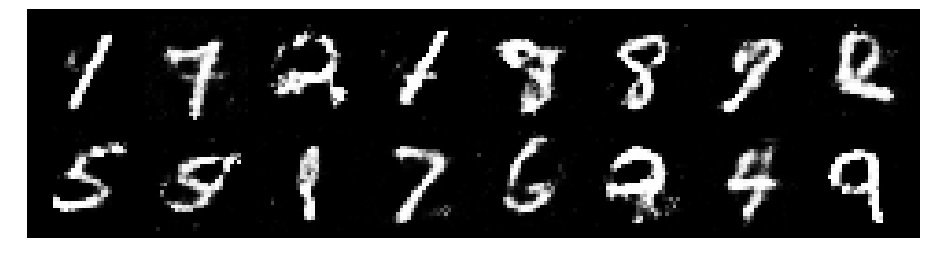

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2225, Generator Loss: 0.8928
D(x): 0.5723, D(G(z)): 0.4292


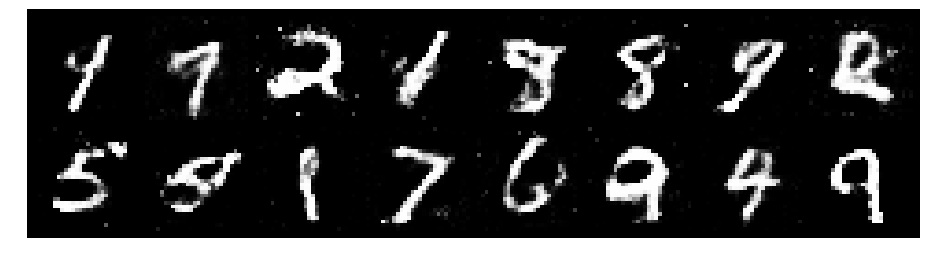

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2195, Generator Loss: 0.8562
D(x): 0.5584, D(G(z)): 0.4284


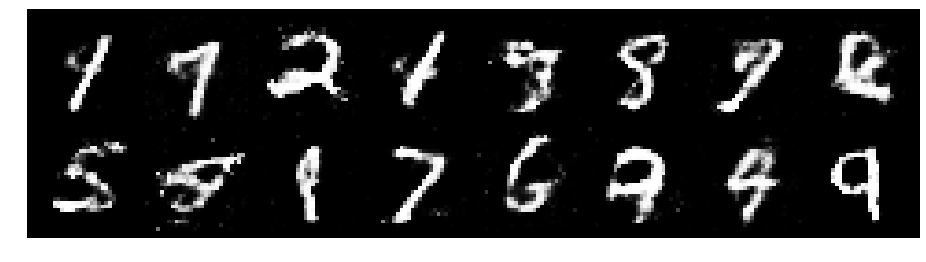

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.3089, Generator Loss: 0.9141
D(x): 0.5544, D(G(z)): 0.4459


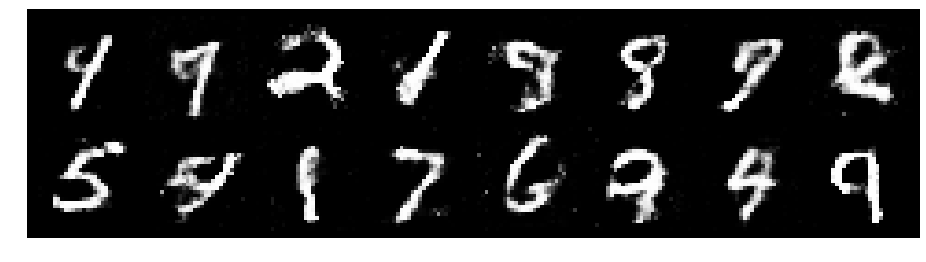

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2943, Generator Loss: 0.8797
D(x): 0.5630, D(G(z)): 0.4657


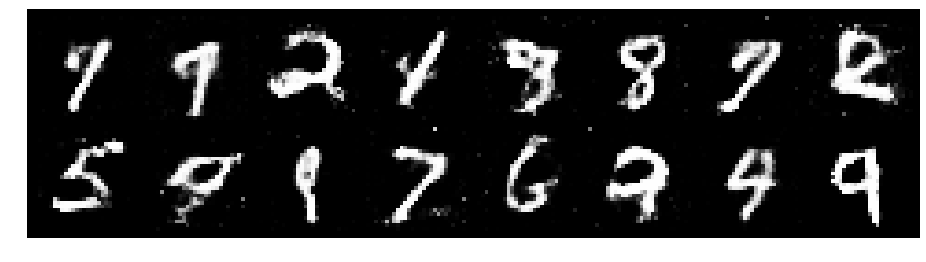

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2492, Generator Loss: 0.8852
D(x): 0.5550, D(G(z)): 0.4370


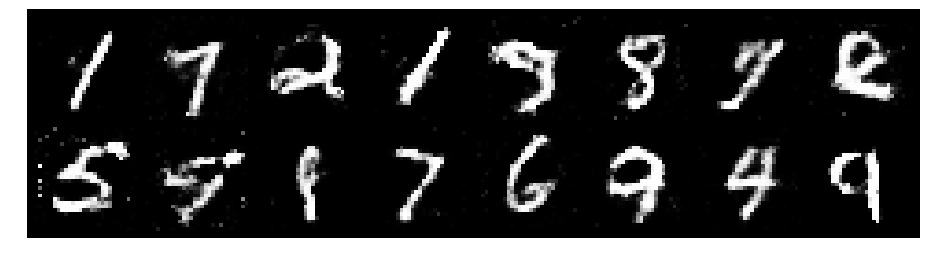

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.3429, Generator Loss: 0.8883
D(x): 0.5159, D(G(z)): 0.4416


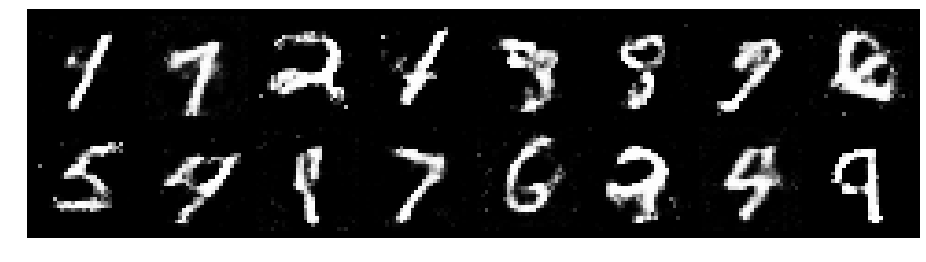

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.2951, Generator Loss: 0.8085
D(x): 0.5566, D(G(z)): 0.4673


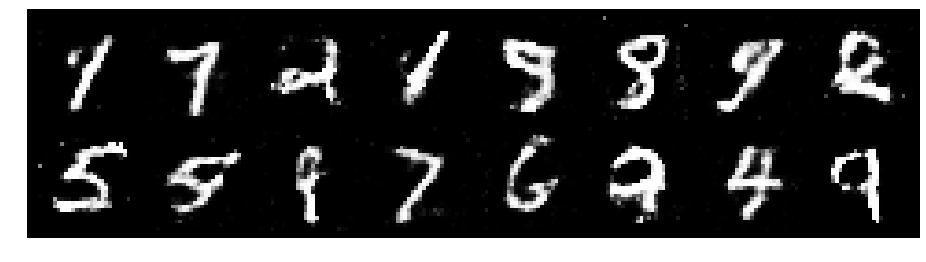

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.3450, Generator Loss: 0.7891
D(x): 0.5444, D(G(z)): 0.4828


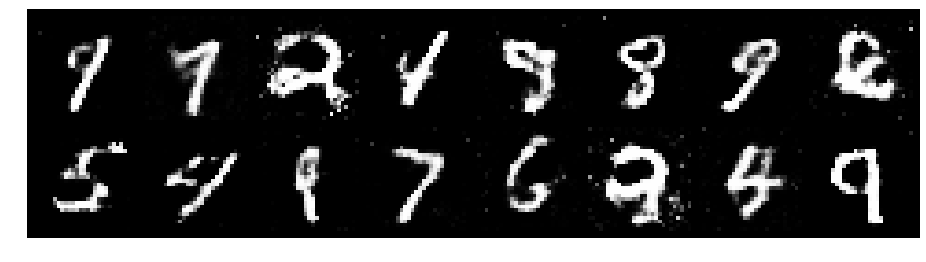

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2496, Generator Loss: 0.8833
D(x): 0.5395, D(G(z)): 0.4125


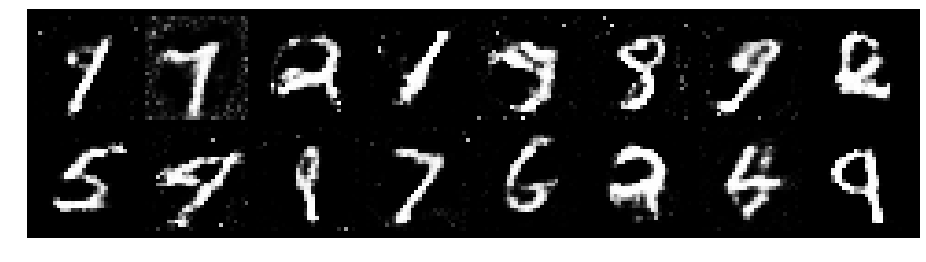

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.4043, Generator Loss: 0.9240
D(x): 0.4646, D(G(z)): 0.4252


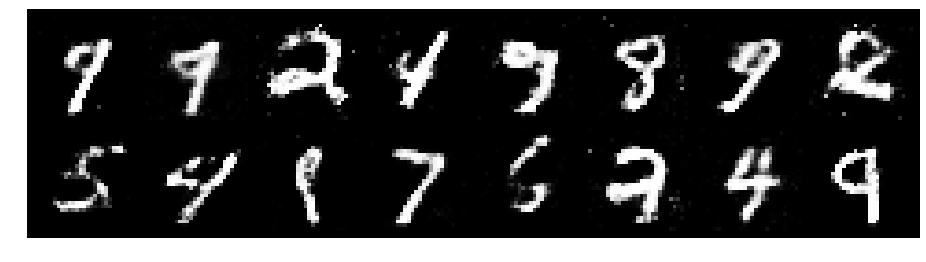

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2141, Generator Loss: 0.9045
D(x): 0.5698, D(G(z)): 0.4326


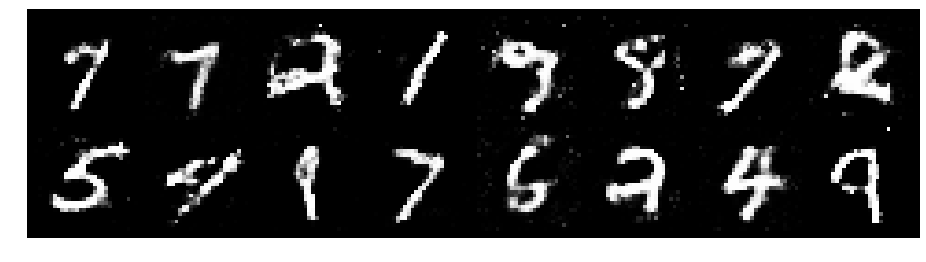

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2805, Generator Loss: 0.8545
D(x): 0.5468, D(G(z)): 0.4636


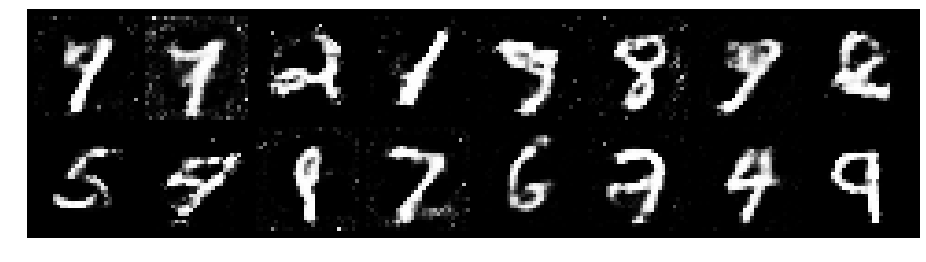

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2504, Generator Loss: 0.9419
D(x): 0.5564, D(G(z)): 0.4363


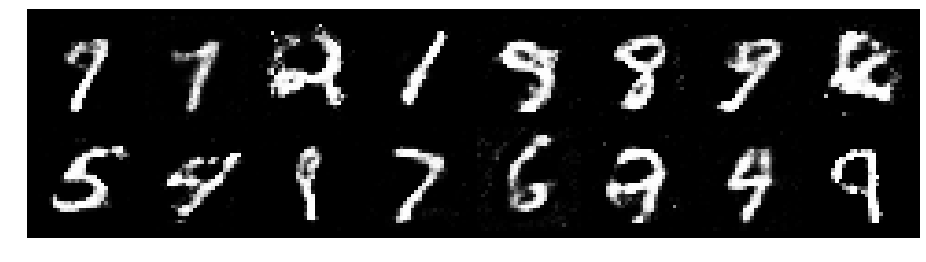

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.2402, Generator Loss: 0.8258
D(x): 0.5444, D(G(z)): 0.4283


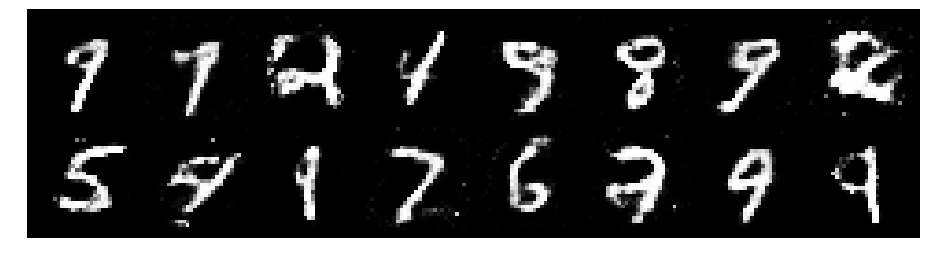

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.1957, Generator Loss: 0.9329
D(x): 0.5406, D(G(z)): 0.3999


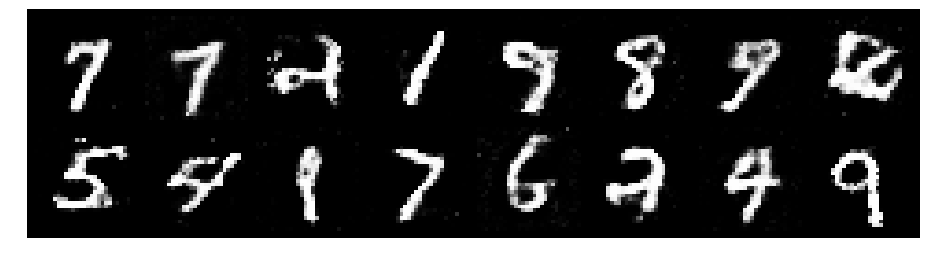

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2849, Generator Loss: 0.9011
D(x): 0.5677, D(G(z)): 0.4694


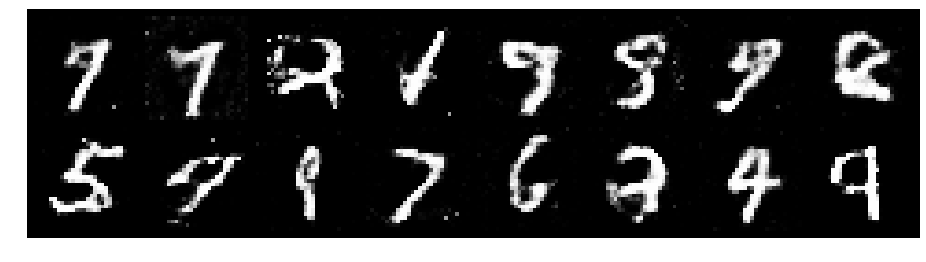

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2845, Generator Loss: 0.8899
D(x): 0.5845, D(G(z)): 0.4856


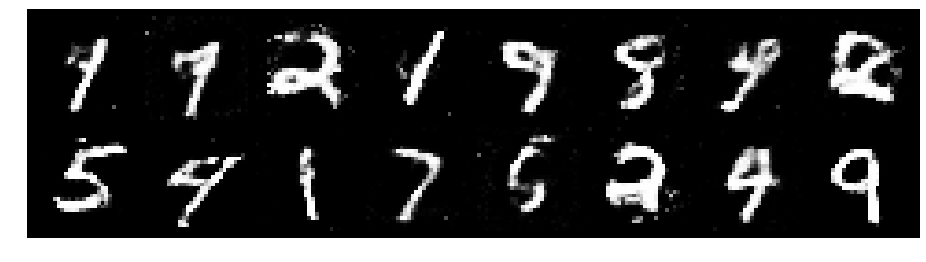

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.0671, Generator Loss: 1.0475
D(x): 0.6039, D(G(z)): 0.3804


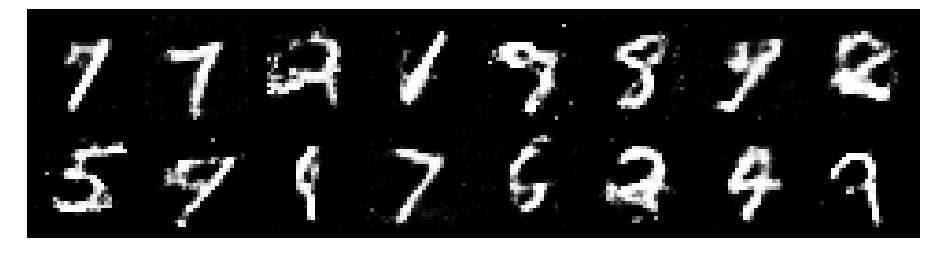

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2843, Generator Loss: 0.9858
D(x): 0.5392, D(G(z)): 0.4249


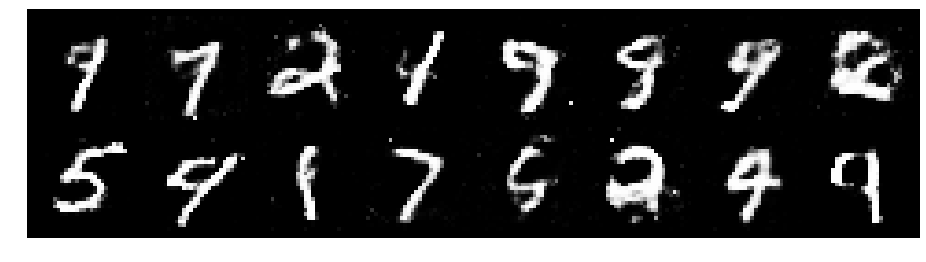

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2473, Generator Loss: 1.1031
D(x): 0.5444, D(G(z)): 0.4126


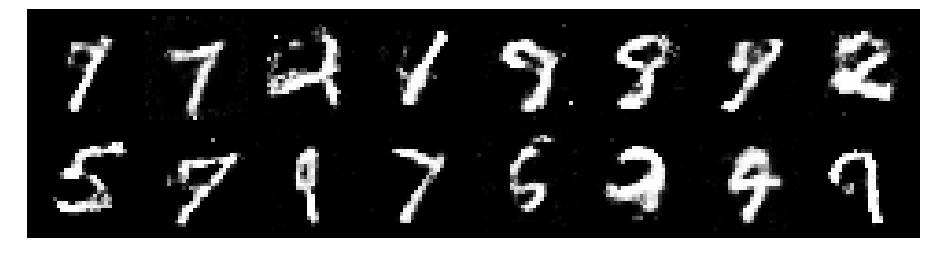

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.1229, Generator Loss: 0.9462
D(x): 0.6124, D(G(z)): 0.4254


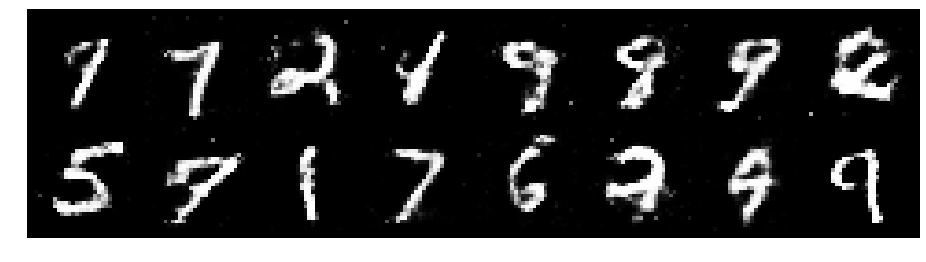

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2229, Generator Loss: 0.8842
D(x): 0.5451, D(G(z)): 0.4221


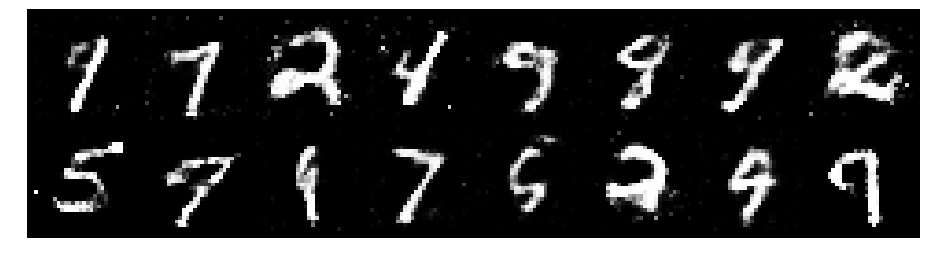

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2922, Generator Loss: 0.8502
D(x): 0.5157, D(G(z)): 0.4309


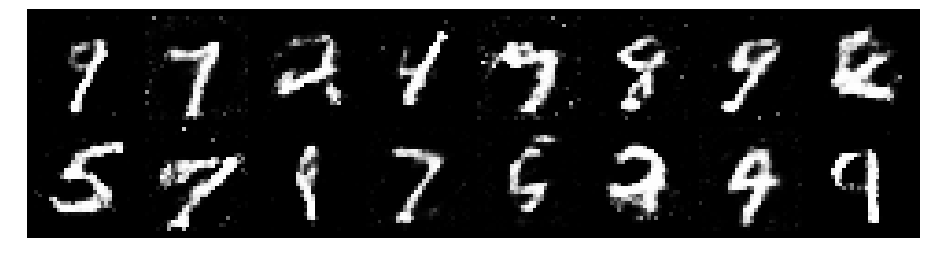

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.3002, Generator Loss: 1.0007
D(x): 0.5641, D(G(z)): 0.4431


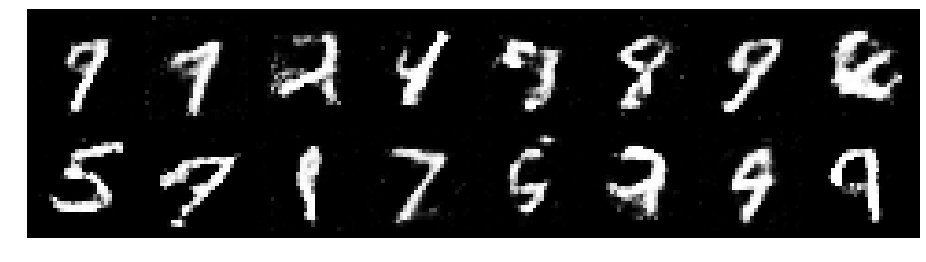

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2746, Generator Loss: 0.8580
D(x): 0.5848, D(G(z)): 0.4632


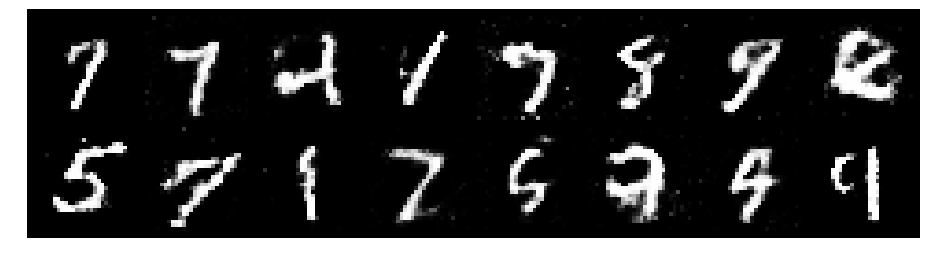

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.3670, Generator Loss: 0.8768
D(x): 0.5596, D(G(z)): 0.4795


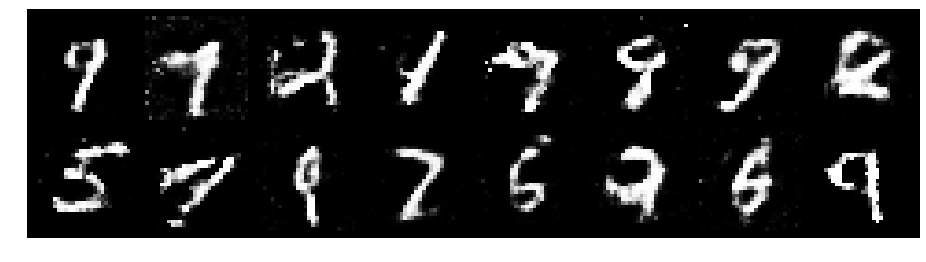

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.3095, Generator Loss: 0.8220
D(x): 0.5318, D(G(z)): 0.4604


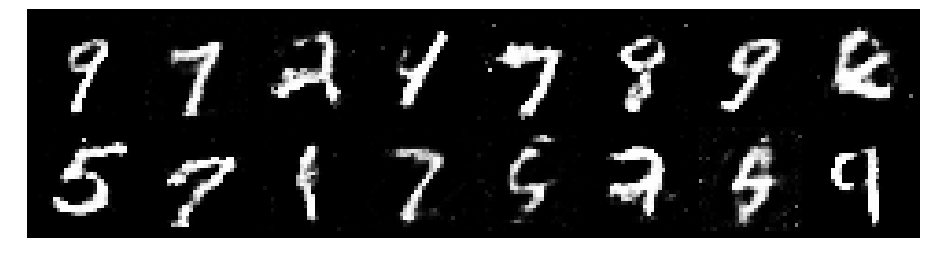

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.2628, Generator Loss: 0.9238
D(x): 0.5578, D(G(z)): 0.4368


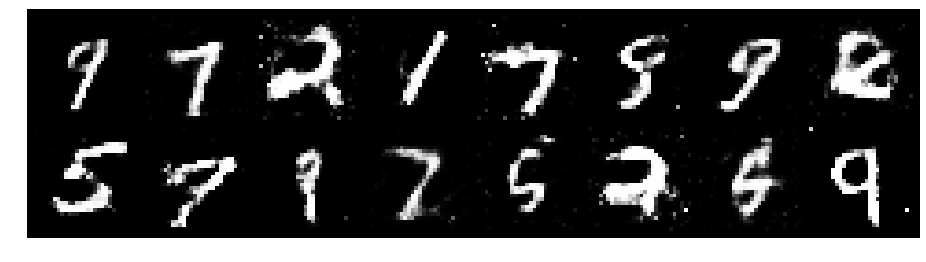

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.4677, Generator Loss: 0.9483
D(x): 0.5757, D(G(z)): 0.5224


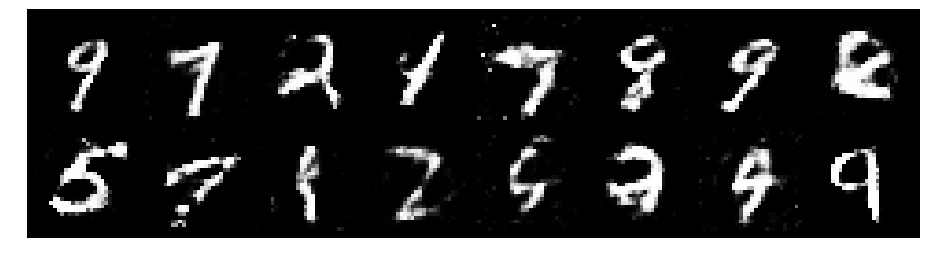

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.3090, Generator Loss: 0.7702
D(x): 0.5619, D(G(z)): 0.4727


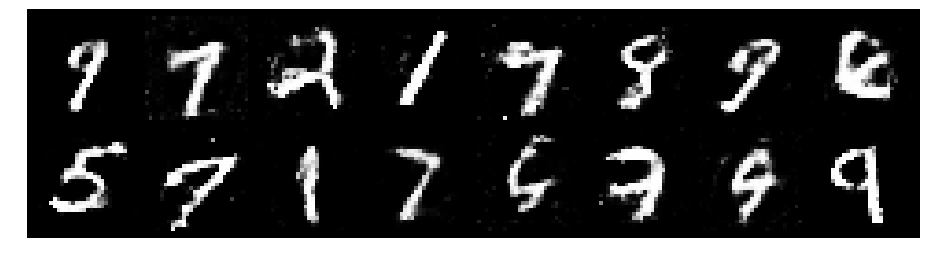

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3663, Generator Loss: 0.9272
D(x): 0.4987, D(G(z)): 0.4266


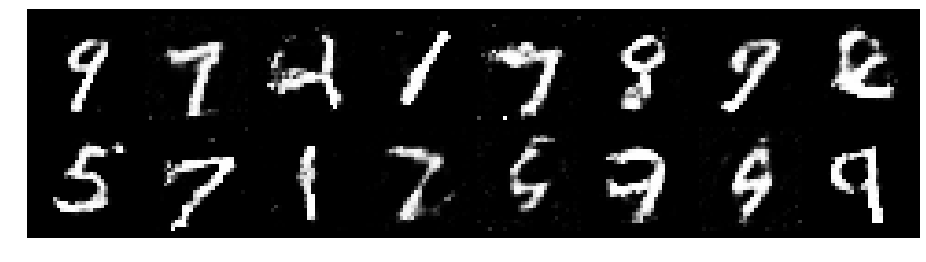

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3019, Generator Loss: 1.0976
D(x): 0.5927, D(G(z)): 0.4688


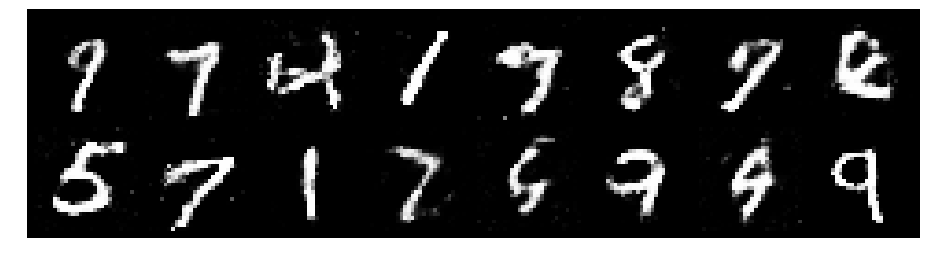

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.1677, Generator Loss: 0.8616
D(x): 0.5879, D(G(z)): 0.4023


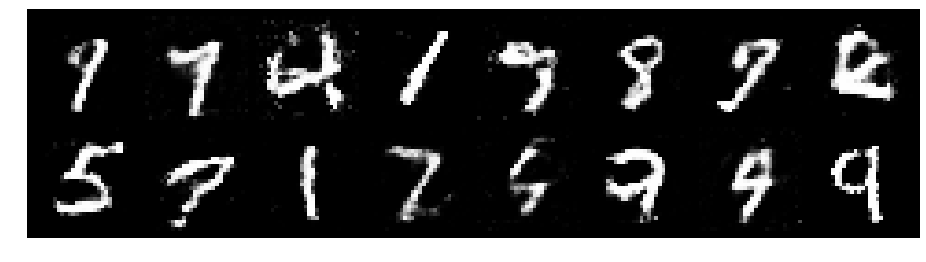

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2350, Generator Loss: 0.8417
D(x): 0.5546, D(G(z)): 0.4372


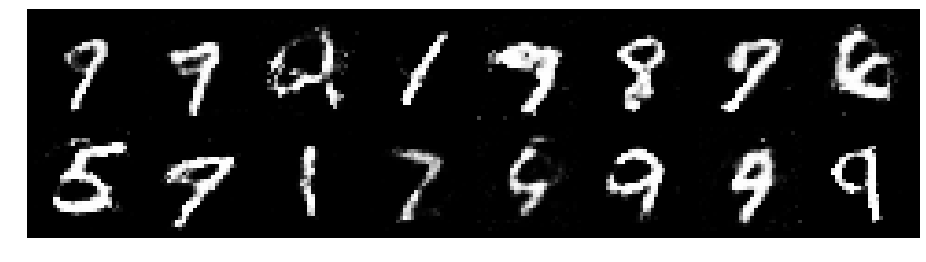

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3281, Generator Loss: 0.8495
D(x): 0.5093, D(G(z)): 0.4239


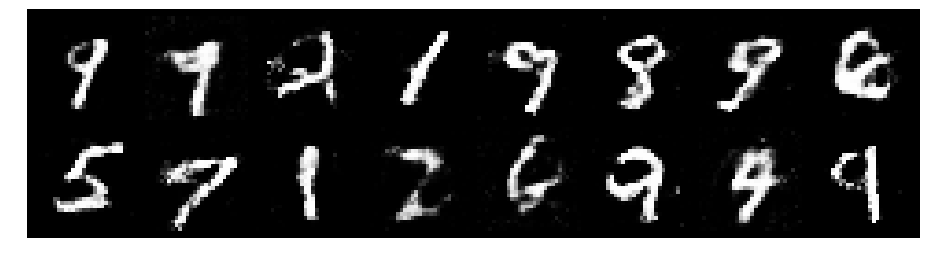

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.4137, Generator Loss: 0.8457
D(x): 0.5274, D(G(z)): 0.4759


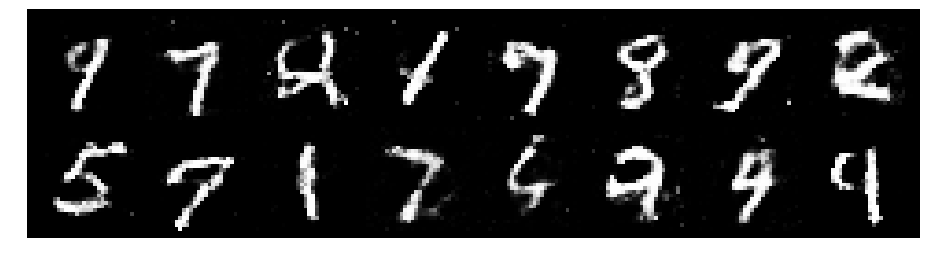

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.2431, Generator Loss: 0.9567
D(x): 0.5349, D(G(z)): 0.4190


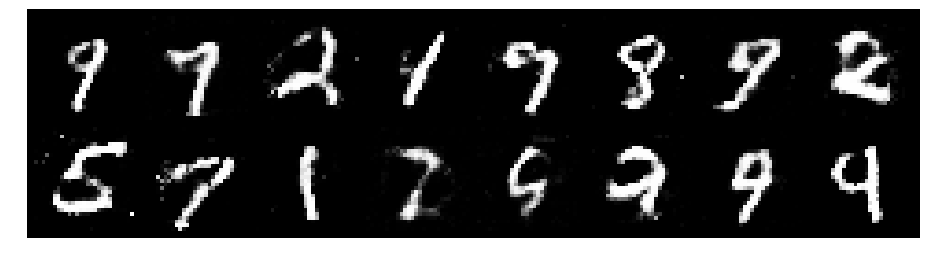

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.1317, Generator Loss: 0.9485
D(x): 0.5837, D(G(z)): 0.3994


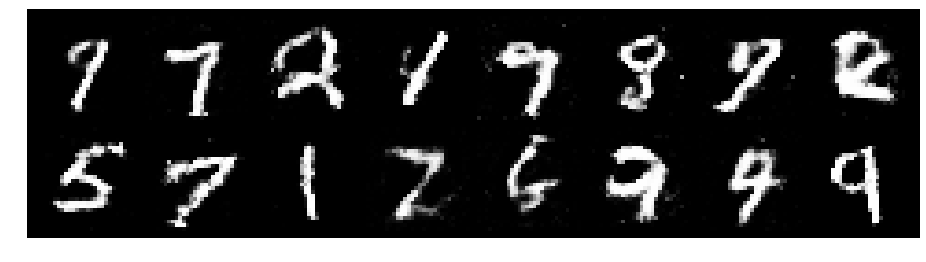

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2006, Generator Loss: 0.8800
D(x): 0.5823, D(G(z)): 0.4232


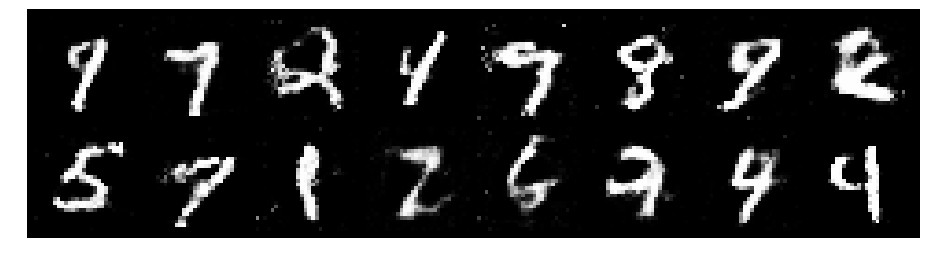

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.1904, Generator Loss: 0.9214
D(x): 0.5756, D(G(z)): 0.4238


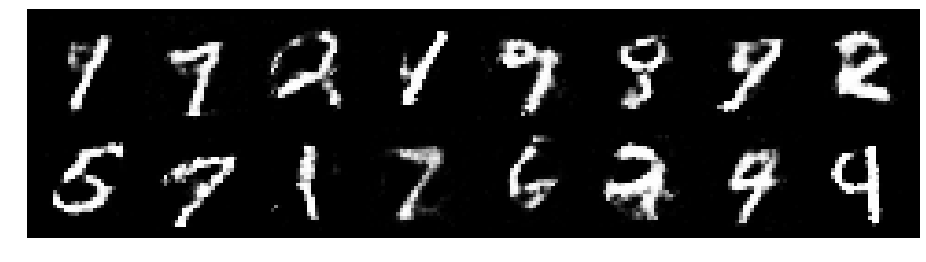

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2340, Generator Loss: 0.7933
D(x): 0.5403, D(G(z)): 0.4300


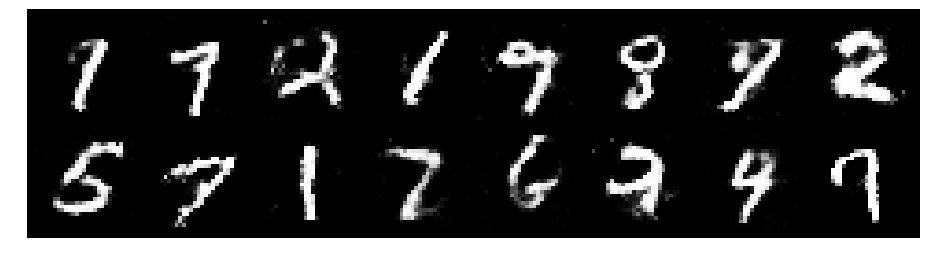

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.4225, Generator Loss: 0.8036
D(x): 0.5061, D(G(z)): 0.4448


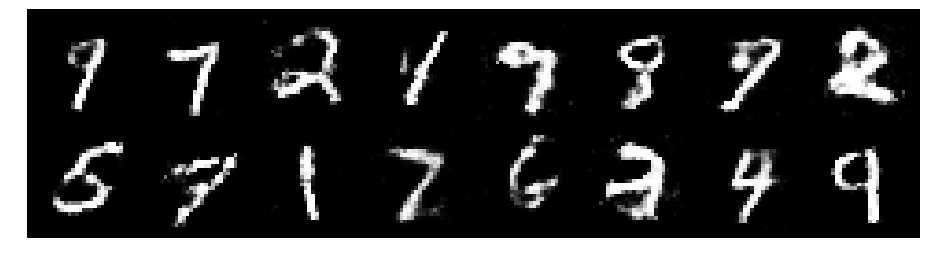

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.3770, Generator Loss: 0.7188
D(x): 0.5540, D(G(z)): 0.5014


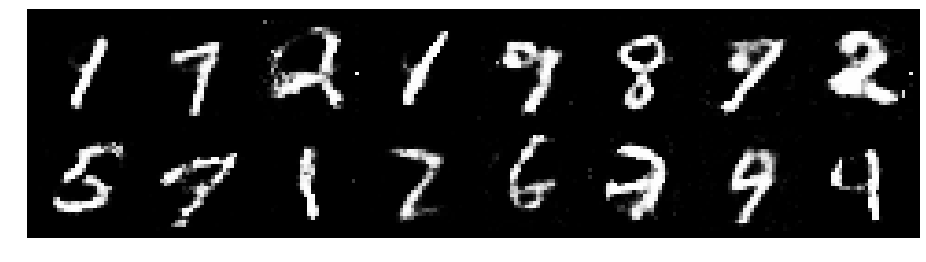

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.3951, Generator Loss: 0.8365
D(x): 0.5219, D(G(z)): 0.4854


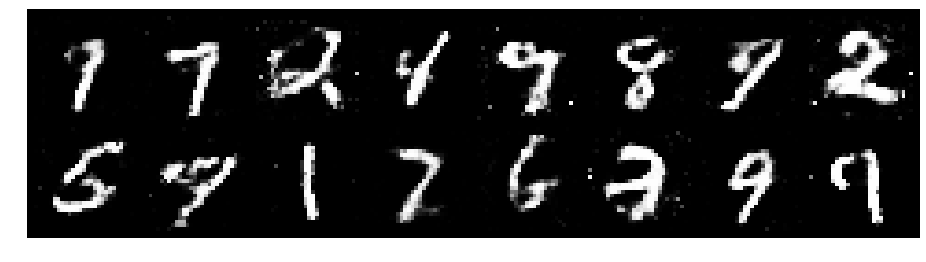

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2444, Generator Loss: 0.7277
D(x): 0.5854, D(G(z)): 0.4658


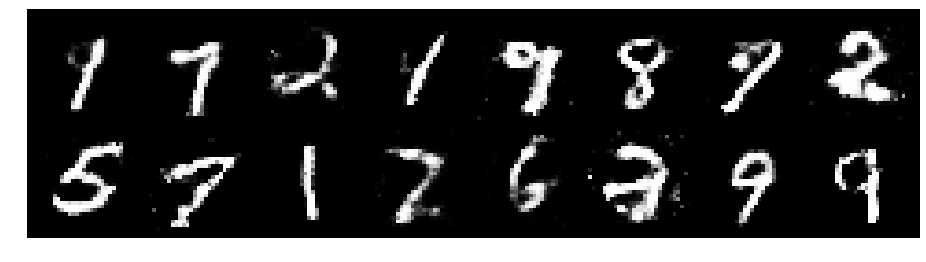

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.3080, Generator Loss: 0.8751
D(x): 0.5231, D(G(z)): 0.4521


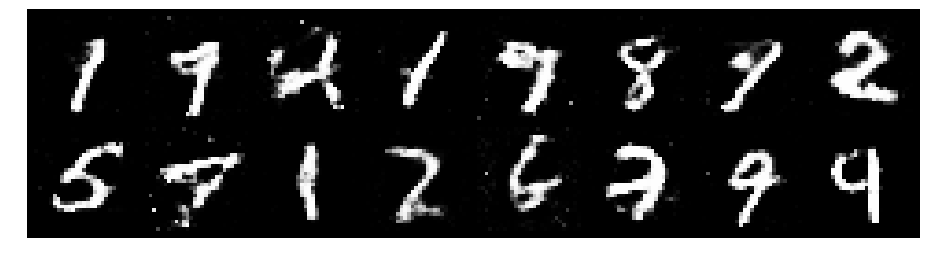

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.4248, Generator Loss: 0.9106
D(x): 0.5009, D(G(z)): 0.4538


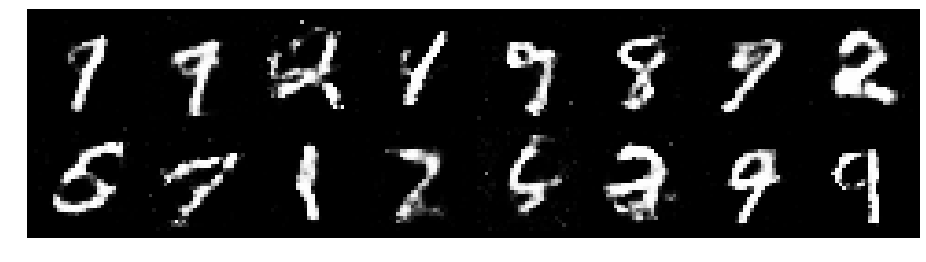

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.3524, Generator Loss: 0.9157
D(x): 0.5371, D(G(z)): 0.4624


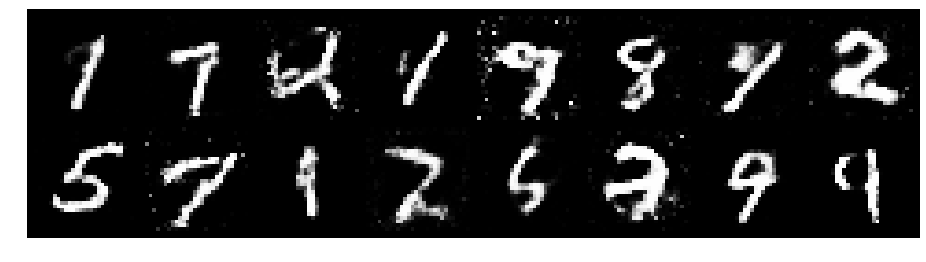

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2584, Generator Loss: 0.8655
D(x): 0.5476, D(G(z)): 0.4465


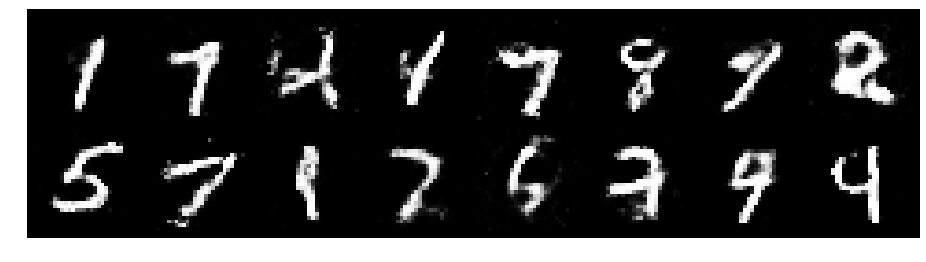

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.1377, Generator Loss: 1.0140
D(x): 0.5697, D(G(z)): 0.3917


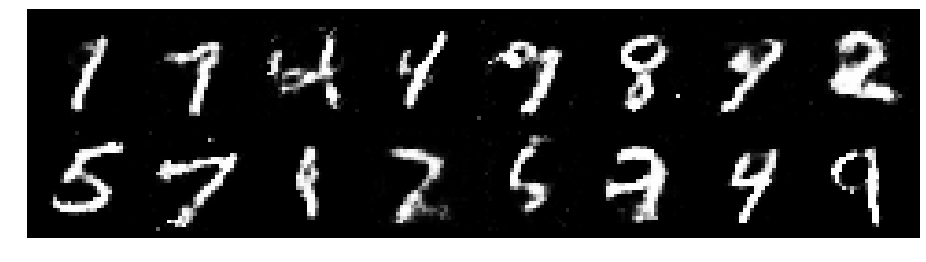

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.1889, Generator Loss: 0.8204
D(x): 0.6355, D(G(z)): 0.4642


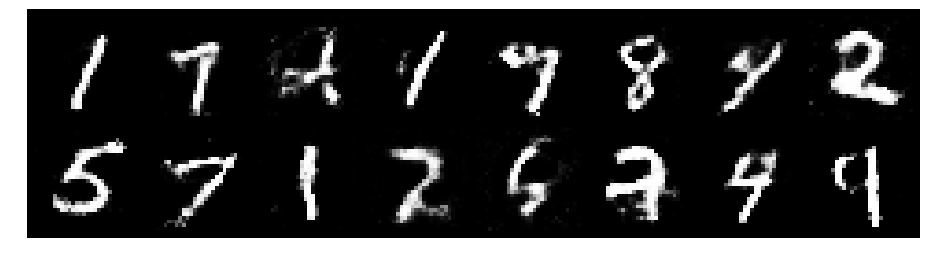

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.1055, Generator Loss: 0.9634
D(x): 0.5917, D(G(z)): 0.3981


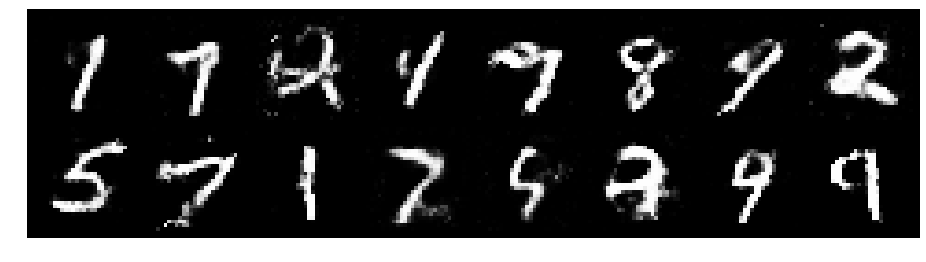

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2001, Generator Loss: 0.8767
D(x): 0.5957, D(G(z)): 0.4254


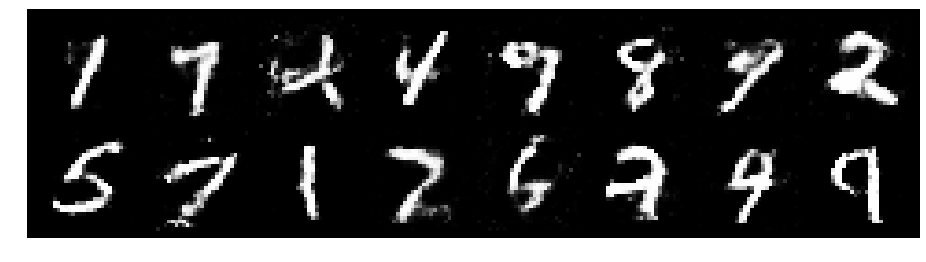

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2091, Generator Loss: 0.9105
D(x): 0.5458, D(G(z)): 0.4187


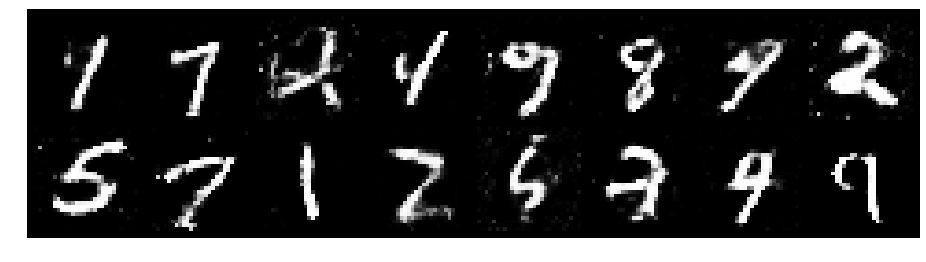

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2359, Generator Loss: 0.9369
D(x): 0.5611, D(G(z)): 0.4383


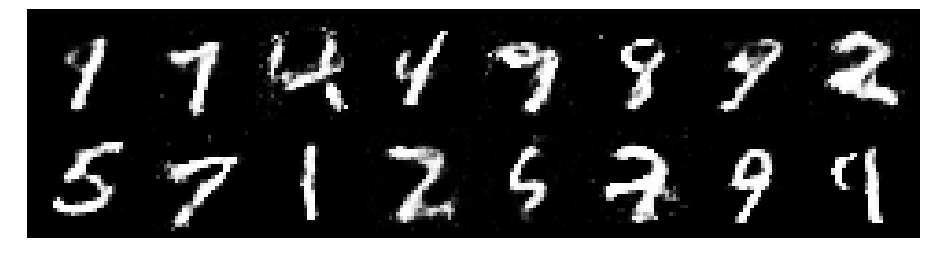

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2818, Generator Loss: 0.7759
D(x): 0.5644, D(G(z)): 0.4724


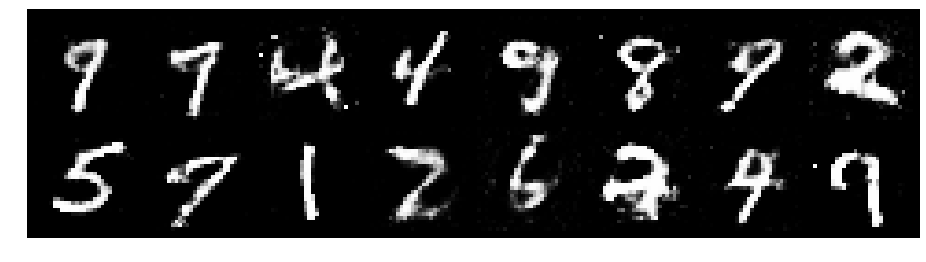

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2466, Generator Loss: 0.9720
D(x): 0.5393, D(G(z)): 0.4206


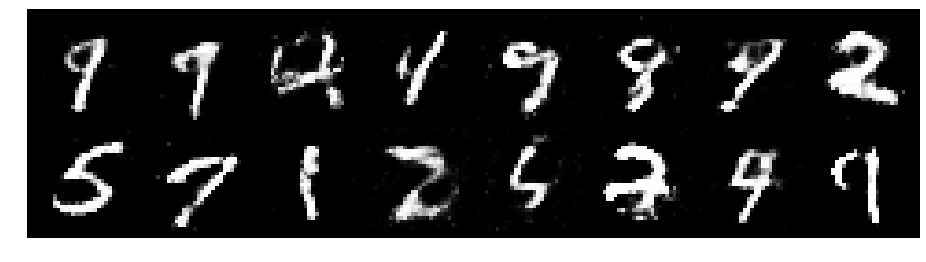

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.3573, Generator Loss: 0.9501
D(x): 0.5917, D(G(z)): 0.4957


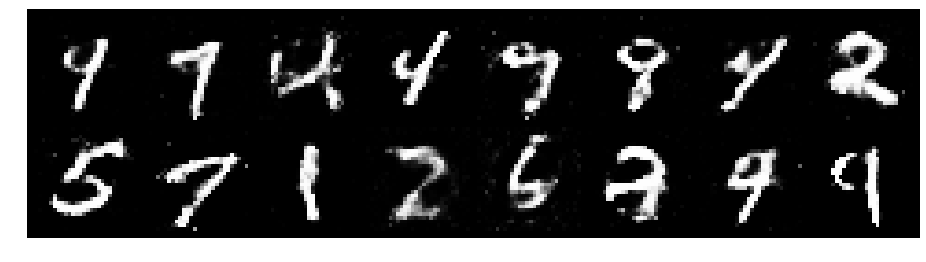

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2995, Generator Loss: 0.8658
D(x): 0.5919, D(G(z)): 0.4803


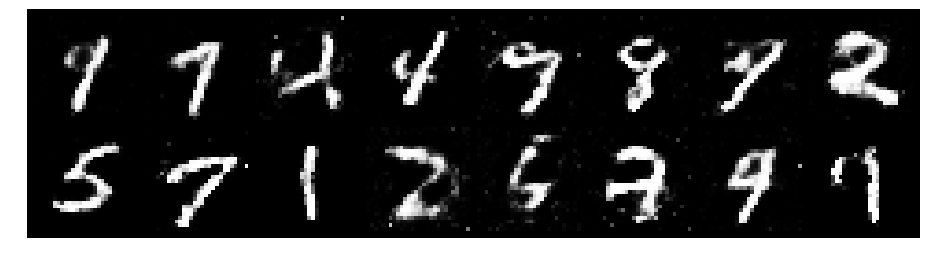

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.3347, Generator Loss: 0.8742
D(x): 0.5244, D(G(z)): 0.4486


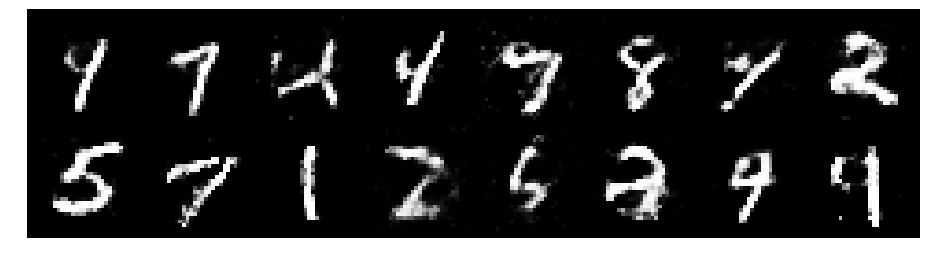

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.2392, Generator Loss: 0.9701
D(x): 0.5270, D(G(z)): 0.3944


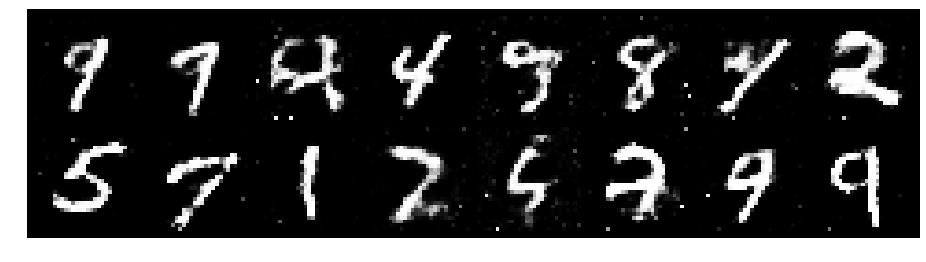

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2172, Generator Loss: 0.9872
D(x): 0.5476, D(G(z)): 0.3920


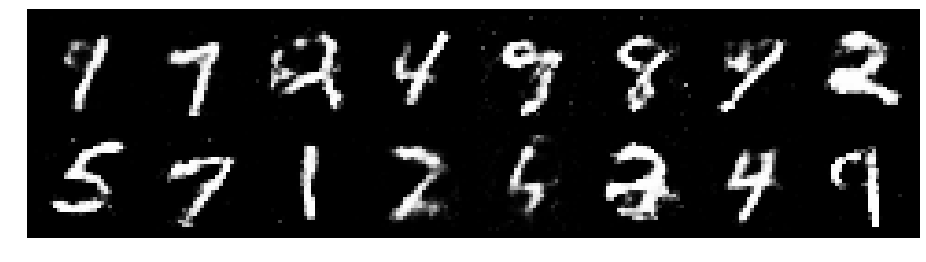

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2993, Generator Loss: 0.7993
D(x): 0.5411, D(G(z)): 0.4594


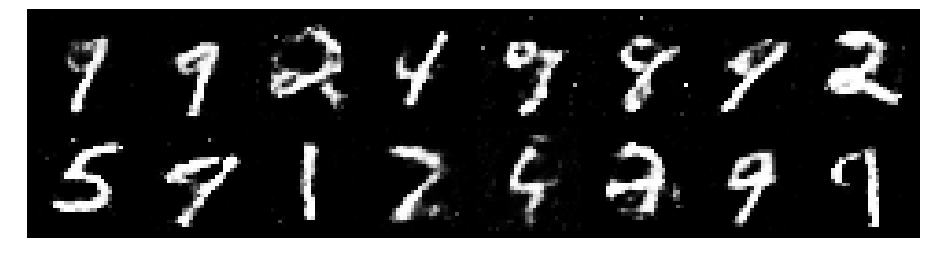

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.2356, Generator Loss: 0.8095
D(x): 0.5635, D(G(z)): 0.4436


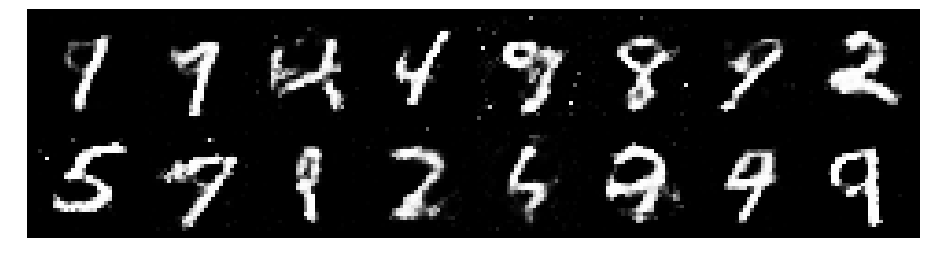

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.2666, Generator Loss: 0.8071
D(x): 0.5275, D(G(z)): 0.4297


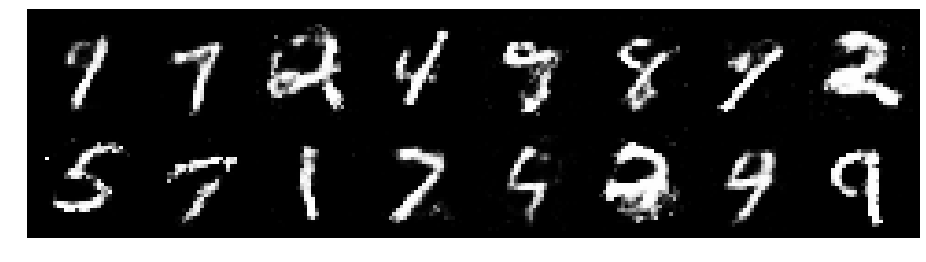

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.2492, Generator Loss: 0.9191
D(x): 0.5702, D(G(z)): 0.4528


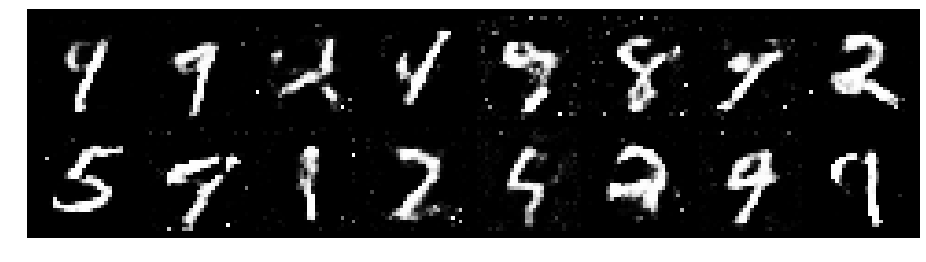

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3155, Generator Loss: 0.8512
D(x): 0.5093, D(G(z)): 0.4413


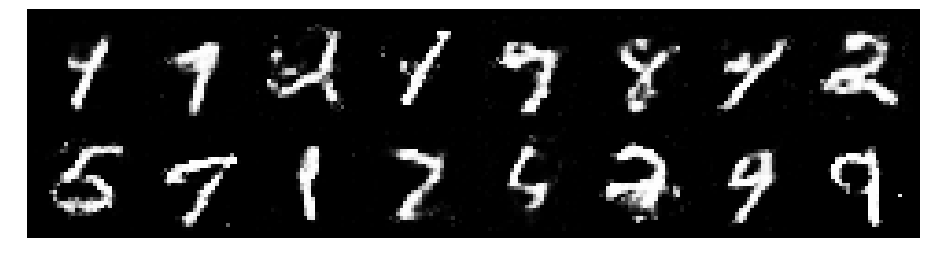

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2852, Generator Loss: 0.8548
D(x): 0.5139, D(G(z)): 0.4277


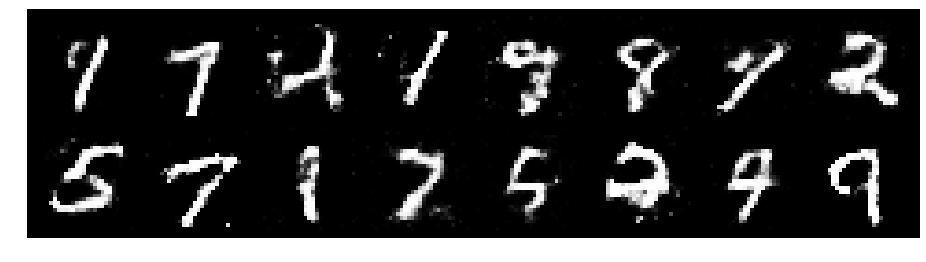

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2698, Generator Loss: 0.8157
D(x): 0.5801, D(G(z)): 0.4714


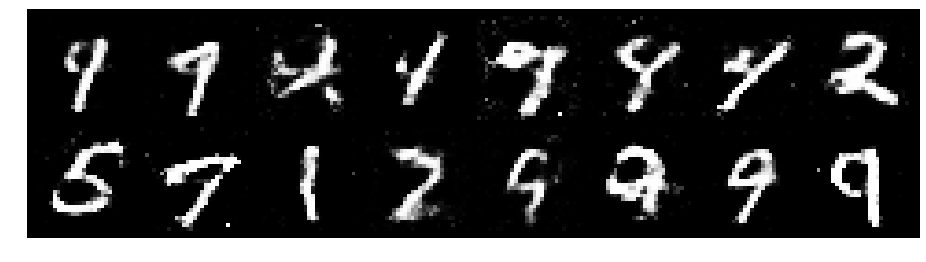

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2813, Generator Loss: 0.8742
D(x): 0.5499, D(G(z)): 0.4421


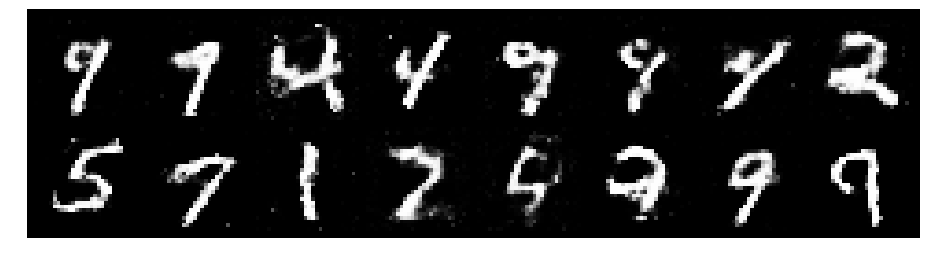

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2258, Generator Loss: 1.0025
D(x): 0.5380, D(G(z)): 0.3940


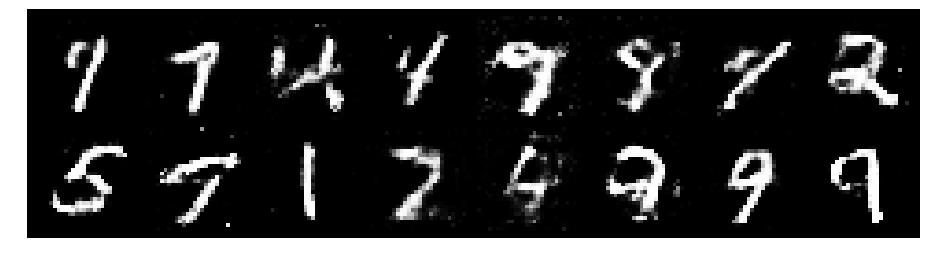

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2835, Generator Loss: 0.8275
D(x): 0.5660, D(G(z)): 0.4723


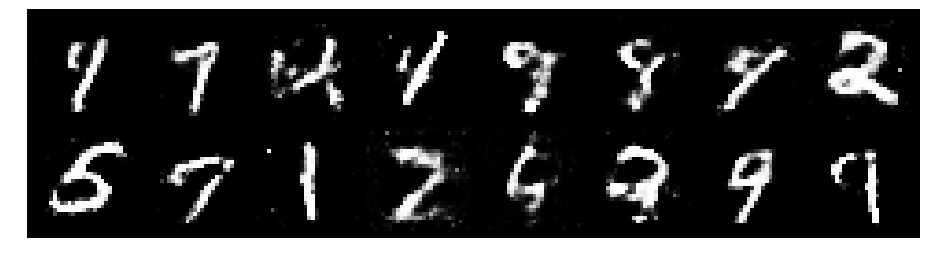

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.1758, Generator Loss: 0.9059
D(x): 0.5708, D(G(z)): 0.4053


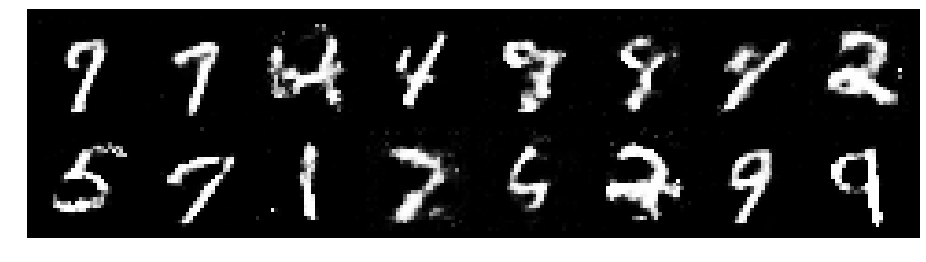

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.2450, Generator Loss: 0.8459
D(x): 0.5318, D(G(z)): 0.3907


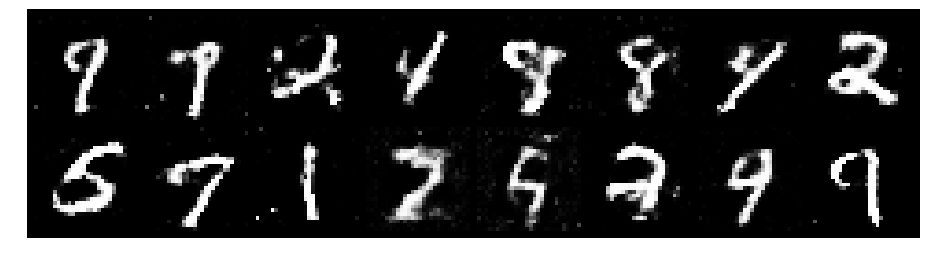

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.3096, Generator Loss: 0.7591
D(x): 0.5815, D(G(z)): 0.4913


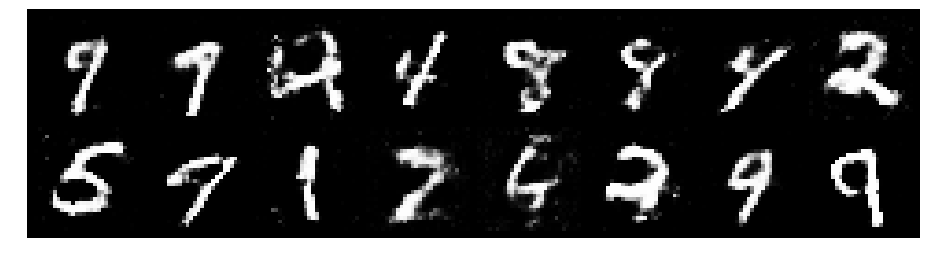

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2891, Generator Loss: 0.7206
D(x): 0.5943, D(G(z)): 0.4812


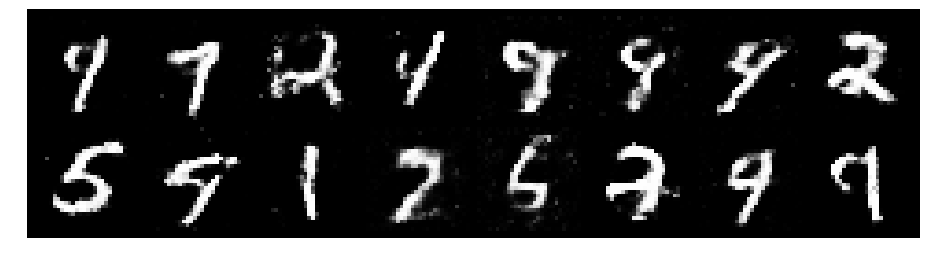

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.3337, Generator Loss: 0.8292
D(x): 0.5261, D(G(z)): 0.4484


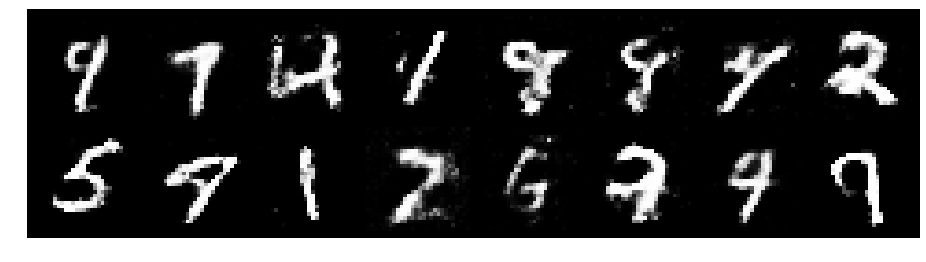

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.2346, Generator Loss: 0.7930
D(x): 0.5852, D(G(z)): 0.4719


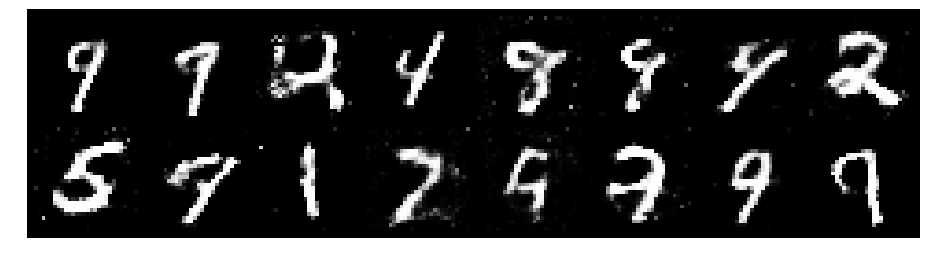

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.3375, Generator Loss: 0.7320
D(x): 0.5459, D(G(z)): 0.4831


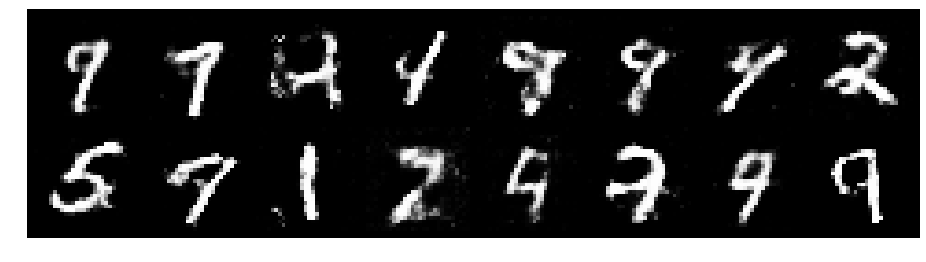

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2871, Generator Loss: 0.8348
D(x): 0.5628, D(G(z)): 0.4603


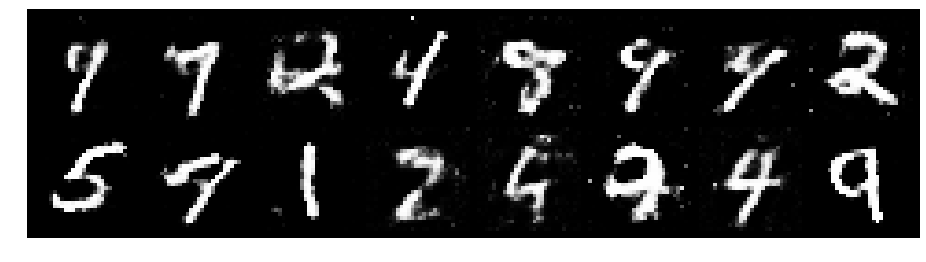

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3129, Generator Loss: 0.9289
D(x): 0.5256, D(G(z)): 0.4360


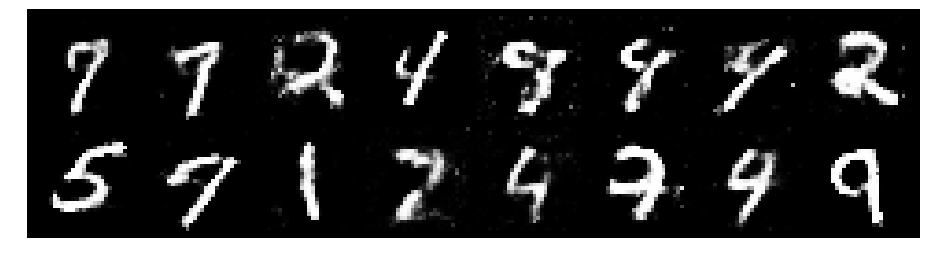

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2599, Generator Loss: 0.8948
D(x): 0.6036, D(G(z)): 0.4531


In [0]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )

In [0]:
!zip -r /content/data.zip /content


  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/gce (stored 0%)
  adding: content/.config/configurations/ (stored 0%)
  adding: content/.config/configurations/config_default (stored 0%)
  adding: content/.config/config_sentinel (stored 0%)
  adding: content/.config/active_config (stored 0%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2019.08.27/ (stored 0%)
  adding: content/.config/logs/2019.08.27/16.17.17.407104.log (deflated 85%)
  adding: content/.config/logs/2019.08.27/16.17.22.686467.log (deflated 55%)
  adding: content/.config/logs/2019.08.27/16.17.21.663235.log (deflated 54%)
  adding: content/.config/logs/2019.08.27/16.17.00.530950.log (deflated 90%)
  adding: content/.config/logs/2019.08.27/16.17.07.367707.log (deflated 54%)
  adding: content/.config/.last_update_check.json (deflated 22%)
  adding: content/.config/.metricsUUID (stored 0%)
  adding: content/runs/ (stored 0%)
  adding: content/runs/O